In [1]:
import os
import glob
import pylab as pl

from caiman.source_extraction.cnmf.cnmf import load_CNMF


/n/coxfs01/2p-pipeline/envs/caiman/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/n/coxfs01/2p-pipeline/envs/caiman/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/n/coxfs01/2p-pipeline/envs/caiman/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/n/coxfs01/2p-pipeline/envs/caiman/lib/python3

In [2]:
import h5py
import re
import json
import traceback 
import copy
import itertools
import time

import numpy as np
import pandas as pd
import seaborn as sns
import caiman as cm

from scipy.stats import stats
import matplotlib.patches as patches   

def atoi(text):
    return int(text) if text.isdigit() else text

def natural_keys(text):
    return [ atoi(c) for c in re.split('(\d+)', text) ]


In [3]:
%matplotlib notebook

# Select 1 dataset experiment

In [4]:
rootdir = '/n/coxfs01/2p-data'
animalid = 'JC084' #'JC084'
session = '20190522' #'20190522' #'20190505_JC083'
session_dir = os.path.join(rootdir, animalid, session)

fov = 'FOV1_zoom2p0x'
exp = 'gratings' #'retino_run2'
dataid = '|'.join([animalid, session, fov, exp])

print("*** Dataset: %s ***" % dataid)

*** Dataset: JC084|20190522|FOV1_zoom2p0x|gratings ***


# Load CaImAn-extracted traces

In [5]:
results_dir = os.path.join(session_dir, fov, 'caiman_results', exp)
glob.glob(os.path.join(results_dir, '*_results.hdf5'))

['/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/seed-cnm_seeded-gratings-downsample-1-mcorrected_results.hdf5',
 '/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/xseeded_JC084-20190522-FOV1_zoom2p0x-gratings-Yr_results.hdf5',
 '/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/seeded_JC084-20190522-FOV1_zoom2p0x-gratings-Yr_results.hdf5']

In [6]:
results_fpath = glob.glob(os.path.join(results_dir, '*_results.hdf5'))[-1]

print("...loading %s" % results_fpath)
cnm = load_CNMF(results_fpath, n_processes=2)
cnm.estimates.A.shape

...loading /n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/seeded_JC084-20190522-FOV1_zoom2p0x-gratings-Yr_results.hdf5


(262144, 260)

In [7]:

def get_frame_info(run_dir):
    '''
    Adapted for CaImAn from pipeline.python.utils.
    '''
    
    si_info = {}

    run = os.path.split(run_dir)[-1]
    runinfo_path = os.path.join(run_dir, '%s.json' % run)
    with open(runinfo_path, 'r') as fr:
        runinfo = json.load(fr)
    nfiles = runinfo['ntiffs']
    file_names = sorted(['File%03d' % int(f+1) for f in range(nfiles)], key=natural_keys)

    # Get frame_idxs -- these are FRAME indices in the current .tif file, i.e.,
    # removed flyback frames and discard frames at the top and bottom of the
    # volume should not be included in the indices...
    frame_idxs = runinfo['frame_idxs']
    if len(frame_idxs) > 0:
        print("Found %i frames from flyback correction." % len(frame_idxs))
    else:
        frame_idxs = np.arange(0, runinfo['nvolumes'] * len(runinfo['slices']))

    ntiffs = runinfo['ntiffs']
    file_names = sorted(['File%03d' % int(f+1) for f in range(ntiffs)], key=natural_keys)
    volumerate = runinfo['volume_rate']
    framerate = runinfo['frame_rate']
    nvolumes = runinfo['nvolumes']
    nslices = int(len(runinfo['slices']))
    nchannels = runinfo['nchannels']
    nslices_full = int(round(runinfo['frame_rate']/runinfo['volume_rate']))
    nframes_per_file = nslices_full * nvolumes

    # =============================================================================
    # Get VOLUME indices to assign frame numbers to volumes:
    # =============================================================================
    vol_idxs_file = np.empty((nvolumes*nslices_full,))
    vcounter = 0
    for v in range(nvolumes):
        vol_idxs_file[vcounter:vcounter+nslices_full] = np.ones((nslices_full, )) * v
        vcounter += nslices_full
    vol_idxs_file = [int(v) for v in vol_idxs_file]

    vol_idxs = []
    vol_idxs.extend(np.array(vol_idxs_file) + nvolumes*tiffnum for tiffnum in range(nfiles))
    vol_idxs = np.array(sorted(np.concatenate(vol_idxs).ravel()))

    all_frames_tsecs = runinfo['frame_tstamps_sec']
    si_info['nslices_full'] = nslices_full
    si_info['nframes_per_file'] = nframes_per_file
    si_info['vol_idxs'] = vol_idxs
    si_info['vol_idxs_file'] = np.array(vol_idxs_file)
    si_info['volumerate'] = volumerate
    si_info['framerate'] = framerate
    si_info['nslices'] = nslices
    si_info['nchannels'] = nchannels
    if nchannels==2:
        all_frames_tsecs = np.array(all_frames_tsecs[0::2])
        
    si_info['ntiffs'] = ntiffs
    si_info['frames_tsec'] = all_frames_tsecs #runinfo['frame_tstamps_sec']
    si_info['nvolumes'] = nvolumes

    return si_info


In [8]:

def frames_to_trials(curr_rundir, trials_in_block, file_ix, frame_shift=0,
                     frame_ixs=None, verbose=False):

    '''
    Adapted for CaImAn from pipeline.python.paradigm.trial_alignment
    '''
    parsed_frames_fpath = glob.glob(os.path.join(curr_rundir, 'paradigm', 'parsed_frames_*.hdf5'))[0]
    
    si = get_frame_info(curr_rundir)
    all_frames_tsecs = np.array(si['frames_tsec']) # Corrected frame tstamps (single-channel)
    if verbose:
        print("N tsecs:", len(all_frames_tsecs))
    vol_ixs = si['vol_idxs'] # Volume indices to assign frame numbers to volumes (across all tifs)
    vol_ixs_tif = si['vol_idxs_file']

    try:
        parsed_frames = h5py.File(parsed_frames_fpath, 'r')

        # Get trial list across all tif files
        trial_list = sorted(parsed_frames.keys(), key=natural_keys)
        if file_ix==0:
            print("... getting ixs for %i of %i total trials across all .tif files." % (len(trials_in_block), len(trial_list)))

        # Check if frame indices are indexed relative to full run (all .tif files) or within-tif (i.e., a "block")
        block_indexed = all([all(parsed_frames[t]['frames_in_run'][:] == parsed_frames[t]['frames_in_file'][:])\
                             for t in trial_list]) is False

        # Calculate trial epochs in frames (assumes all trials have same structure)
        min_frame_interval = 1
        nframes_pre = int(round(parsed_frames['trial00001']['frames_in_run'].attrs['baseline_dur_sec'] * si['volumerate']))
        nframes_post = int(round(parsed_frames['trial00001']['frames_in_run'].attrs['iti_dur_sec'] * si['volumerate']))
        nframes_on = int(round(parsed_frames['trial00001']['frames_in_run'].attrs['stim_dur_sec'] * si['volumerate']))
        nframes_per_trial = nframes_pre + nframes_on + nframes_post 
    
        # Get all frame indices for trial epochs (if there are overlapping frame indices, there will be repeats)    
        all_frames_in_trials = np.hstack([np.array(parsed_frames[t]['frames_in_file']) \
                                   for t in trials_in_block])
        print("*first frame: %i" % all_frames_in_trials[0])

        if verbose:
            print("... N frames to align:", len(all_frames_in_trials))
            print("... N unique frames:", len(np.unique(all_frames_in_trials)))
        stim_onset_idxs = np.array([parsed_frames[t]['frames_in_file'].attrs['stim_on_idx'] \
                                    for t in trials_in_block])
    
        # Adjust frame indices to match within-file, rather than across-files, indices
        if block_indexed is False:
            all_frames_in_trials = all_frames_in_trials - len(all_frames_tsecs)*file_ix - frame_shift  
            if all_frames_in_trials[-1] >= len(all_frames_tsecs):
                print("... File: %i (has %i frames)" % (file_ix, len(all_frames_tsecs)))
                print("... asking for %i extra frames..." % (all_frames_in_trials[-1] - len(all_frames_tsecs)))
                #all_frames_in_trials = np.array([f for i, f in enumerate(all_frames_in_trials)\
                #                                 if f in range(len(all_frames_tsecs))])

            stim_onset_idxs = stim_onset_idxs - len(all_frames_tsecs)*file_ix - frame_shift 
        if verbose:
            print("... Last frame to align: %i (N frames total, %i)" % (all_frames_in_trials[-1], len(all_frames_tsecs)))
    
        stim_onset_idxs_adjusted = vol_ixs_tif[stim_onset_idxs]
        stim_onset_idxs = copy.copy(stim_onset_idxs_adjusted)
        varying_stim_dur=False
        trial_frames_to_vols = dict((t, []) for t in trials_in_block)
        for t in trials_in_block: 
            frames_to_vols = parsed_frames[t]['frames_in_file'][:] 
            frames_to_vols = frames_to_vols - len(all_frames_tsecs)*file_ix - frame_shift  
            actual_frames_in_trial = [i for i in frames_to_vols if i < len(vol_ixs_tif)]
            #trial_vol_ixs = np.empty(frames_to_vols.shape, dtype=int)
            trial_vol_ixs = np.ones(frames_to_vols.shape, dtype=int)*-100 #np.nan
            trial_vol_ixs[0:len(actual_frames_in_trial)] = vol_ixs_tif[actual_frames_in_trial]
            if varying_stim_dur is False:
                trial_vol_ixs = trial_vol_ixs[0:nframes_per_trial]
            trial_frames_to_vols[t] = np.array(trial_vol_ixs)

    except Exception as e:
        traceback.print_exc()
    finally:
        parsed_frames.close()
            
    #%
    # Convert frame-reference to volume-reference. Only select first frame for each volume.
    # Only relevant for multi-plane. Don't take unique values, since stim period of trial N 
    # can be ITI of trial N-1
    actual_frames = [i for i in all_frames_in_trials if i < len(vol_ixs_tif)]
    frames_in_trials = vol_ixs_tif[actual_frames]
    
    # Turn frame_tsecs into RELATIVE tstamps (to stim onset):
    # ------------------------------------------------
    first_plane_tstamps = all_frames_tsecs[np.array(frame_ixs)]
    trial_tstamps = first_plane_tstamps[frames_in_trials[0:len(actual_frames)]] #all_frames_tsecs[frames_in_trials] #indices]  

    # Check whether we are asking for more frames than there are unique, and pad array if so
    if len(trial_tstamps) < len(all_frames_in_trials): #len(frames_in_trials):
        print("... padding trial tstamps array... (should be %i)" % len(all_frames_in_trials))
        trial_tstamps = np.pad(trial_tstamps, (0, len(all_frames_in_trials)-len(trial_tstamps)),\
                               mode='constant', constant_values=-100) #np.nan)
        frames_in_trials = np.pad(frames_in_trials, (0, len(all_frames_in_trials)-len(frames_in_trials)),\
                                  mode='constant', constant_values=-100) #np.nan)

    # All trials have the same structure:
    reformat_tstamps = False
    if verbose:
        print("N frames per trial:", nframes_per_trial)
        print("N tstamps:", len(trial_tstamps))
        print("N trials in block:", len(trials_in_block))
    try: 
        tsec_mat = np.reshape(trial_tstamps, (len(trials_in_block), nframes_per_trial))
        # Subtract stim_on tstamp from each frame of each trial to get relative tstamp:
        tsec_mat -= np.tile(all_frames_tsecs[stim_onset_idxs].T, (tsec_mat.shape[1], 1)).T
        
    except Exception as e: #ValueError:
        traceback.print_exc()
#        reformat_tstamps = True

    x, y = np.where(tsec_mat==0)
    assert len(list(set(y)))==1, "Incorrect stim onset alignment: %s" % str(list(set(y)))
       
    relative_tsecs = np.reshape(tsec_mat, (len(trials_in_block)*nframes_per_trial, ))

    # Convert frames_in_file to volume idxs:
    trial_frames_to_vols = pd.DataFrame(trial_frames_to_vols)
    trial_frames_to_vols = trial_frames_to_vols.replace(-100, np.nan)

    return trial_frames_to_vols, relative_tsecs


# Load manual data

In [9]:
traceid = 'traces001'

In [10]:
manualdir = glob.glob(os.path.join(rootdir, animalid, session, fov, 'combined_%s_static' % exp,
                     'traces', '%s*' % traceid, 'data_arrays'))[0]

dset = np.load(os.path.join(manualdir, 'np_subtracted.npz'), encoding='latin1', allow_pickle=True)
manual = pd.DataFrame(dset['data'][:])
print(manual.shape)

(110360, 260)


#### Stimulus configs + plottting params

In [13]:
def reformat_morph_values(sdf):
    #sdf = sdf.assign(ix=[int(i.split('config')[-1]) for i in sdf.index]).sort_values('ix')
    control_ixs = sdf[sdf['morphlevel']==-1].index.tolist()
    sizevals = np.array([round(s, 1) for s in sdf['size'].unique() if s not in ['None', None] and not np.isnan(s)] )
    sdf.loc[sdf.morphlevel==-1, 'size'] = pd.Series(sizevals, index=control_ixs)
    sdf['size'] = [round(s, 1) for s in sdf['size'].values]
    #sdf = sdf.assign(ix=[int(i.split('config')[-1]) for i in sdf.index]).sort_values('ix')
    
    return sdf


In [18]:
sdf = pd.DataFrame(dset['sconfigs'][()]).T
sdf = sdf.assign(ix=[int(i.split('config')[-1]) for i in sdf.index]).sort_values('ix')
if exp=='blobs':
    sdf = reformat_morph_values(sdf)
sdf

,direction,luminance,stimtype,xpos,ypos,aspect,ori,position,speed,sf,size,ix
config001,0,None,gratings,0,0,1,0,"(0, 0)",10,0.1,200,1
config002,0,None,gratings,0,0,1,0,"(0, 0)",20,0.1,200,2
config003,0,None,gratings,0,0,1,0,"(0, 0)",10,0.5,200,3
config004,0,None,gratings,0,0,1,0,"(0, 0)",20,0.5,200,4
config005,0,None,gratings,20,-8,1,0,"(20, -8)",10,0.1,20,5
...,...,...,...,...,...,...,...,...,...,...,...,...
config060,0,None,gratings,0,0,1,315,"(0, 0)",20,0.5,200,60
config061,0,None,gratings,20,-8,1,315,"(20, -8)",10,0.1,20,61
config062,0,None,gratings,20,-8,1,315,"(20, -8)",20,0.1,20,62
config063,0,None,gratings,20,-8,1,315,"(20, -8)",10,0.5,20,63


In [19]:
if exp=='blobs':
    plot_params = {'hue': None,
                   'rows': 'size',
                   'cols': 'morphlevel'}
else:
    plot_params = {'hue': 'sf',
                   'rows': ['size', 'speed'],
                   'cols': 'ori'}
    

In [20]:
all_plot_params=[]
for p in plot_params.values():
    if isinstance(p, list):
        all_plot_params.extend(p)
    else:
        all_plot_params.append(p)
all_plot_params

['sf', 'size', 'speed', 'ori']

In [21]:
combined_params = ['_'.join(v) for k, v in plot_params.items() if isinstance(v, list)]
for p in combined_params:
    sdf[p] = ['_'.join([str(c) for c in list(combo[0])]) for combo in list(zip(sdf[p.split('_')].values))]
sdf.head()

,direction,luminance,stimtype,xpos,ypos,aspect,ori,position,speed,sf,size,ix,size_speed
config001,0,None,gratings,0,0,1,0,"(0, 0)",10,0.1,200,1,200_10
config002,0,None,gratings,0,0,1,0,"(0, 0)",20,0.1,200,2,200_20
config003,0,None,gratings,0,0,1,0,"(0, 0)",10,0.5,200,3,200_10
config004,0,None,gratings,0,0,1,0,"(0, 0)",20,0.5,200,4,200_20
config005,0,None,gratings,20,-8,1,0,"(20, -8)",10,0.1,20,5,20_10


#### Frame labels 

In [22]:
labels = pd.DataFrame(dset['labels_data'], columns=dset['labels_columns'])
labels.columns = [x.decode("utf-8") for x in labels.columns]
labels.head()
print(labels.shape)

(110360, 8)


In [23]:
labels_c = labels.copy()

In [24]:
for p in plot_params.values():
    if p is None:
        continue
    if isinstance(p, list):
        for pp in p:
            labels_c[pp] = [sdf[pp][cfg] for cfg in labels['config']]
    else:
        labels_c[p] = [sdf[p][cfg] for cfg in labels['config']]
                        
             

In [25]:
ylabel = 'trace'
palette = 'colorblind' 

In [26]:
# combine string params
for k, v in plot_params.items():
    if isinstance(v, list):
        plot_params[k] = '_'.join(v)

if plot_params['hue'] is None:
    palette = 'k'

In [27]:
plot_params

{'hue': 'sf', 'rows': 'size_speed', 'cols': 'ori'}

# Align CaImAn traces

In [28]:
# Get run, tif num, and file path for extracted raw arrays
runpaths = sorted(glob.glob(os.path.join(rootdir, animalid, session, fov, '*%s_*' % exp,
                                         'traces', '%s*' % traceid, 'files')), key=natural_keys)
rawfns = [(run_ix, file_ix, fn) for run_ix, rpath in enumerate(sorted(runpaths, key=natural_keys))
          for file_ix, fn in enumerate(sorted(glob.glob(os.path.join(rpath, '*.hdf5')), key=natural_keys))]
print("Found raw tif arrays for %i files" % len(rawfns))


Found raw tif arrays for 31 files


In [29]:
tframes = {}
for total_ix, (run_ix, file_ix, fpath) in enumerate(rawfns):
    rfile = h5py.File(fpath, 'r')
    fdata = rfile['Slice01']
    frames_to_select = pd.DataFrame(fdata['frames_indices'][:])
    frame_ixs = np.array(frames_to_select[0].values) 

    # Get MW info
    curr_rundir = runpaths[run_ix].split('/traces')[0]
    mw_fpath = glob.glob(os.path.join(curr_rundir, 'paradigm', 'trials_*.json'))[0]
    with open(mw_fpath, 'r') as f:
        mwinfo = json.load(f)
    trials_in_block = sorted([t for t, mdict in mwinfo.items() if mdict['block_idx']==file_ix and mdict['stimuli']['type'] != 'blank'], key=natural_keys)
    frame_shift = 0 if 'block_frame_offset' not in mwinfo[trials_in_block[0]].keys() else mwinfo[trials_in_block[0]]['block_frame_offset']

    # Get frame indices
    print("Run %i (File %i) - %s" % (int(run_ix+1), int(file_ix+1), trials_in_block[0]))
    
    trial_frames_to_vols, relative_tsecs = frames_to_trials(curr_rundir, trials_in_block, file_ix,     
                                                            frame_shift=frame_shift, frame_ixs=frame_ixs)
    
    tframes[total_ix] = trial_frames_to_vols
    

Run 1 (File 1) - trial00001
... getting ixs for 40 of 320 total trials across all .tif files.
*first frame: 72
Run 1 (File 2) - trial00041
*first frame: 4681
Run 1 (File 3) - trial00081
*first frame: 9292
Run 1 (File 4) - trial00121
*first frame: 13902
Run 1 (File 5) - trial00161
*first frame: 18512
Run 1 (File 6) - trial00201
*first frame: 23122
Run 1 (File 7) - trial00241
*first frame: 27731
Run 1 (File 8) - trial00281
*first frame: 32342
Run 2 (File 1) - trial00001
... getting ixs for 40 of 280 total trials across all .tif files.
*first frame: 72
Run 2 (File 2) - trial00041
*first frame: 4682
Run 2 (File 3) - trial00081
*first frame: 9291
Run 2 (File 4) - trial00121
*first frame: 13902
Run 2 (File 5) - trial00161
*first frame: 18512
Run 2 (File 6) - trial00201
*first frame: 23122
Run 2 (File 7) - trial00241
*first frame: 27732
Run 3 (File 1) - trial00001
... getting ixs for 40 of 320 total trials across all .tif files.
*first frame: 72
Run 3 (File 2) - trial00041
*first frame: 4682


In [30]:
tframes[0].shape

(89, 40)

In [99]:
trace_type = 'dff'

In [100]:
if trace_type == 'denoised':
    extracted_traces = copy.copy(cnm.estimates.C) #+  cnm.estimates.YrA
elif trace_type == 'deconvolved':
    extracted_traces = copy.copy(cnm.estimates.S) #+  cnm.estimates.YrA
elif trace_type == 'dff':
    extracted_traces = copy.copy(cnm.estimates.F_dff)
else:
    print("Unrecognized trace type: %s" % trace_type)
nrois, T = extracted_traces.shape
nfiles = len(tframes.keys())
nframes_per_file = int(T/float(nfiles))
print("%i frames per file (%i files)." % (nframes_per_file, nfiles))
print(extracted_traces.shape)


4610 frames per file (31 files).
(260, 142910)


#### Plot 1 roi

In [101]:
rid = 8

In [102]:
trace_array = extracted_traces[rid, :].reshape(nfiles, nframes_per_file, order='C')
print(trace_array.shape)
# all_frames = np.hstack(np.array([trace_array[fi, np.hstack(ixs.values.T)]\
#                         for fi, ixs in sorted(tframes.items(), key=lambda x: x[0])]))
# all_frames.shape

# for fi, ixs in sorted(tframes.items(), key=lambda x: x[0]):
#     has_nans = ixs.columns[tframes[0].dtypes==float].tolist()
#     no_nans = [c for c in ixs.columns if c not in has_nans]
    
#     file_values = trace_array[fi, :]
#     curr_values = np.array([np.nan if np.isnan(i) else trace_array[fi, int(i)] for i in np.hstack(ixs.values.T)])

all_frames = np.hstack(np.array([np.nan if np.isnan(i) else trace_array[fi, int(i)]\
                        for i in np.hstack(ixs.values.T)]) for fi, ixs in sorted(tframes.items(),\
                                                                                 key=lambda x: x[0]))
print(all_frames.shape)

(31, 4610)


/n/coxfs01/2p-pipeline/envs/caiman/lib/python3.7/site-packages/ipykernel_launcher.py:16: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  app.launch_new_instance()


(110360,)


<IPython.core.display.Javascript object>


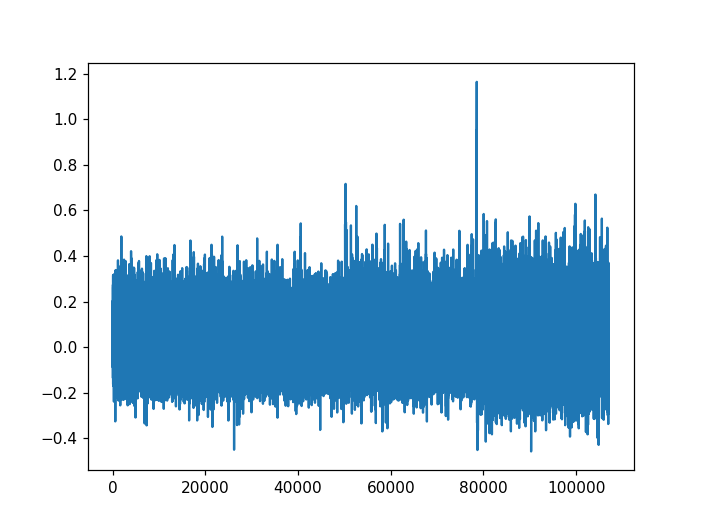

In [103]:
pl.figure()
pl.plot(all_frames[3300:])


# Check ROIs

In [104]:
def get_full_memmap_path(results_dir, framestr='order_C_frames', prefix='Yr'):
    print("Getting full mmap path for prefix: %s" % prefix)
    print("-- dir: %s" % results_dir)
    print(glob.glob(os.path.join(results_dir, 'memmap', '*%s*.mmap'))) 
    try:
        fname_new = glob.glob(os.path.join(results_dir, 'memmap', '*%s*_d*%s*_.mmap' % (prefix, framestr)))
        if len(fname_new) > 1:
            nframes = max([int(i.split('_')[-2]) for i in fname_new])
            framestr = '_frames_%i_' % nframes
            fname_new = glob.glob(os.path.join(results_dir, 'memmap', '*%s*_d*%s*_.mmap' % (prefix, framestr)))[0]
        else:
            assert len(fname_new)==1, "Unique fname_new not found: %s" % str(fname_new)
            fname_new = fname_new[0] 
        mm_prefix = os.path.splitext(os.path.split(fname_new)[-1])[0].split('_d1_')[0]
        print("CORRECTED PREFIX: %s" % mm_prefix)
    except Exception as e:
        print(e)
        return None
    return fname_new, mm_prefix



In [117]:

def get_roiid_from_traceid(animalid, session, fov, run_type=None, traceid='traces001', rootdir='/n/coxfs01/2p-data'):
    
    if run_type is not None:
        if int(session) < 20190511 and run_type == 'gratings':
            a_traceid_dict = glob.glob(os.path.join(rootdir, animalid, session, fov, '*run*', 'traces', 'traceids*.json'))[0]
        else:
            a_traceid_dict = glob.glob(os.path.join(rootdir, animalid, session, fov, '*%s*' % run_type, 'traces', 'traceids*.json'))[0]
    else:
        a_traceid_dict = glob.glob(os.path.join(rootdir, animalid, session, fov, '*run*', 'traces', 'traceids*.json'))[0]
    with open(a_traceid_dict, 'r') as f:
        tracedict = json.load(f)
    
    tid = tracedict[traceid]
    roiid = tid['PARAMS']['roi_id']
    
    return roiid


def load_roi_masks(animalid, session, fov, rois=None, rootdir='/n/coxfs01/2p-data'):
    masks=None; zimg=None;
    mask_fpath = glob.glob(os.path.join(rootdir, animalid, session, 'ROIs', '%s*' % rois, 'masks.hdf5'))[0]
    try:
        mfile = h5py.File(mask_fpath, 'r')

        # Load and reshape masks
        fkey = list(mfile.keys())[0]
        masks = mfile[fkey]['masks']['Slice01'][:] #.T
        #print(masks.shape)
        #mfile[mfile.keys()[0]].keys()

        zimg = mfile[fkey]['zproj_img']['Slice01'][:] #.T
        zimg.shape
    except Exception as e:
        print("error loading masks")
    finally:
        mfile.close()
        
    return masks, zimg

# def reshape_and_binarize_masks(masks):
#     # Binarze and reshape:
#     nrois, d1, d2 = masks.shape
#     Ain = np.reshape(masks, (nrois, d1*d2))
#     Ain[Ain>0] = 1
#     Ain = Ain.astype(bool).T 
    
#     return Ain

def reshape_and_binarize_masks(masks):
    # Binarze and reshape:
    nrois, d1, d2 = masks.shape
    #masks2 = np.swapaxes(masks, 1, 2)
    Ain = np.reshape(masks, (nrois, d1*d2))
    Ain[Ain>0] = 1
    Ain = Ain.astype(bool).T 
    
    return Ain



In [122]:
# Load manual ROIs and format
traceid = 'traces001'
print("Getting seeds...")
roiid = get_roiid_from_traceid(animalid, session, fov, run_type=exp, traceid=traceid)
masks, zimg = load_roi_masks(animalid, session, fov, rois=roiid)
#img = zimg.T
Ain = reshape_and_binarize_masks(masks)
print(roiid)

Getting seeds...
rois001


In [106]:
# Reshape NMF ROIs

fname_tot, mm_prefix = get_full_memmap_path(results_dir, prefix='-'.join([animalid, session, fov, exp, 'Yr']))
print("Extracting CNMF from: %s" % fname_tot)
Yr, dims, T = cm.load_memmap(fname_tot)


Getting full mmap path for prefix: JC084-20190522-FOV1_zoom2p0x-gratings-Yr
-- dir: /n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings
[]
CORRECTED PREFIX: JC084-20190522-FOV1_zoom2p0x-gratings-Yr
Extracting CNMF from: /n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/memmap/JC084-20190522-FOV1_zoom2p0x-gratings-Yr_d1_512_d2_512_d3_1_order_C_frames_142910_.mmap


In [128]:
# Reshape 
#masks_nmf = np.reshape(cnm.estimates.A.toarray(), (dims[0], dims[1], nrois), order='F') 
#masks_nmf.shape

(512, 512, 260)

In [142]:
masks_seed = np.reshape(Ain, (dims[0], dims[1], nrois), order='F')

In [143]:
#masks_seed = Ain.reshape(512, 512, 260, order='C') #.sum(axis=-1)
masks_nmf = np.reshape(cnm.estimates.A.toarray(), (dims[0], dims[1], nrois), order='F') 

#### Plot manual vs. nmf ROIs

<IPython.core.display.Javascript object>


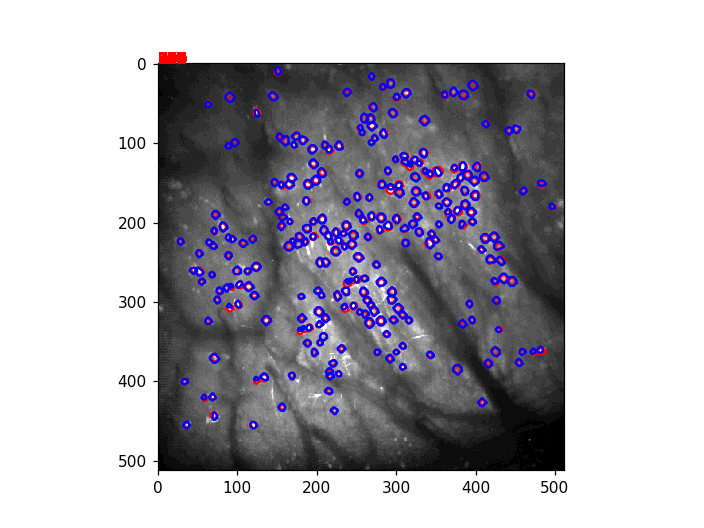

In [161]:
pl.figure()
cm.utils.visualization.plot_contours(Ain, zimg.T, cmap='gray', colors='r')
cm.utils.visualization.plot_contours(cnm.estimates.A.toarray(), zimg.T, cmap='gray', colors='b', max_number=0)
pl.savefig(os.path.join(results_dir, 'seeded-vs-nmf.png'))

#### Look at individual ROIs

<IPython.core.display.Javascript object>


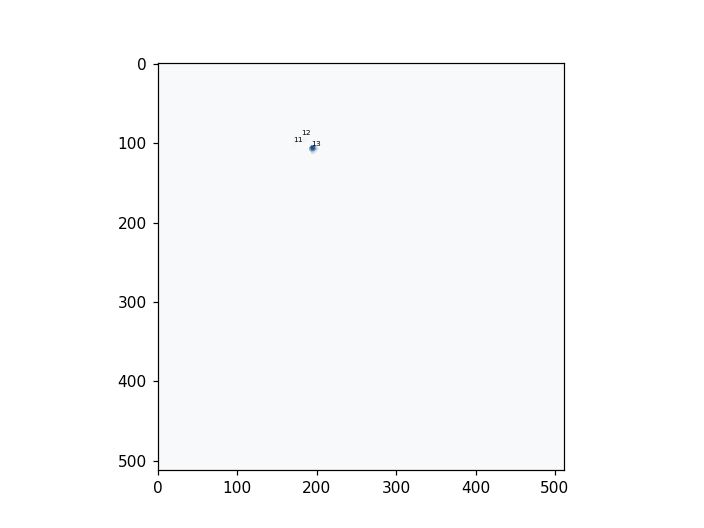

In [135]:
pl.figure()

for ri in [10,11,12]:
    pl.imshow(np.reshape(cnm.estimates.A[:,ri].toarray(), dims, order='F'), alpha=0.2, cmap='Reds')
    y, x = np.where(np.reshape(cnm.estimates.A[:,ri].toarray(), dims, order='F'))
    pl.text(x[0], y[0], '%i' % (ri+1), fontsize=5)
    pl.imshow(masks_nmf[:, :, 12], alpha=0.5, cmap='Blues')


<IPython.core.display.Javascript object>


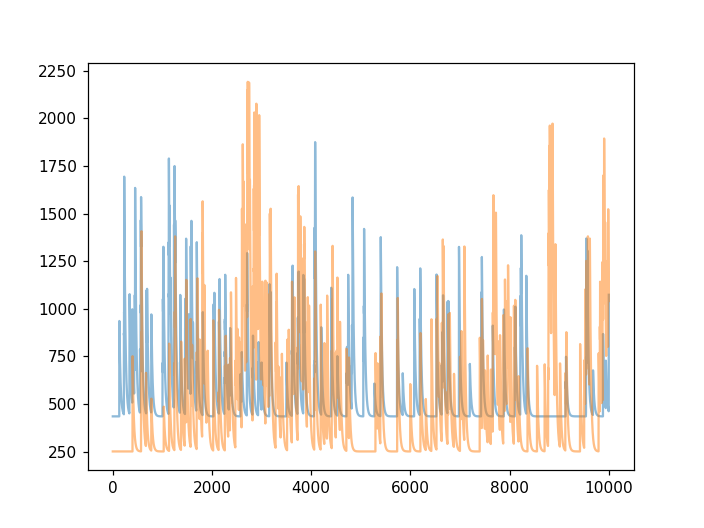

In [98]:
pl.figure()
pl.plot(extracted_traces[11,0:10000], alpha=0.5)
#pl.plot(extracted_traces[12,0:10000], alpha=0.5)
pl.plot(extracted_traces[13,0:10000], alpha=0.5)


#### Plot psths

In [109]:
manualdir.split('/data_arrays')[0]

'/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_55a5cc_traces001_7eef99_traces001_809b80_traces001_fbc03e'

In [110]:
psth_dir = os.path.join(manualdir.split('/data_arrays')[0], 'figures', 'psth_caiman_%s' % trace_type)
if not os.path.exists(psth_dir):
    os.makedirs(psth_dir)
print(psth_dir)

/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_55a5cc_traces001_7eef99_traces001_809b80_traces001_fbc03e/figures/psth_caiman_dff


In [111]:
stim_on = labels_c['stim_on_frame'].unique()[0]
nframes_on = labels_c['nframes_on'].unique()[0]     

In [112]:
all_frames.shape

(110360,)

In [113]:
labels_c.shape

(110360, 12)

In [114]:
rdata = labels_c.copy()
rdata['trace'] = all_frames #manual[rid]


In [115]:
meandfs = []
for k, g in rdata.groupby(['config']):
    mean_trace = g.groupby(['trial'])[ylabel].apply(np.array).mean(axis=0)
    mean_tsec = g.groupby(['trial'])['tsec'].apply(np.array).mean(axis=0)
    sem_trace = stats.sem(np.vstack(g.groupby(['trial'])[ylabel].apply(np.array)), axis=0)
    mdf = pd.DataFrame({'%s' % ylabel: mean_trace,
                        'tsec': mean_tsec,
                        'sem': sem_trace,
                        'fill_minus': mean_trace - sem_trace,
                        'fill_plus': mean_trace + sem_trace,
                        'config': [k for _ in range(len(mean_trace))]})
    for p in plot_params.values():
        mdf[p] = [round(sdf[p][cfg], 1) if isinstance(sdf[p][cfg], (float)) else sdf[p][cfg] for cfg in mdf['config']]
    meandfs.append(mdf)

meandfs = pd.concat(meandfs, axis=0)

<IPython.core.display.Javascript object>


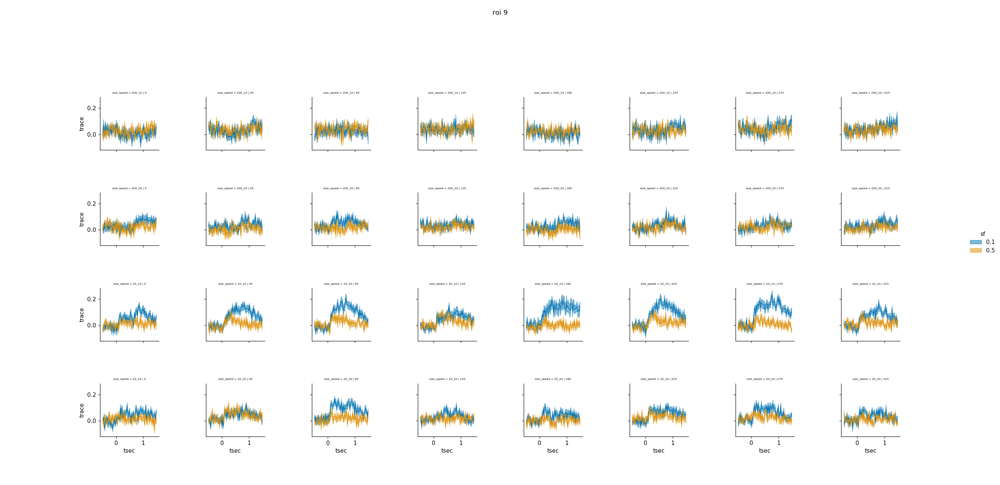

roi9_temporal.png


In [116]:
p = sns.FacetGrid(meandfs, col=plot_params['cols'], row=plot_params['rows'], hue=plot_params['hue'],\
                  sharex=True, sharey=True, palette=palette)


p = p.map(pl.fill_between, "tsec", "fill_minus", "fill_plus", alpha=0.5) 
p = (p.map(pl.plot, "tsec", ylabel, lw=1, alpha=1).add_legend())  
p = p.set_titles(col_template="{col_name}", size=5)      

pl.subplots_adjust(wspace=0.8, hspace=0.8, top=0.8, bottom=0.1, left=0.1, right=0.9)

p.fig.suptitle('roi %i' % int(rid+1))
figname = 'roi%i_temporal.png' % int(rid+1)
#pl.savefig(os.path.join(psth_dir, figname))
print(figname)

# Plot all rois

In [162]:
psth_dir

'/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_55a5cc_traces001_7eef99_traces001_809b80_traces001_fbc03e/figures/psth_caiman_dff'

In [163]:
nrois

260

/n/coxfs01/2p-pipeline/envs/caiman/lib/python3.7/site-packages/seaborn/axisgrid.py:230: UserWarning: The `size` paramter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


<IPython.core.display.Javascript object>


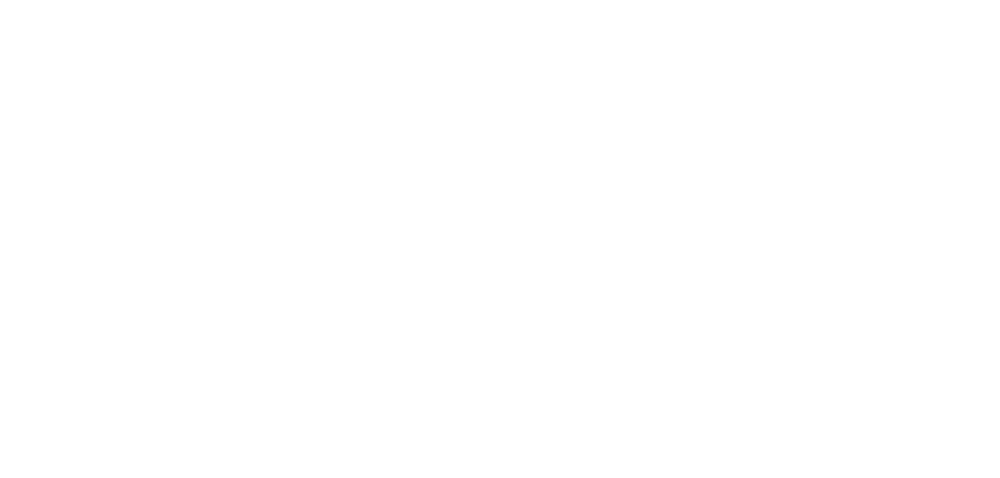

roi1_dff.png


<IPython.core.display.Javascript object>


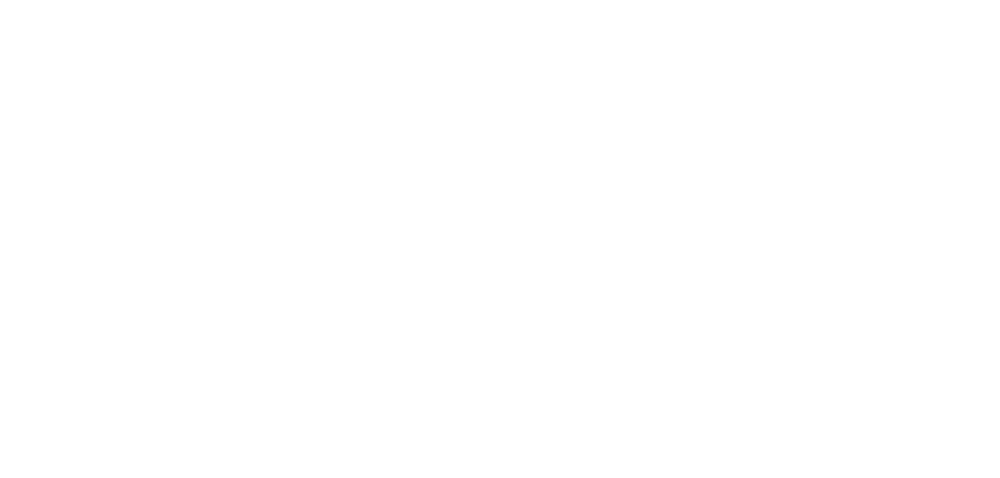

roi2_dff.png


<IPython.core.display.Javascript object>


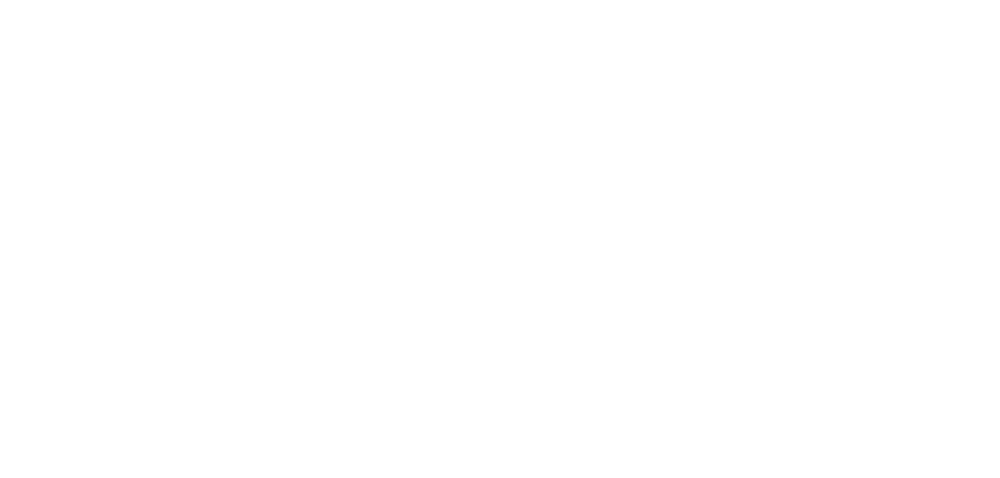

roi3_dff.png


<IPython.core.display.Javascript object>


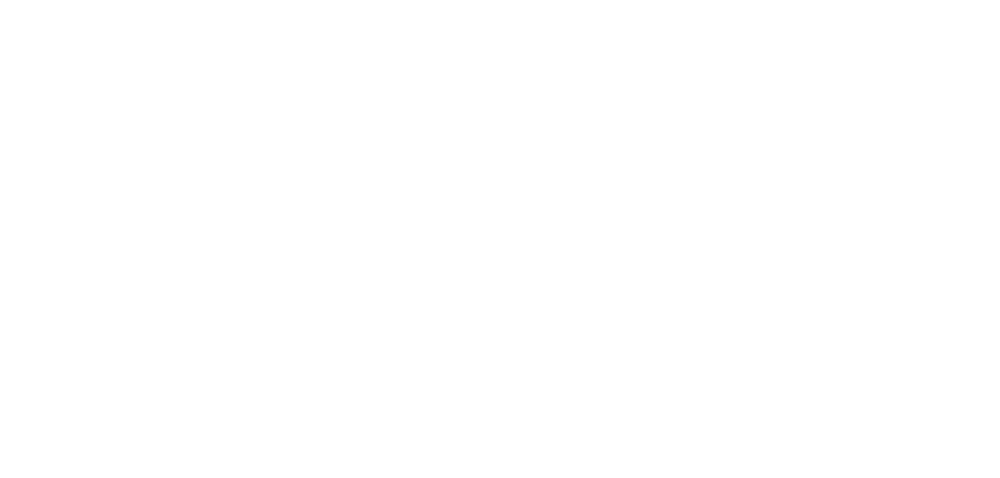

roi4_dff.png


<IPython.core.display.Javascript object>


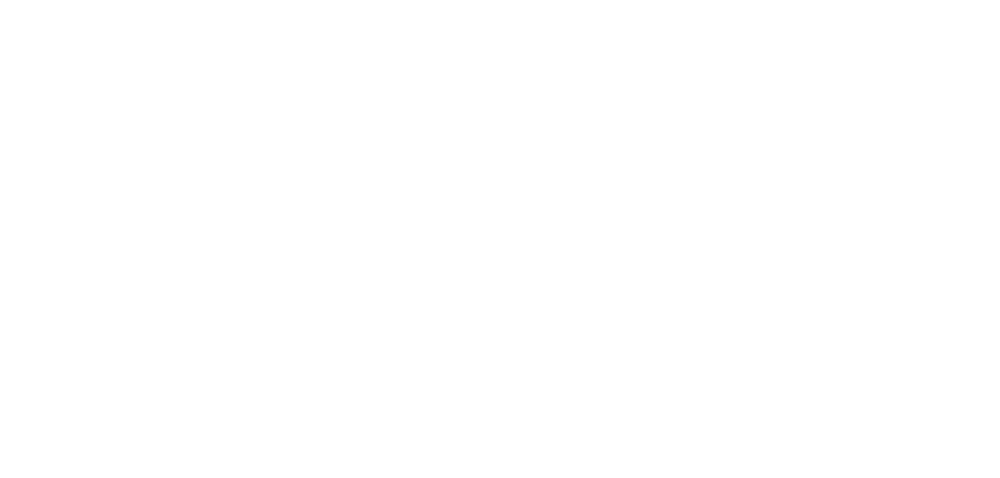

roi5_dff.png


<IPython.core.display.Javascript object>


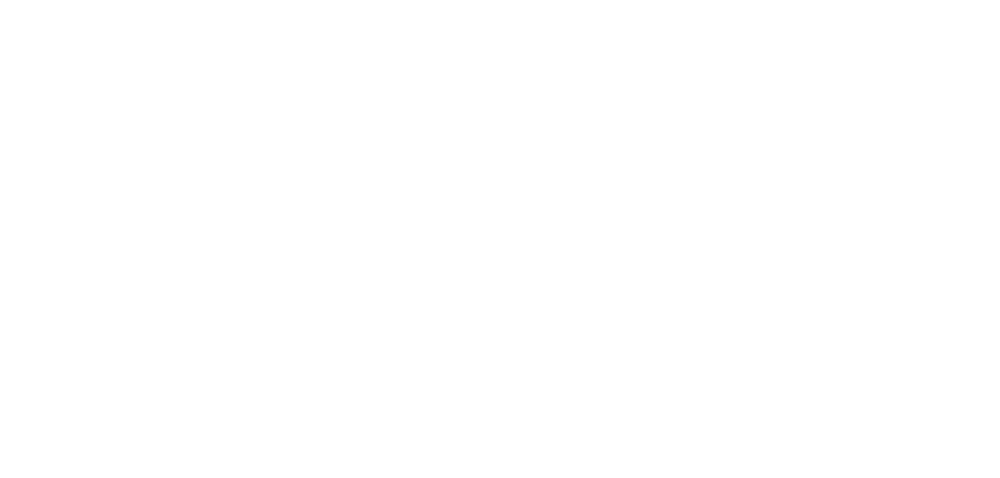

roi6_dff.png


<IPython.core.display.Javascript object>


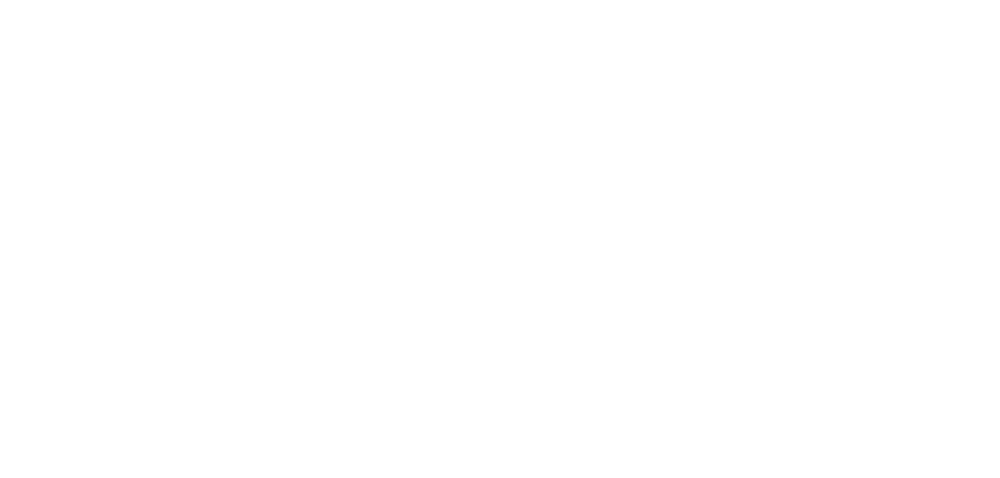

roi7_dff.png


<IPython.core.display.Javascript object>


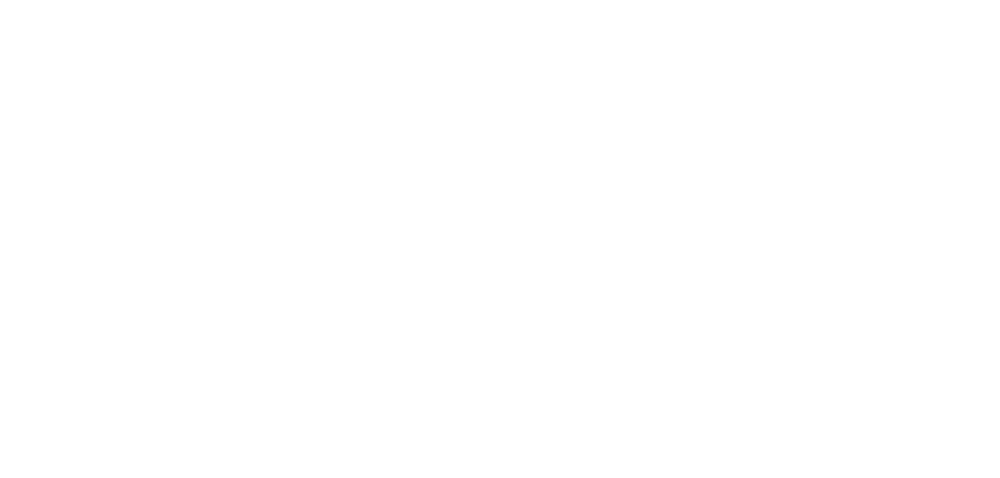

roi8_dff.png


<IPython.core.display.Javascript object>


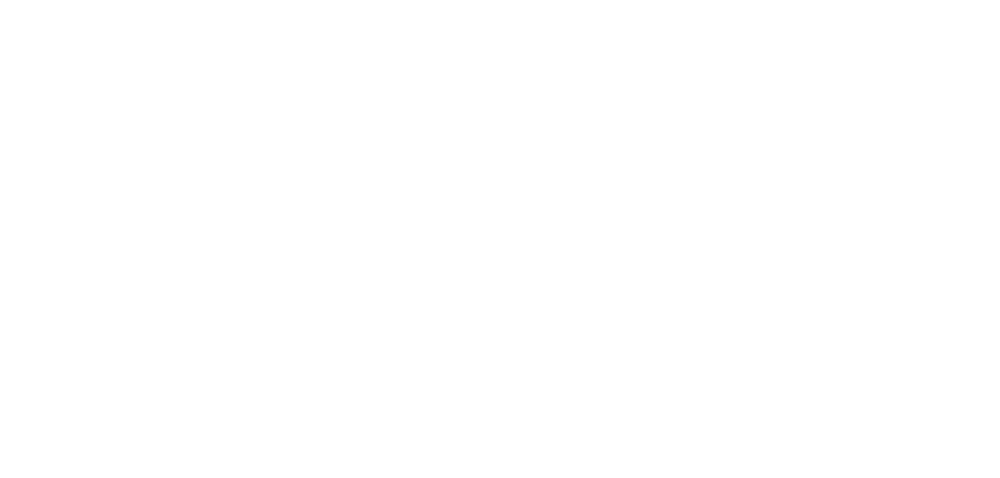

roi9_dff.png


<IPython.core.display.Javascript object>


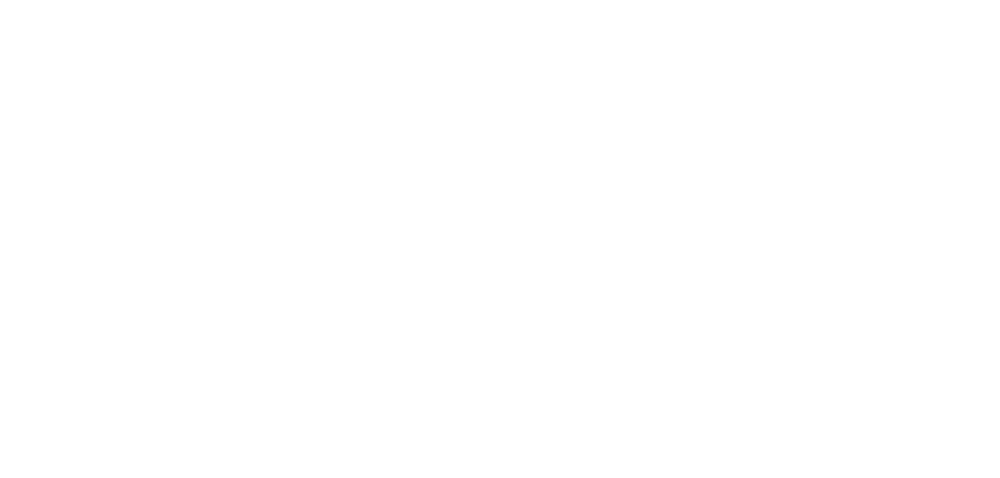

roi10_dff.png


<IPython.core.display.Javascript object>


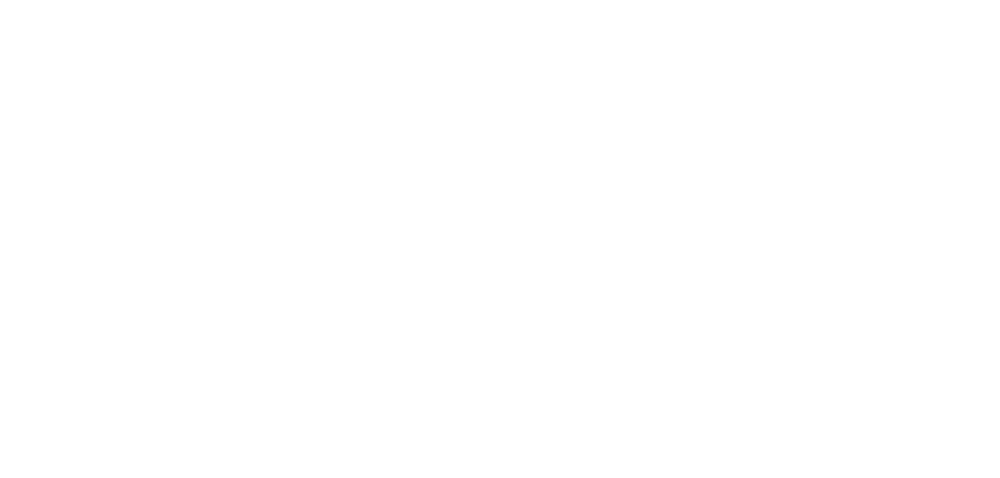

roi11_dff.png


<IPython.core.display.Javascript object>


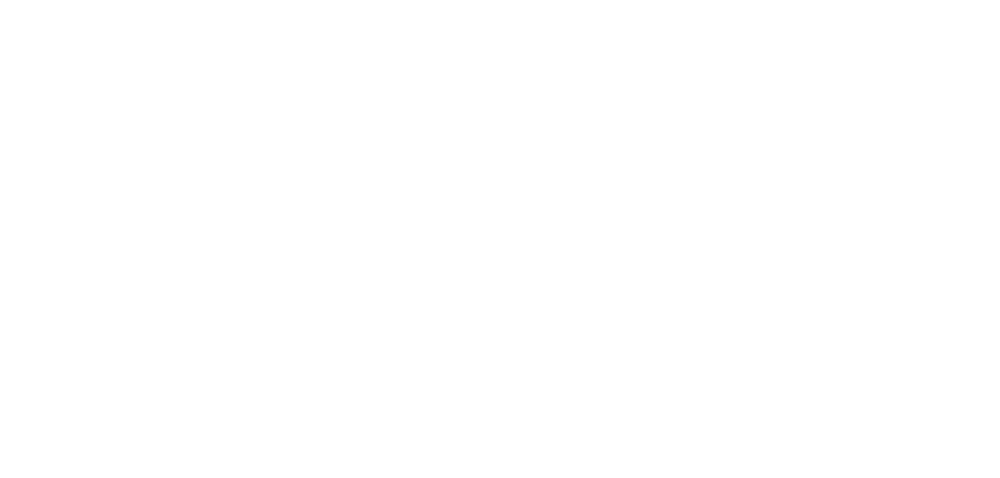

roi12_dff.png


<IPython.core.display.Javascript object>


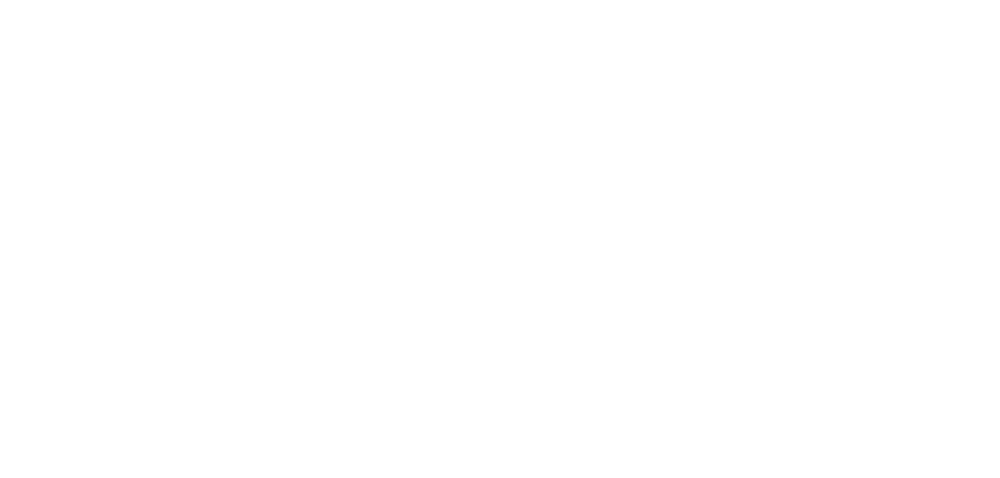

roi13_dff.png


<IPython.core.display.Javascript object>


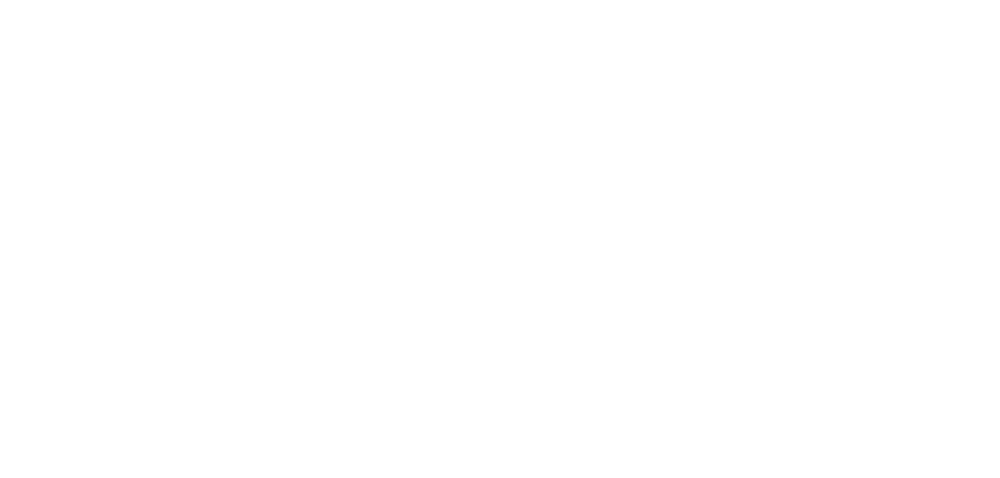

roi14_dff.png


<IPython.core.display.Javascript object>


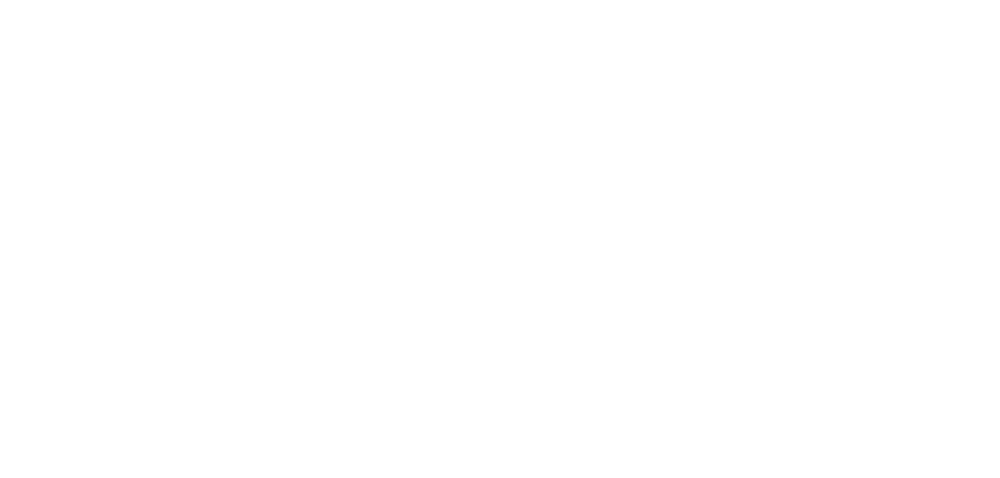

roi15_dff.png


<IPython.core.display.Javascript object>


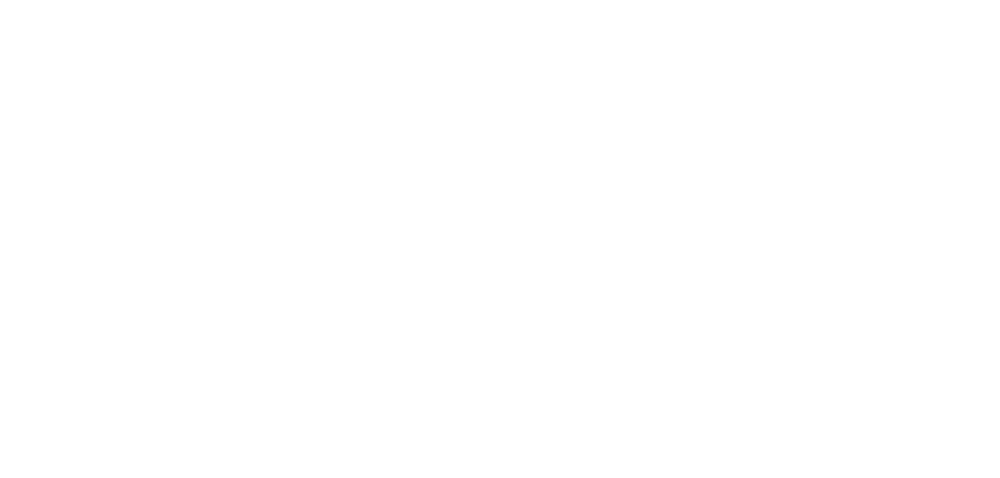

roi16_dff.png


<IPython.core.display.Javascript object>


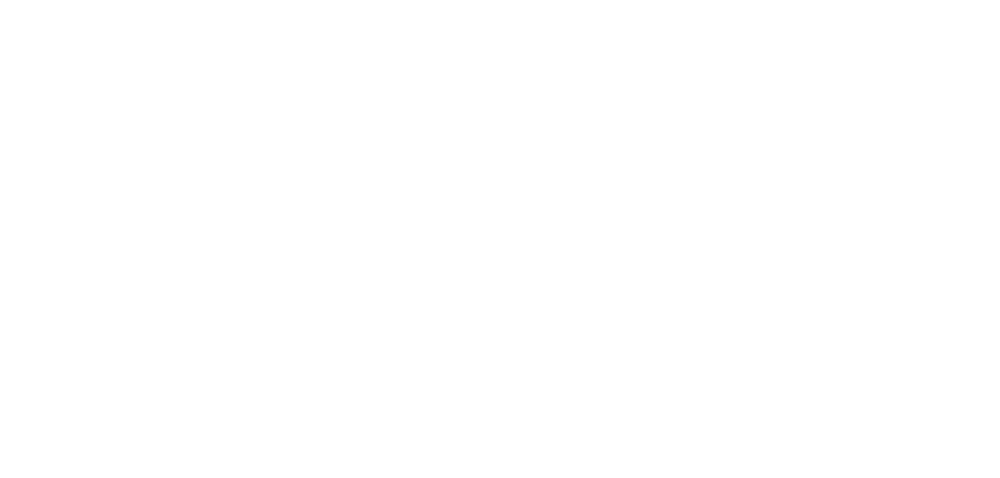

roi17_dff.png


<IPython.core.display.Javascript object>


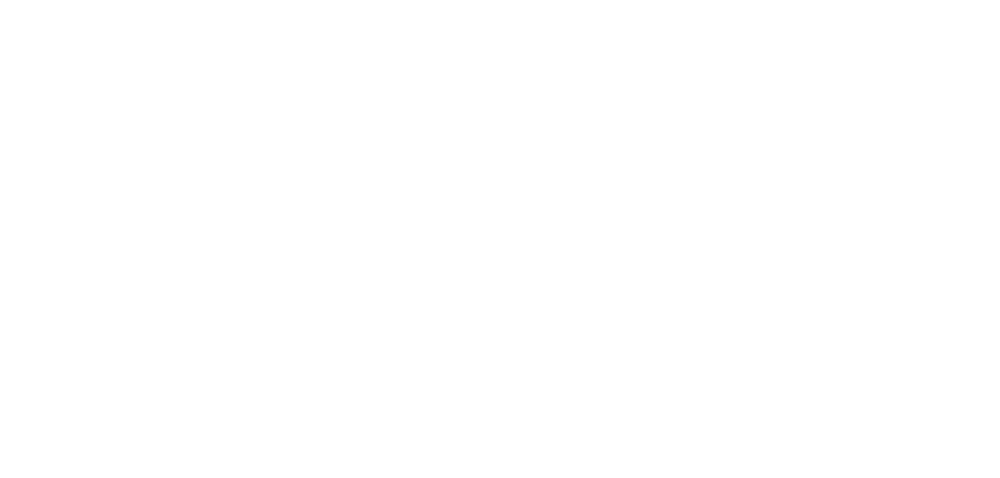

roi18_dff.png


<IPython.core.display.Javascript object>


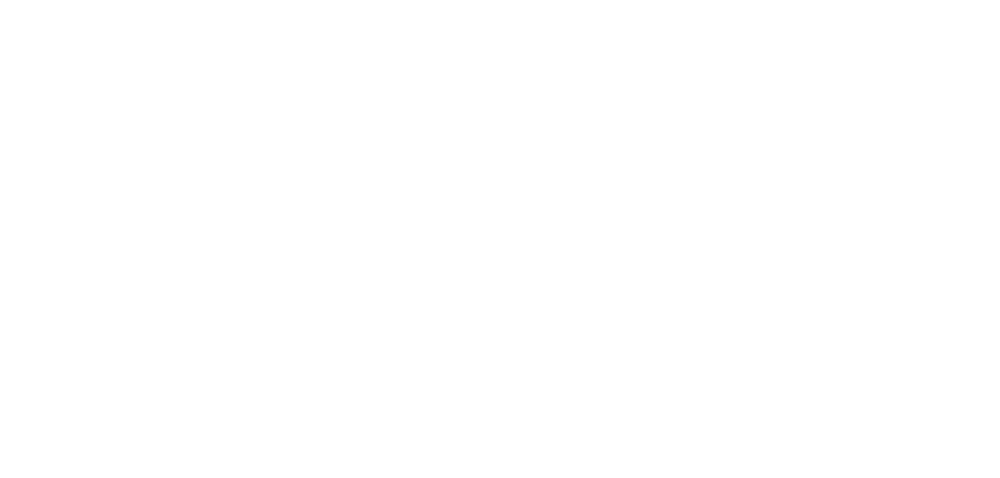

roi19_dff.png


<IPython.core.display.Javascript object>


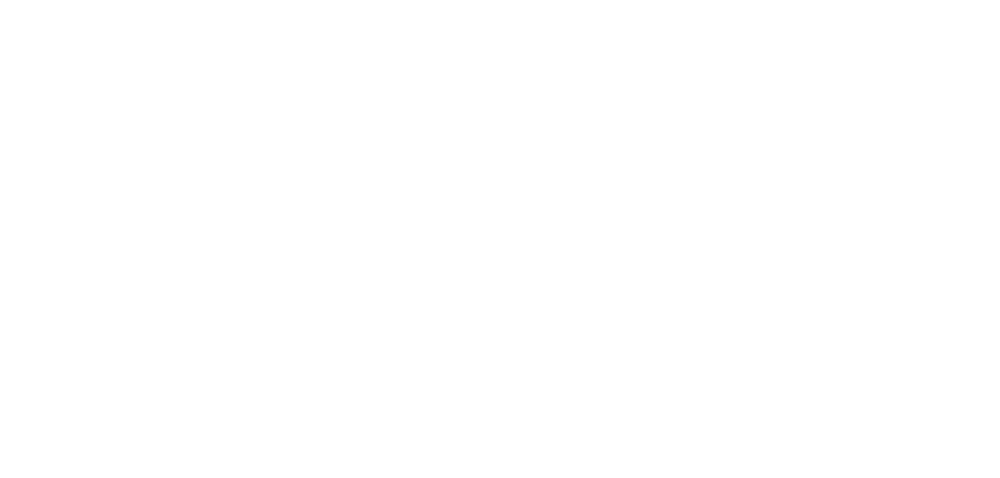

roi20_dff.png


<IPython.core.display.Javascript object>


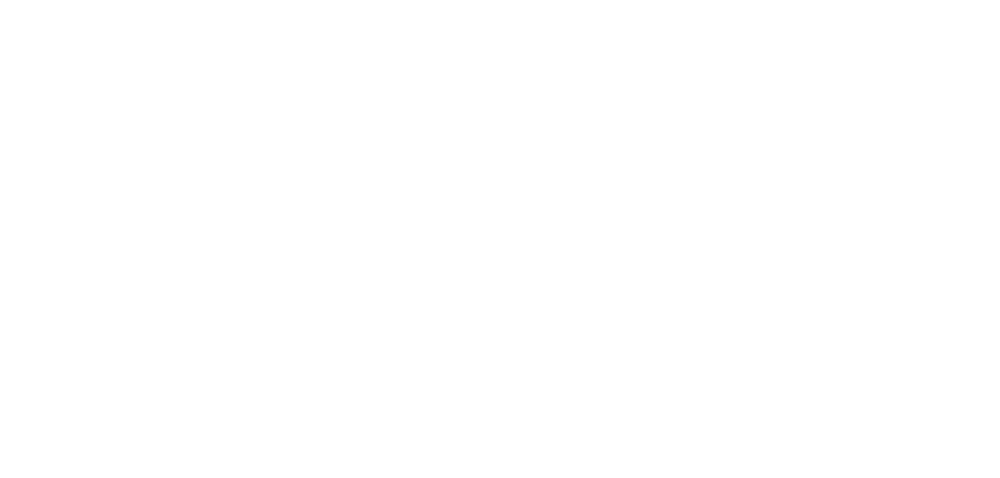

roi21_dff.png


<IPython.core.display.Javascript object>


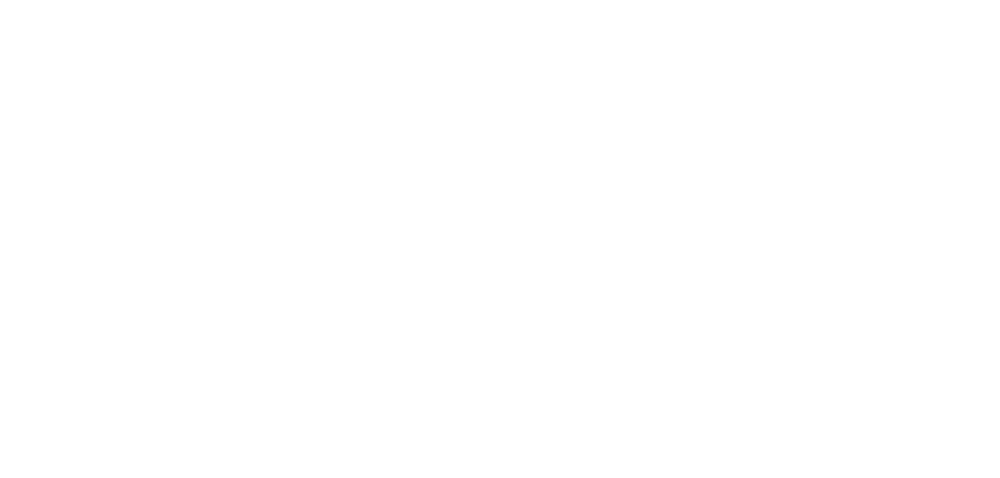

roi22_dff.png


<IPython.core.display.Javascript object>


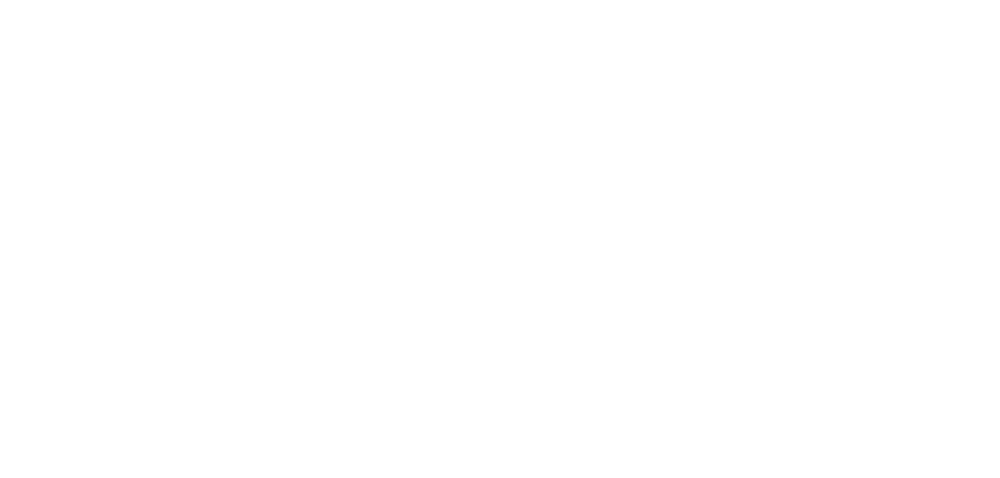

roi23_dff.png


<IPython.core.display.Javascript object>


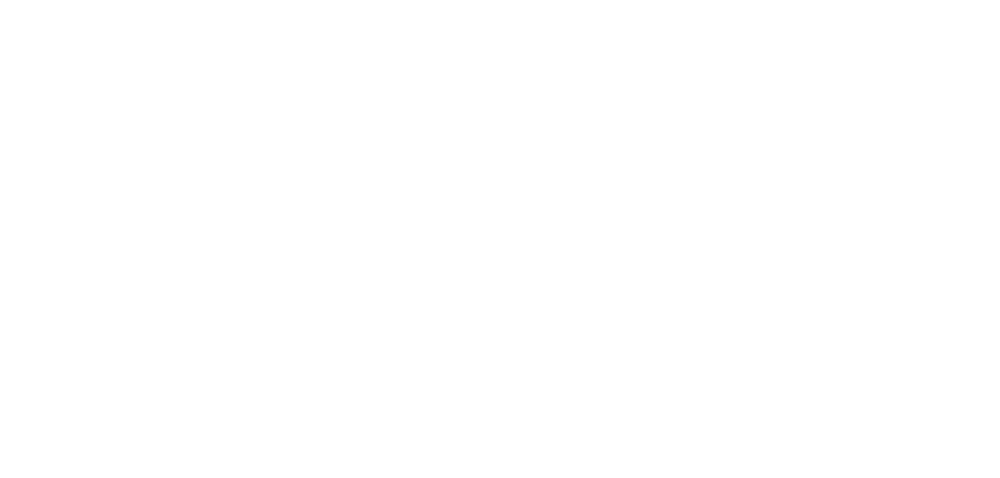

roi24_dff.png


<IPython.core.display.Javascript object>


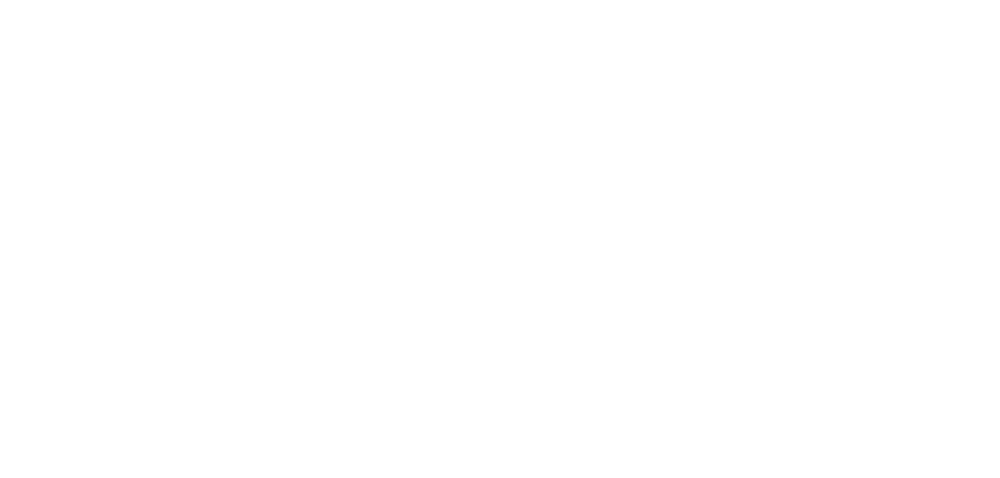

roi25_dff.png


<IPython.core.display.Javascript object>


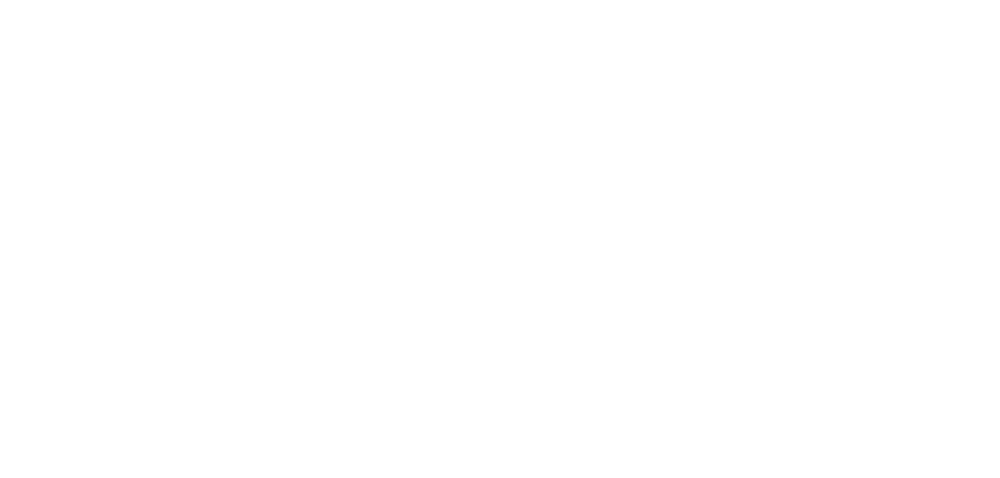

roi26_dff.png


<IPython.core.display.Javascript object>


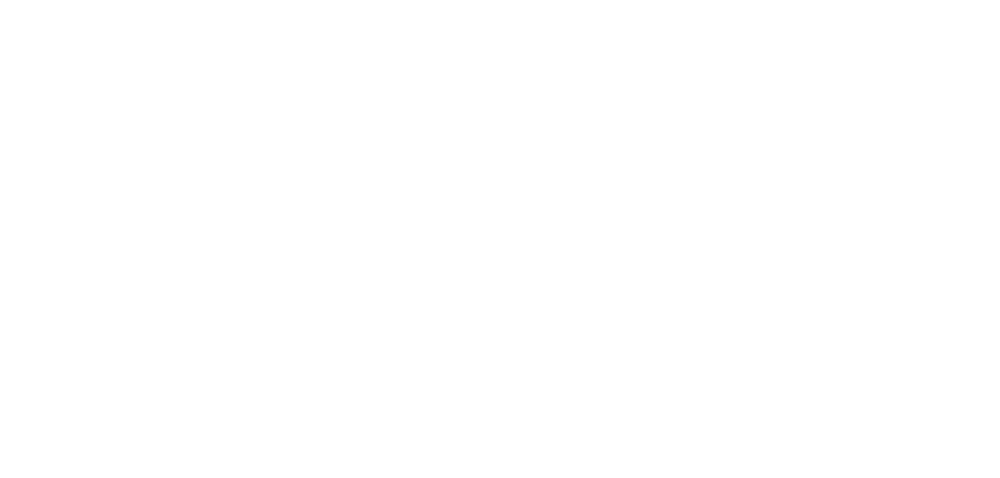

roi27_dff.png


<IPython.core.display.Javascript object>


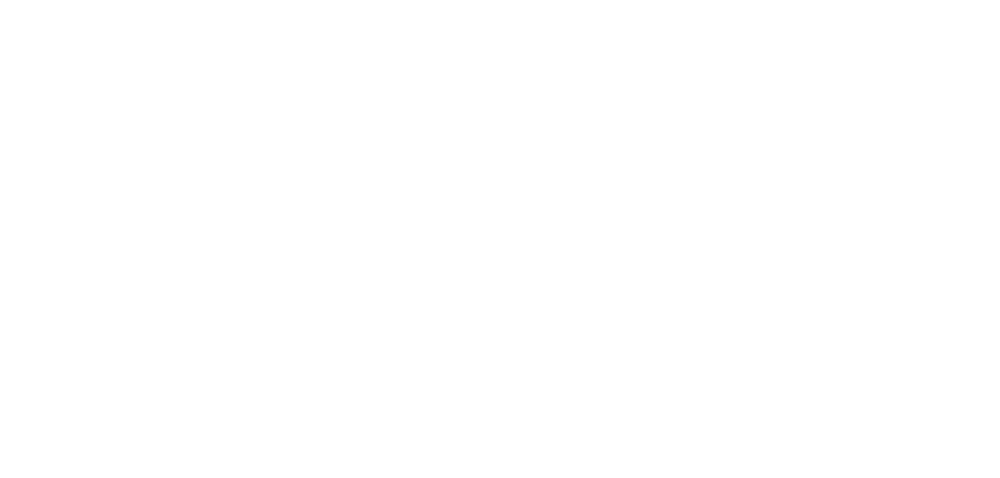

roi28_dff.png


<IPython.core.display.Javascript object>


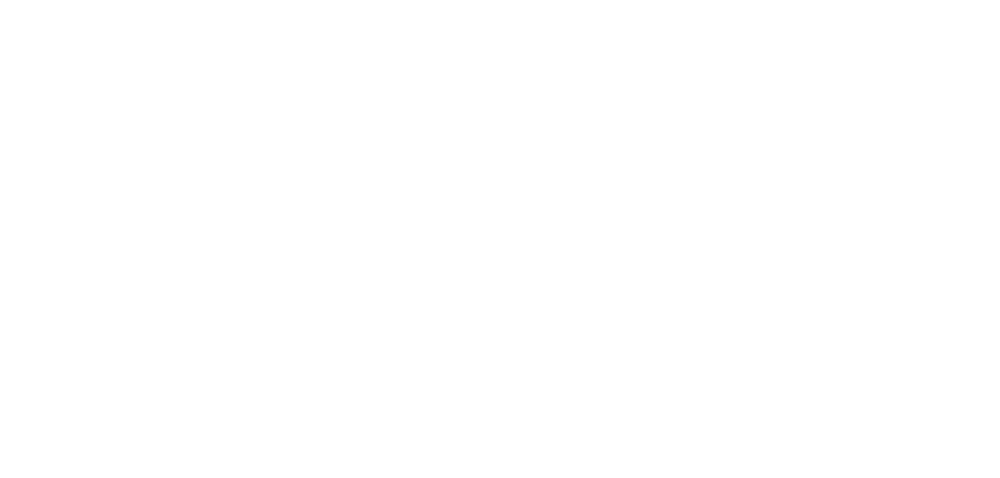

roi29_dff.png


<IPython.core.display.Javascript object>


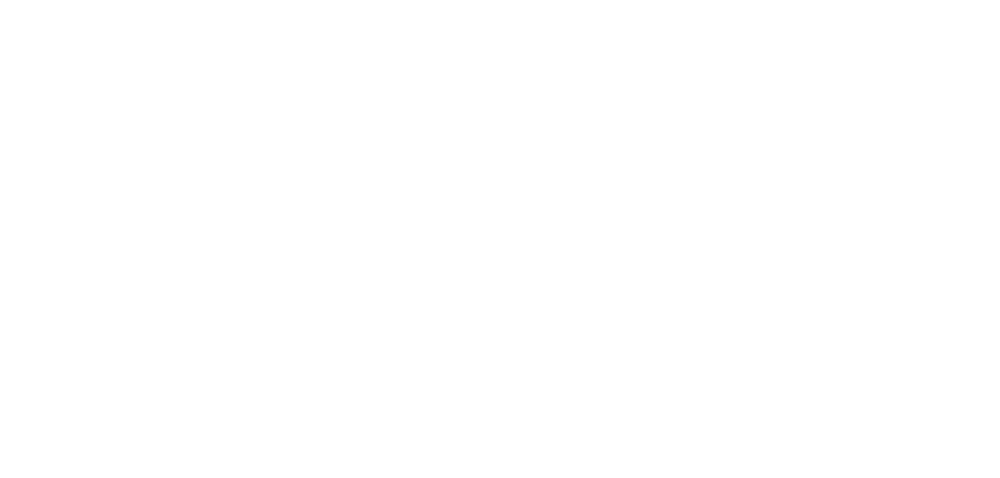

roi30_dff.png


<IPython.core.display.Javascript object>


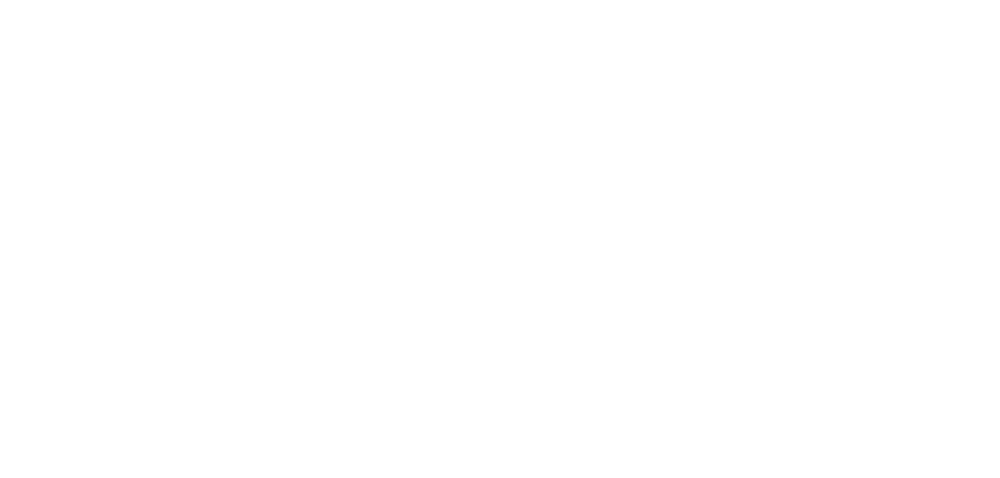

roi31_dff.png


<IPython.core.display.Javascript object>


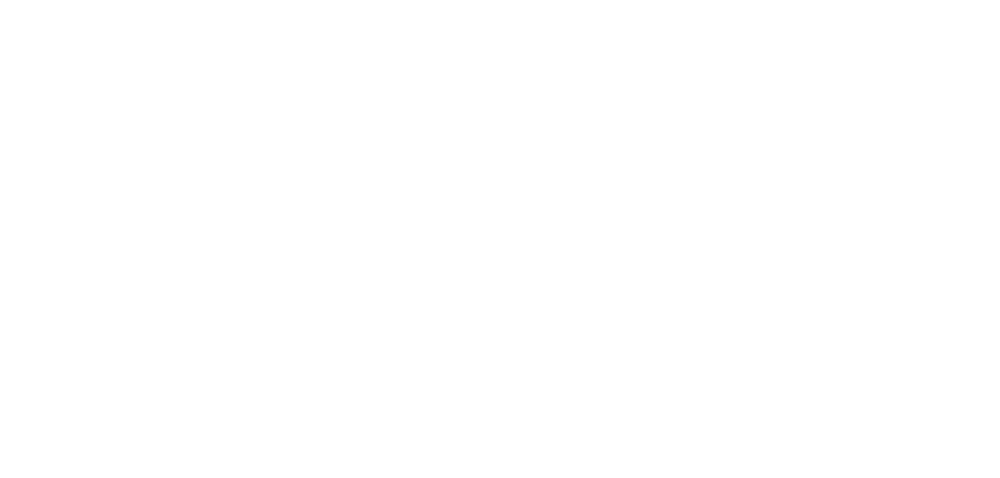

roi32_dff.png


<IPython.core.display.Javascript object>


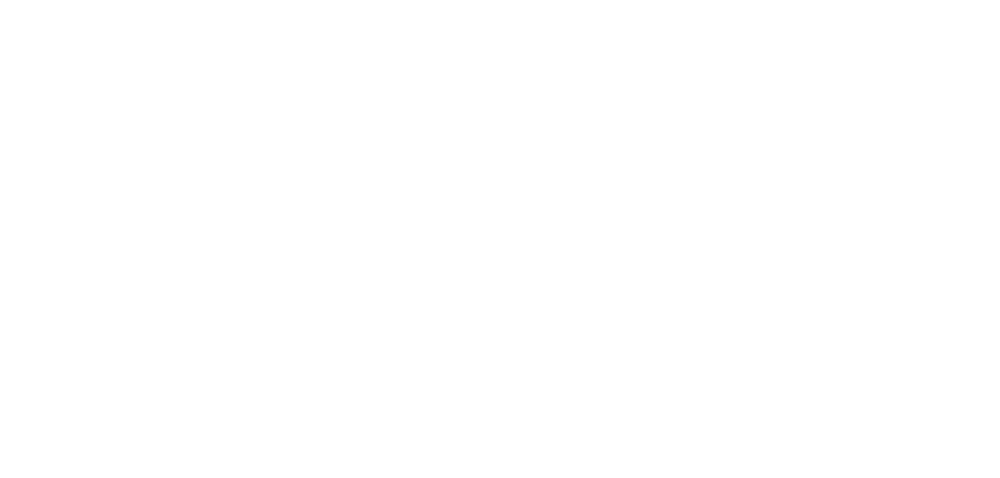

roi33_dff.png


<IPython.core.display.Javascript object>


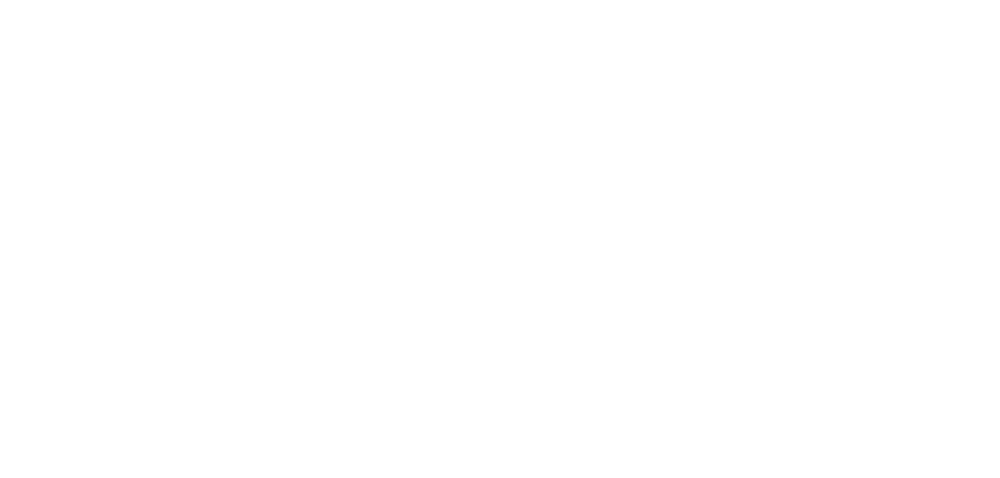

roi34_dff.png


<IPython.core.display.Javascript object>


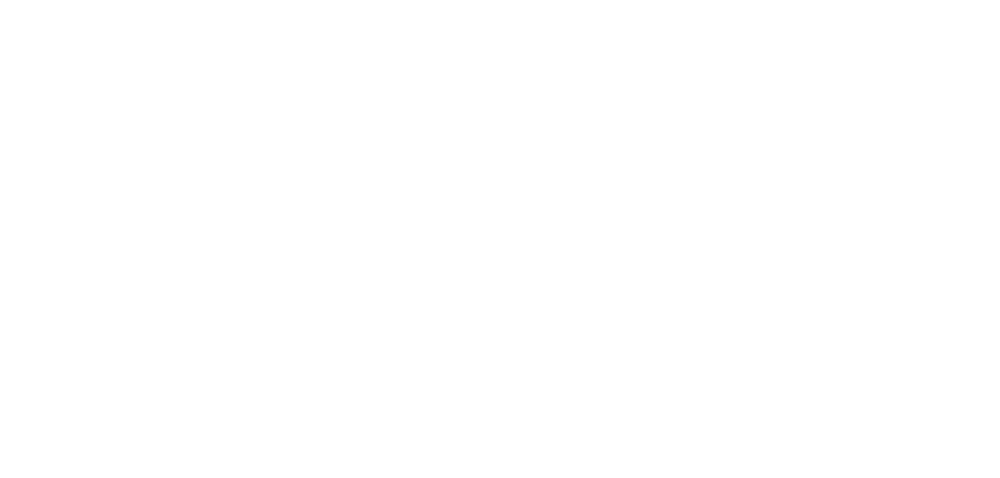

roi35_dff.png


<IPython.core.display.Javascript object>


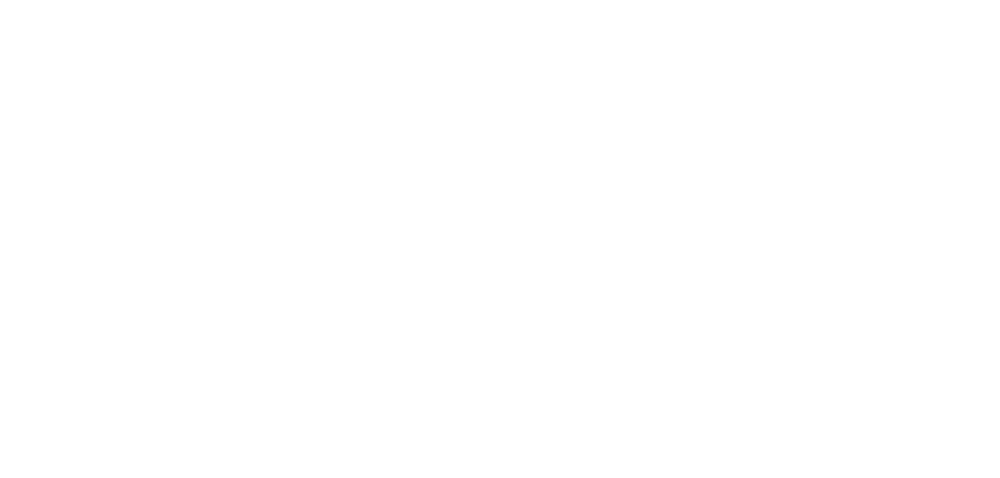

roi36_dff.png


<IPython.core.display.Javascript object>


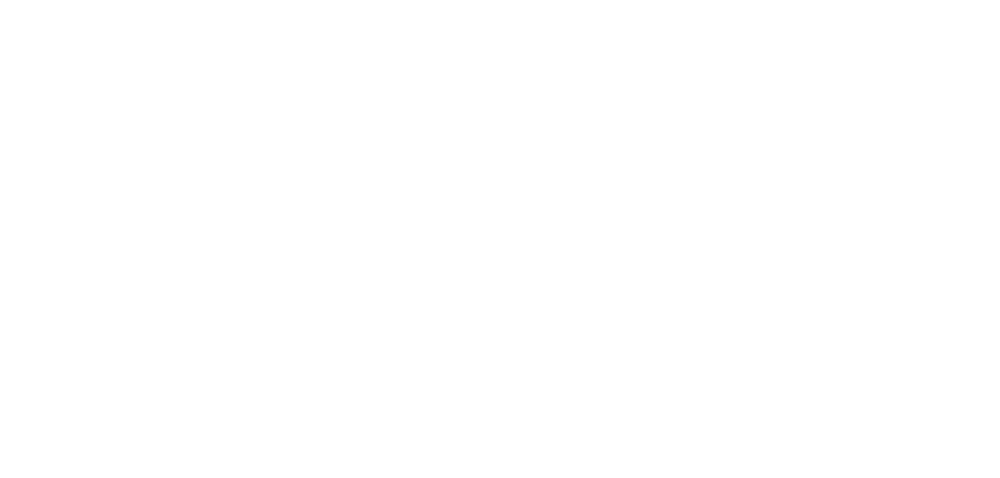

roi37_dff.png


<IPython.core.display.Javascript object>


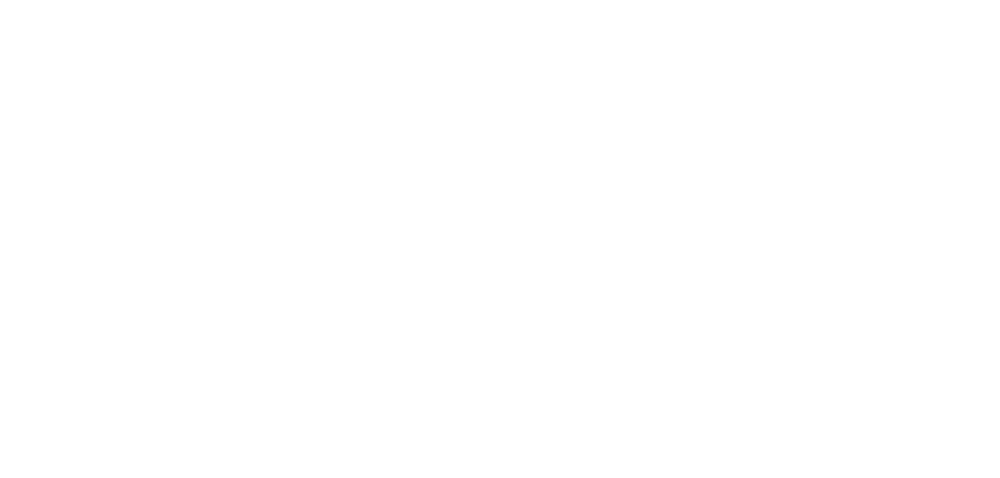

roi38_dff.png


<IPython.core.display.Javascript object>


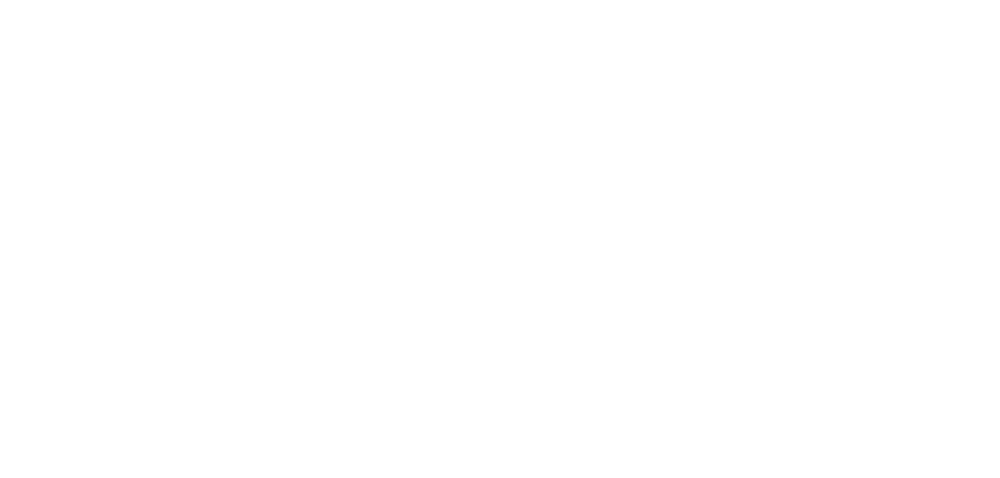

roi39_dff.png


<IPython.core.display.Javascript object>


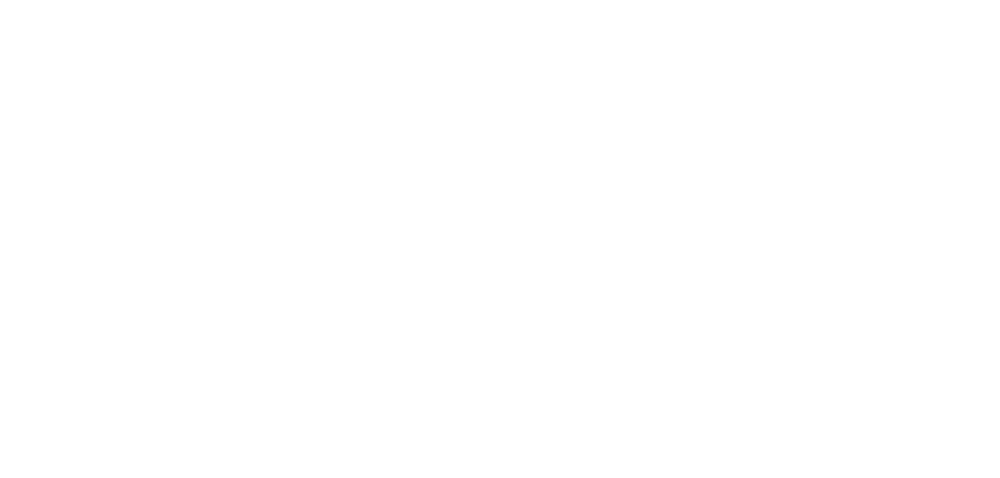

roi40_dff.png


<IPython.core.display.Javascript object>


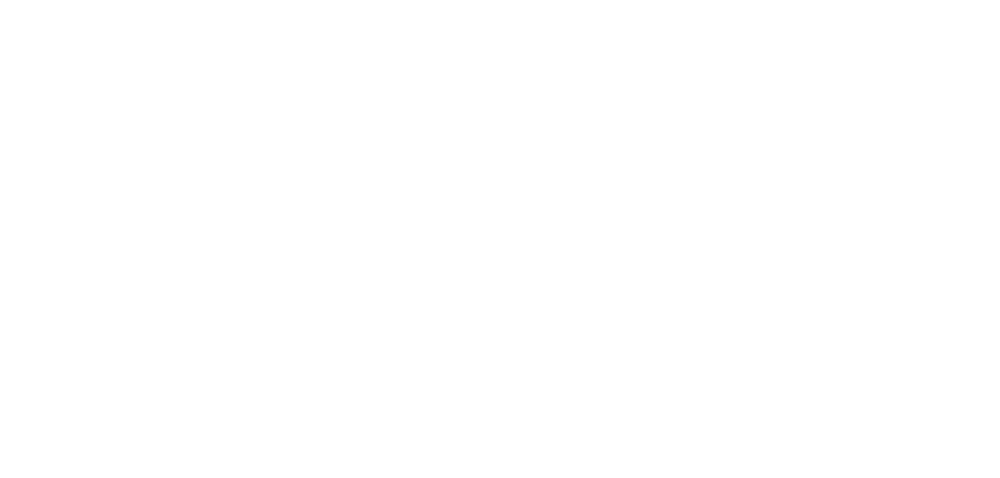

roi41_dff.png


<IPython.core.display.Javascript object>


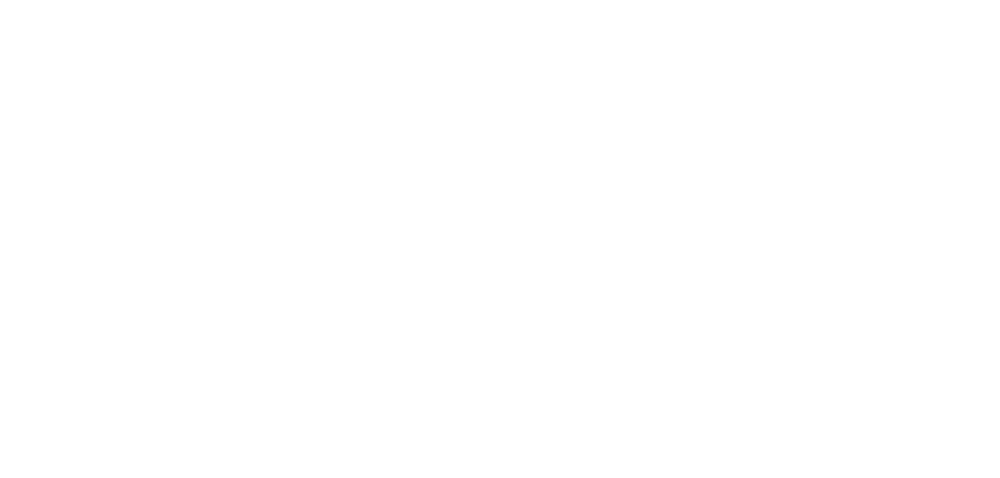

roi42_dff.png


<IPython.core.display.Javascript object>


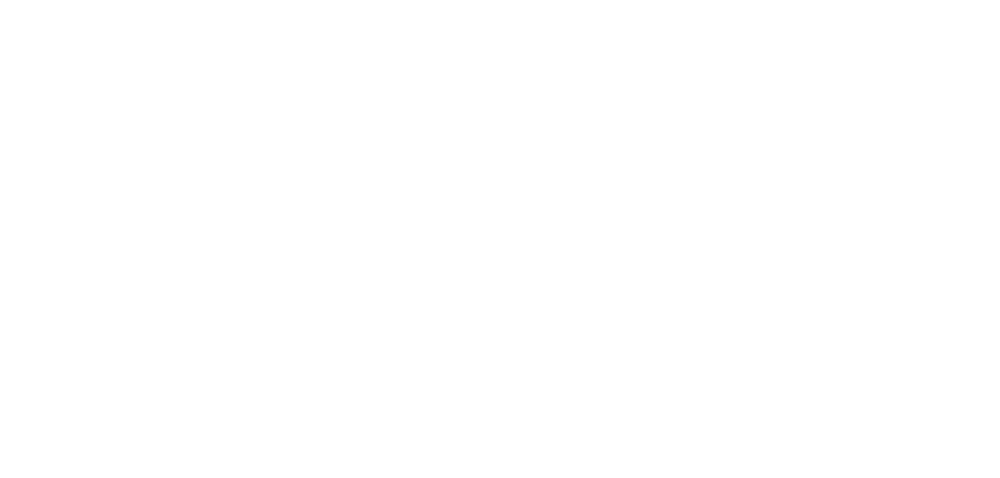

roi43_dff.png


<IPython.core.display.Javascript object>


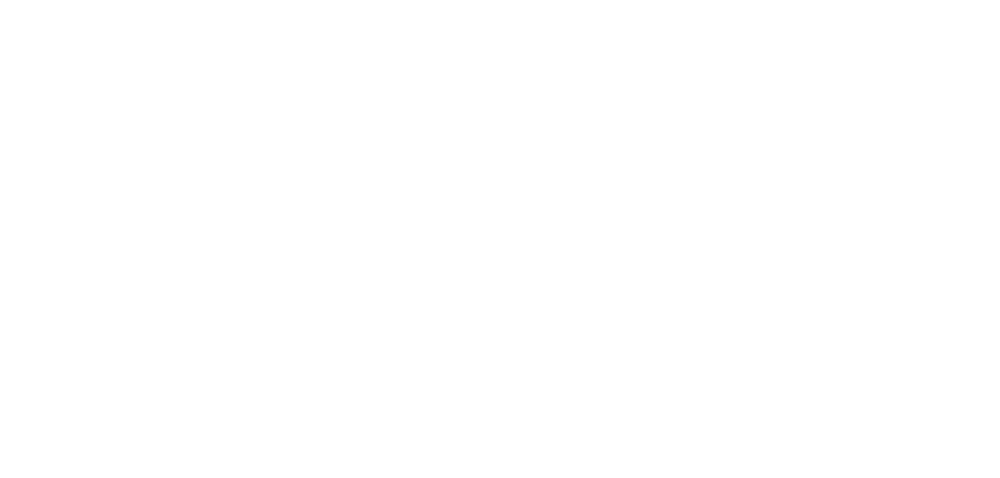

roi44_dff.png


<IPython.core.display.Javascript object>


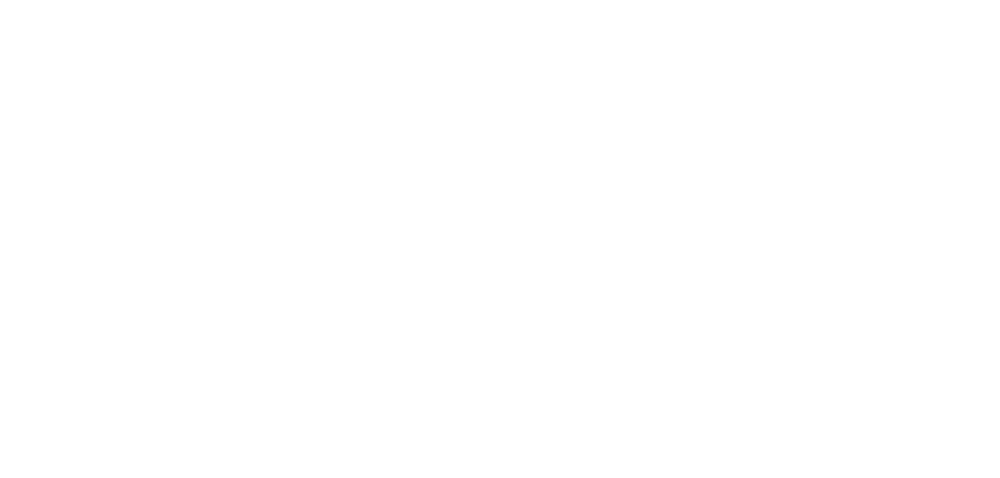

roi45_dff.png


<IPython.core.display.Javascript object>


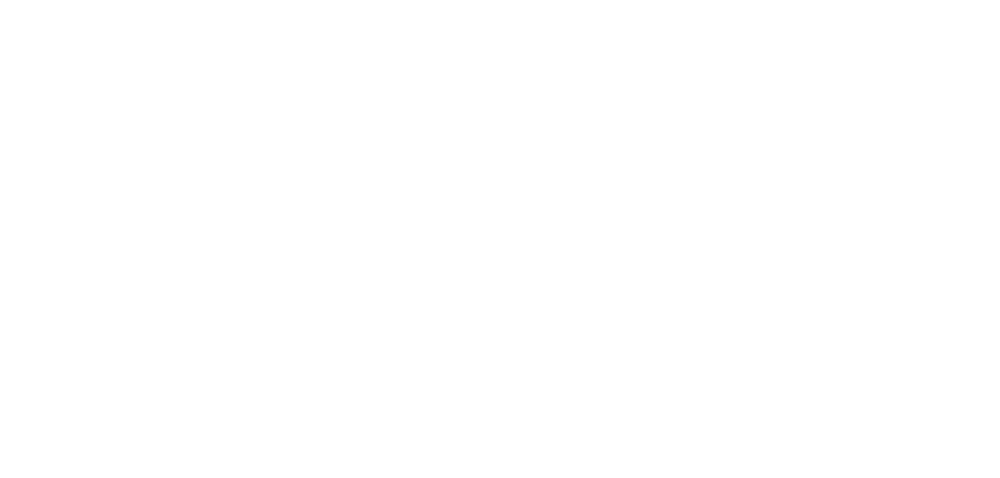

roi46_dff.png


<IPython.core.display.Javascript object>


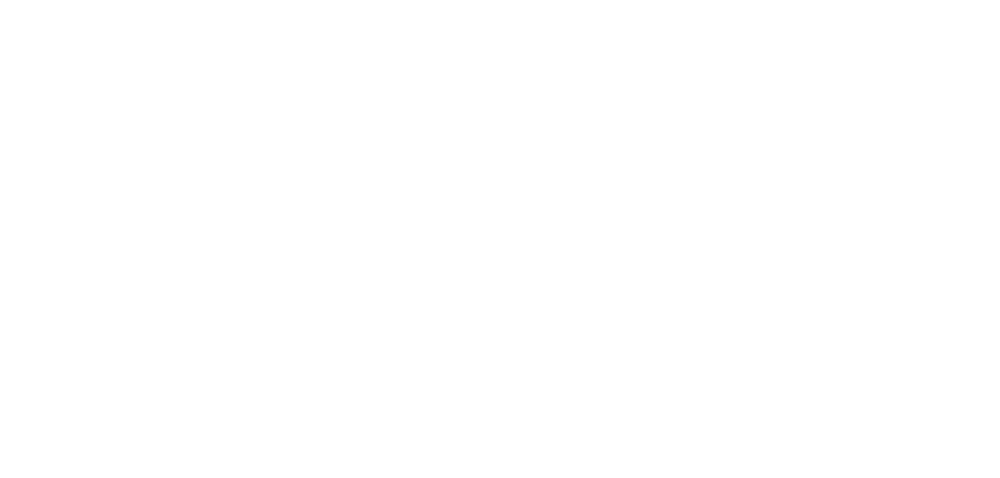

roi47_dff.png


<IPython.core.display.Javascript object>


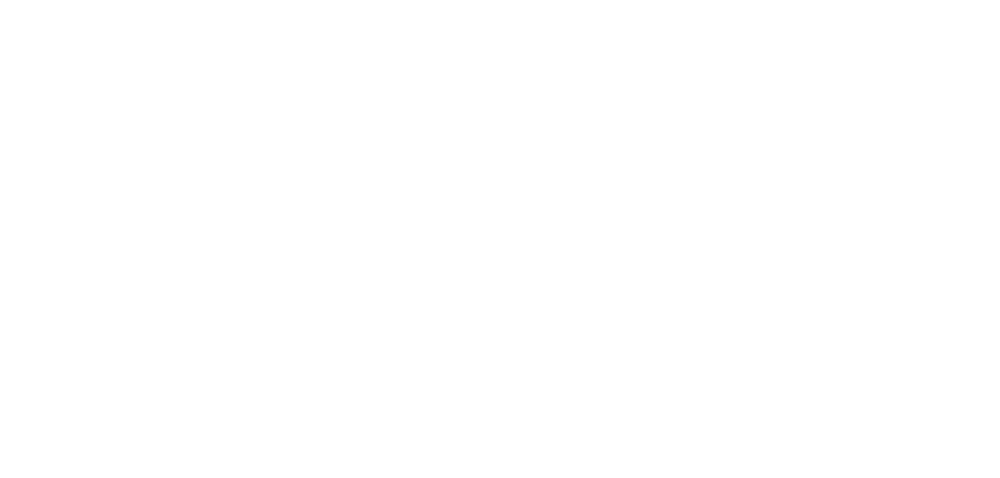

roi48_dff.png


<IPython.core.display.Javascript object>


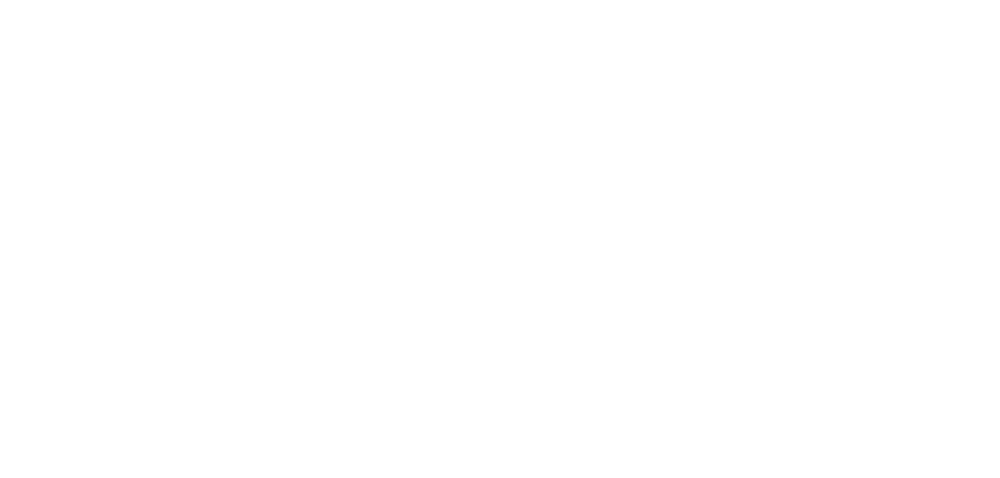

roi49_dff.png


<IPython.core.display.Javascript object>


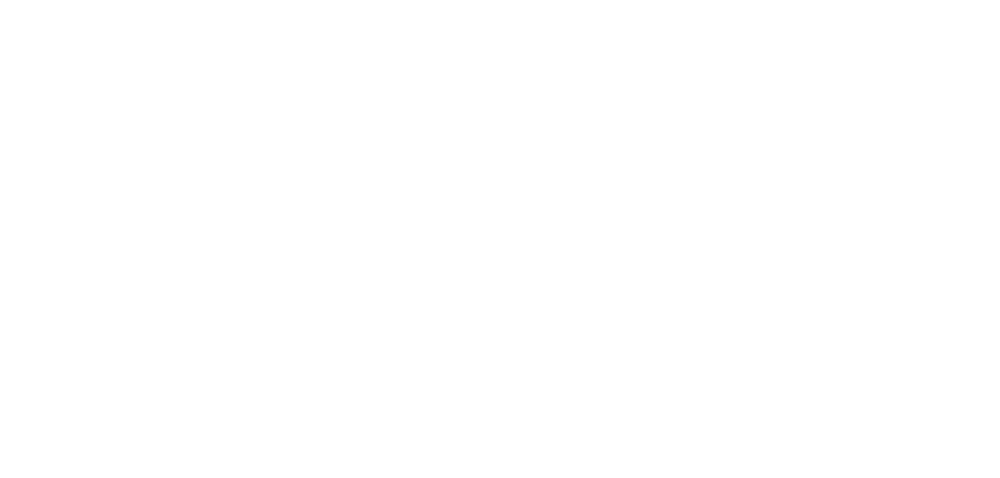

roi50_dff.png


<IPython.core.display.Javascript object>


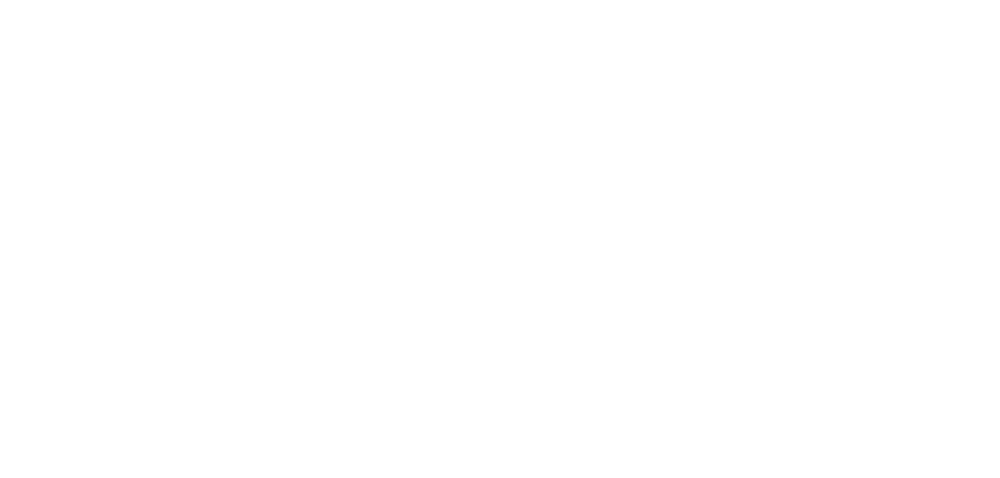

roi51_dff.png


<IPython.core.display.Javascript object>


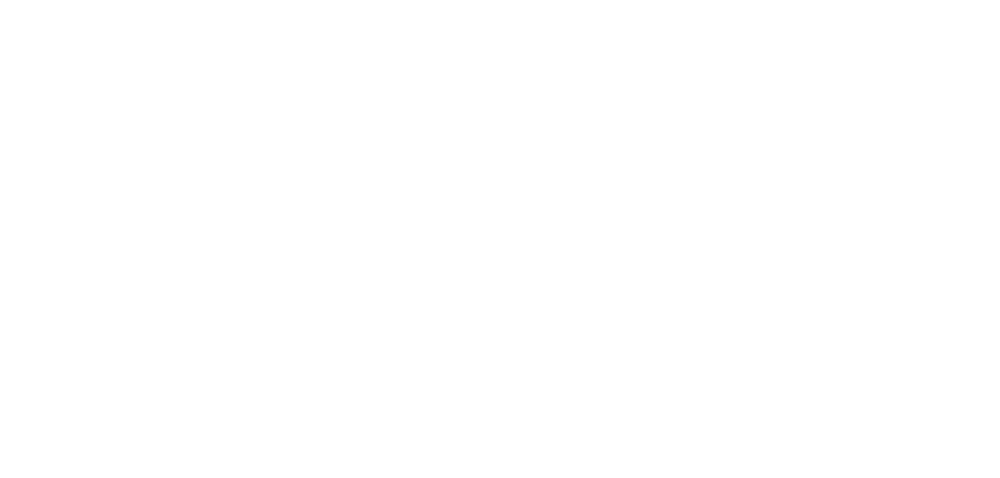

roi52_dff.png


<IPython.core.display.Javascript object>


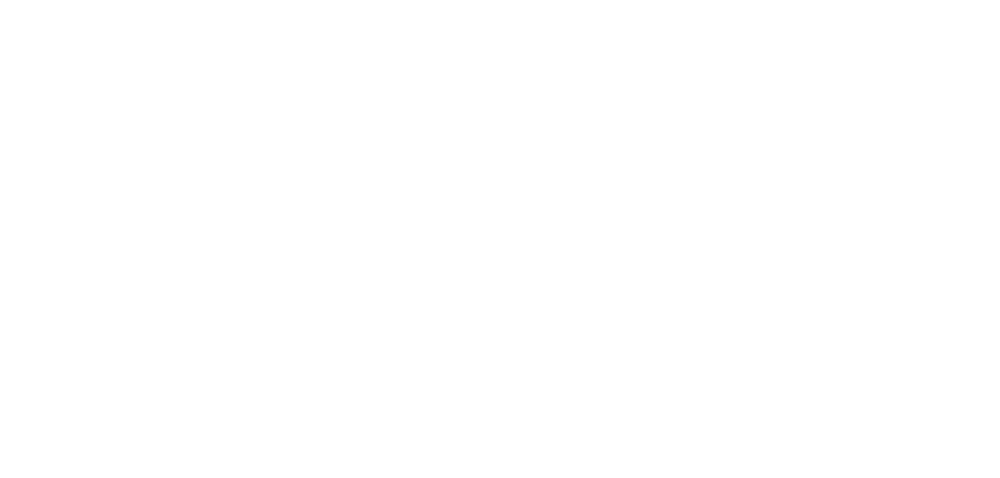

roi53_dff.png


<IPython.core.display.Javascript object>


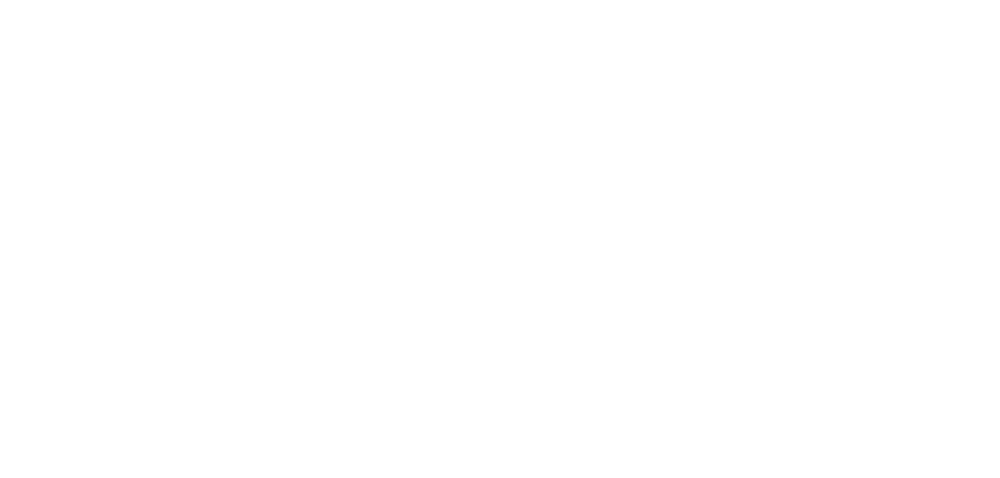

roi54_dff.png


<IPython.core.display.Javascript object>


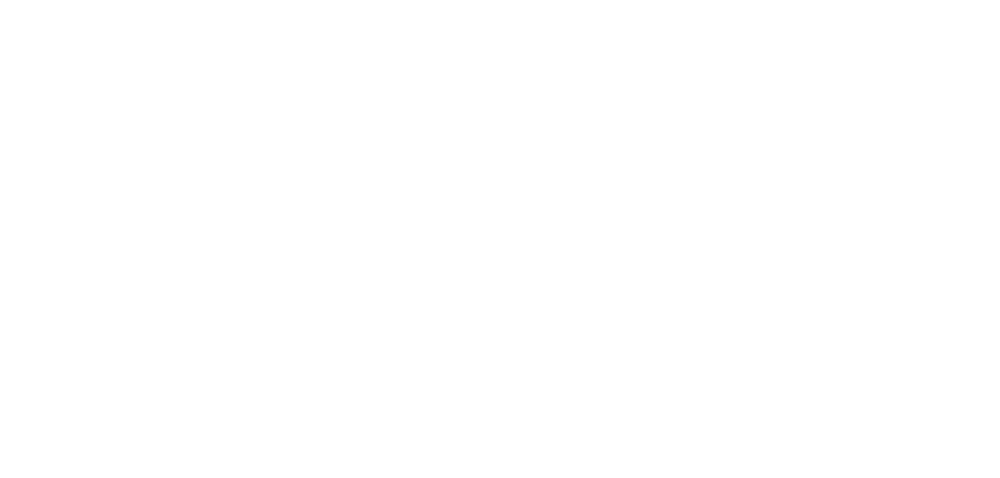

roi55_dff.png


<IPython.core.display.Javascript object>


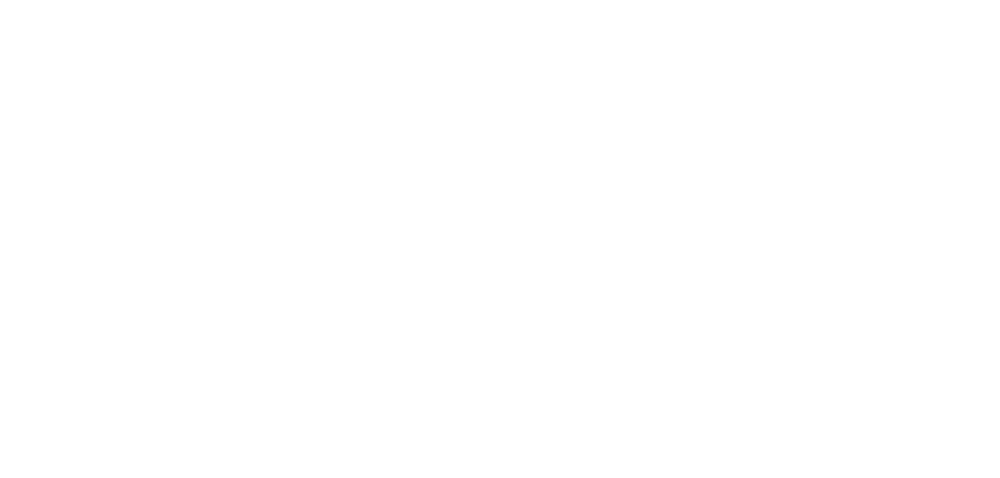

roi56_dff.png


<IPython.core.display.Javascript object>


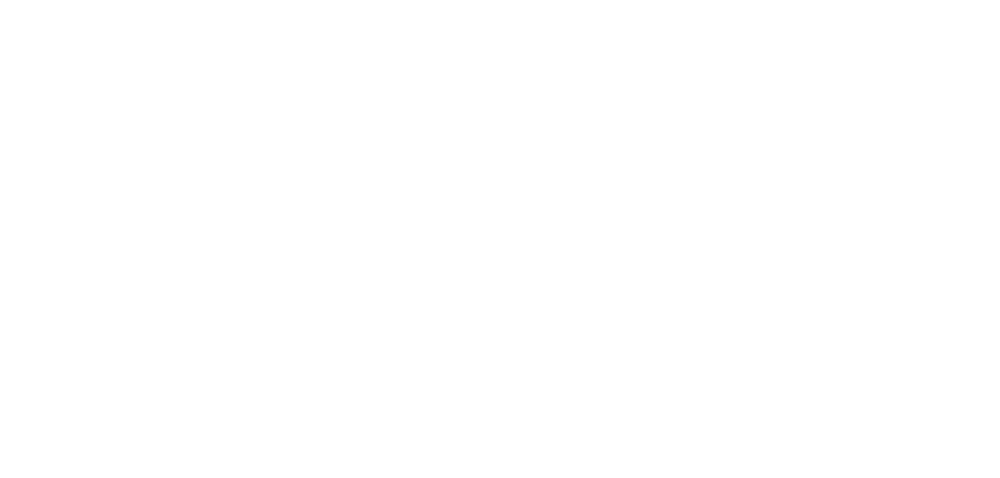

roi57_dff.png


<IPython.core.display.Javascript object>


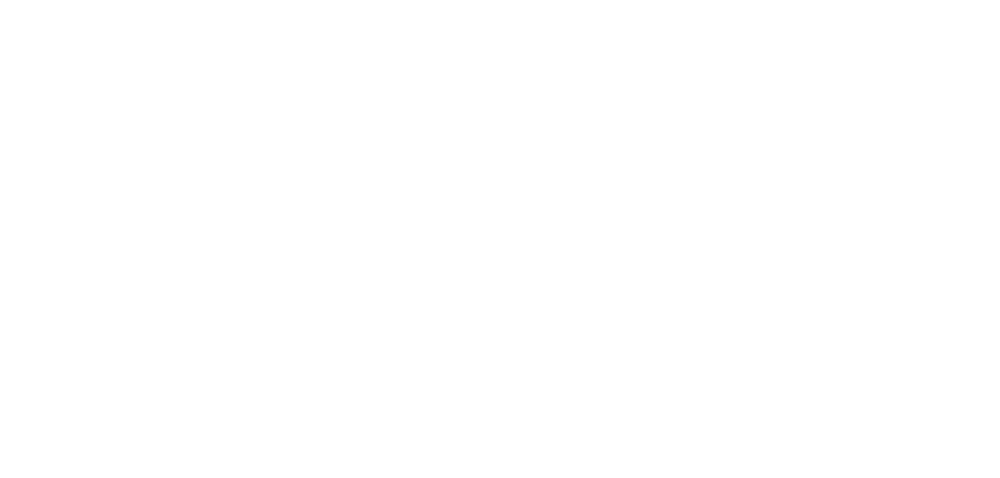

roi58_dff.png


<IPython.core.display.Javascript object>


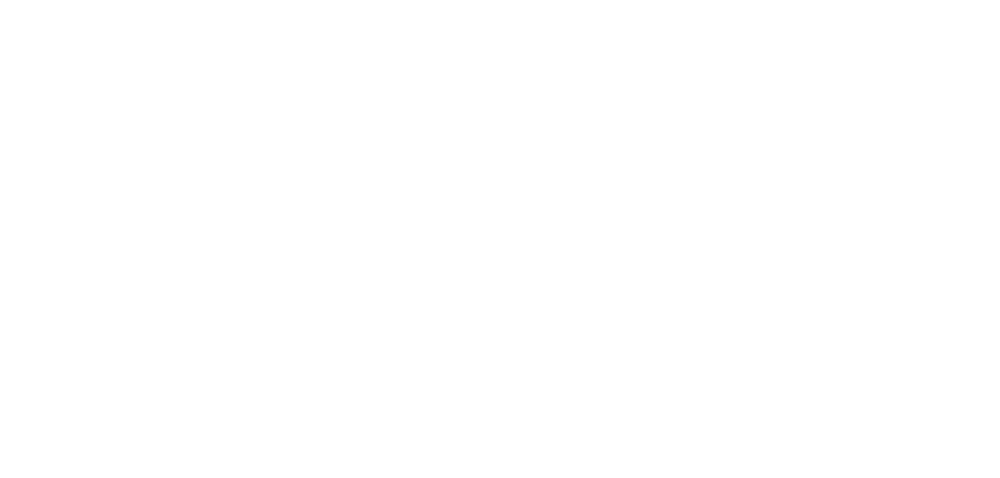

roi59_dff.png


<IPython.core.display.Javascript object>


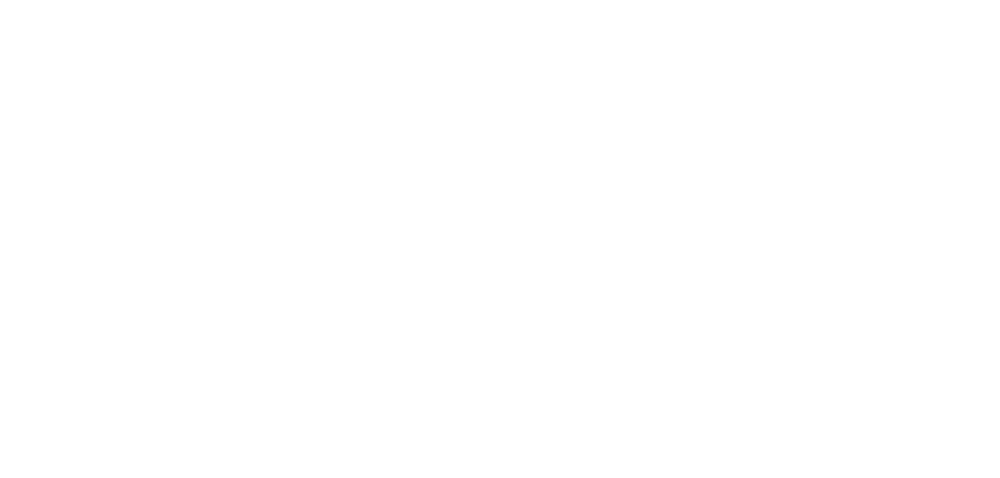

roi60_dff.png


<IPython.core.display.Javascript object>


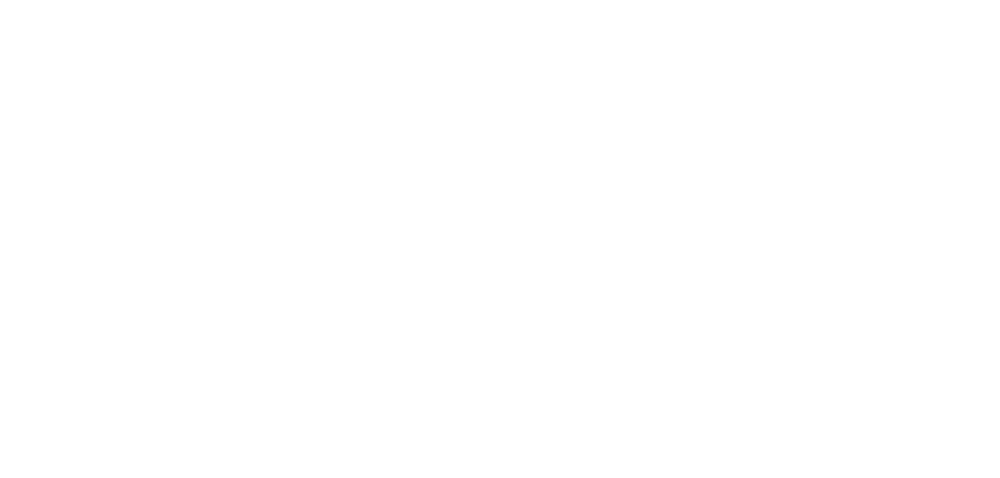

roi61_dff.png


<IPython.core.display.Javascript object>


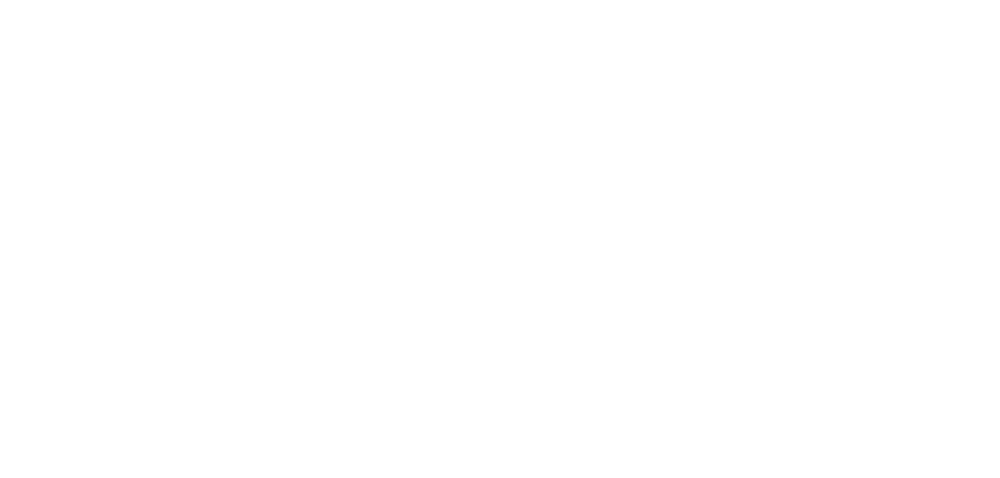

roi62_dff.png


<IPython.core.display.Javascript object>


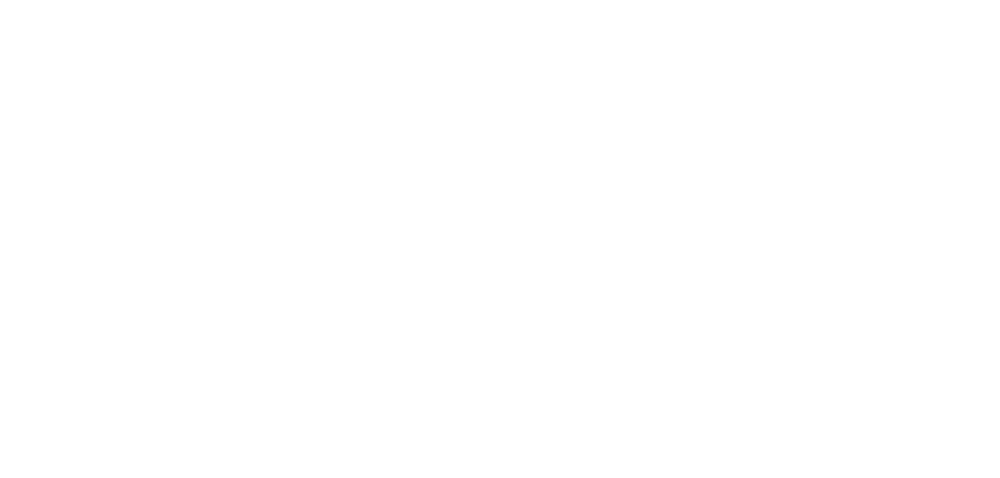

roi63_dff.png


<IPython.core.display.Javascript object>


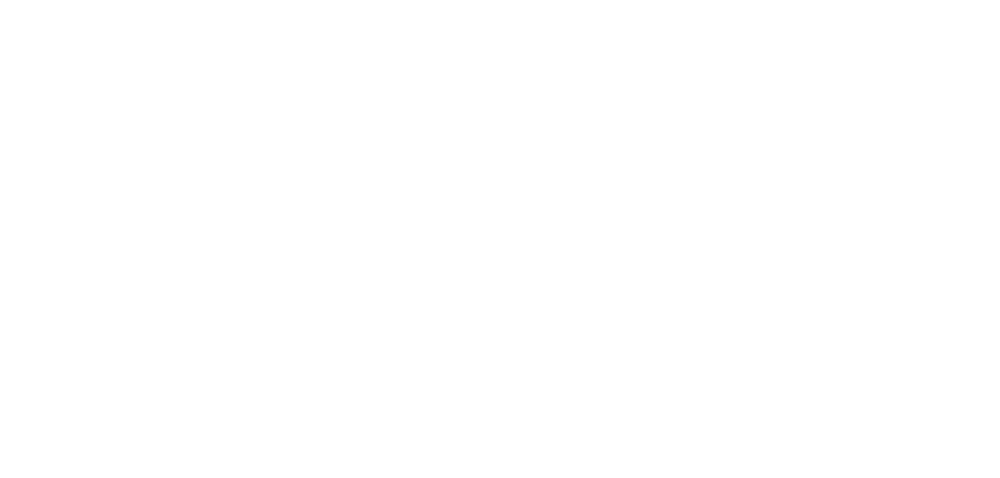

roi64_dff.png


<IPython.core.display.Javascript object>


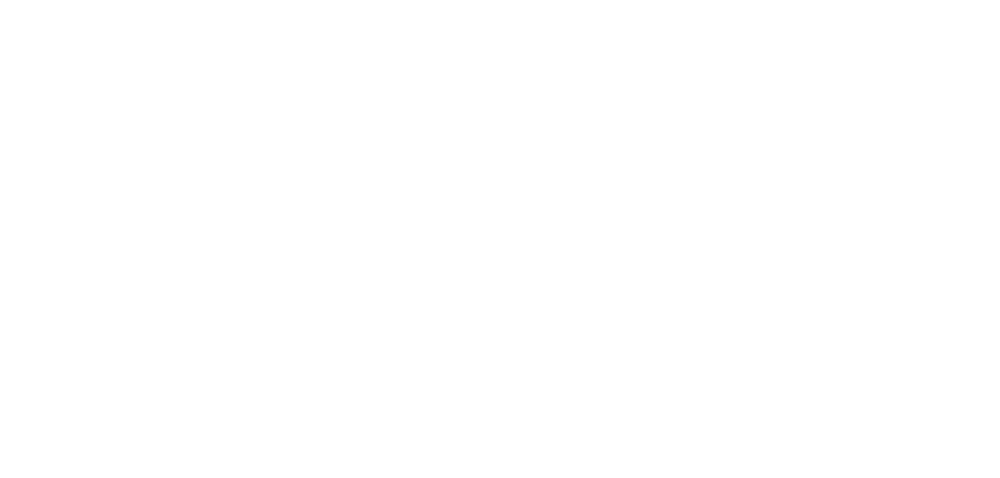

roi65_dff.png


<IPython.core.display.Javascript object>


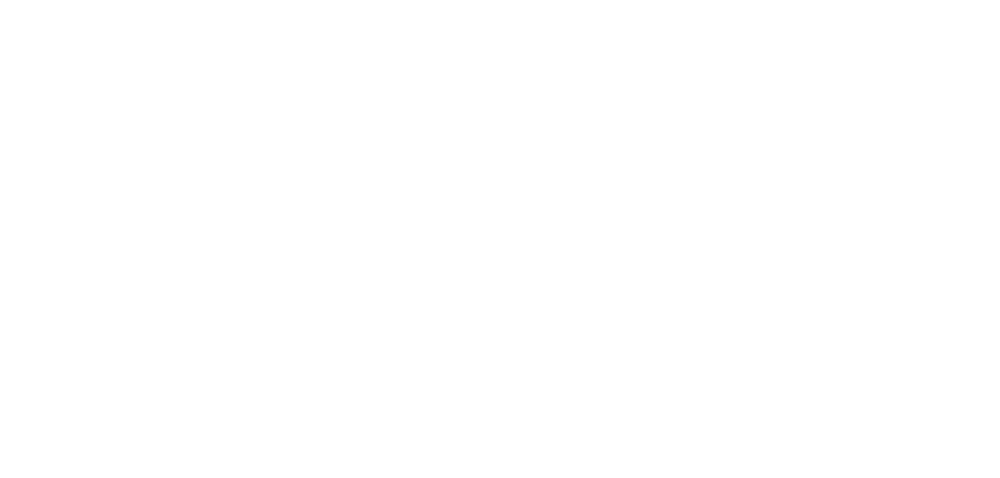

roi66_dff.png


<IPython.core.display.Javascript object>


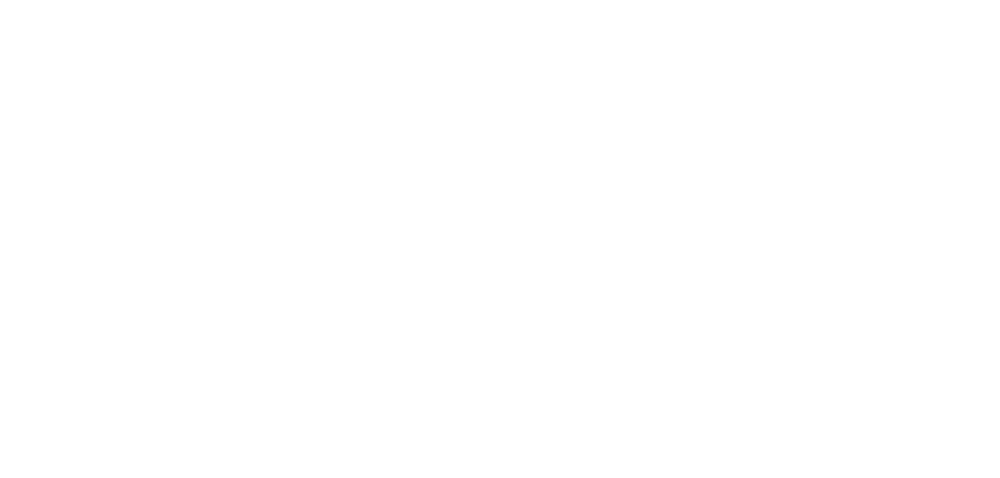

roi67_dff.png


<IPython.core.display.Javascript object>


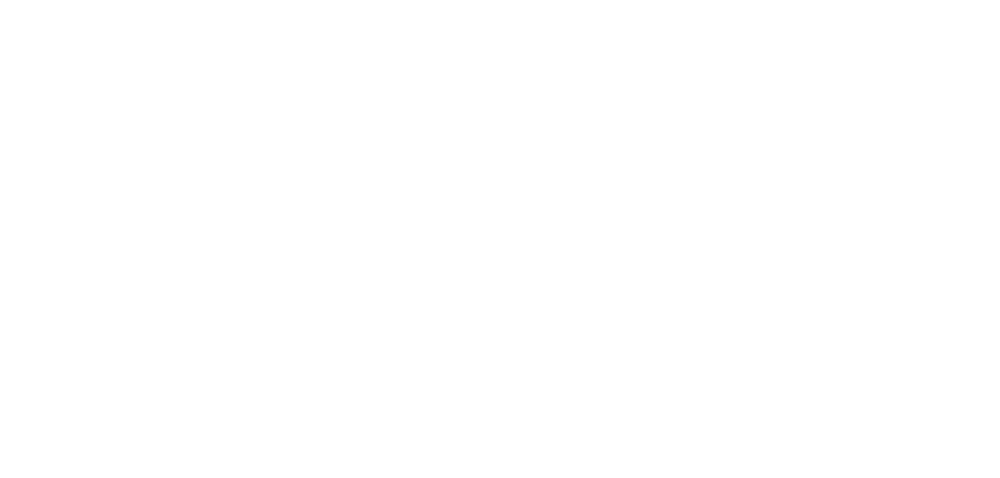

roi68_dff.png


<IPython.core.display.Javascript object>


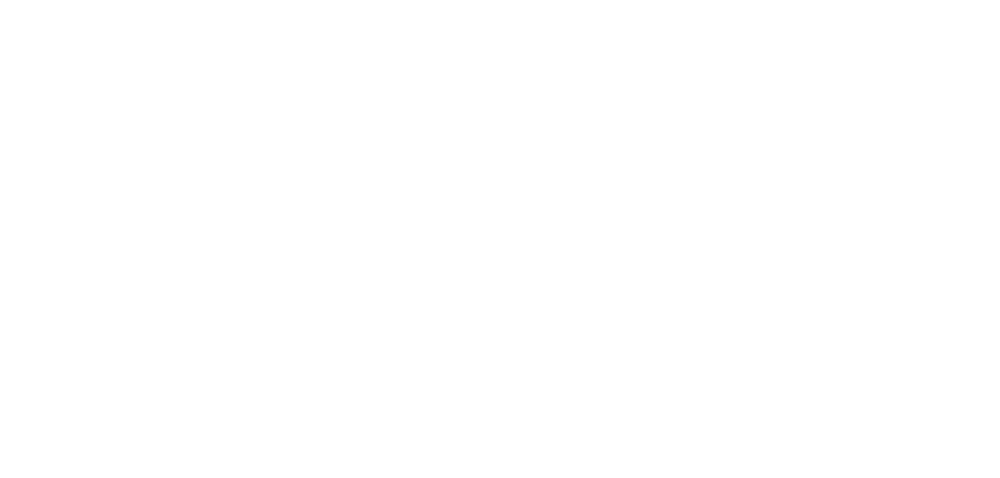

roi69_dff.png


<IPython.core.display.Javascript object>


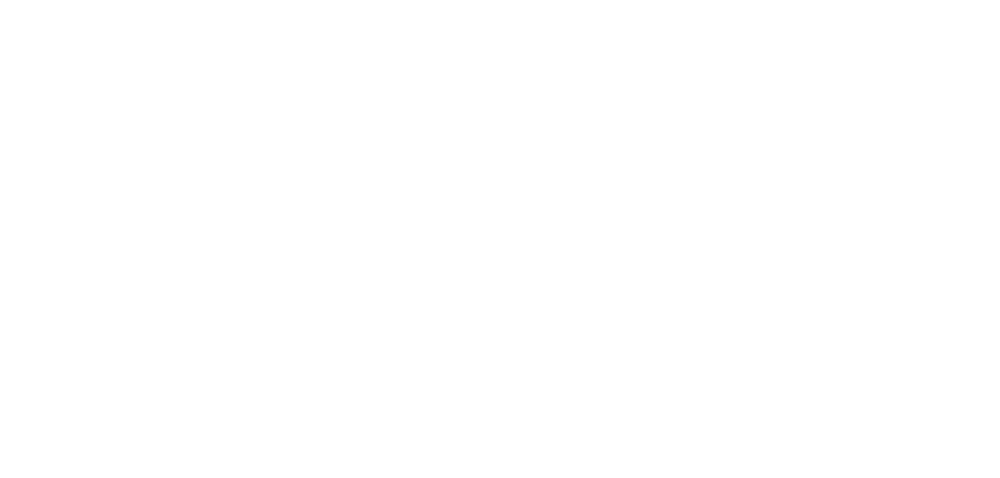

roi70_dff.png


<IPython.core.display.Javascript object>


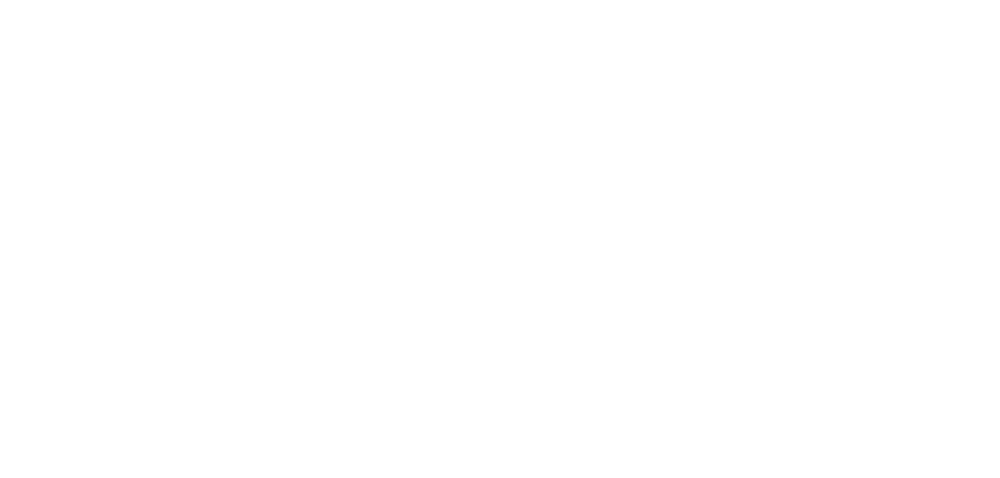

roi71_dff.png


<IPython.core.display.Javascript object>


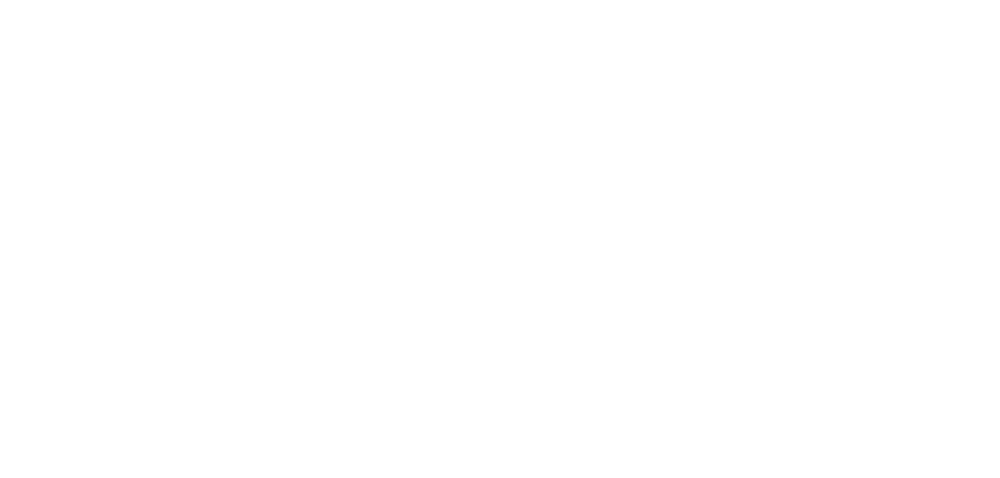

roi72_dff.png


<IPython.core.display.Javascript object>


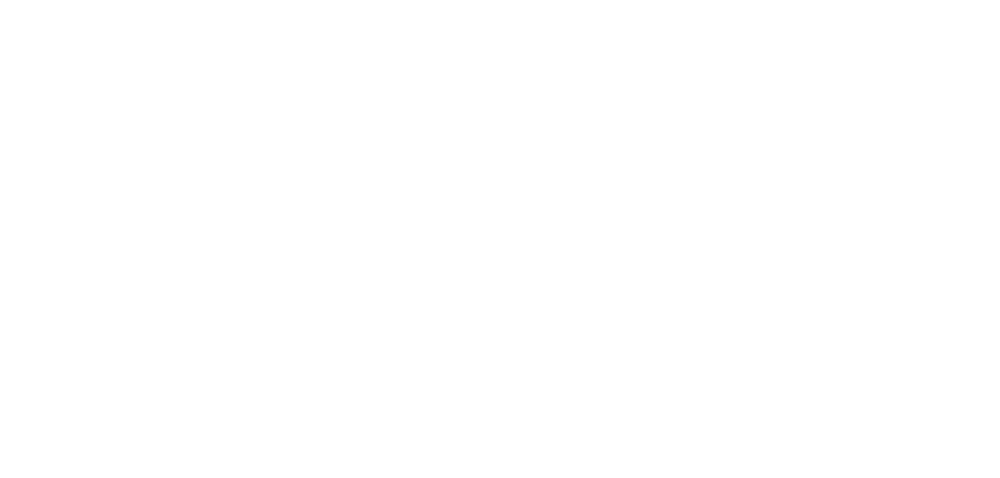

roi73_dff.png


<IPython.core.display.Javascript object>


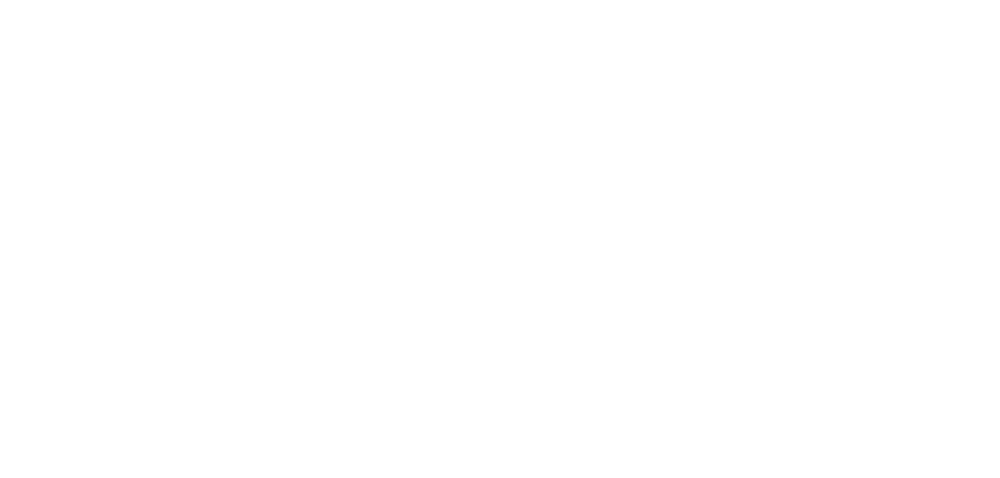

roi74_dff.png


<IPython.core.display.Javascript object>


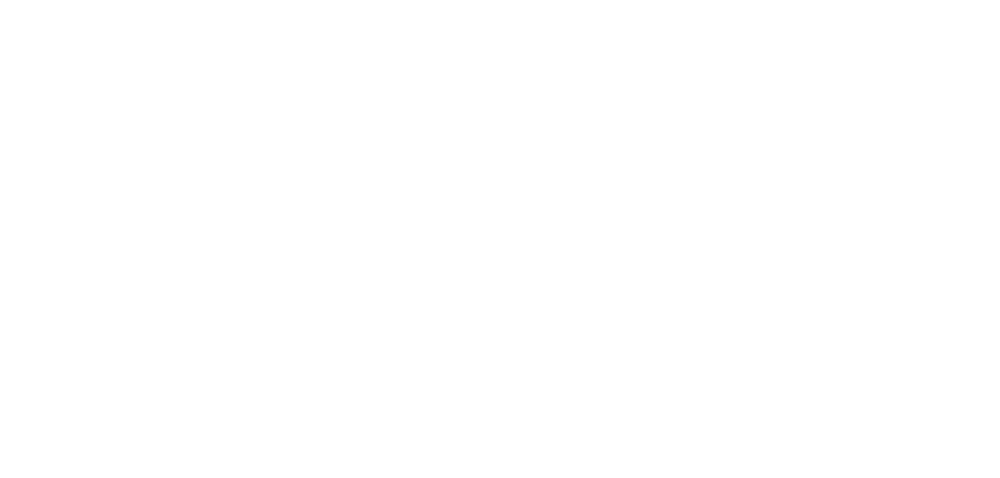

roi75_dff.png


<IPython.core.display.Javascript object>


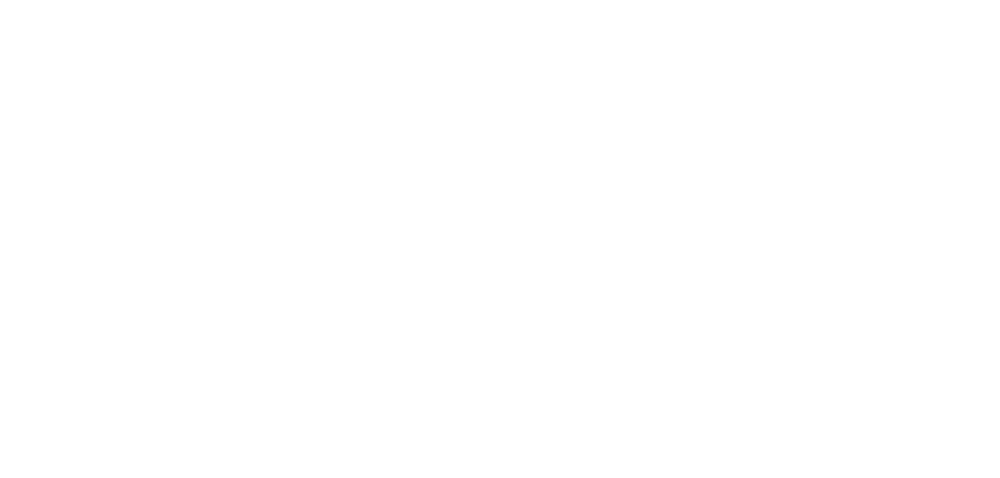

roi76_dff.png


<IPython.core.display.Javascript object>


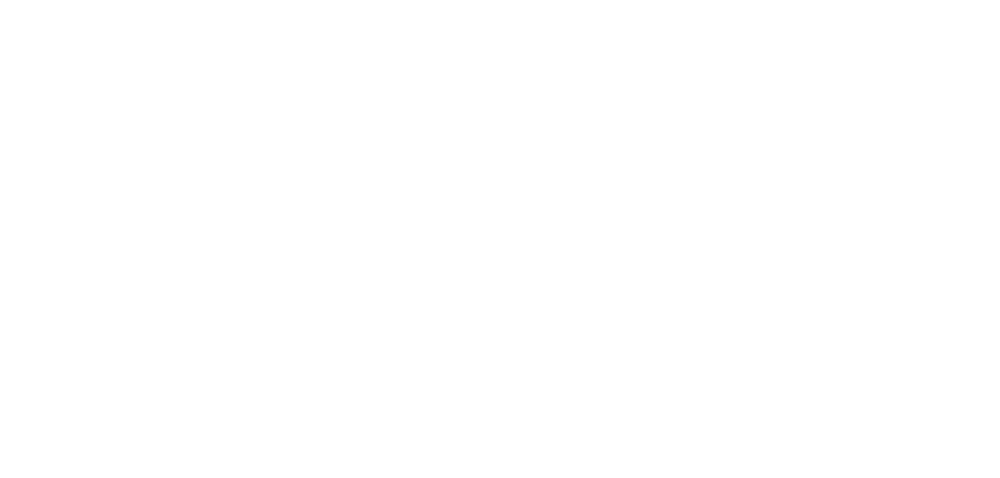

roi77_dff.png


<IPython.core.display.Javascript object>


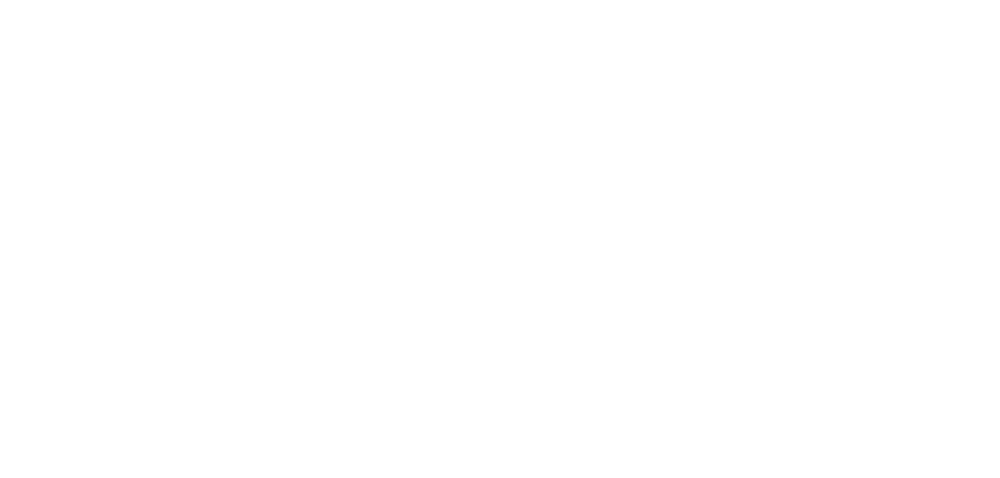

roi78_dff.png


<IPython.core.display.Javascript object>


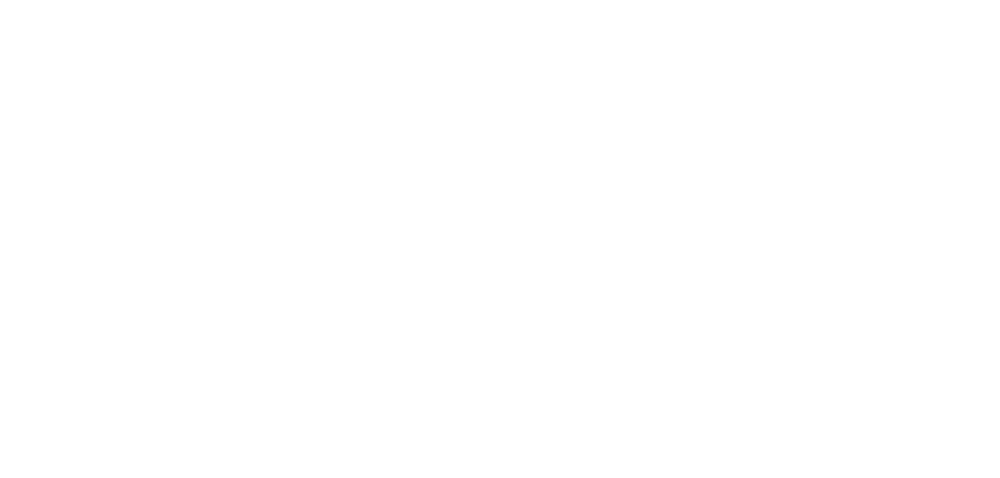

roi79_dff.png


<IPython.core.display.Javascript object>


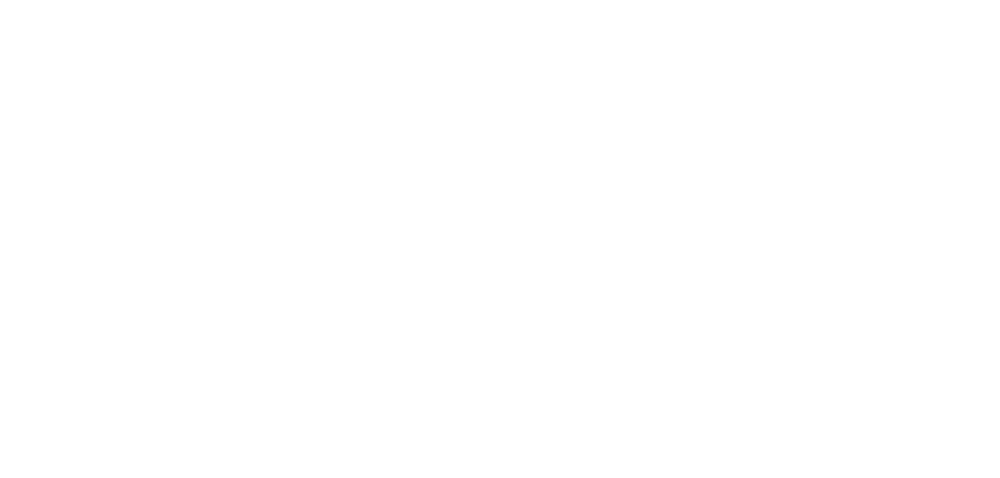

roi80_dff.png


<IPython.core.display.Javascript object>


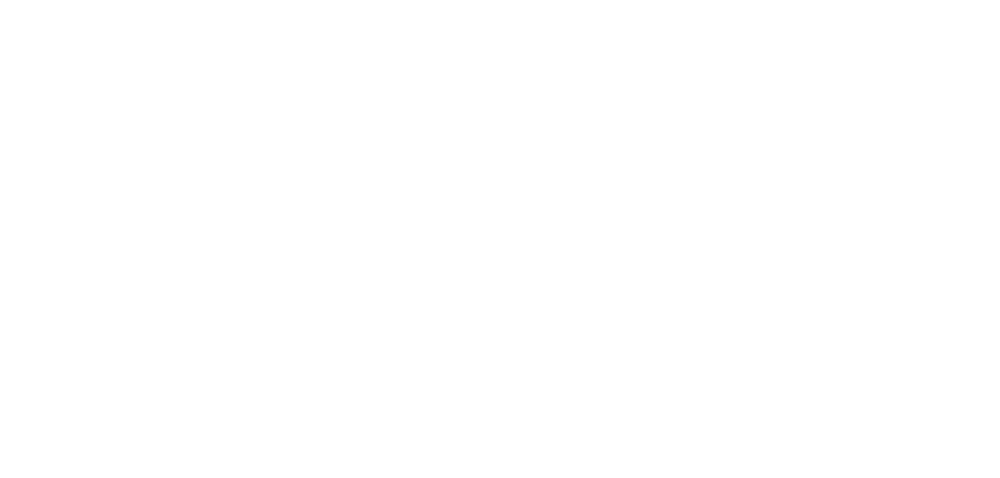

roi81_dff.png


<IPython.core.display.Javascript object>


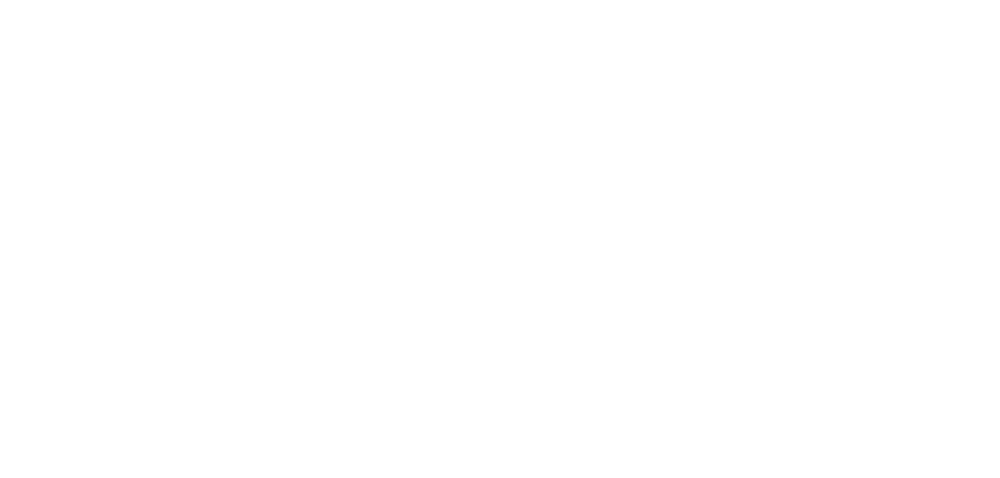

roi82_dff.png


<IPython.core.display.Javascript object>


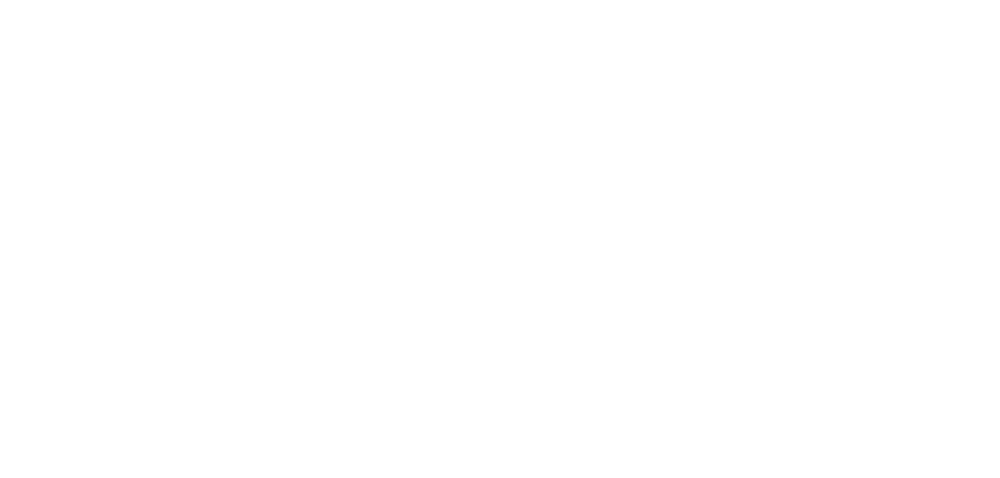

roi83_dff.png


<IPython.core.display.Javascript object>


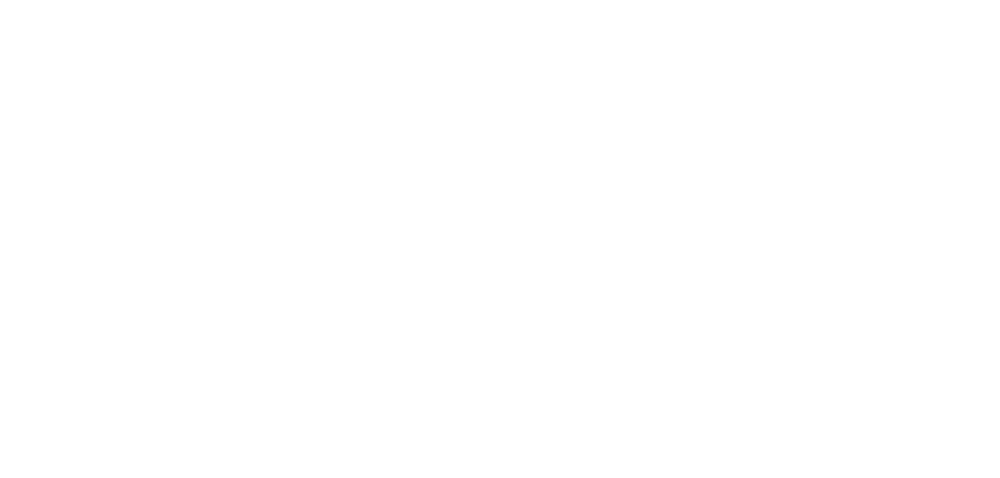

roi84_dff.png


<IPython.core.display.Javascript object>


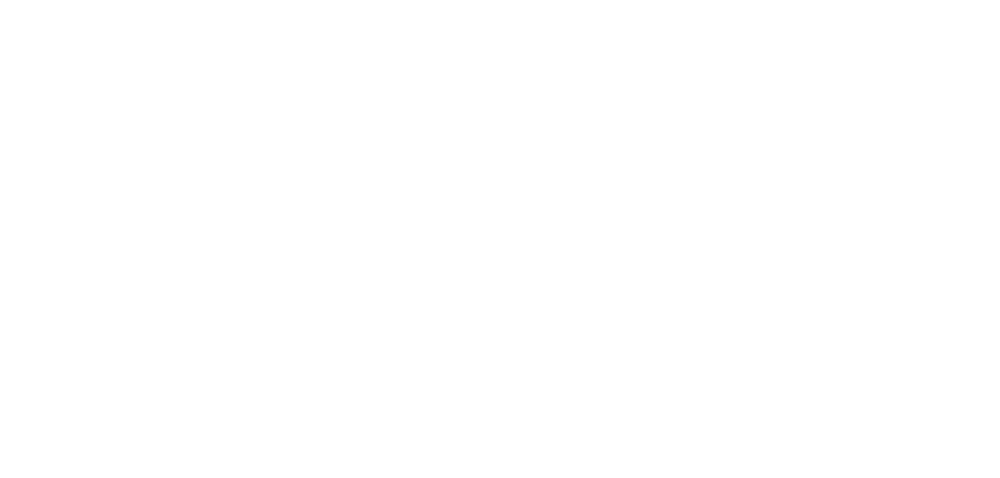

roi85_dff.png


<IPython.core.display.Javascript object>


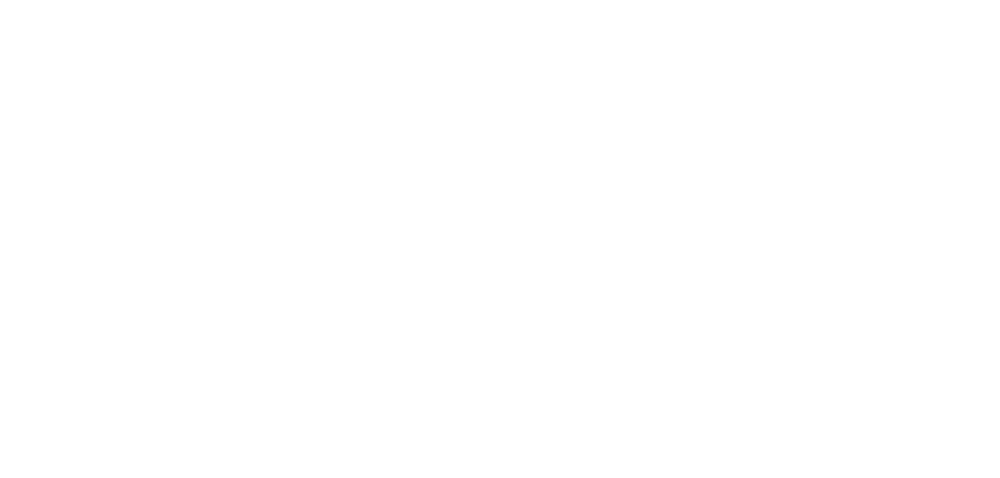

roi86_dff.png


<IPython.core.display.Javascript object>


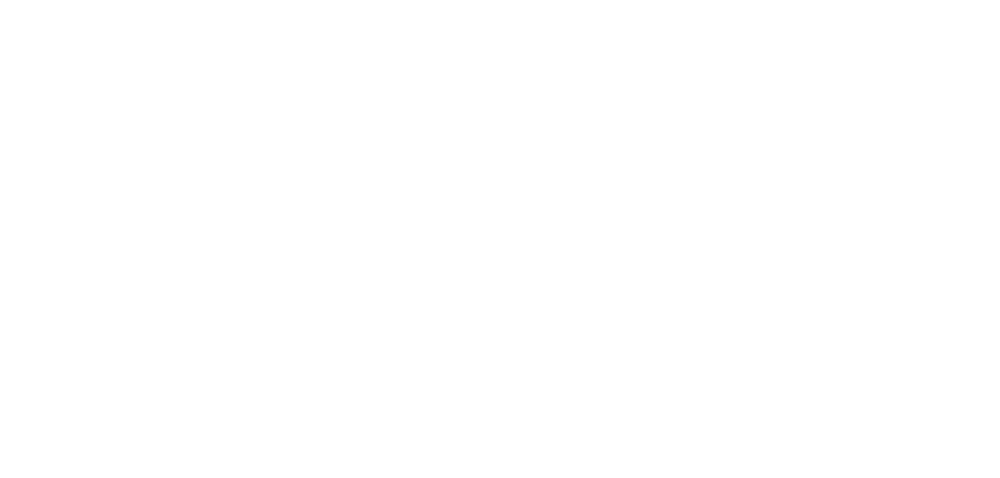

roi87_dff.png


<IPython.core.display.Javascript object>


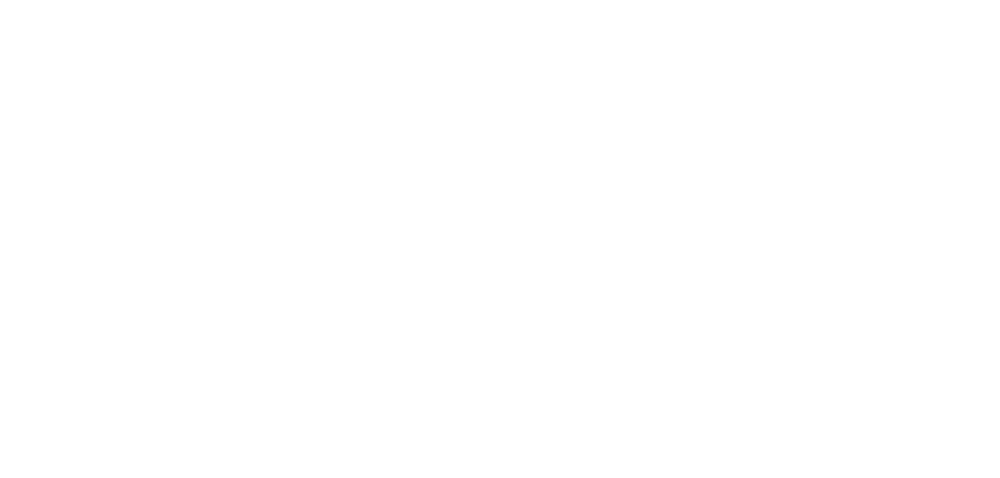

roi88_dff.png


<IPython.core.display.Javascript object>


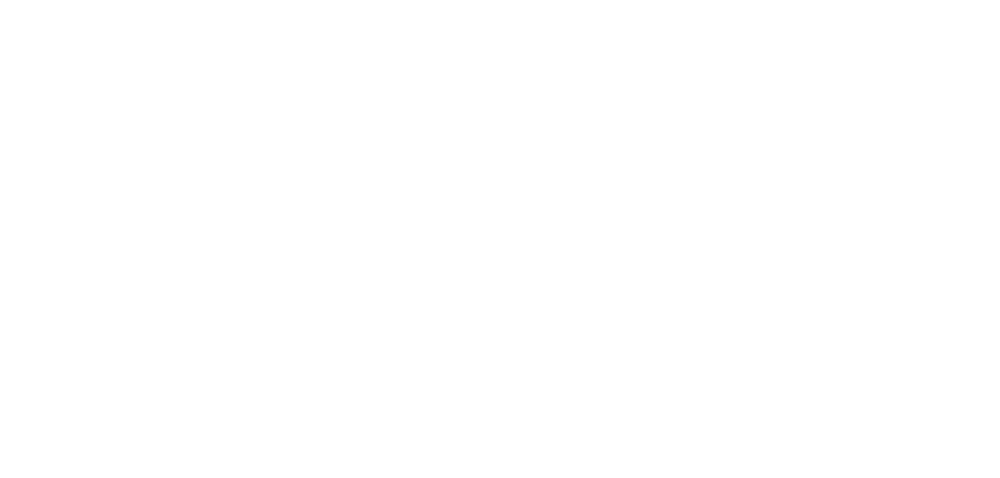

roi89_dff.png


<IPython.core.display.Javascript object>


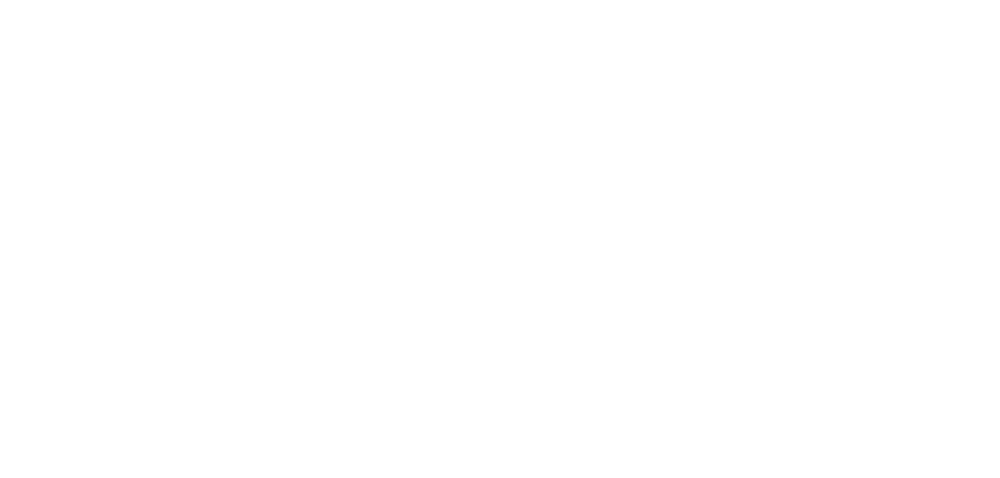

roi90_dff.png


<IPython.core.display.Javascript object>


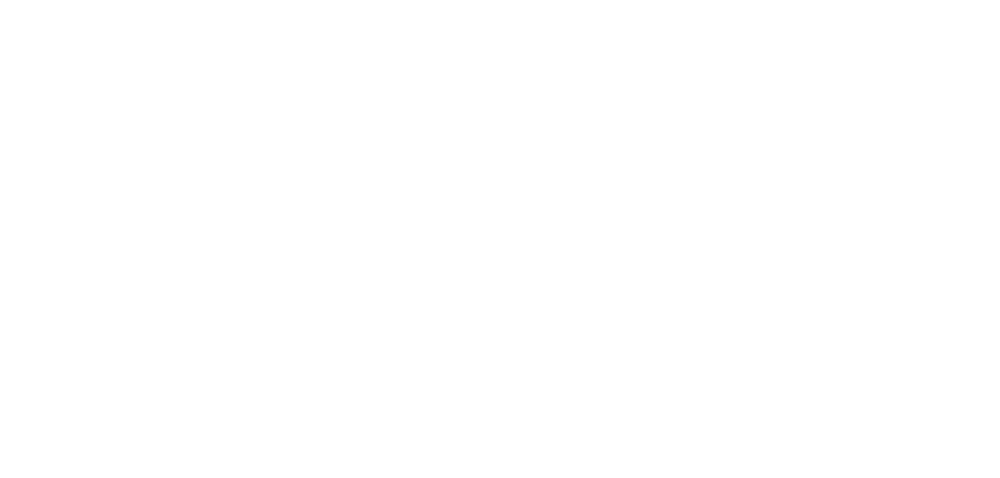

roi91_dff.png


<IPython.core.display.Javascript object>


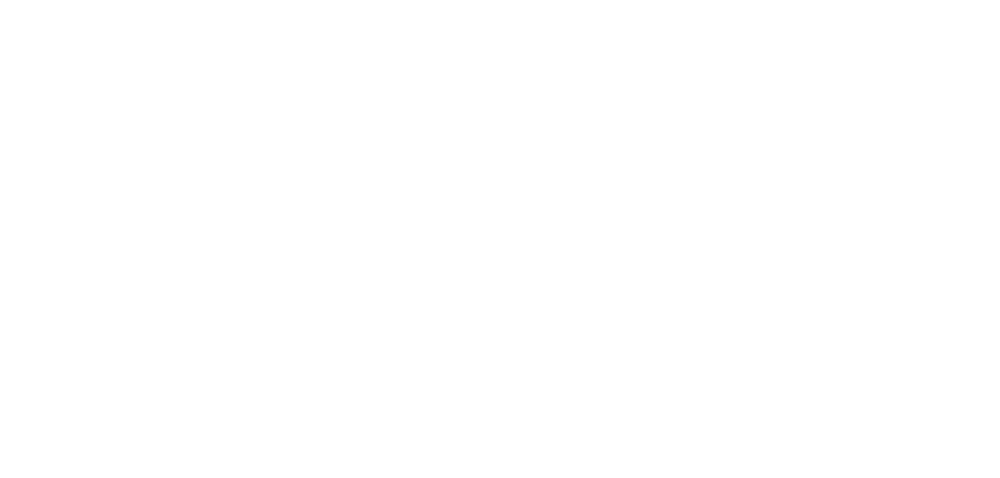

roi92_dff.png


<IPython.core.display.Javascript object>


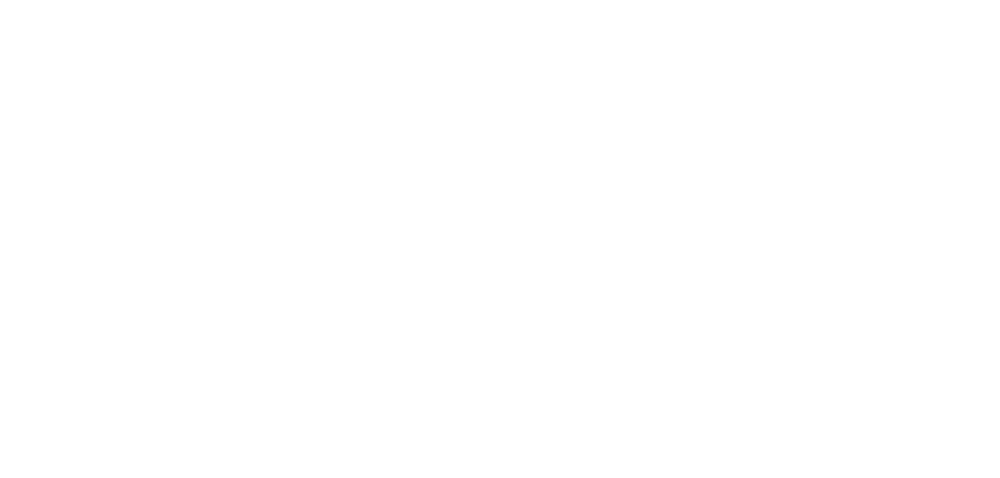

roi93_dff.png


<IPython.core.display.Javascript object>


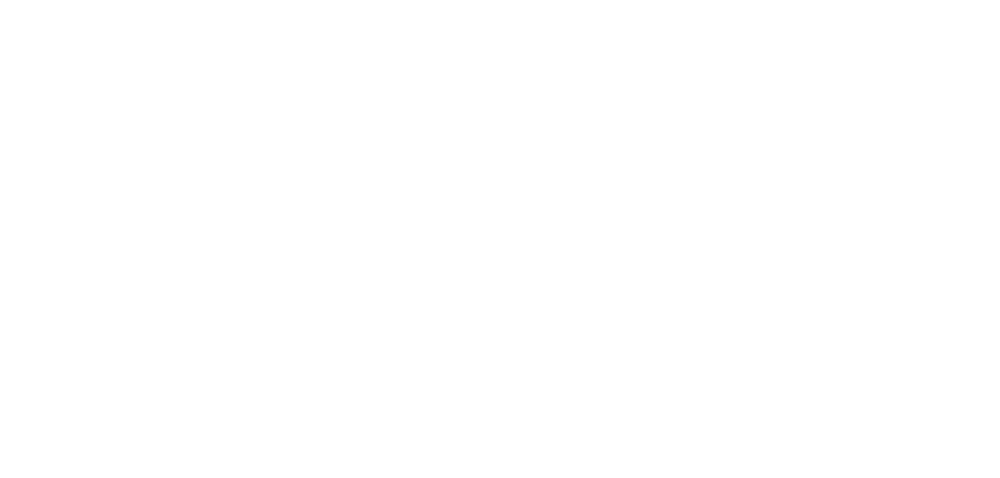

roi94_dff.png


<IPython.core.display.Javascript object>


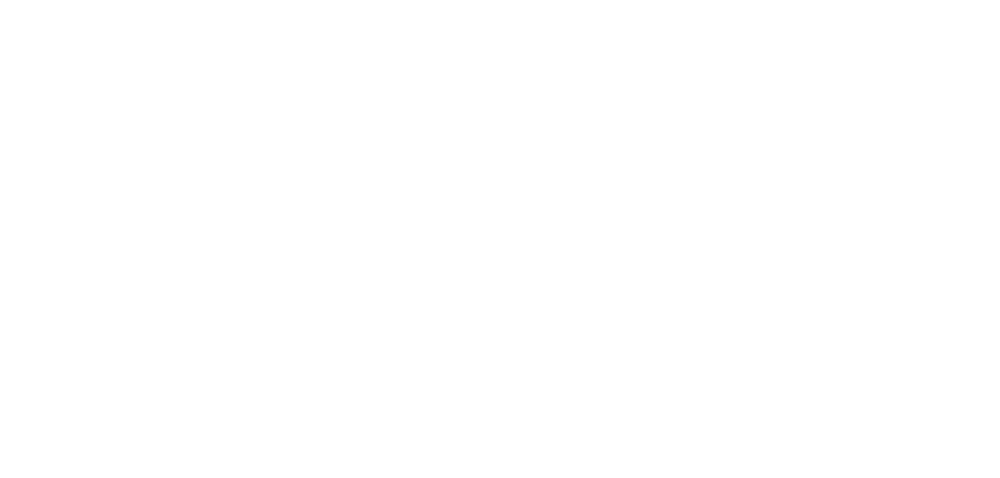

roi95_dff.png


<IPython.core.display.Javascript object>


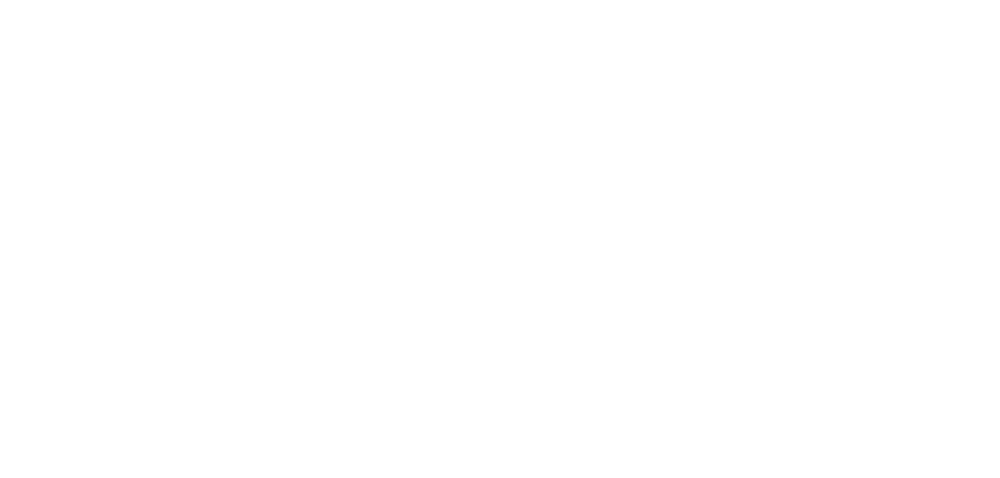

roi96_dff.png


<IPython.core.display.Javascript object>


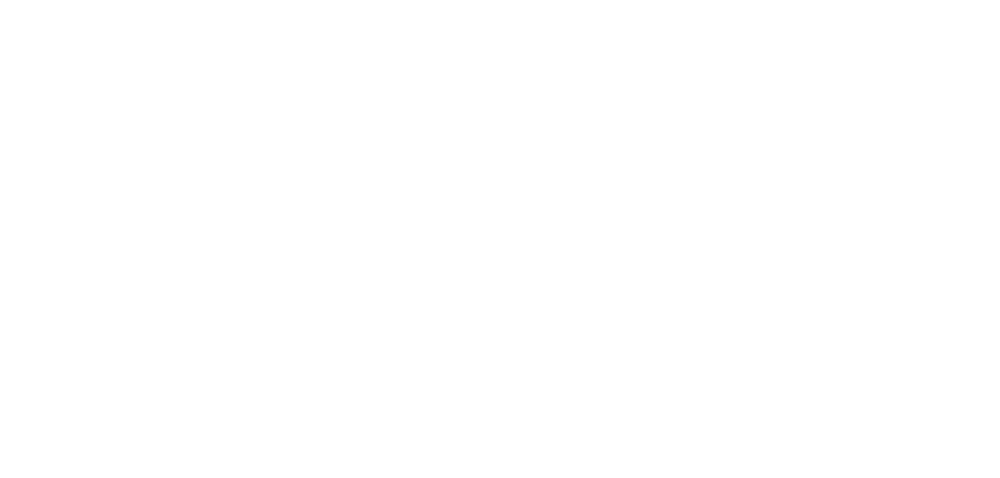

roi97_dff.png


<IPython.core.display.Javascript object>


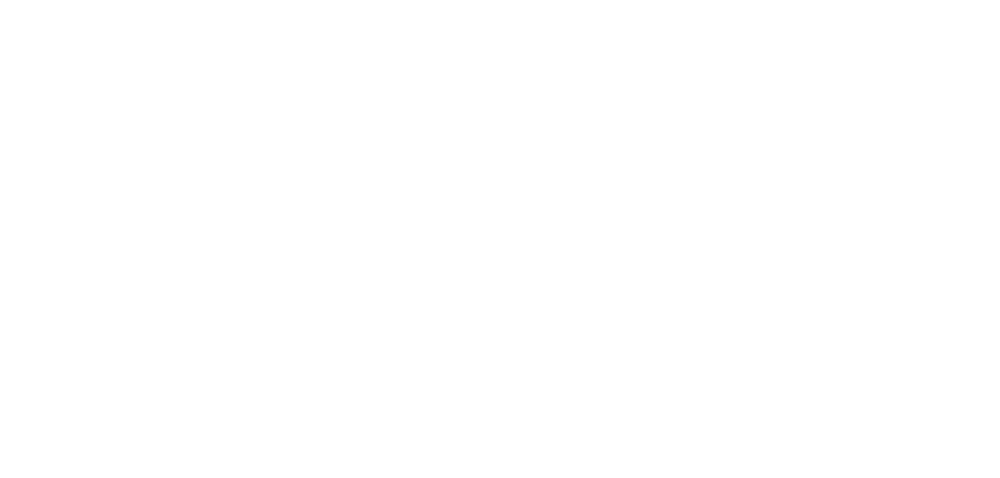

roi98_dff.png


<IPython.core.display.Javascript object>


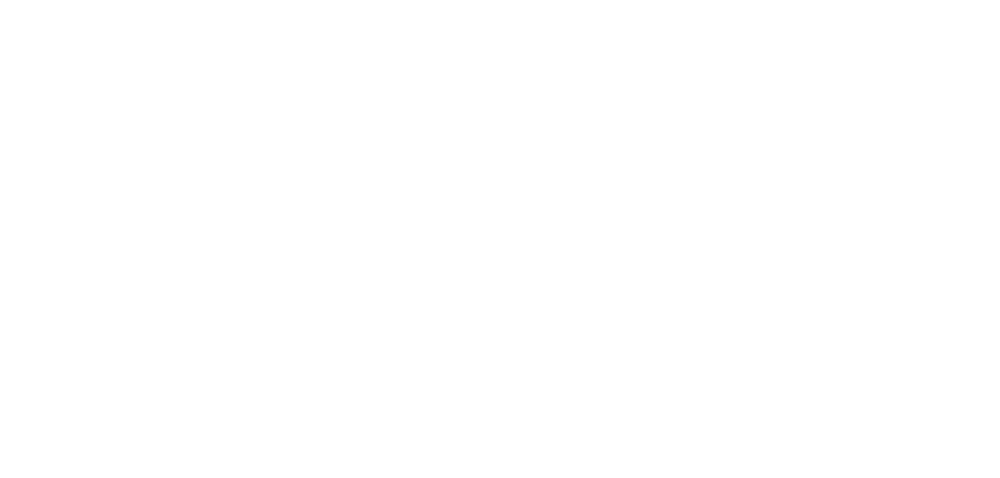

roi99_dff.png


<IPython.core.display.Javascript object>


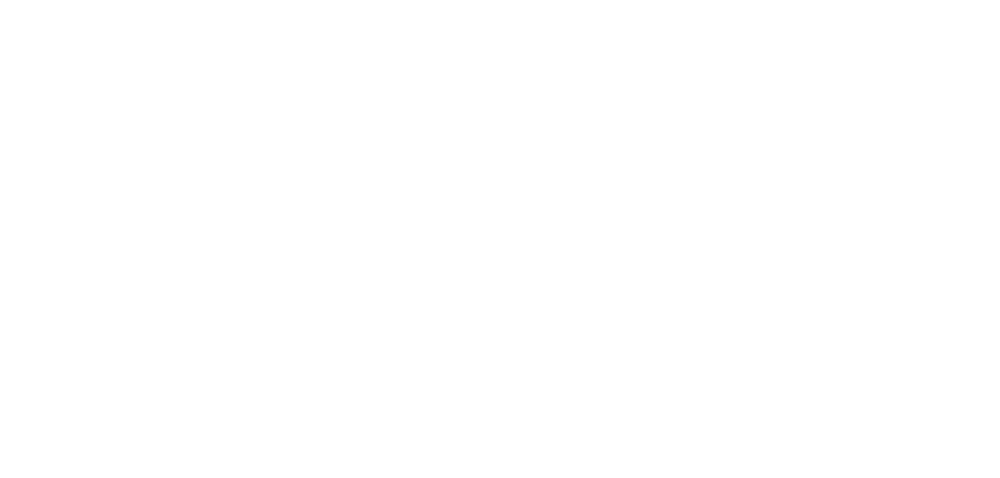

roi100_dff.png


<IPython.core.display.Javascript object>


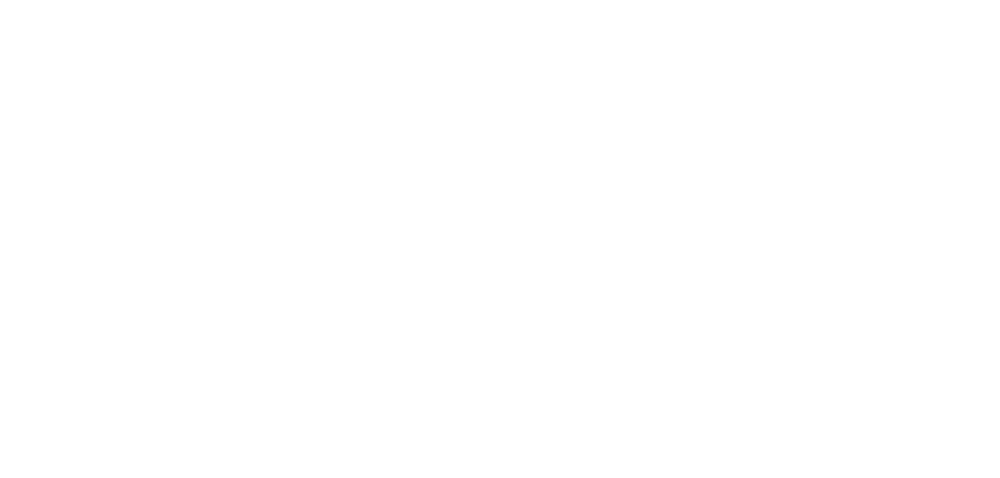

roi101_dff.png


<IPython.core.display.Javascript object>


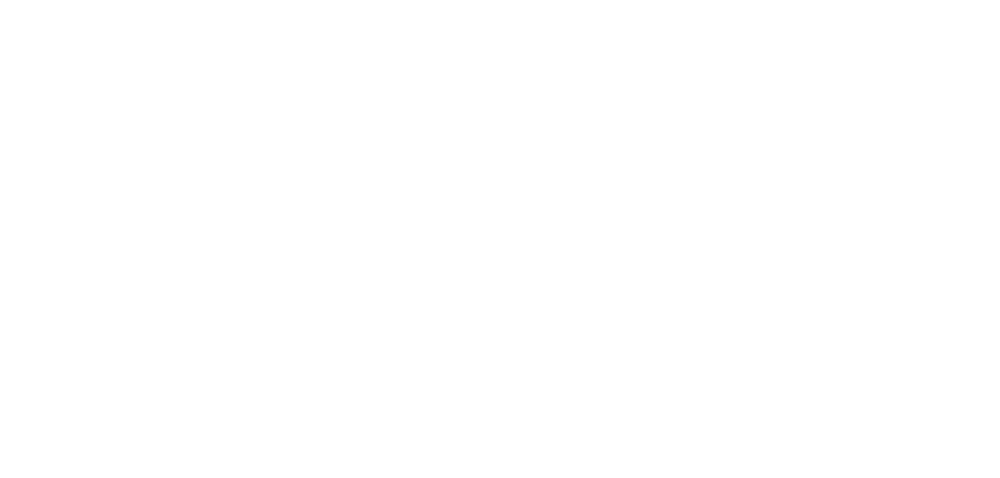

roi102_dff.png


<IPython.core.display.Javascript object>


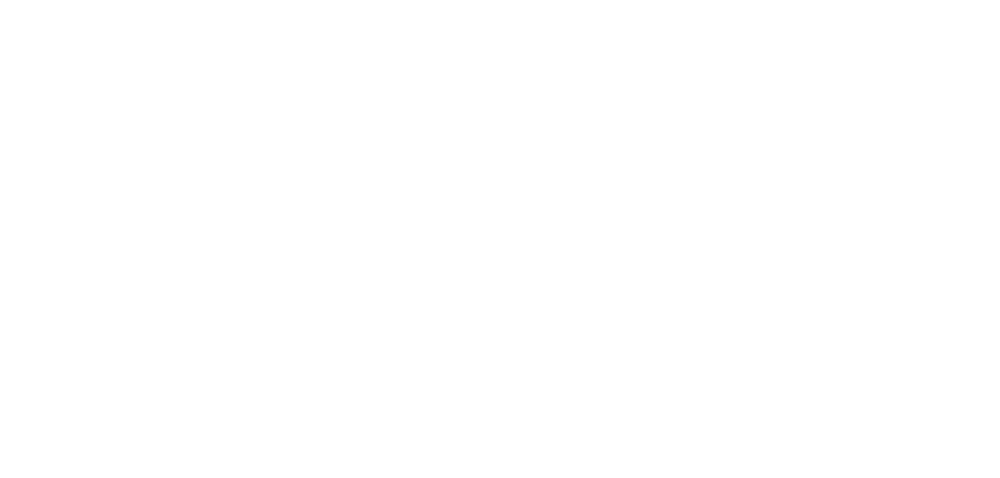

roi103_dff.png


<IPython.core.display.Javascript object>


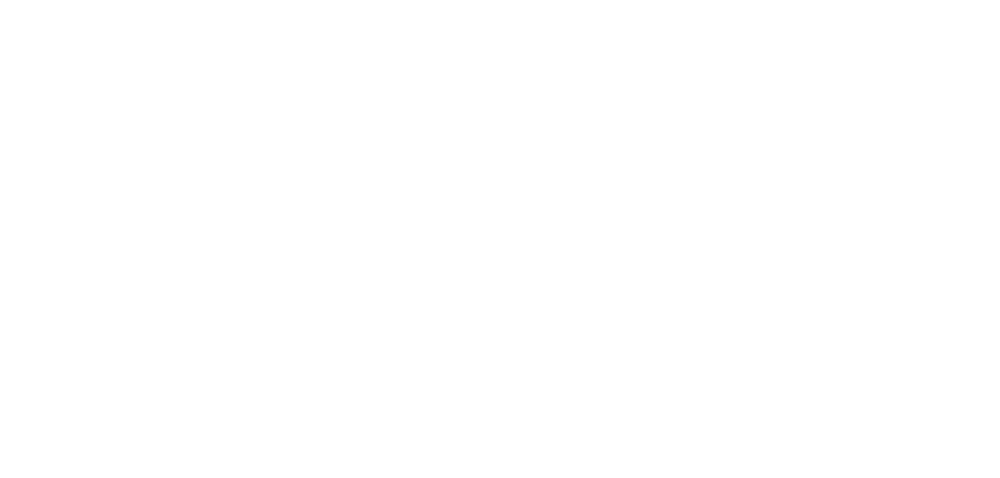

roi104_dff.png


<IPython.core.display.Javascript object>


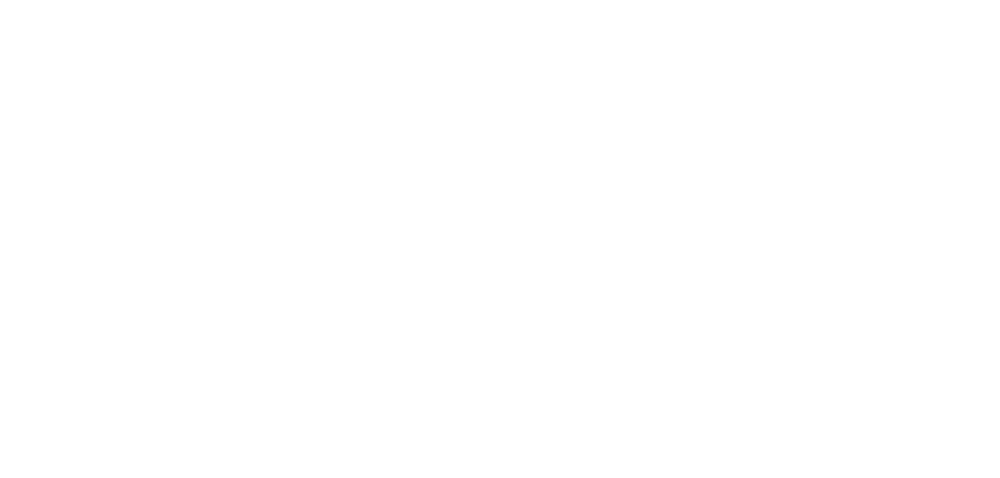

roi105_dff.png


<IPython.core.display.Javascript object>


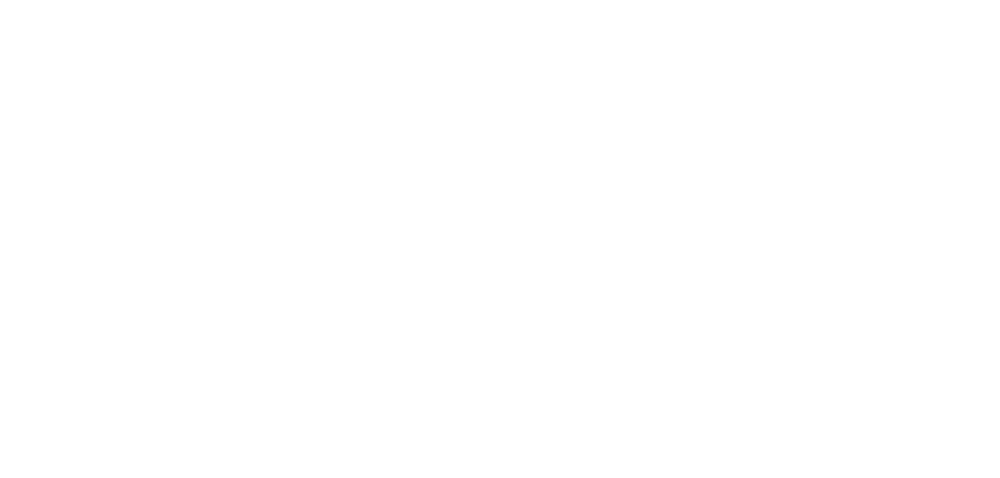

roi106_dff.png


<IPython.core.display.Javascript object>


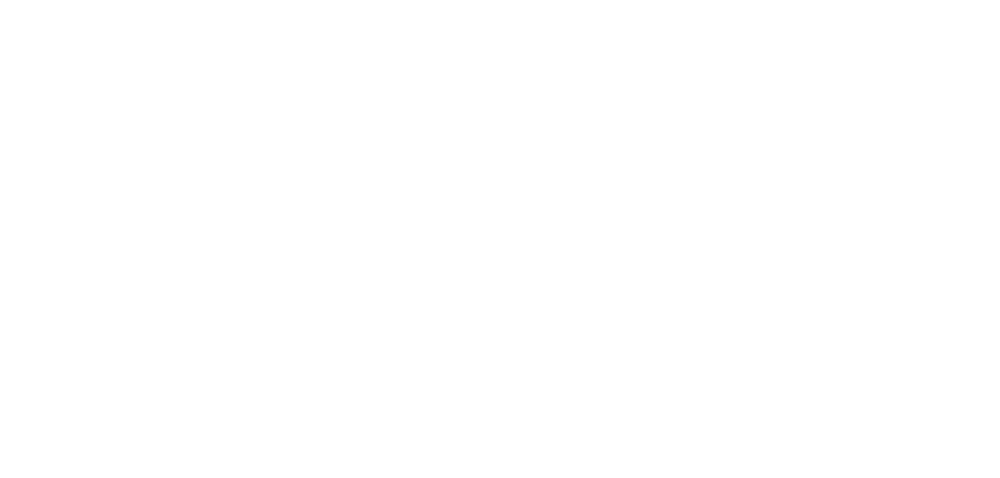

roi107_dff.png


<IPython.core.display.Javascript object>


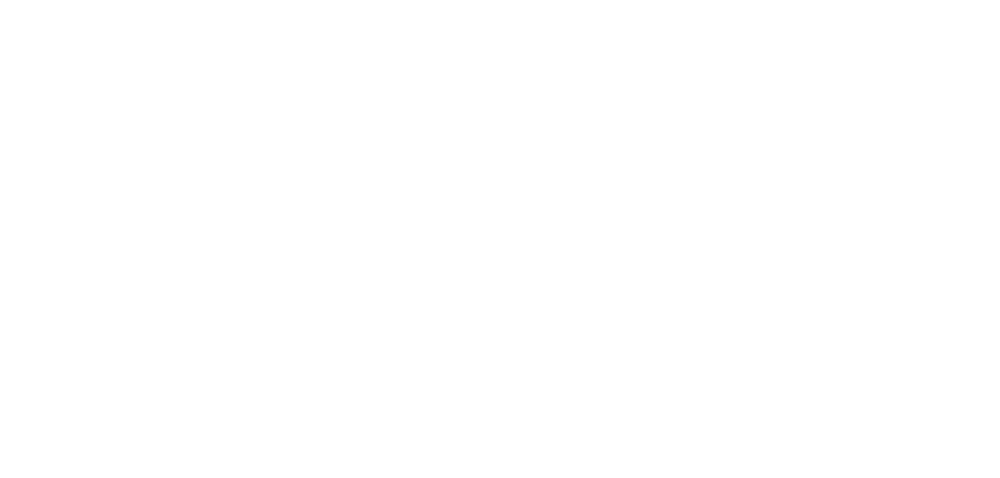

roi108_dff.png


<IPython.core.display.Javascript object>


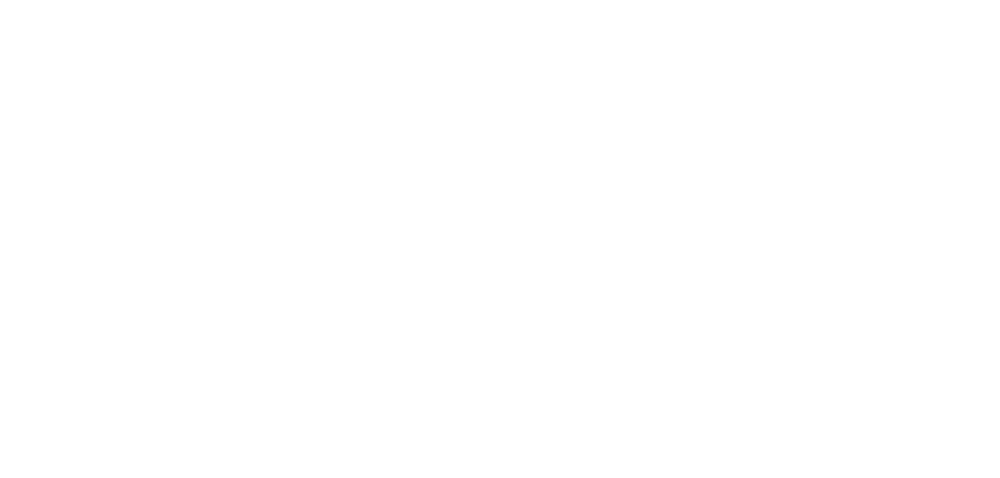

roi109_dff.png


<IPython.core.display.Javascript object>


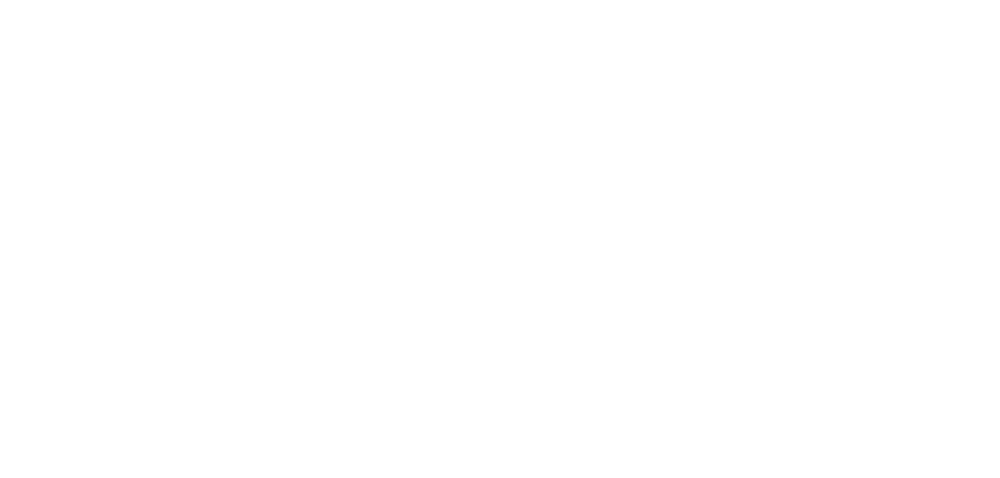

roi110_dff.png


<IPython.core.display.Javascript object>


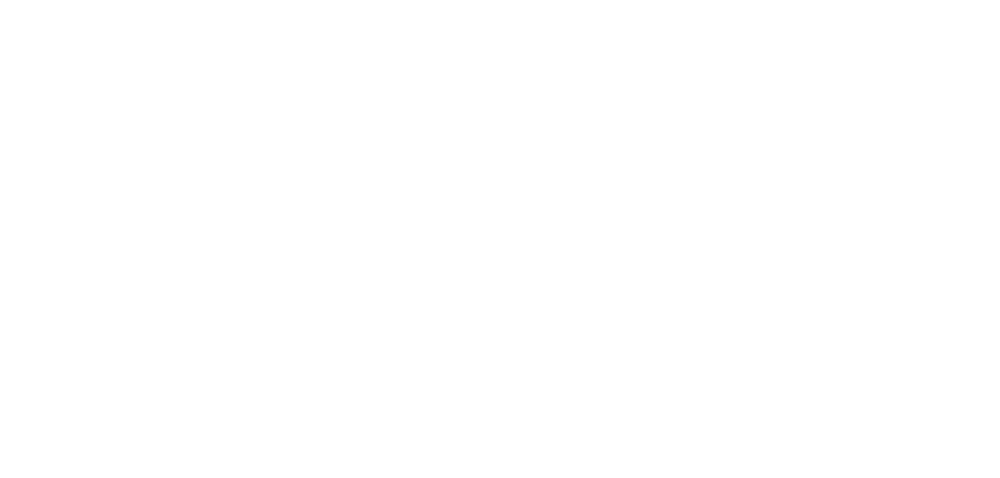

roi111_dff.png


<IPython.core.display.Javascript object>


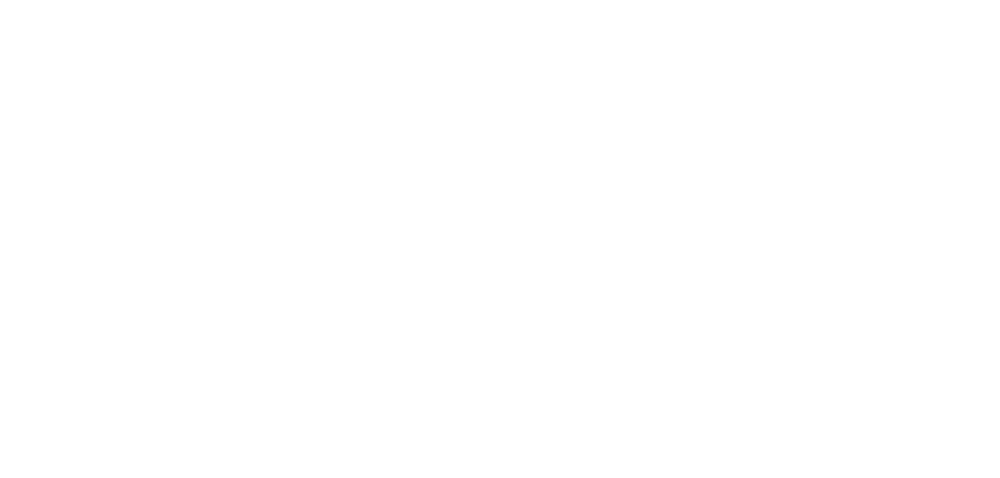

roi112_dff.png


<IPython.core.display.Javascript object>


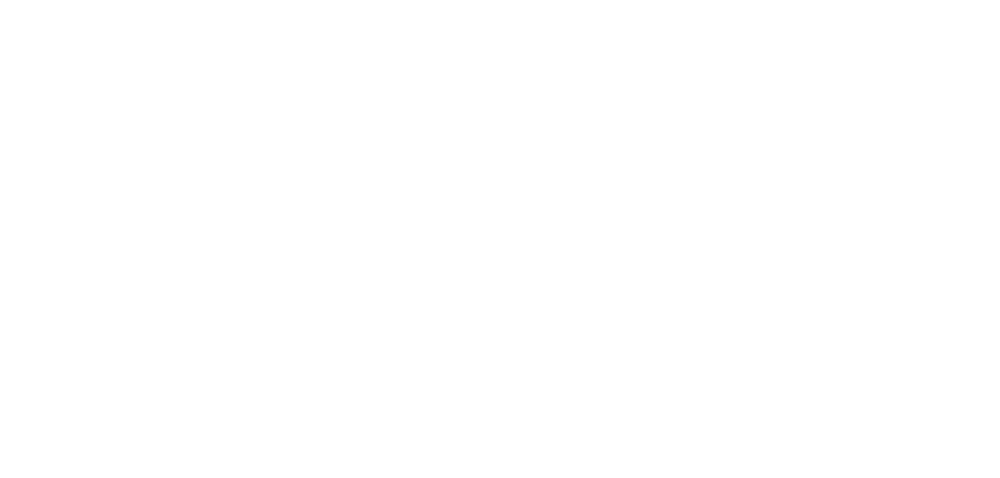

roi113_dff.png


<IPython.core.display.Javascript object>


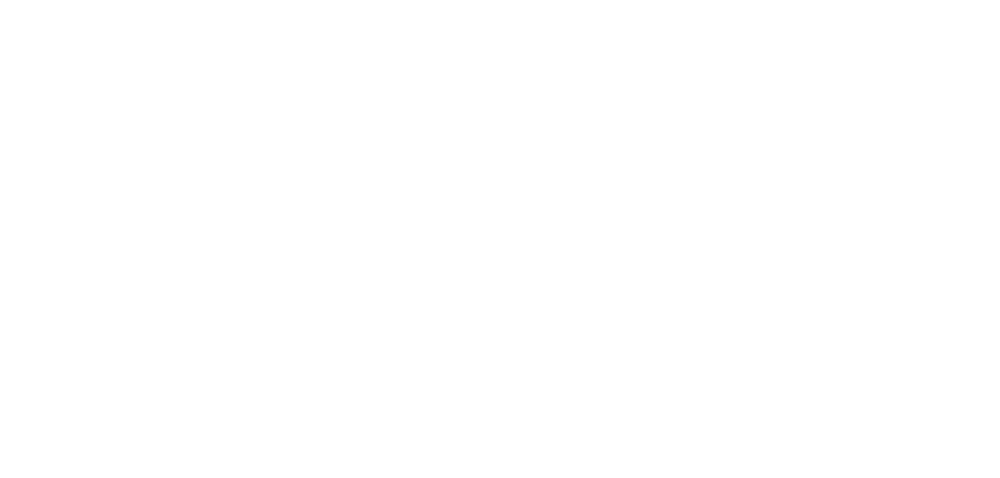

roi114_dff.png


<IPython.core.display.Javascript object>


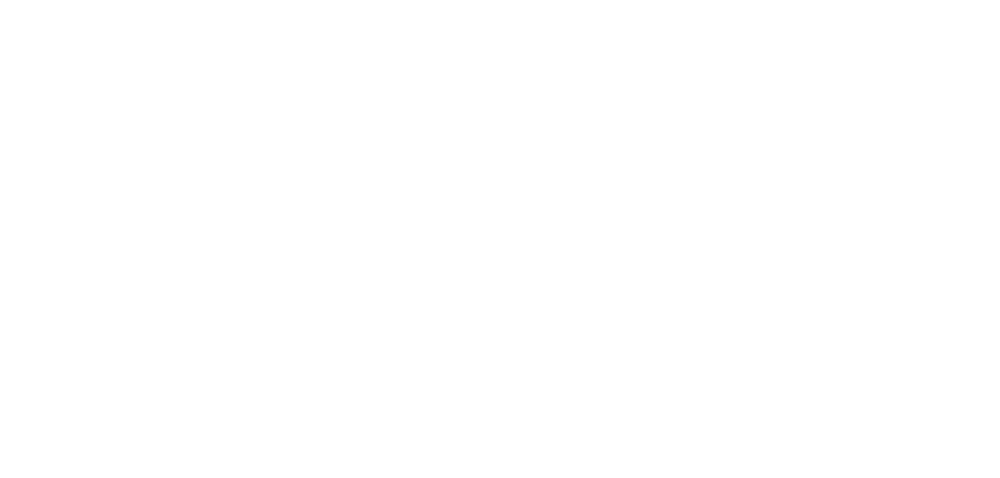

roi115_dff.png


<IPython.core.display.Javascript object>


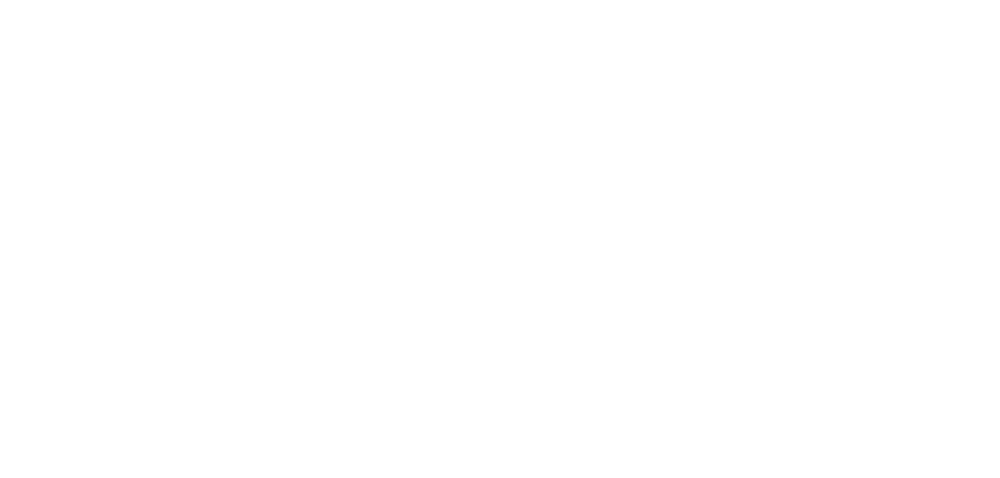

roi116_dff.png


<IPython.core.display.Javascript object>


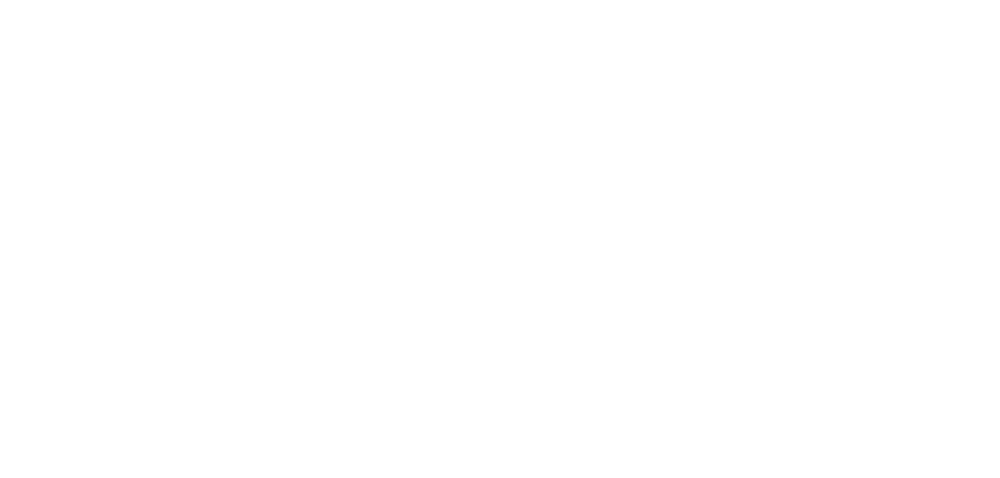

roi117_dff.png


<IPython.core.display.Javascript object>


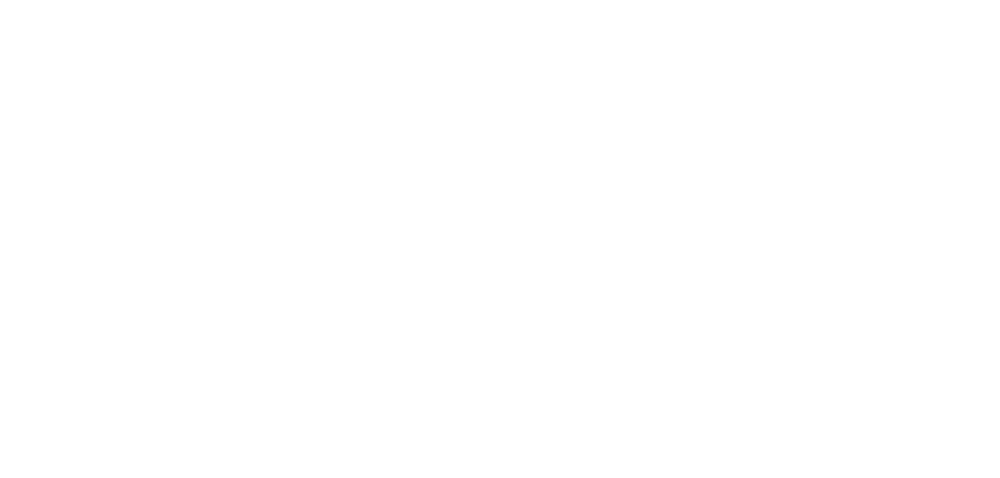

roi118_dff.png


<IPython.core.display.Javascript object>


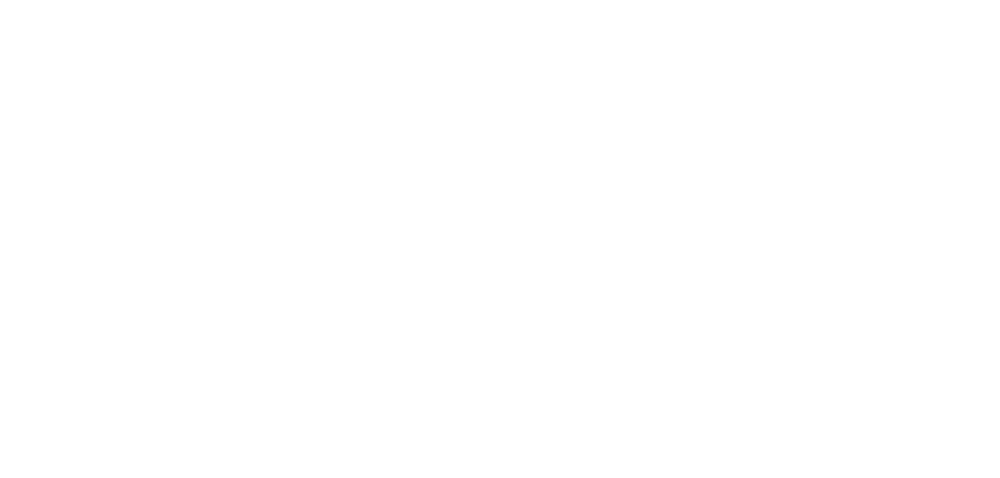

roi119_dff.png


<IPython.core.display.Javascript object>


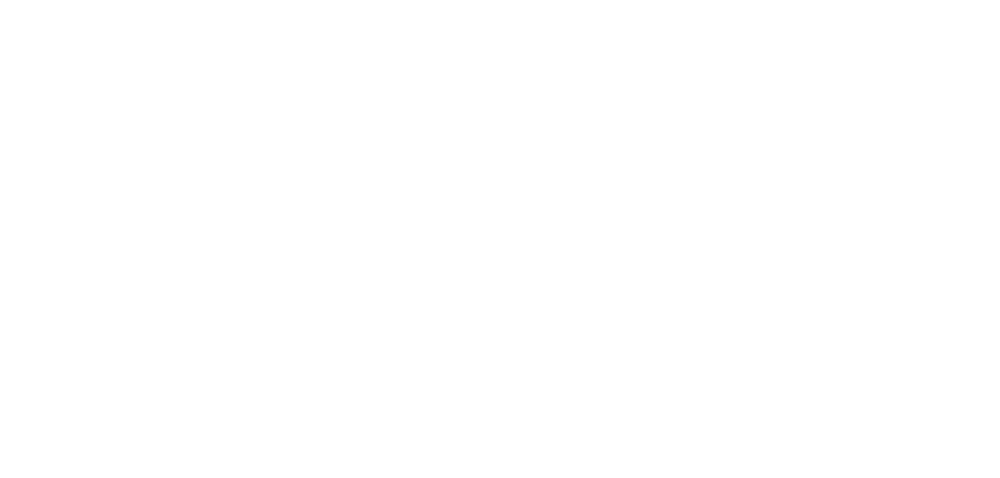

roi120_dff.png


<IPython.core.display.Javascript object>


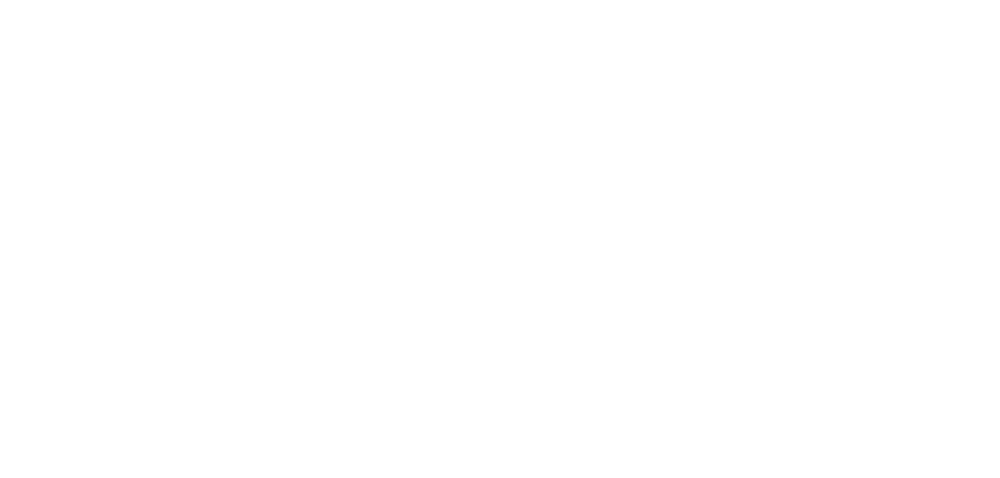

roi121_dff.png


<IPython.core.display.Javascript object>


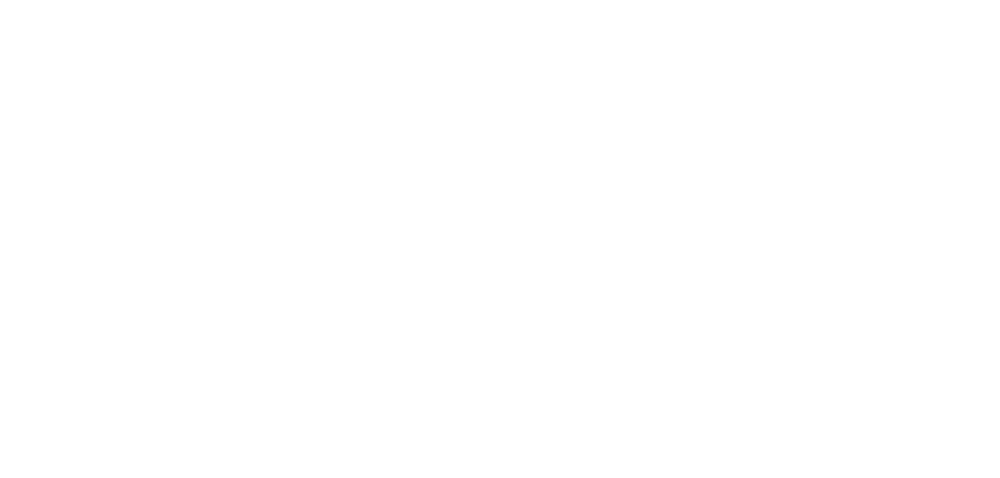

roi122_dff.png


<IPython.core.display.Javascript object>


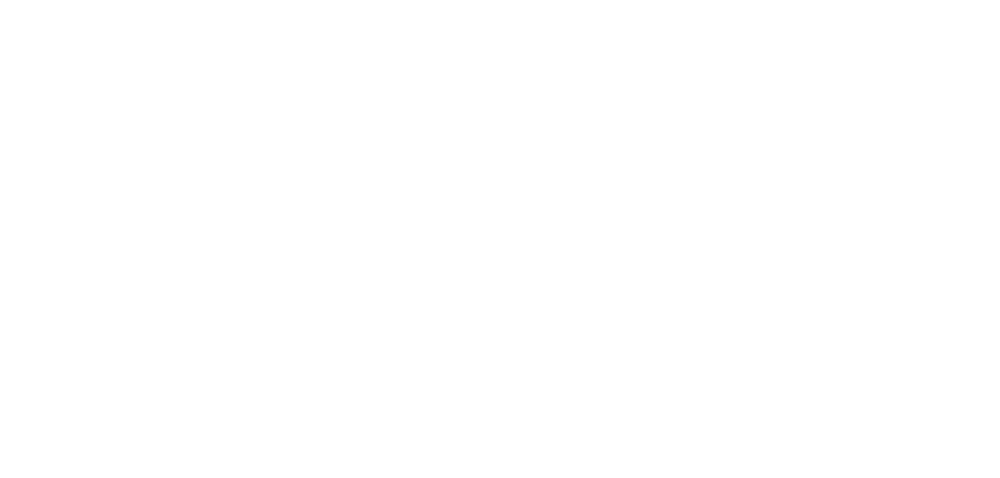

roi123_dff.png


<IPython.core.display.Javascript object>


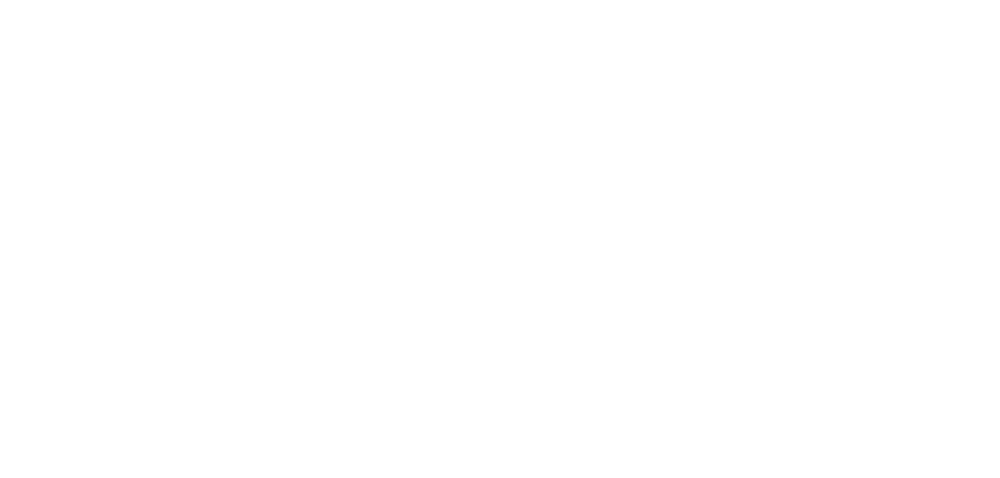

roi124_dff.png


<IPython.core.display.Javascript object>


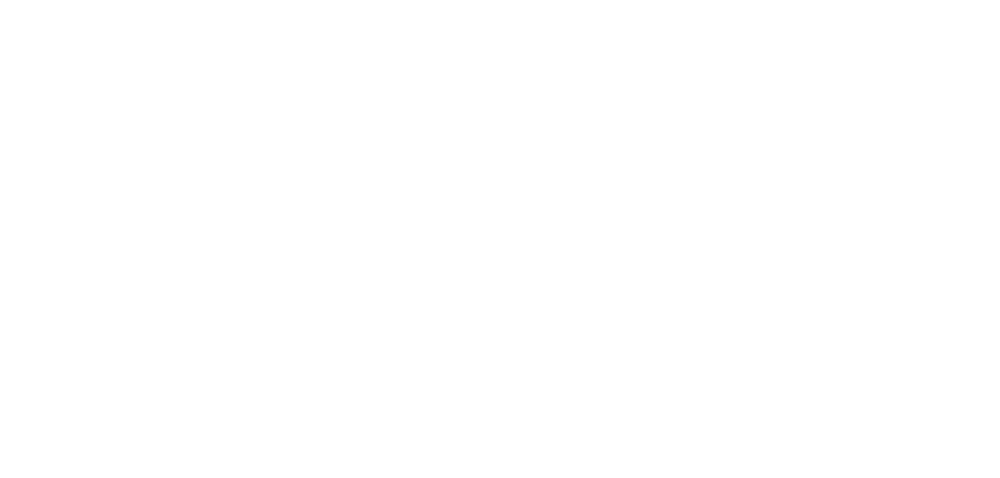

roi125_dff.png


<IPython.core.display.Javascript object>


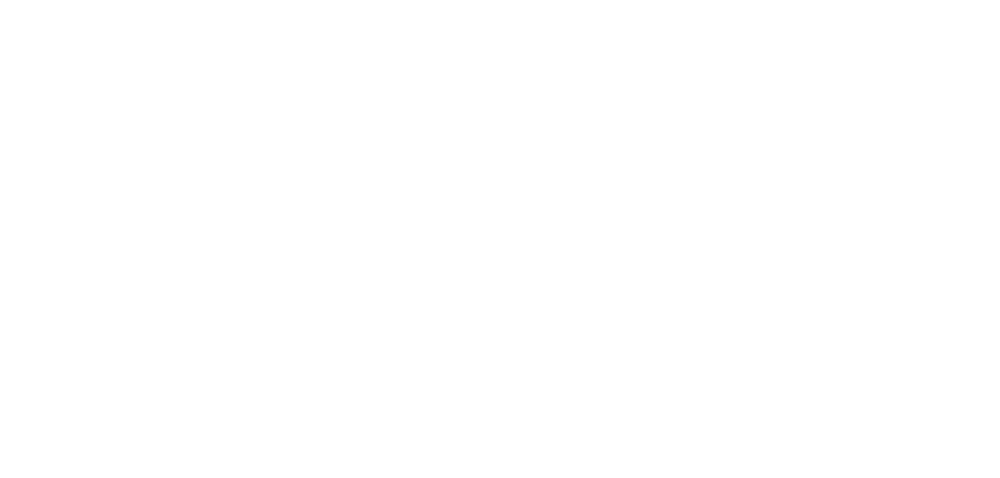

roi126_dff.png


<IPython.core.display.Javascript object>


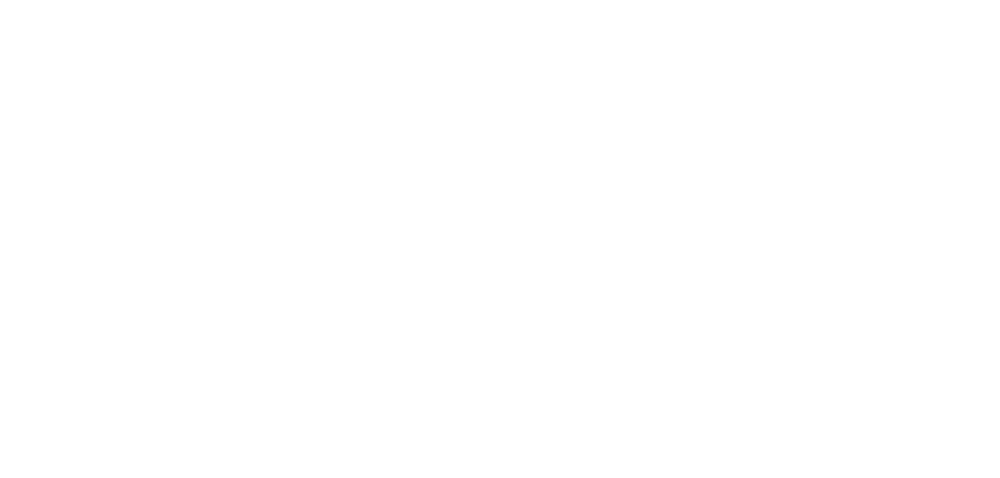

roi127_dff.png


<IPython.core.display.Javascript object>


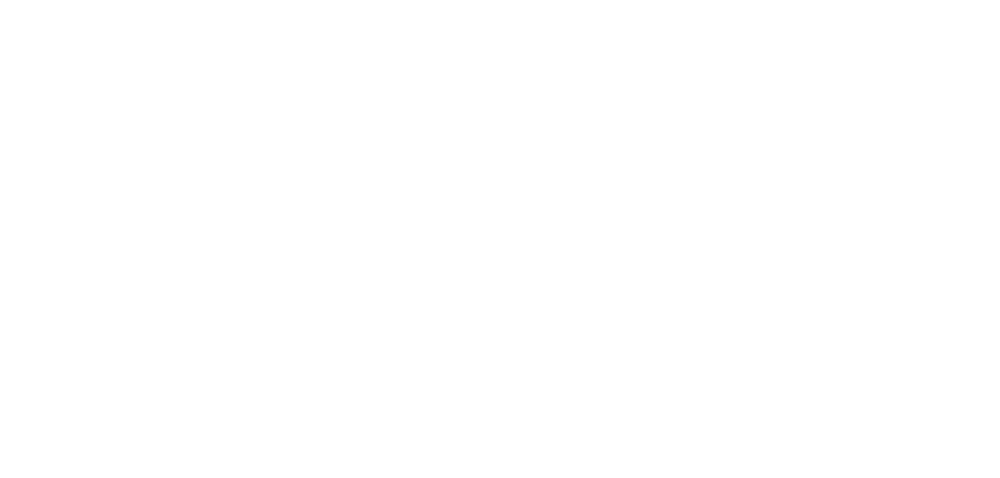

roi128_dff.png


<IPython.core.display.Javascript object>


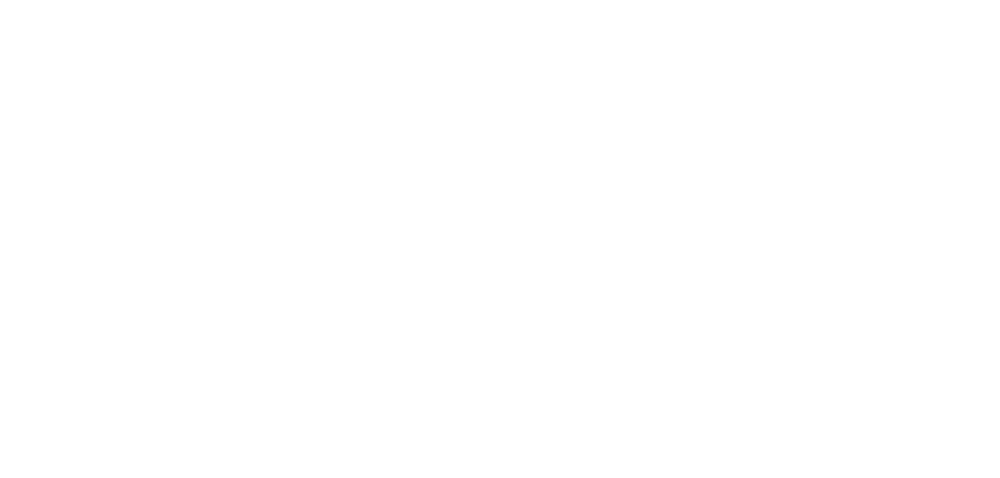

roi129_dff.png


<IPython.core.display.Javascript object>


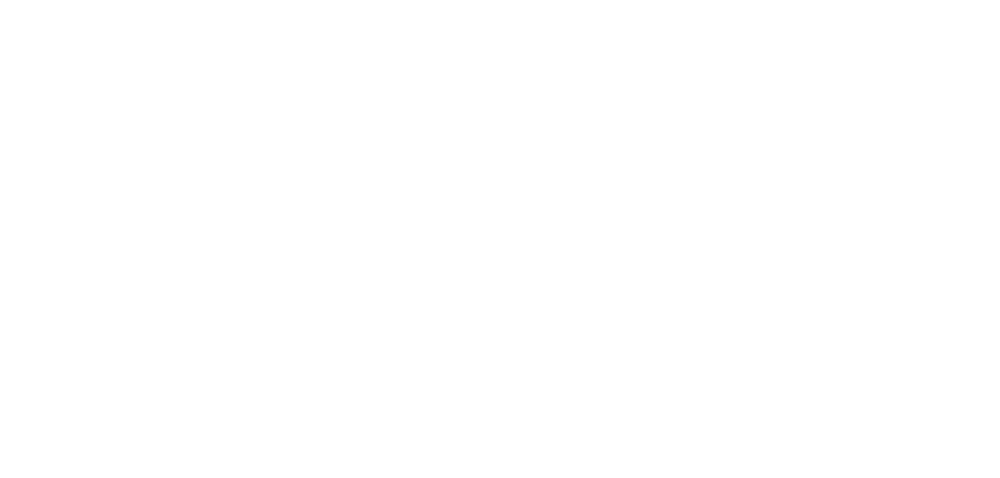

roi130_dff.png


<IPython.core.display.Javascript object>


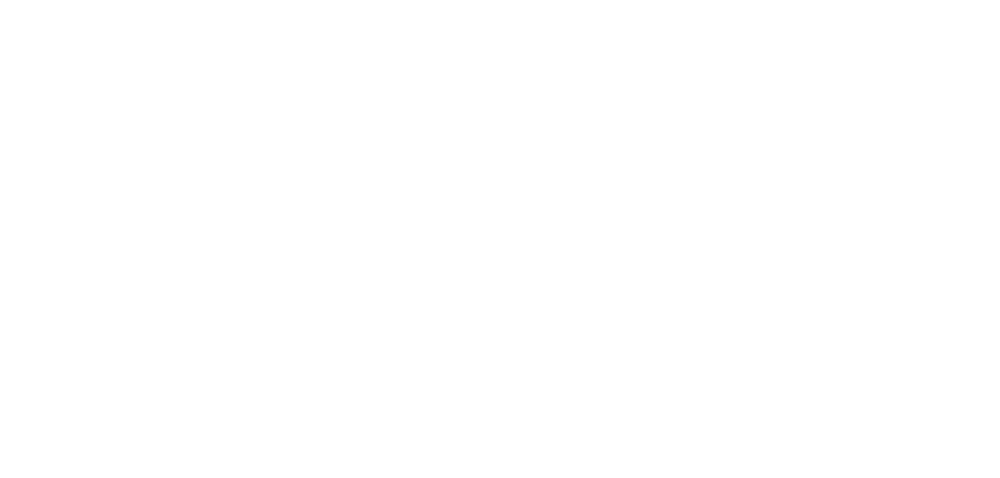

roi131_dff.png


<IPython.core.display.Javascript object>


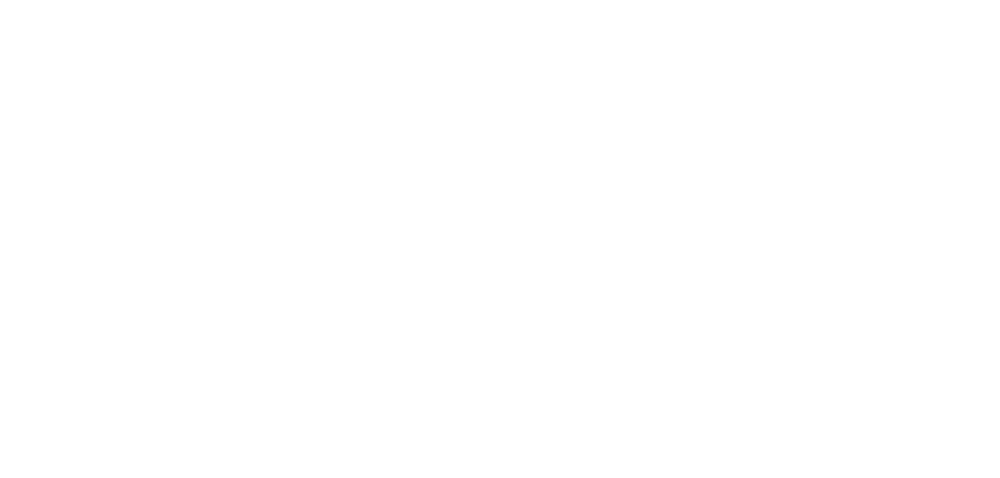

roi132_dff.png


<IPython.core.display.Javascript object>


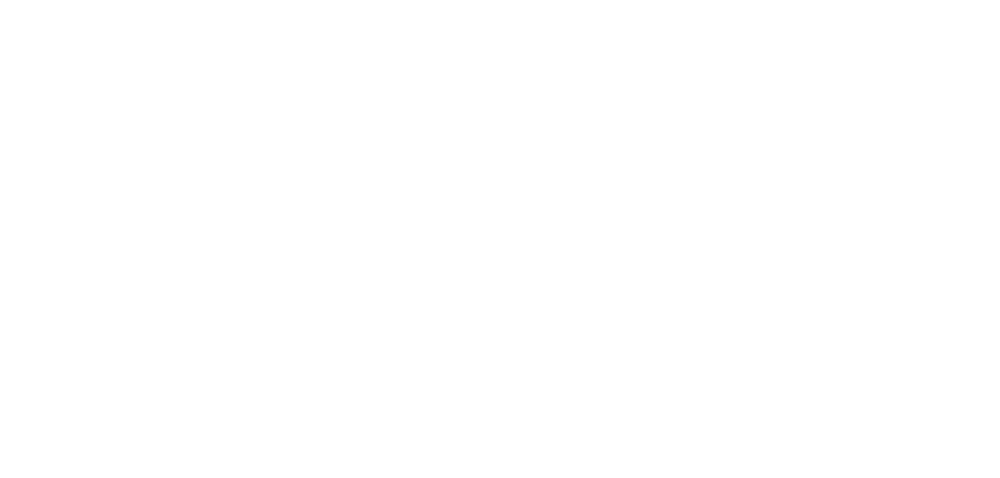

roi133_dff.png


<IPython.core.display.Javascript object>


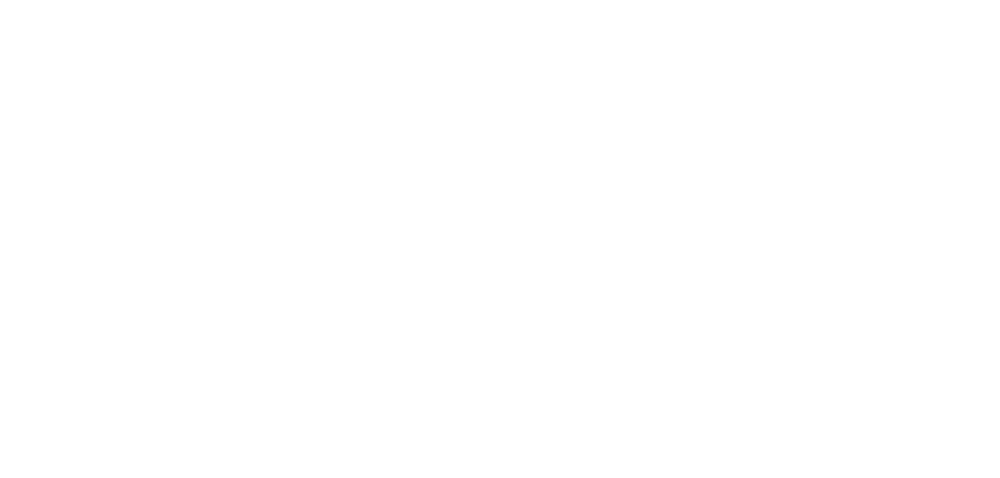

roi134_dff.png


<IPython.core.display.Javascript object>


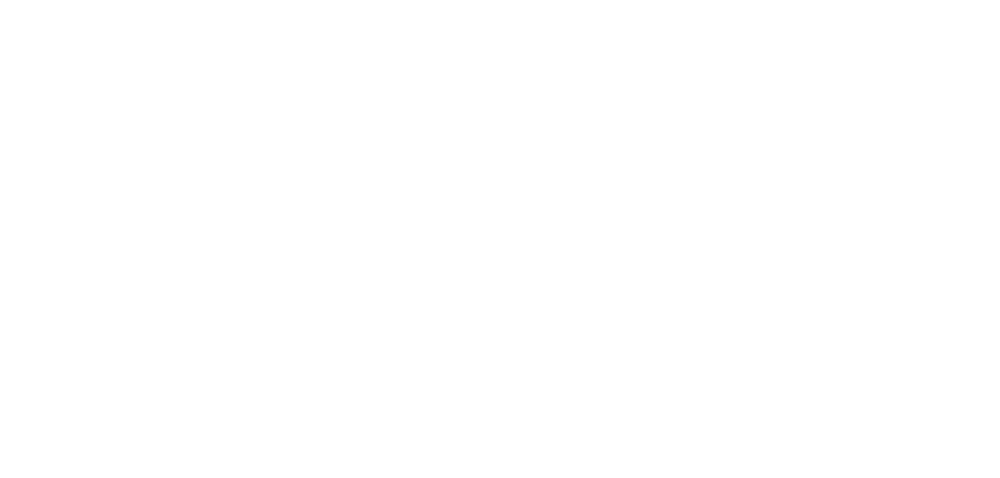

roi135_dff.png


<IPython.core.display.Javascript object>


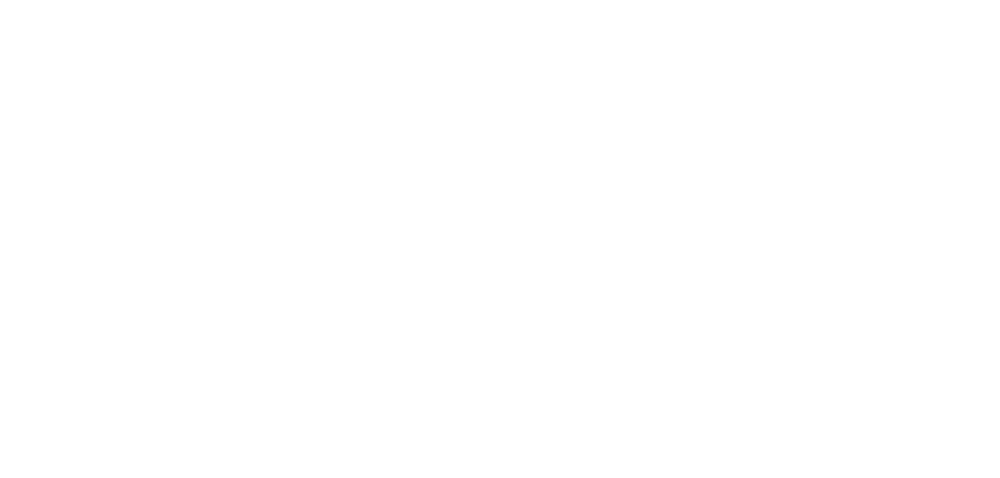

roi136_dff.png


<IPython.core.display.Javascript object>


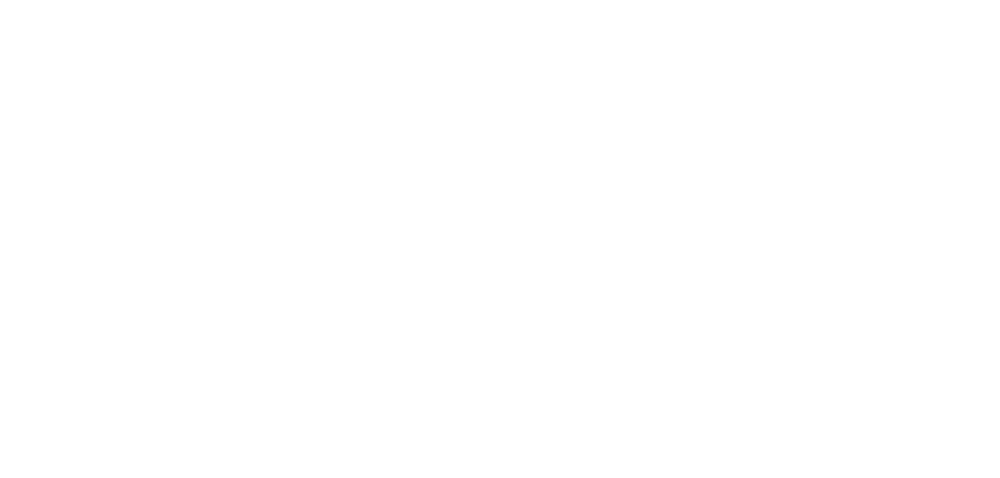

roi137_dff.png


<IPython.core.display.Javascript object>


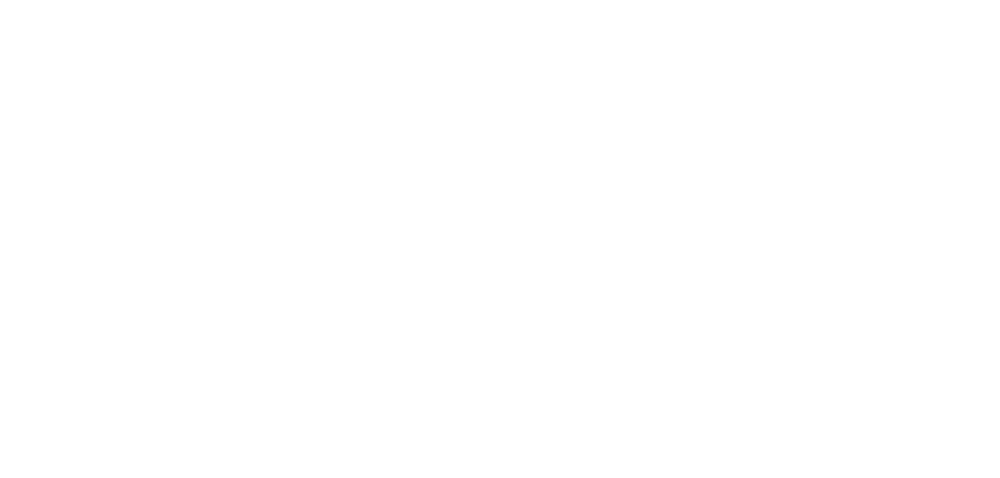

roi138_dff.png


<IPython.core.display.Javascript object>


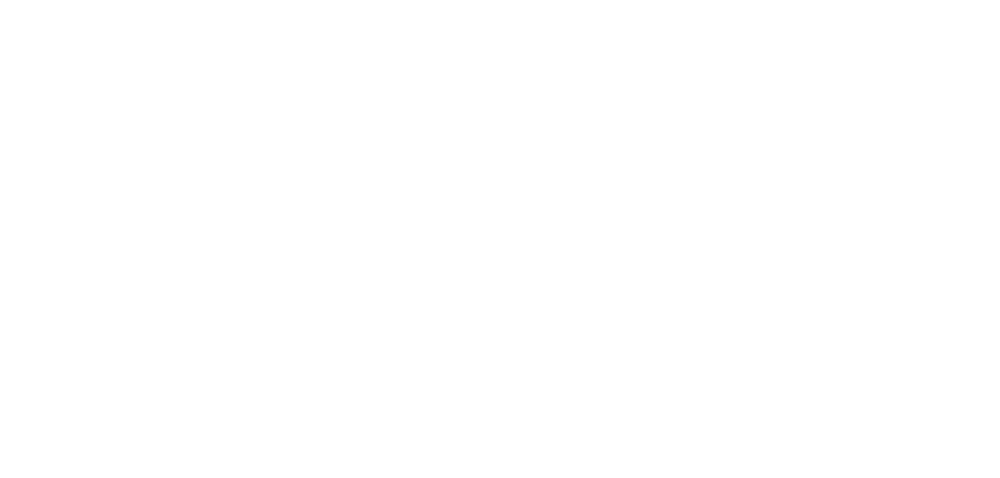

roi139_dff.png


<IPython.core.display.Javascript object>


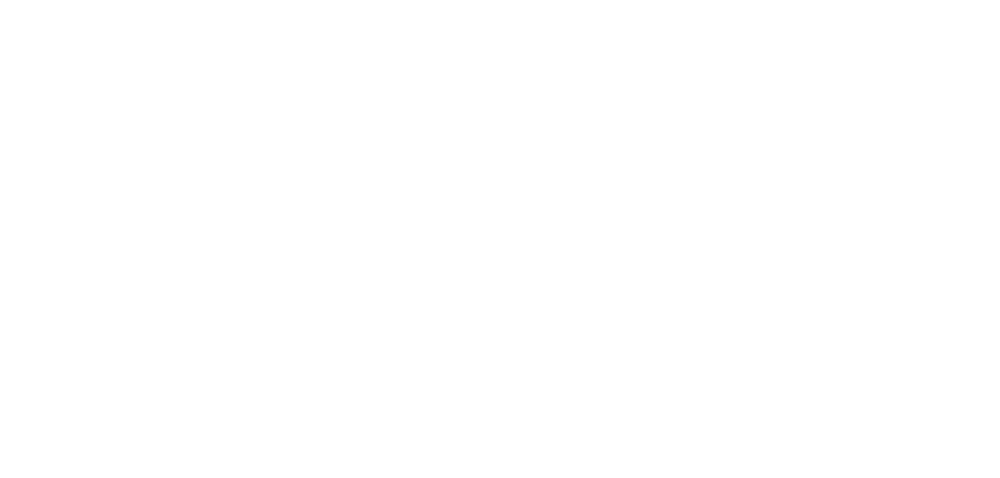

roi140_dff.png


<IPython.core.display.Javascript object>


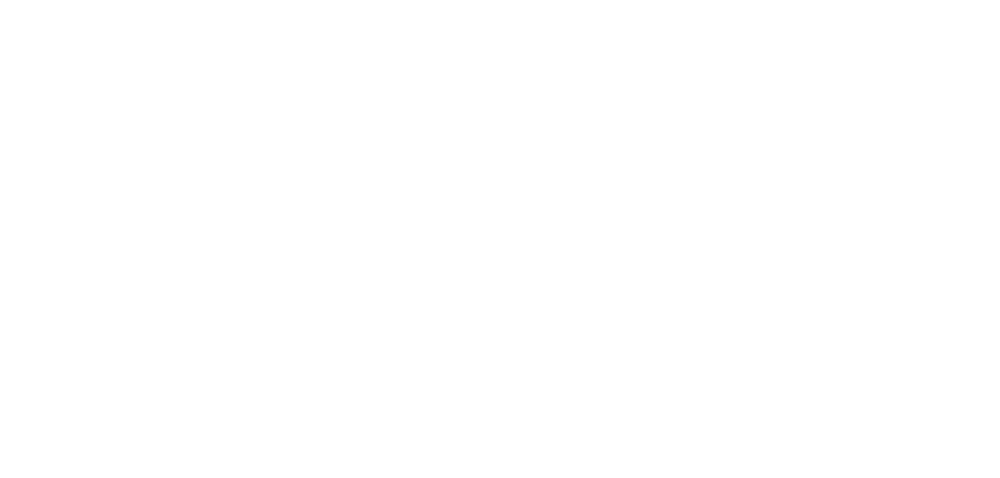

roi141_dff.png


<IPython.core.display.Javascript object>


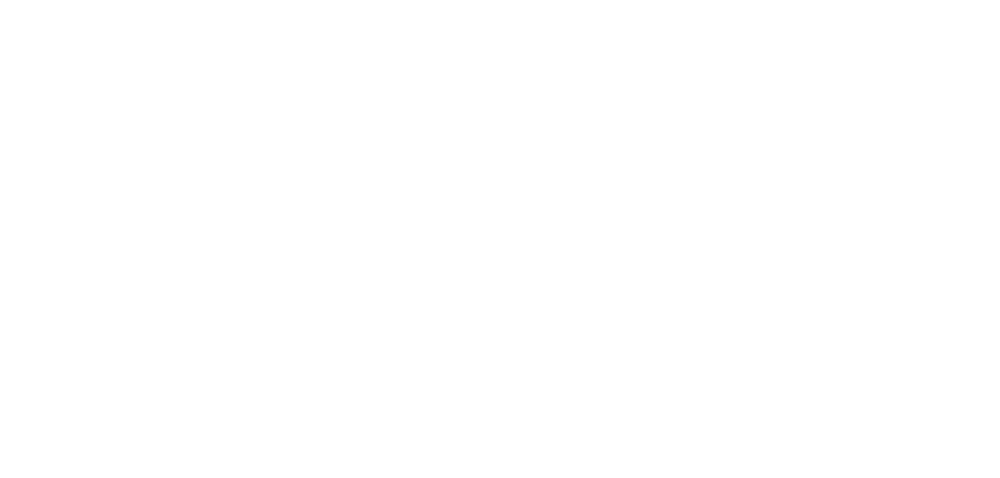

roi142_dff.png


<IPython.core.display.Javascript object>


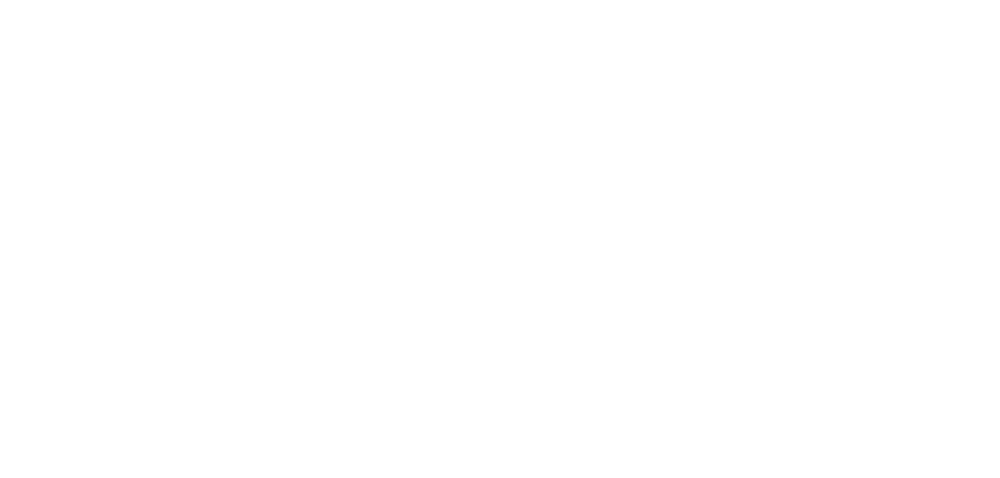

roi143_dff.png


<IPython.core.display.Javascript object>


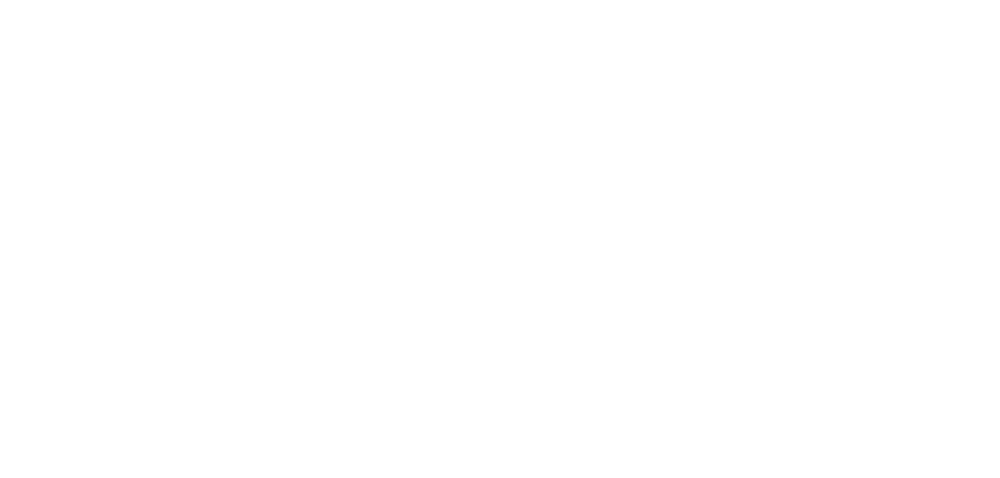

roi144_dff.png


<IPython.core.display.Javascript object>


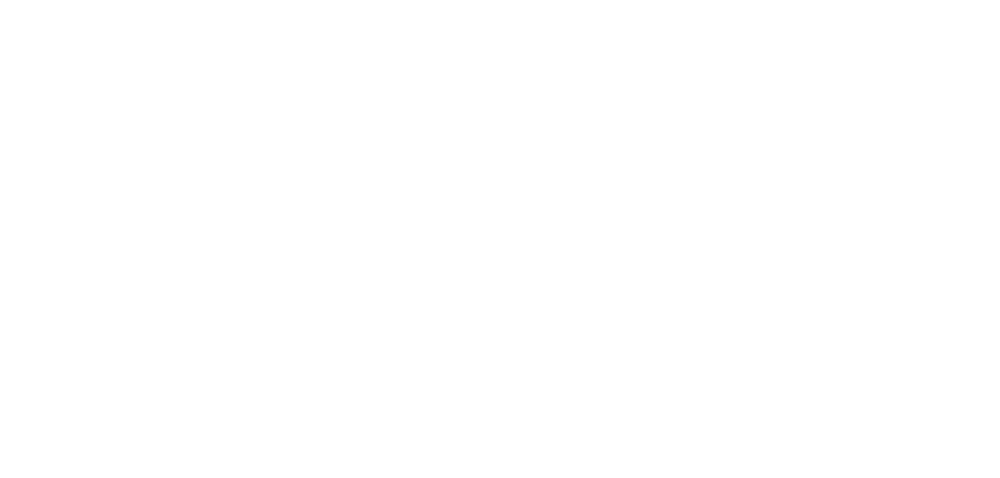

roi145_dff.png


<IPython.core.display.Javascript object>


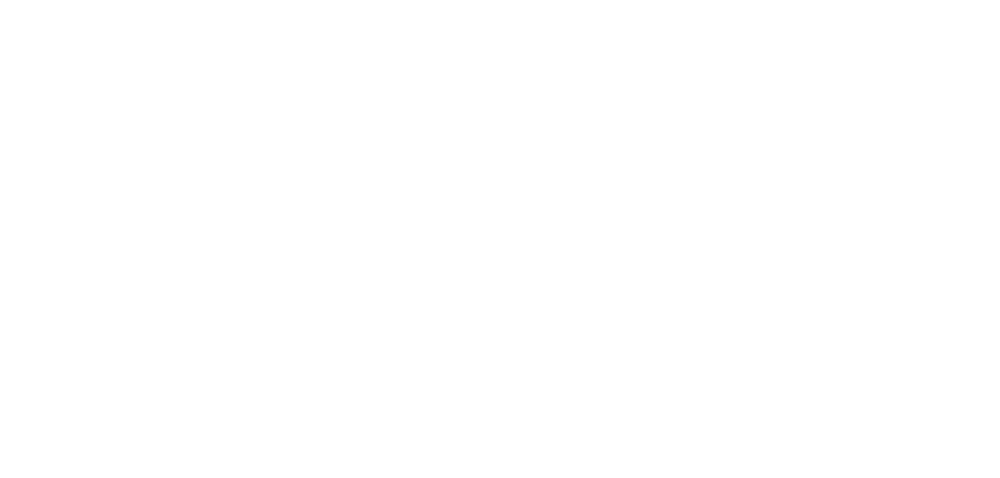

roi146_dff.png


<IPython.core.display.Javascript object>


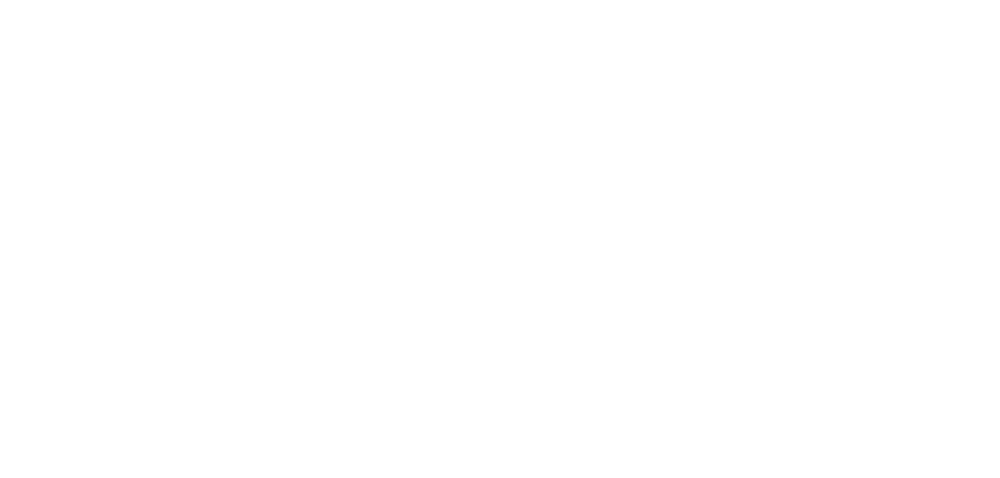

roi147_dff.png


<IPython.core.display.Javascript object>


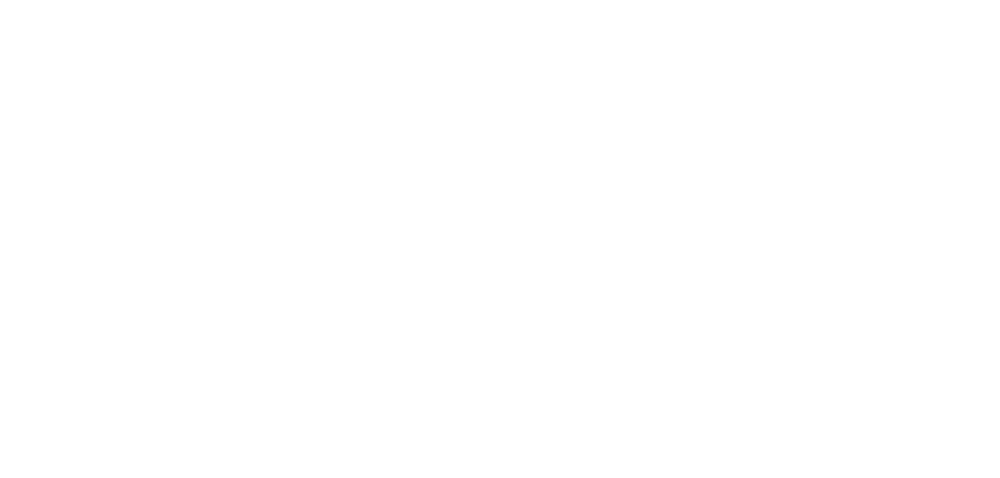

roi148_dff.png


<IPython.core.display.Javascript object>


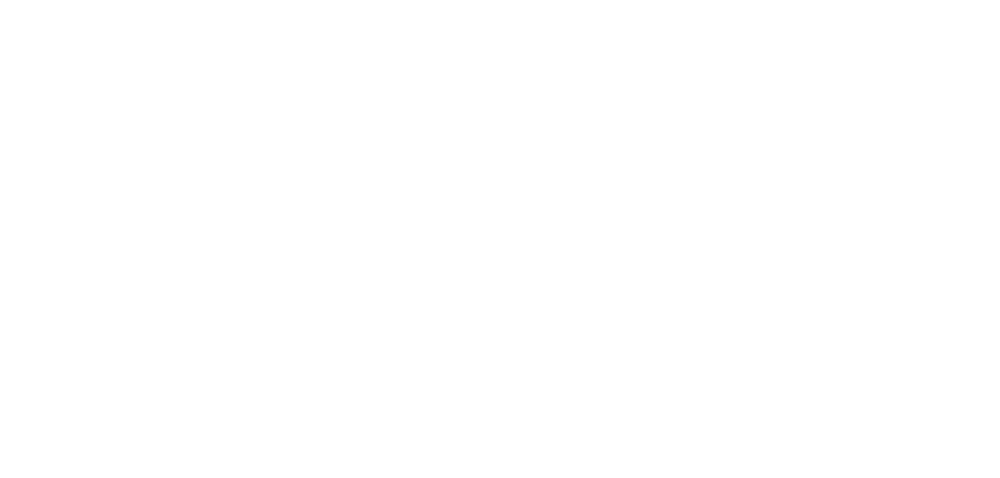

roi149_dff.png


<IPython.core.display.Javascript object>


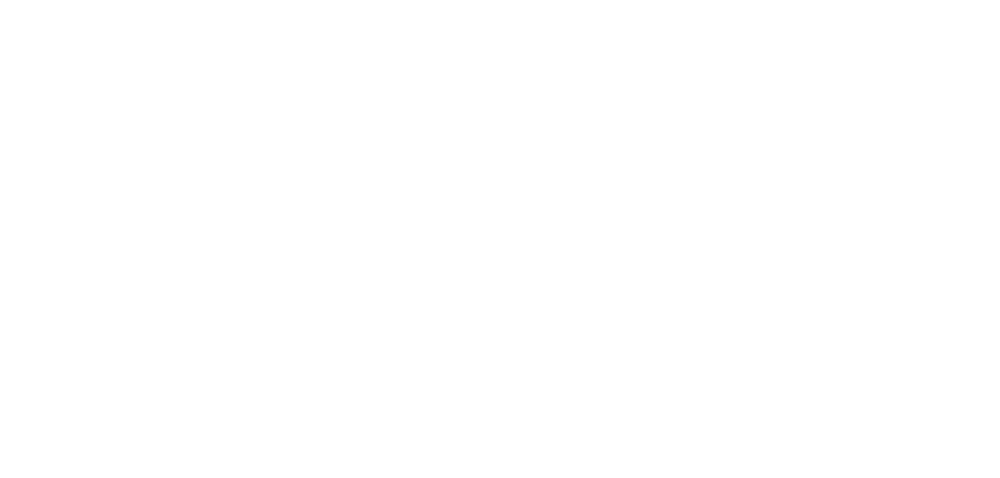

roi150_dff.png


<IPython.core.display.Javascript object>


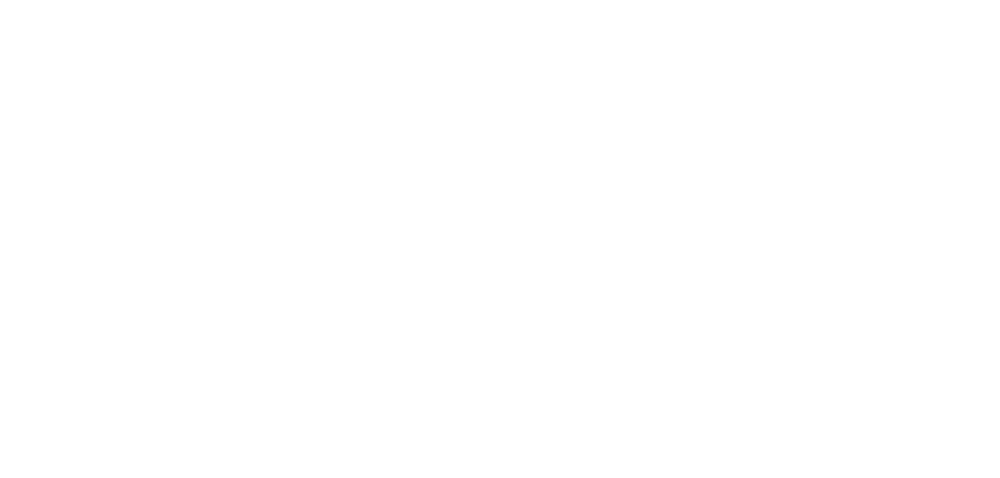

roi151_dff.png


<IPython.core.display.Javascript object>


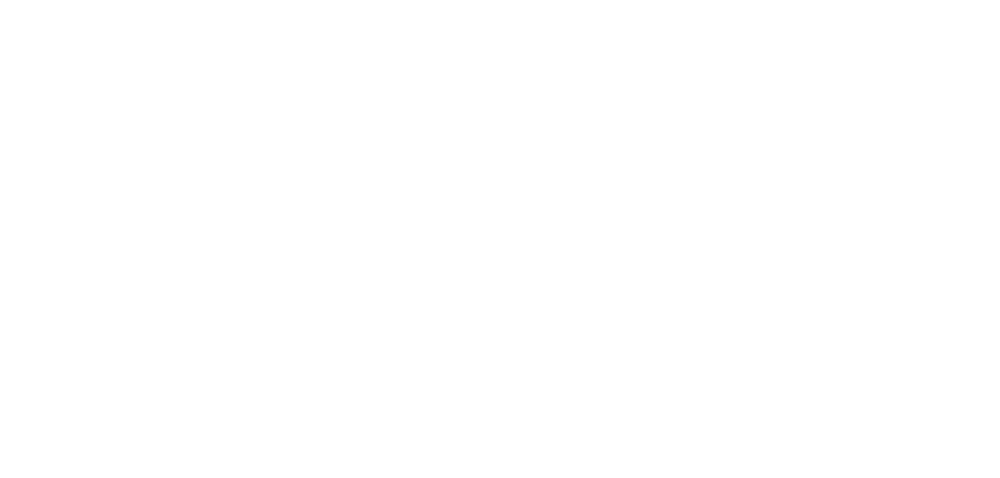

roi152_dff.png


<IPython.core.display.Javascript object>


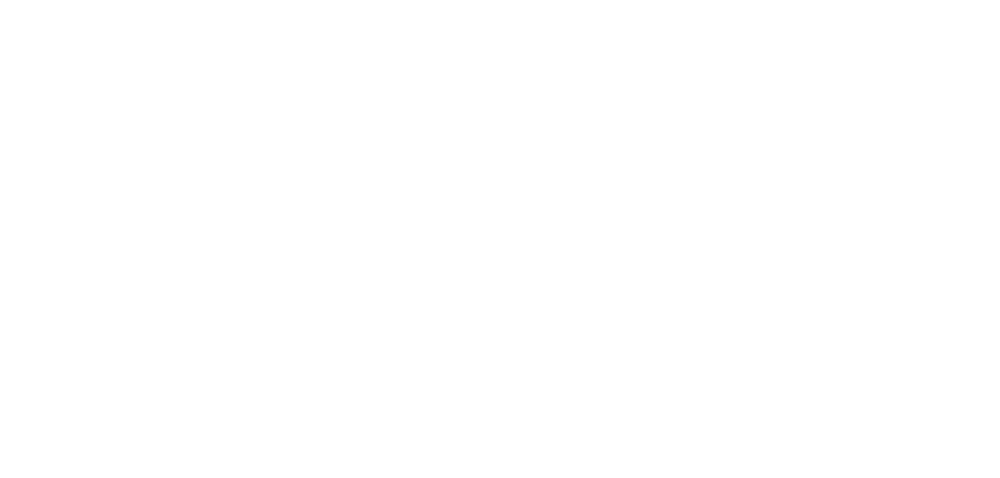

roi153_dff.png


<IPython.core.display.Javascript object>


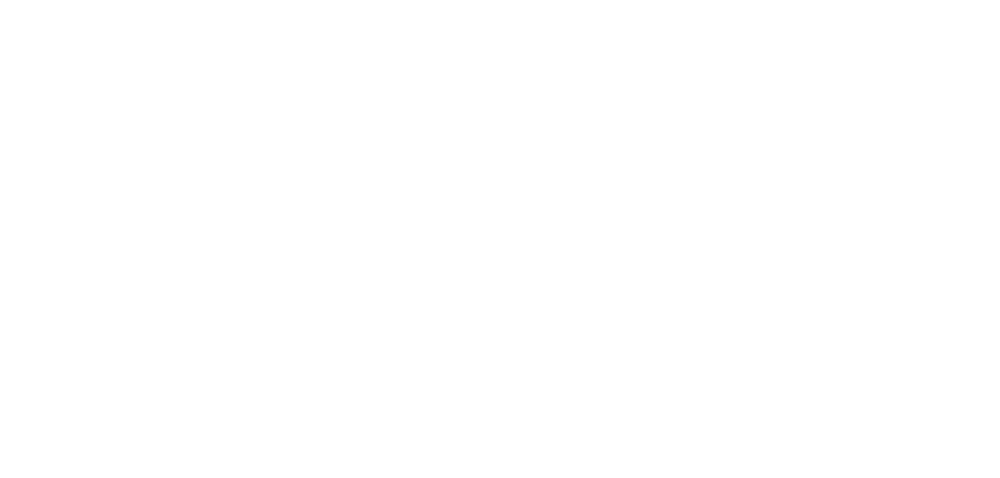

roi154_dff.png


<IPython.core.display.Javascript object>


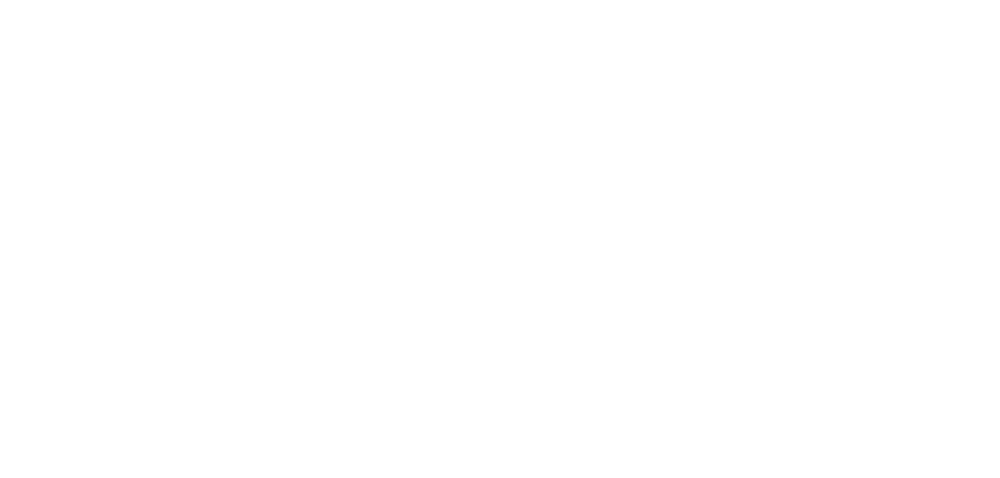

roi155_dff.png


<IPython.core.display.Javascript object>


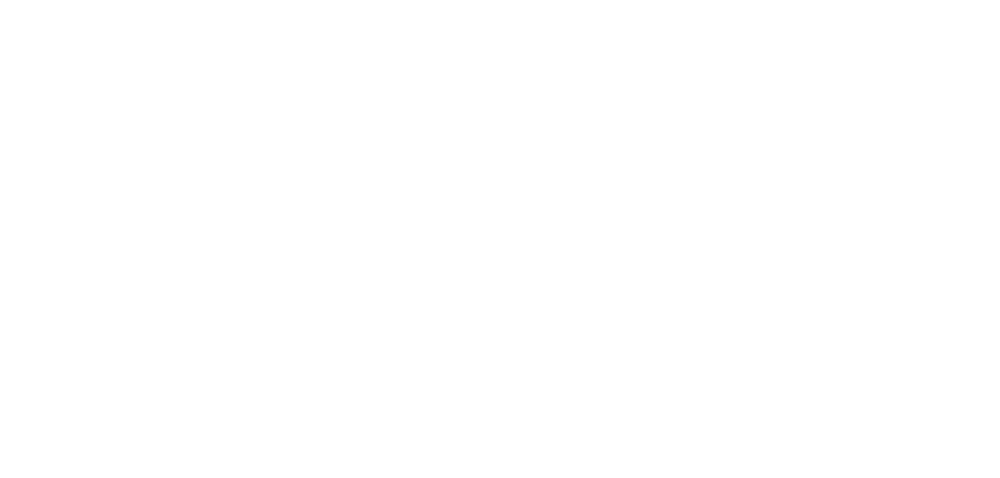

roi156_dff.png


<IPython.core.display.Javascript object>


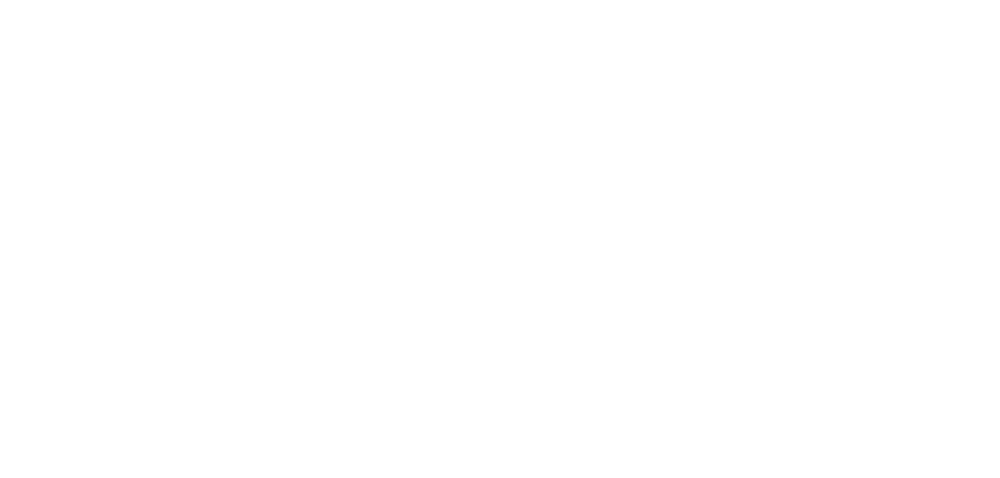

roi157_dff.png


<IPython.core.display.Javascript object>


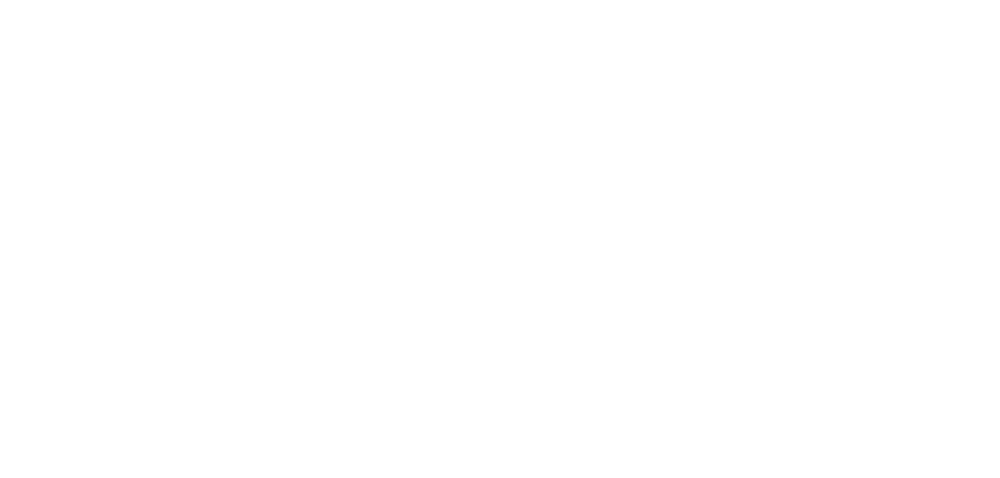

roi158_dff.png


<IPython.core.display.Javascript object>


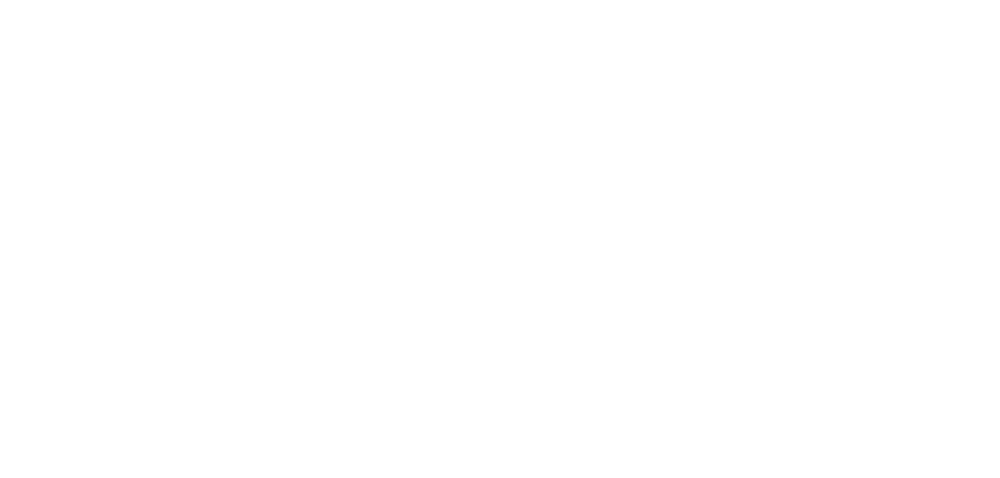

roi159_dff.png


<IPython.core.display.Javascript object>


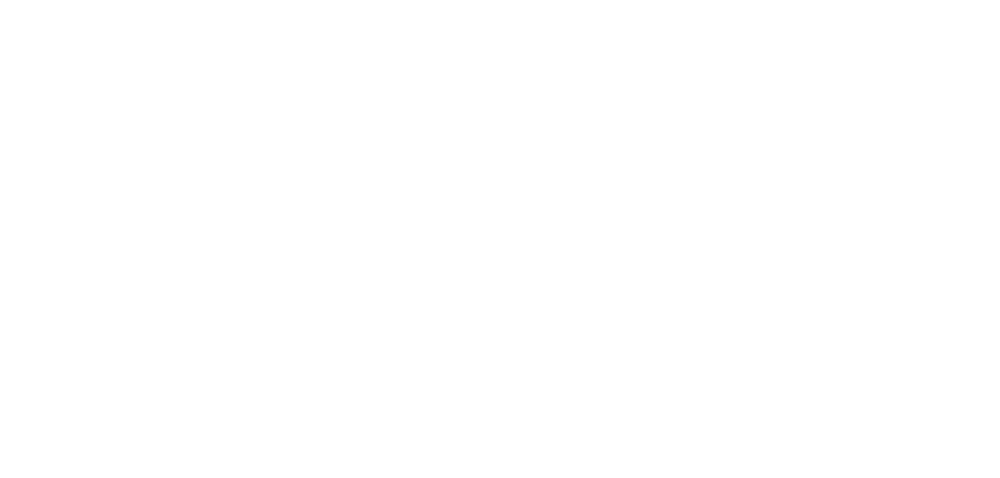

roi160_dff.png


<IPython.core.display.Javascript object>


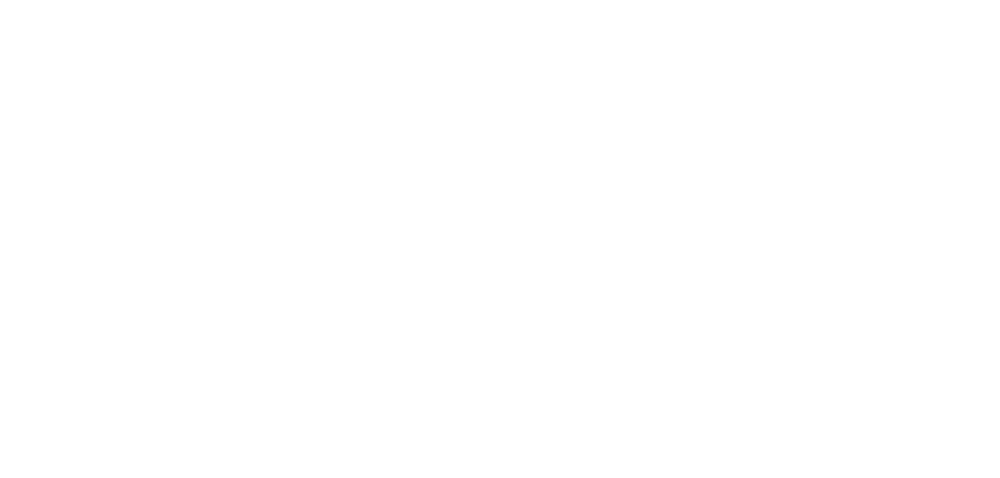

roi161_dff.png


<IPython.core.display.Javascript object>


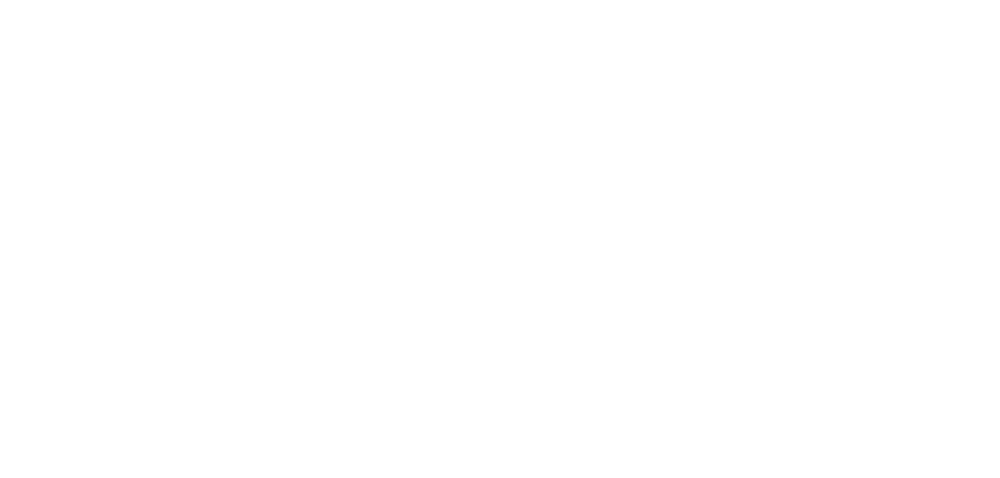

roi162_dff.png


<IPython.core.display.Javascript object>


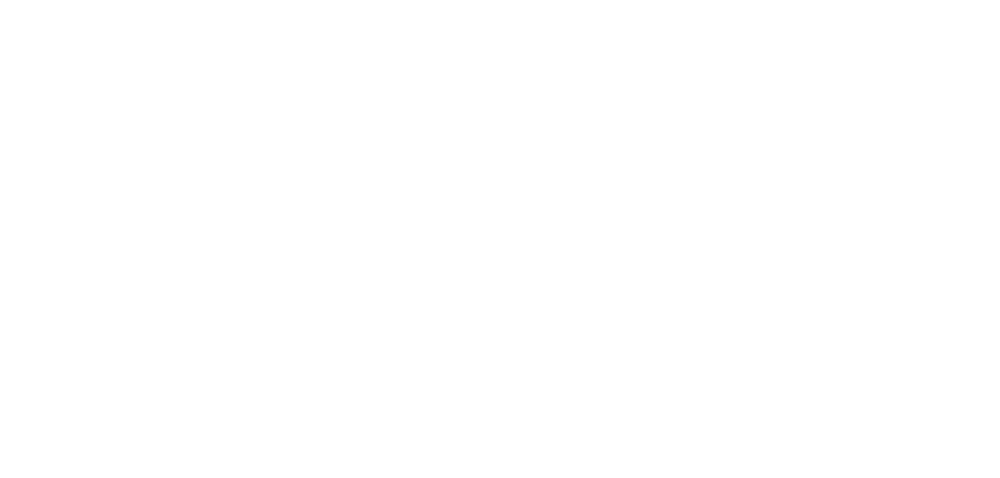

roi163_dff.png


<IPython.core.display.Javascript object>


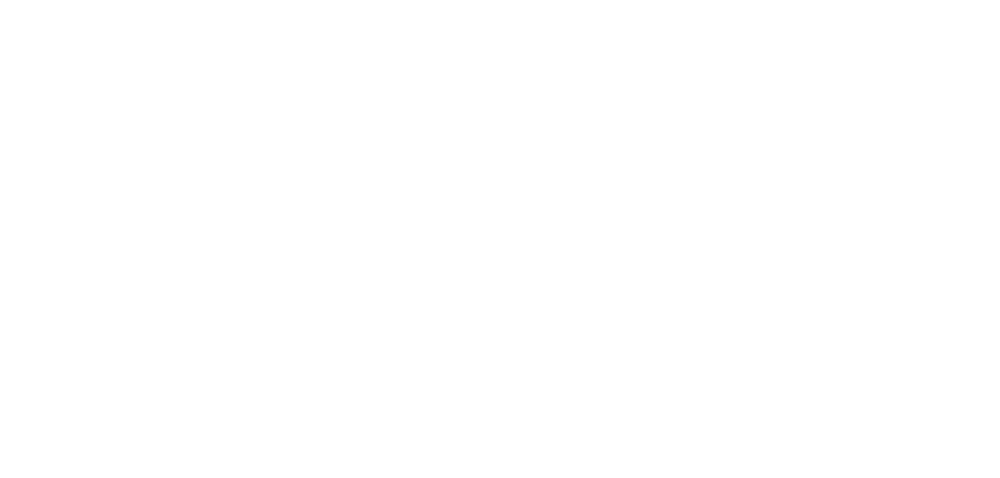

roi164_dff.png


<IPython.core.display.Javascript object>


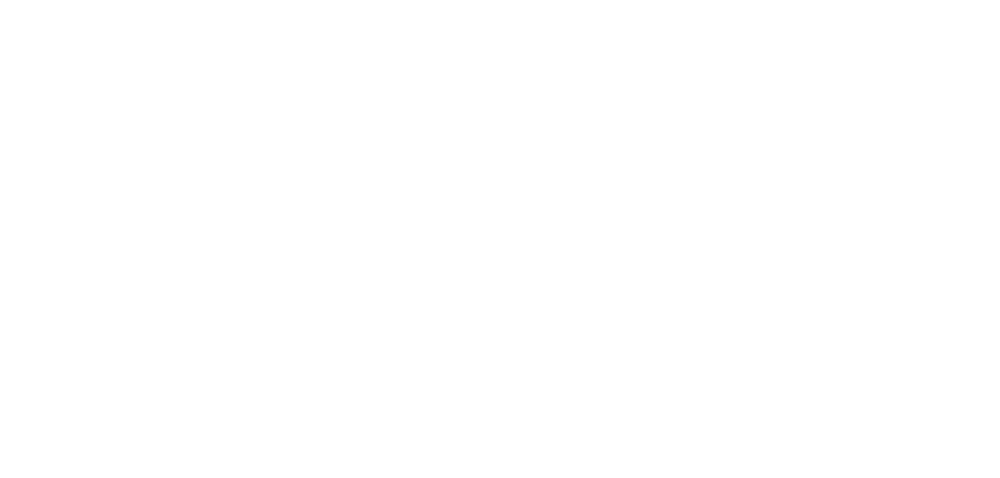

roi165_dff.png


<IPython.core.display.Javascript object>


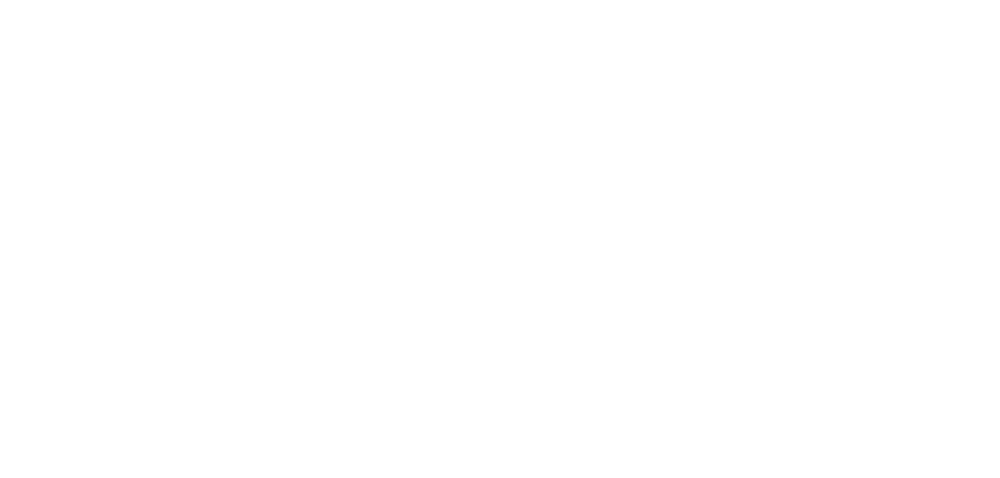

roi166_dff.png


<IPython.core.display.Javascript object>


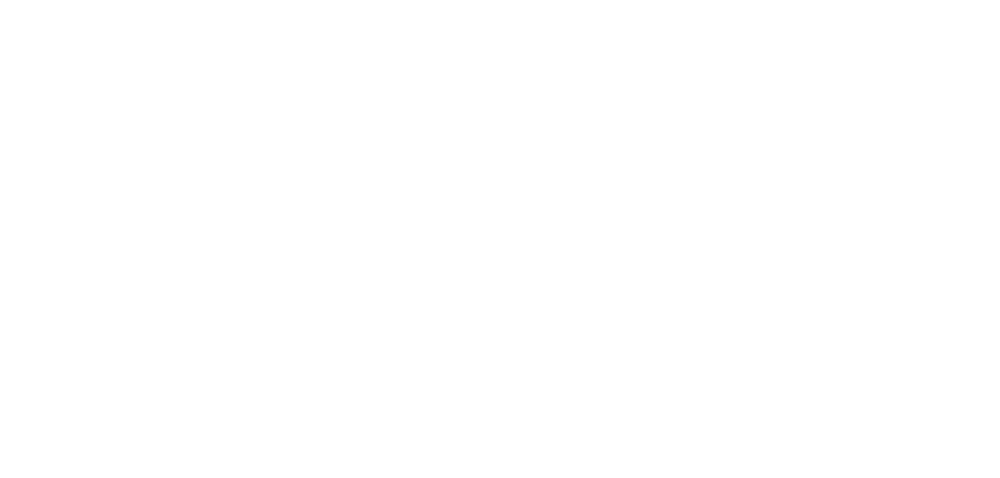

roi167_dff.png


<IPython.core.display.Javascript object>


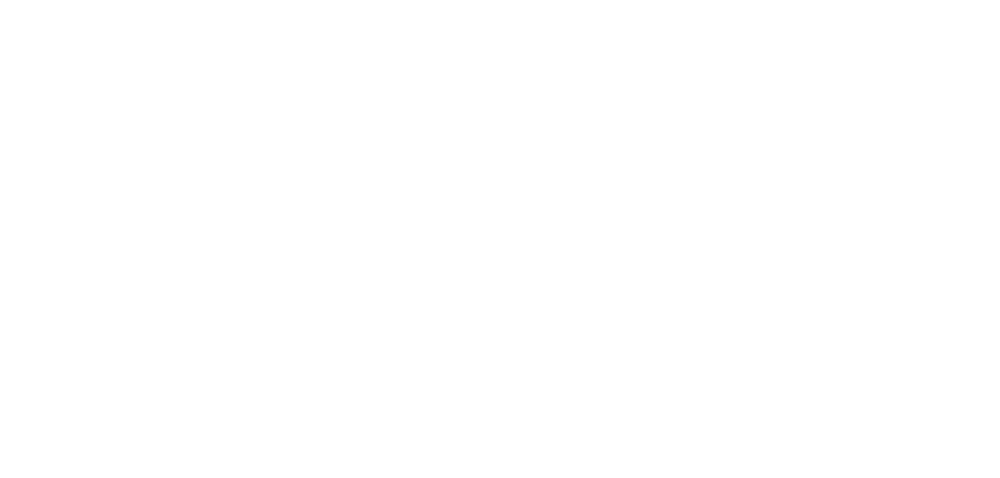

roi168_dff.png


<IPython.core.display.Javascript object>


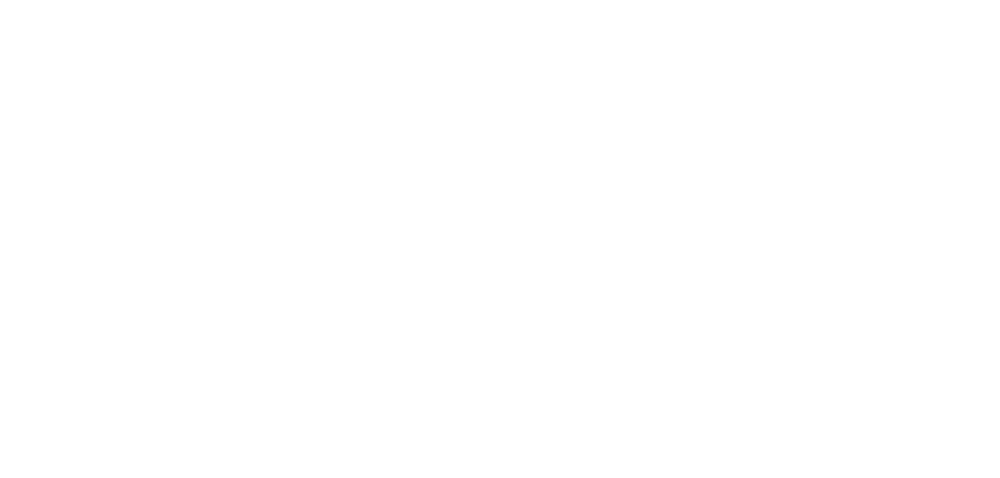

roi169_dff.png


<IPython.core.display.Javascript object>


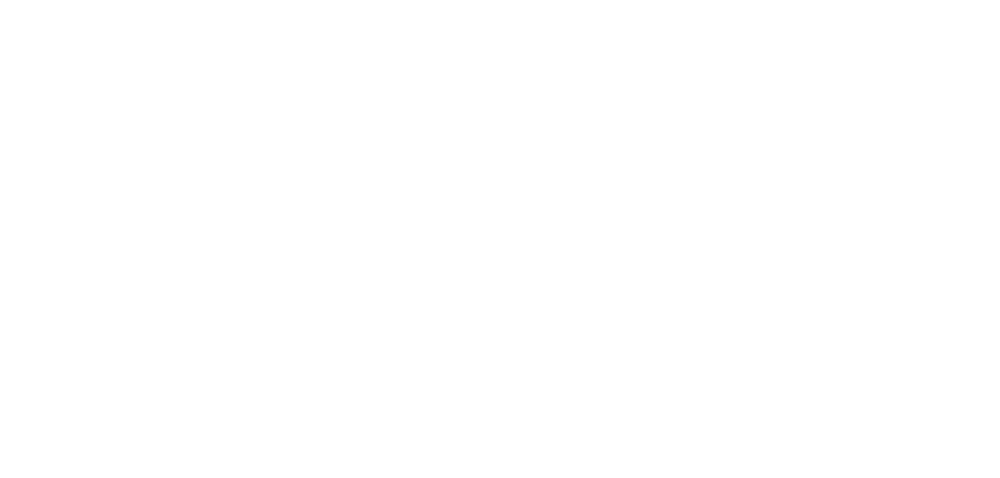

roi170_dff.png


<IPython.core.display.Javascript object>


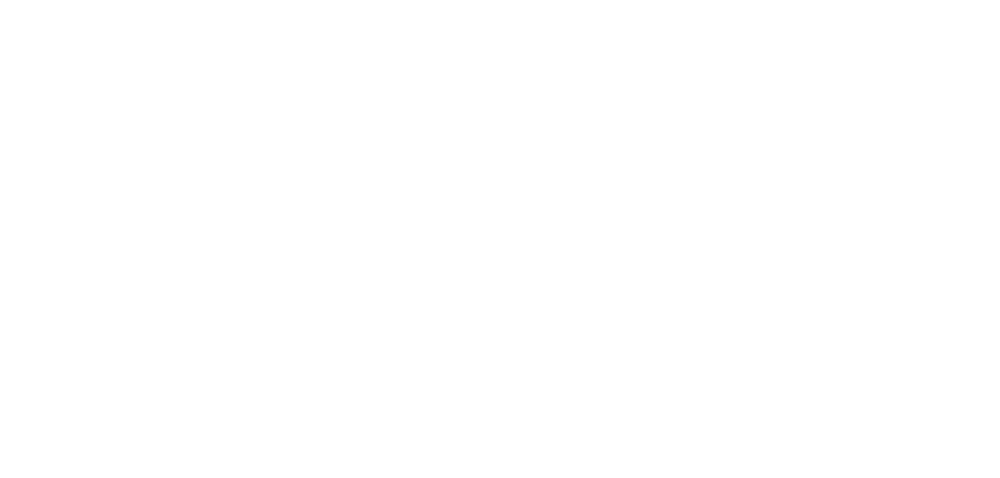

roi171_dff.png


<IPython.core.display.Javascript object>


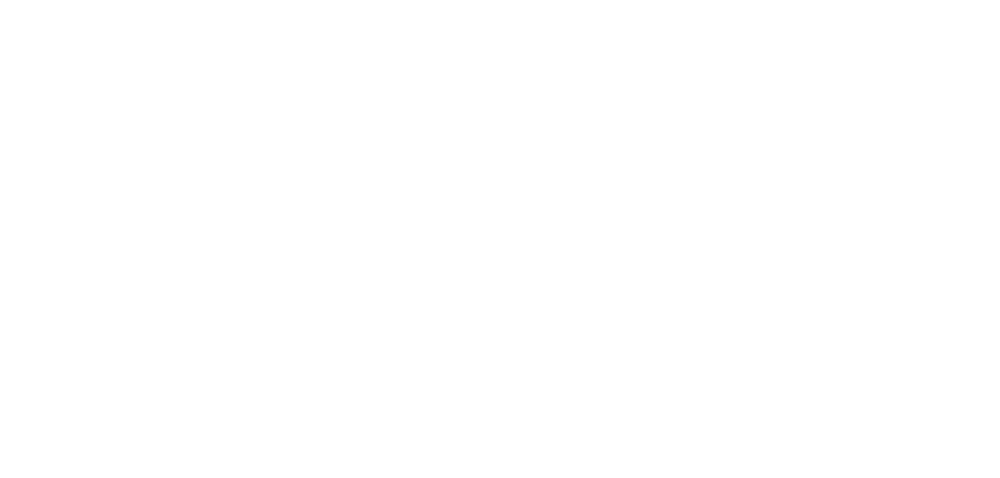

roi172_dff.png


<IPython.core.display.Javascript object>


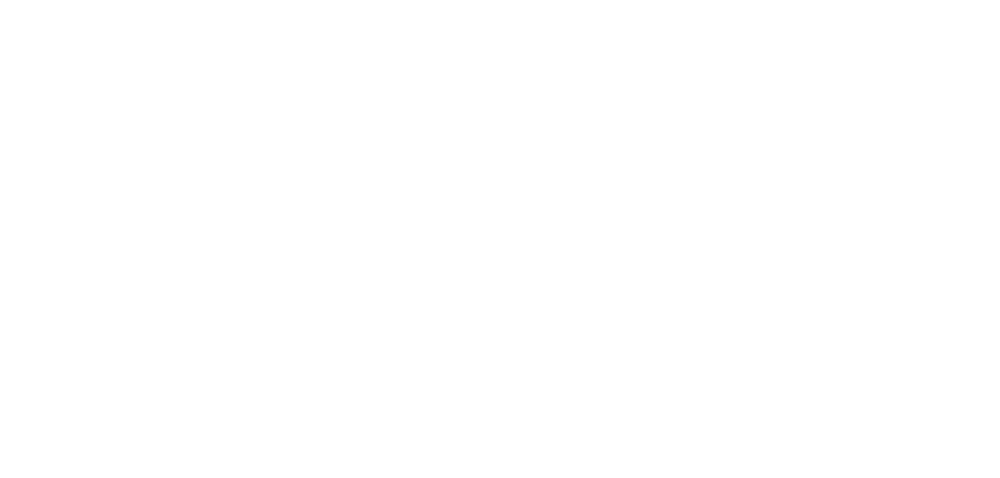

roi173_dff.png


<IPython.core.display.Javascript object>


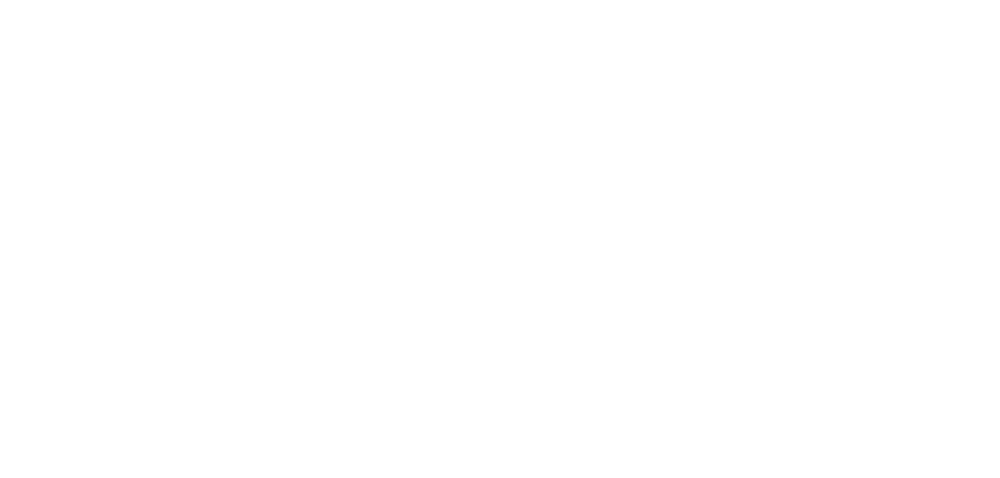

roi174_dff.png


<IPython.core.display.Javascript object>


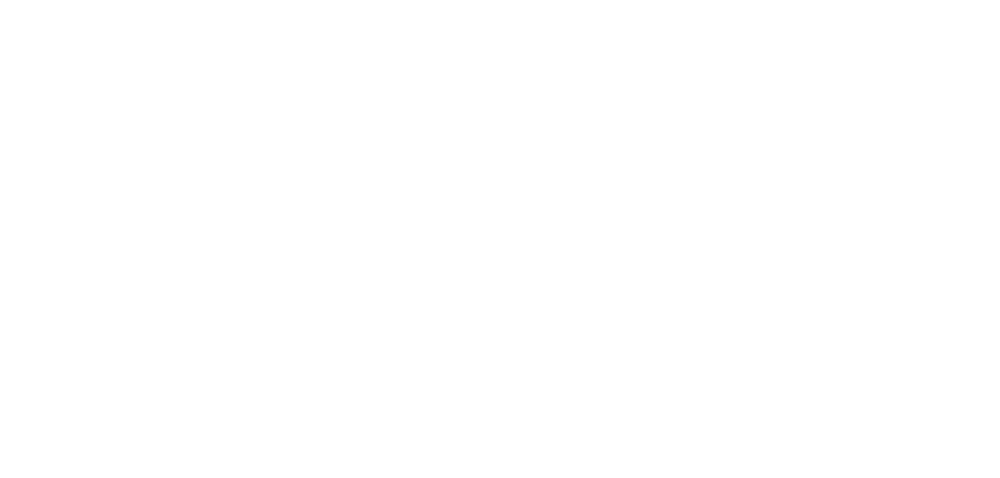

roi175_dff.png


<IPython.core.display.Javascript object>


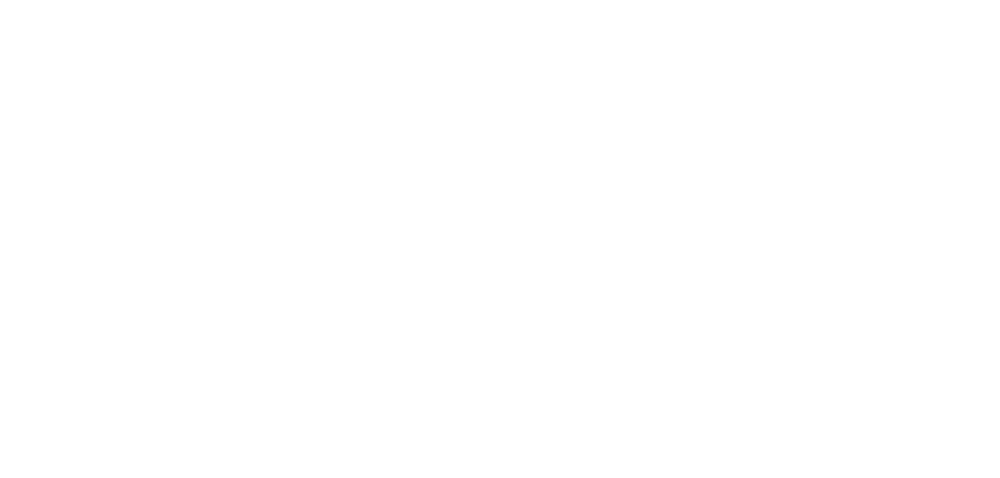

roi176_dff.png


<IPython.core.display.Javascript object>


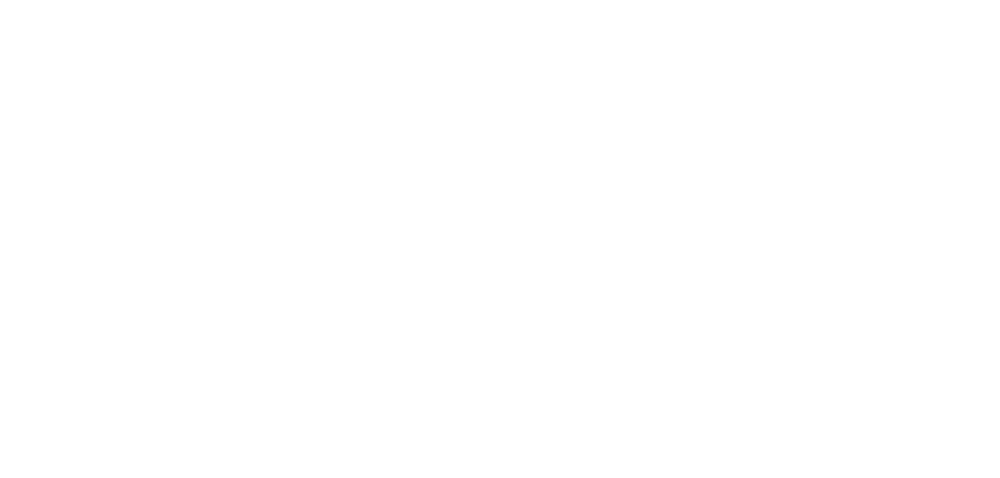

roi177_dff.png


<IPython.core.display.Javascript object>


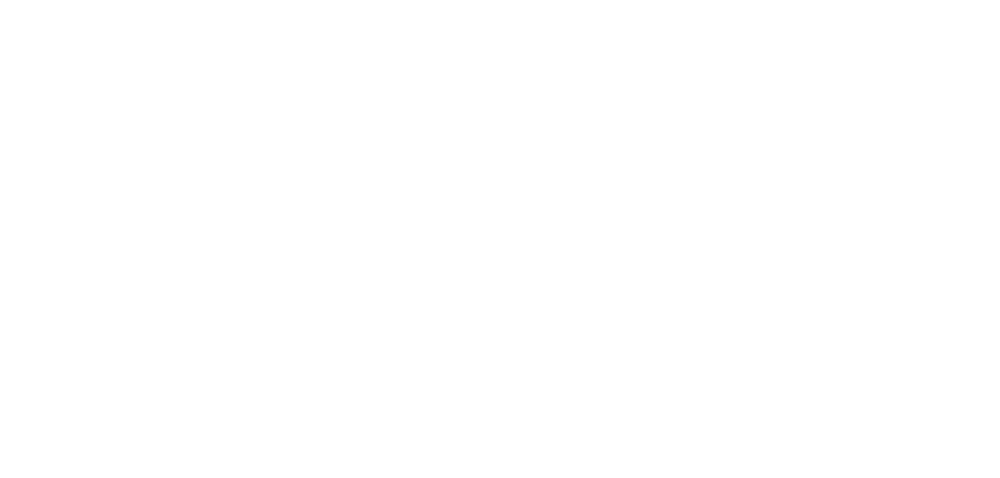

roi178_dff.png


<IPython.core.display.Javascript object>


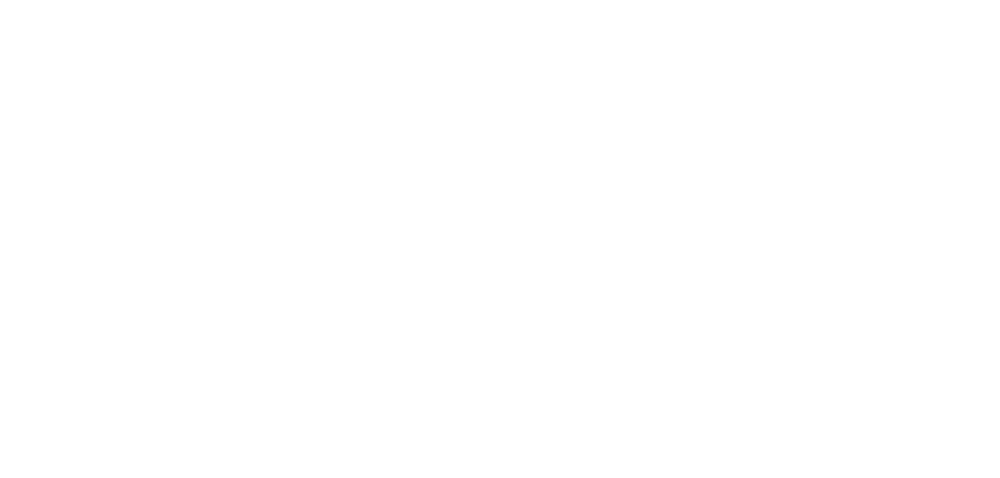

roi179_dff.png


<IPython.core.display.Javascript object>


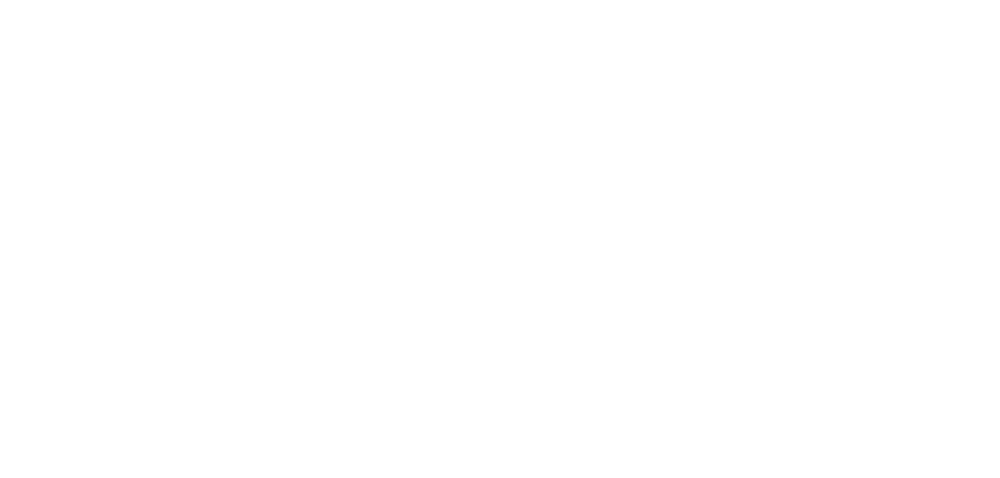

roi180_dff.png


<IPython.core.display.Javascript object>


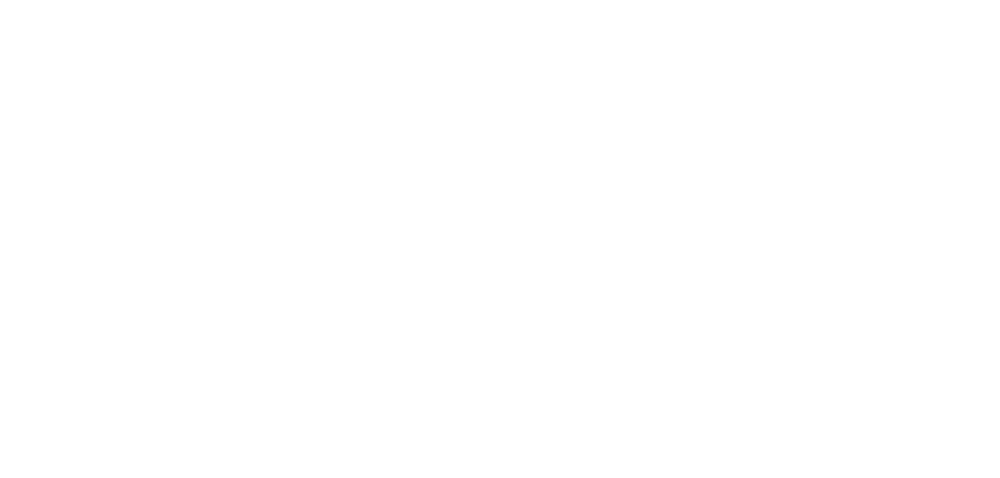

roi181_dff.png


<IPython.core.display.Javascript object>


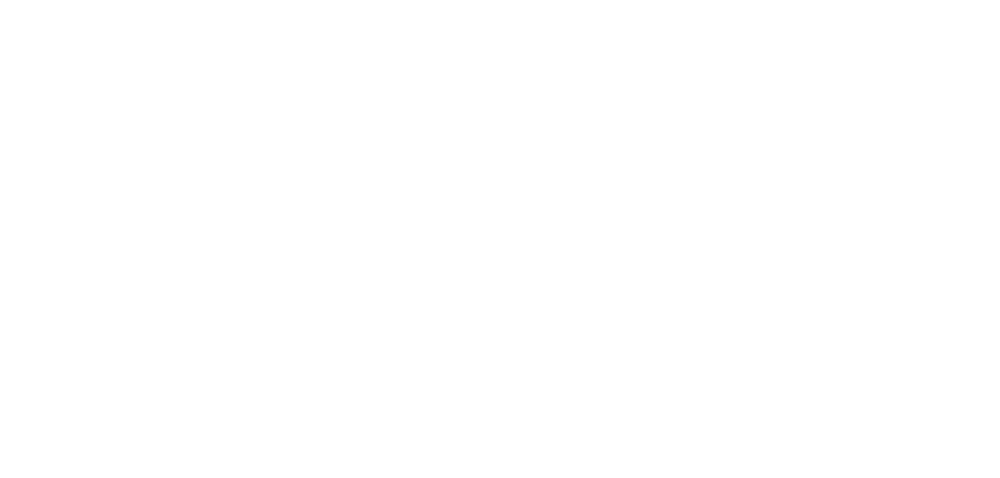

roi182_dff.png


<IPython.core.display.Javascript object>


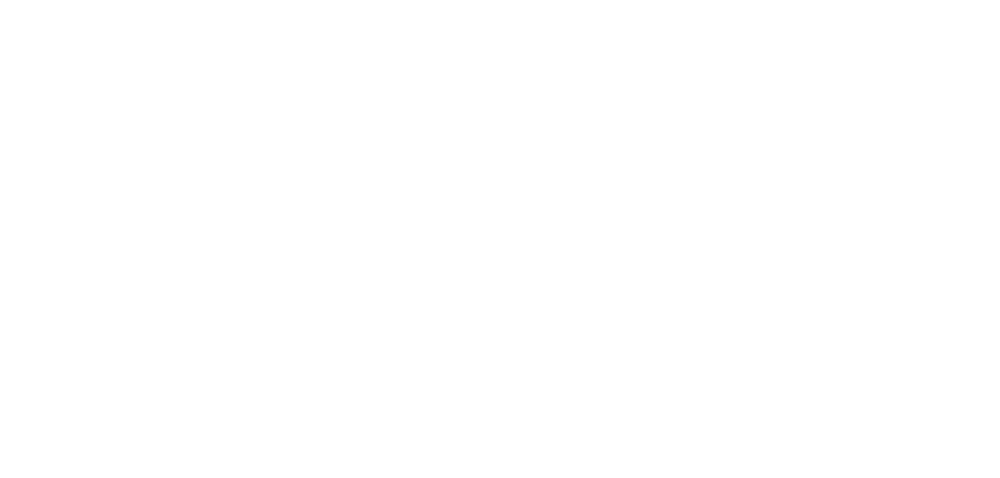

roi183_dff.png


<IPython.core.display.Javascript object>


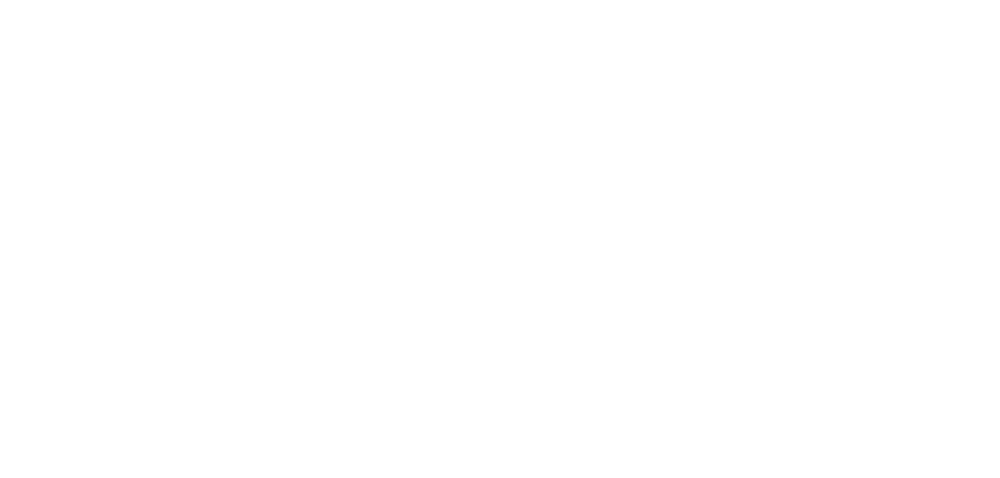

roi184_dff.png


<IPython.core.display.Javascript object>


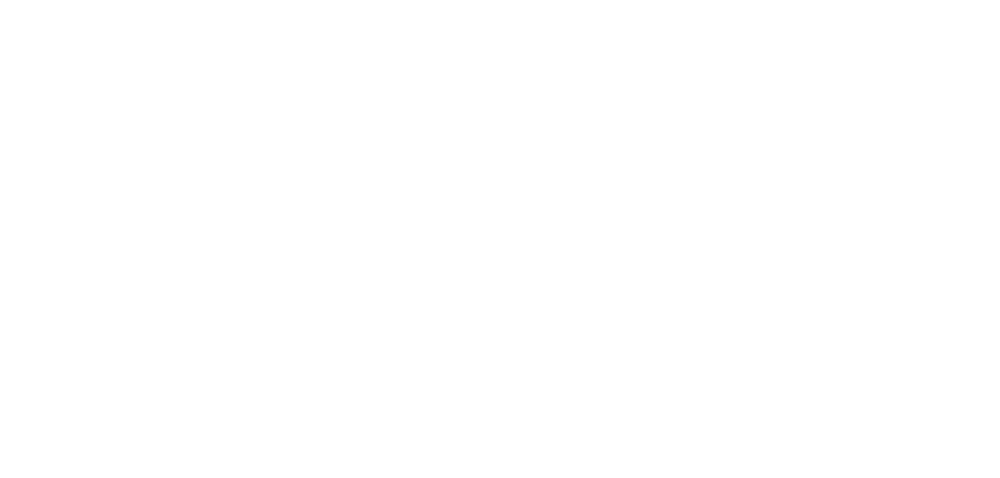

roi185_dff.png


<IPython.core.display.Javascript object>


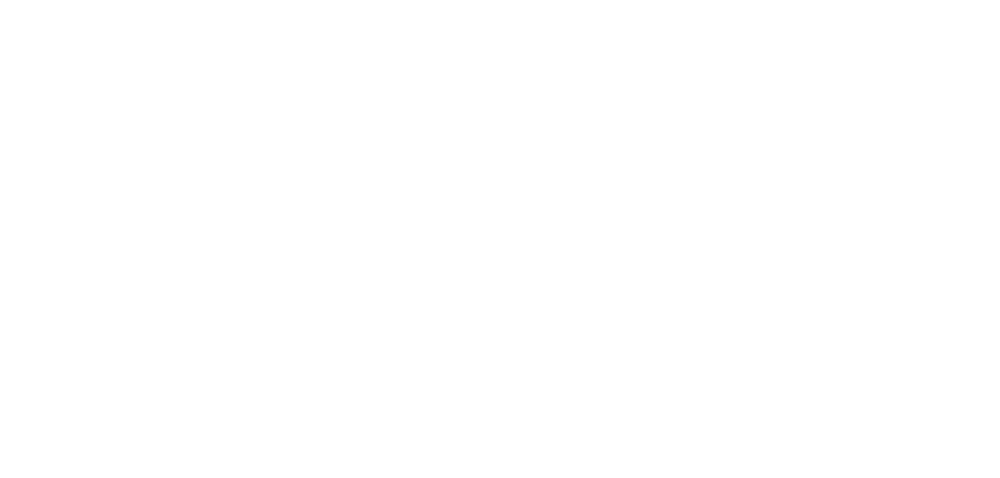

roi186_dff.png


<IPython.core.display.Javascript object>


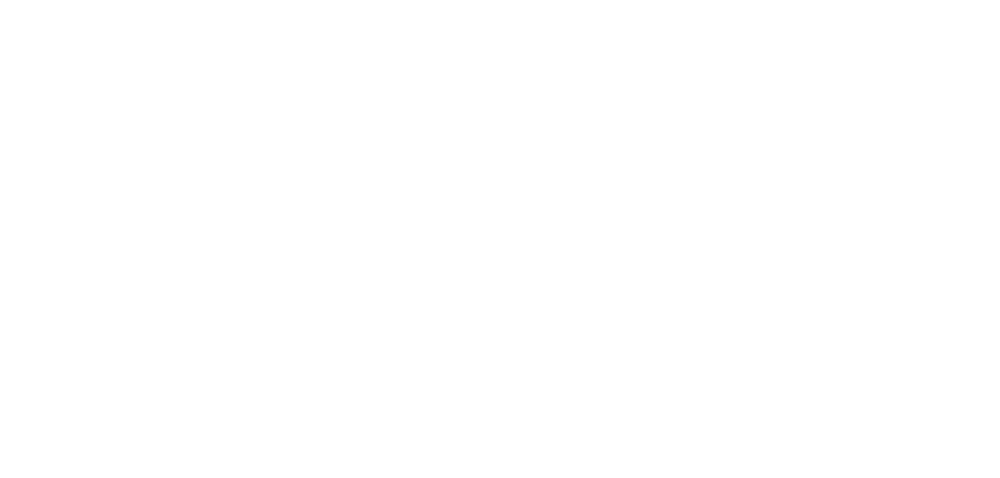

roi187_dff.png


<IPython.core.display.Javascript object>


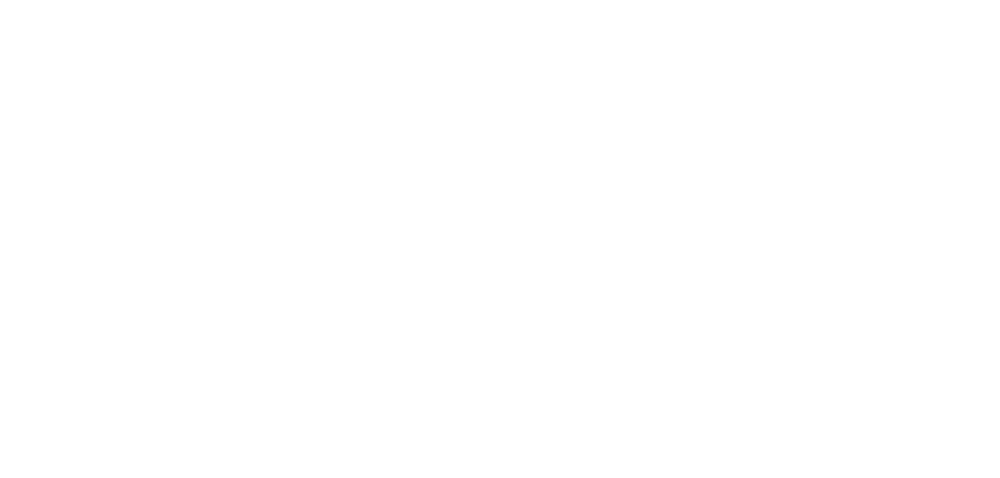

roi188_dff.png


<IPython.core.display.Javascript object>


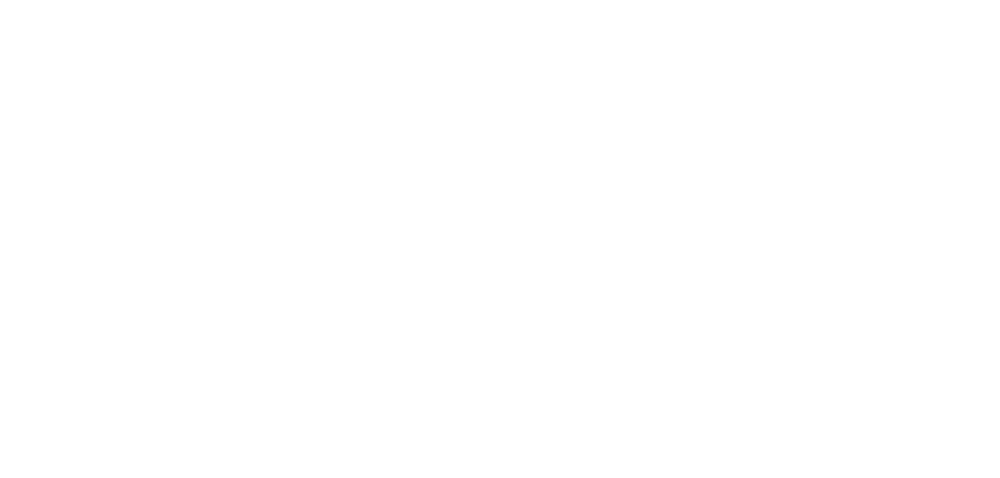

roi189_dff.png


<IPython.core.display.Javascript object>


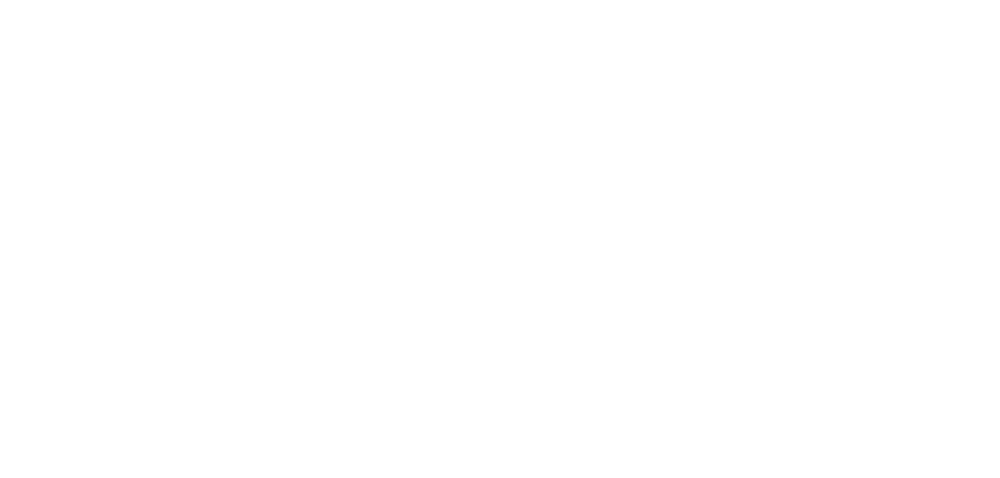

roi190_dff.png


<IPython.core.display.Javascript object>


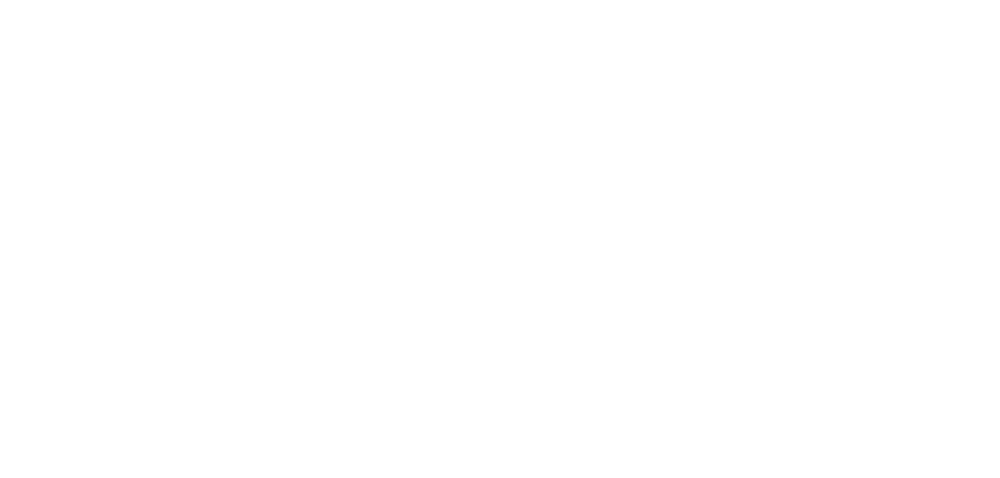

roi191_dff.png


<IPython.core.display.Javascript object>


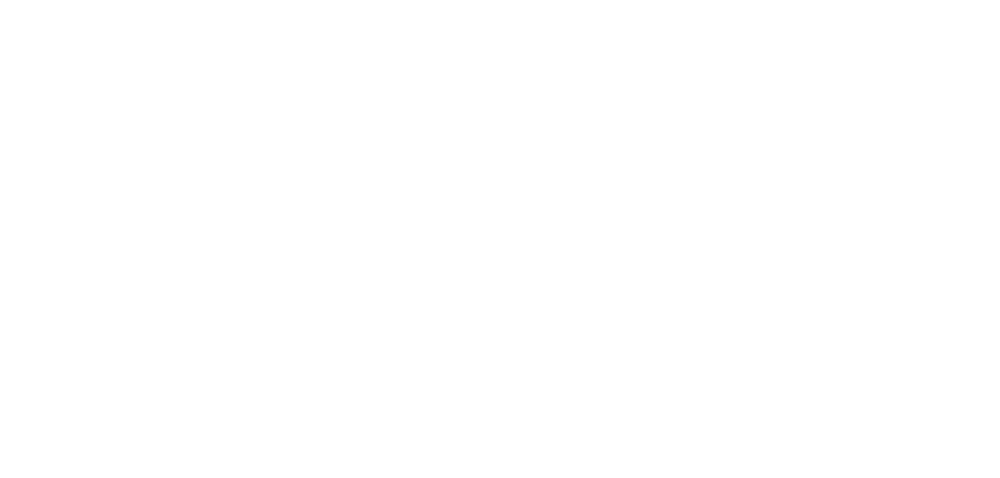

roi192_dff.png


<IPython.core.display.Javascript object>


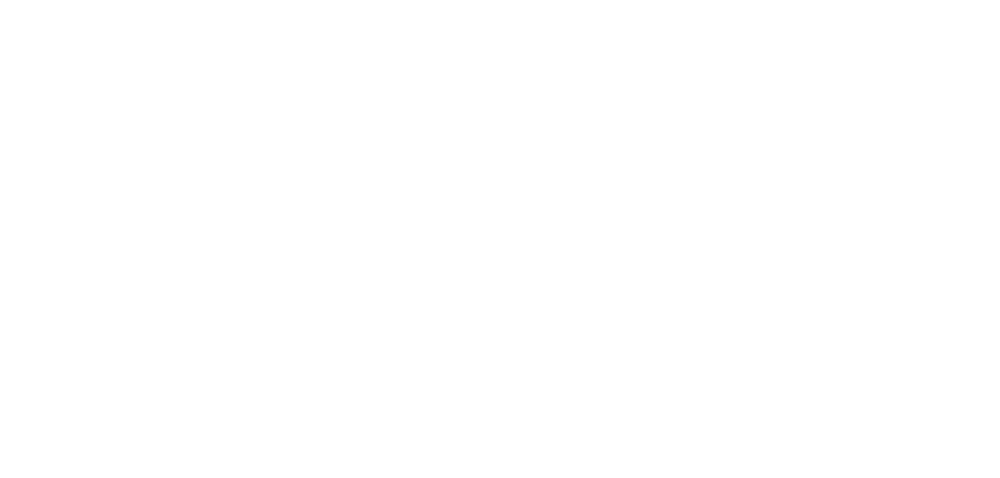

roi193_dff.png


<IPython.core.display.Javascript object>


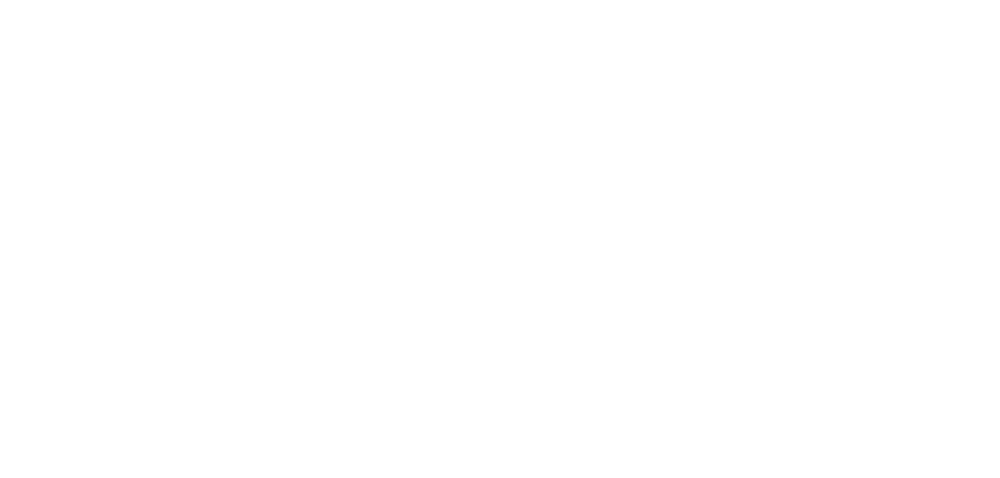

roi194_dff.png


<IPython.core.display.Javascript object>


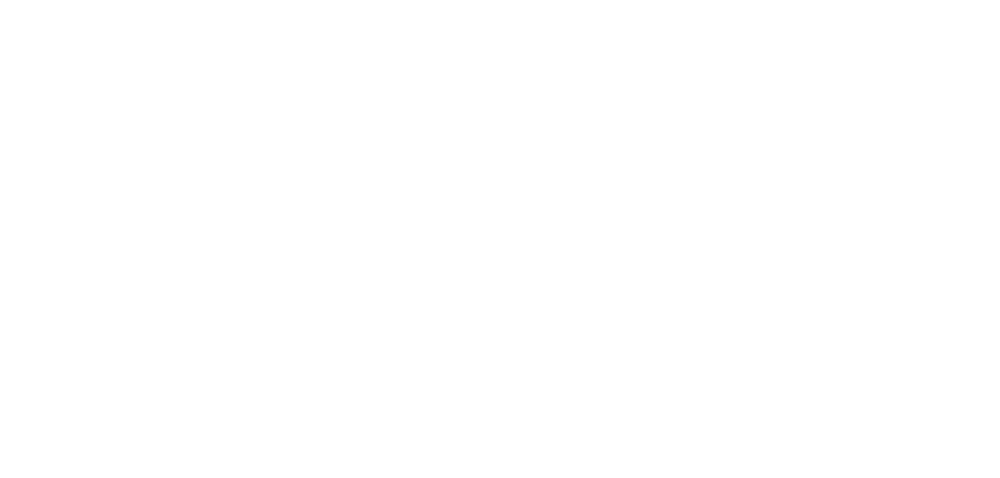

roi195_dff.png


<IPython.core.display.Javascript object>


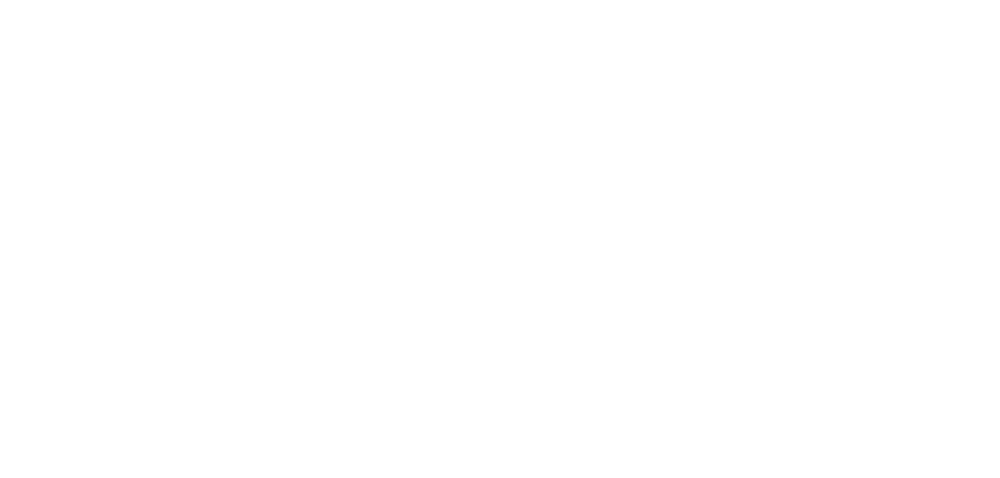

roi196_dff.png


<IPython.core.display.Javascript object>


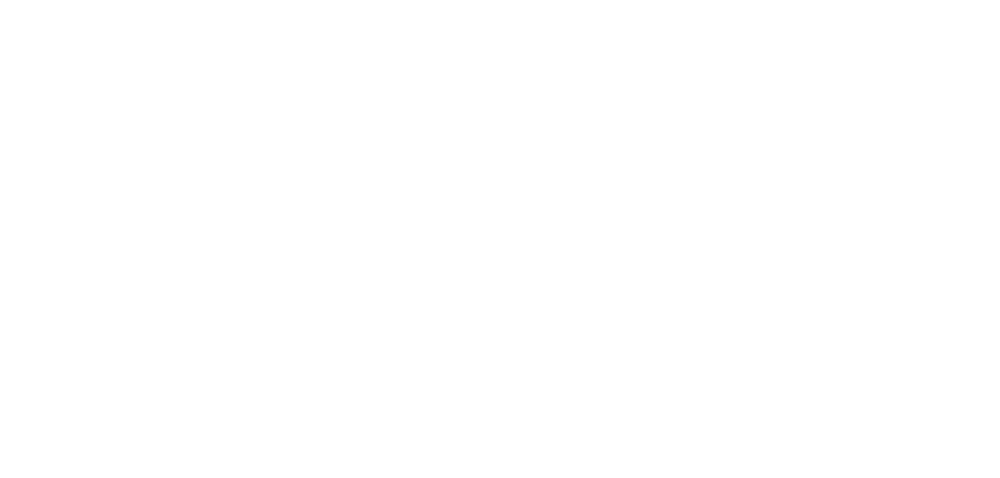

roi197_dff.png


<IPython.core.display.Javascript object>


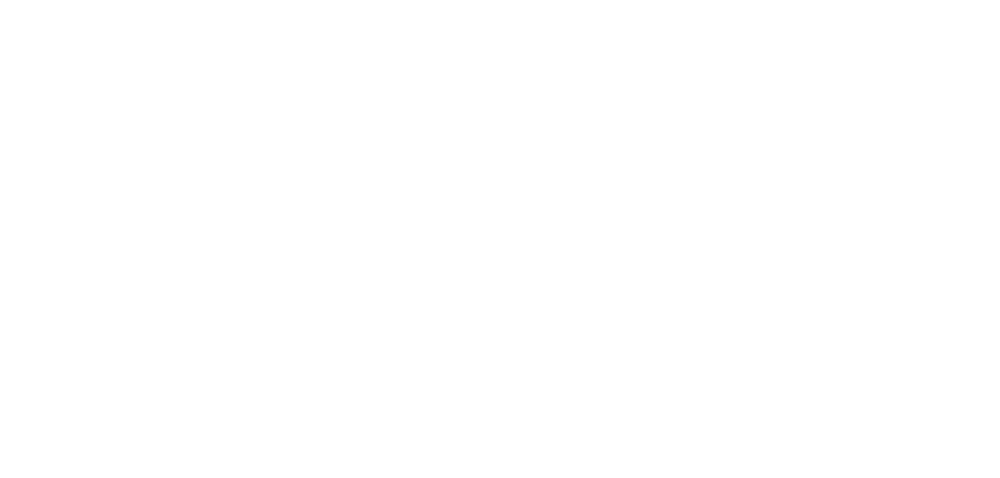

roi198_dff.png


<IPython.core.display.Javascript object>


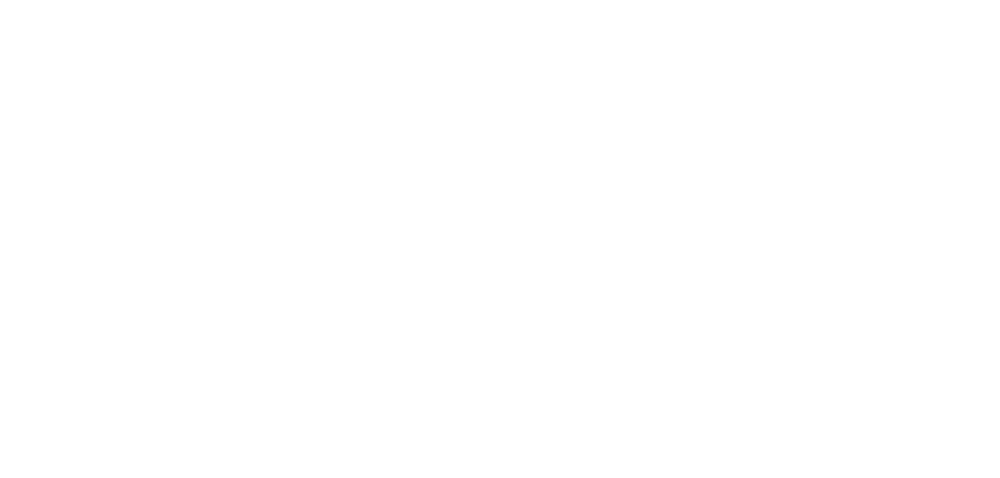

roi199_dff.png


<IPython.core.display.Javascript object>


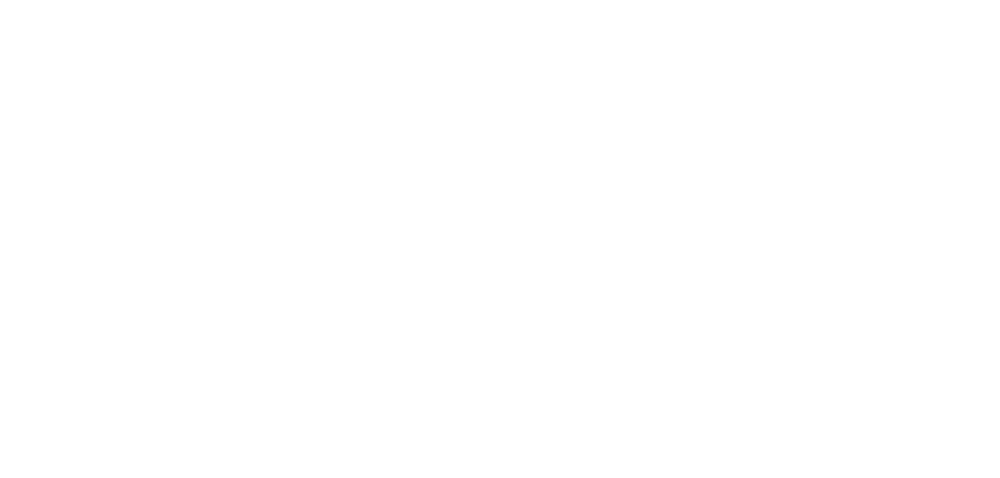

roi200_dff.png


<IPython.core.display.Javascript object>


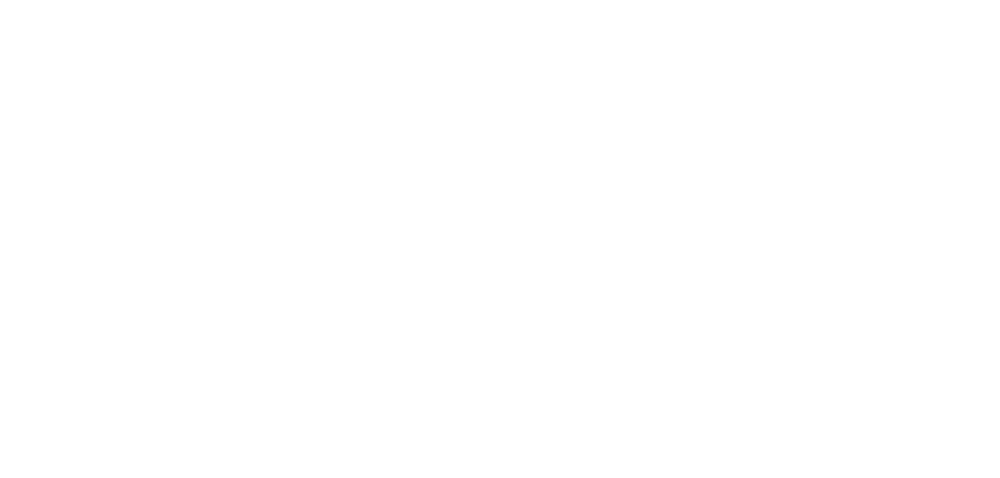

roi201_dff.png


<IPython.core.display.Javascript object>


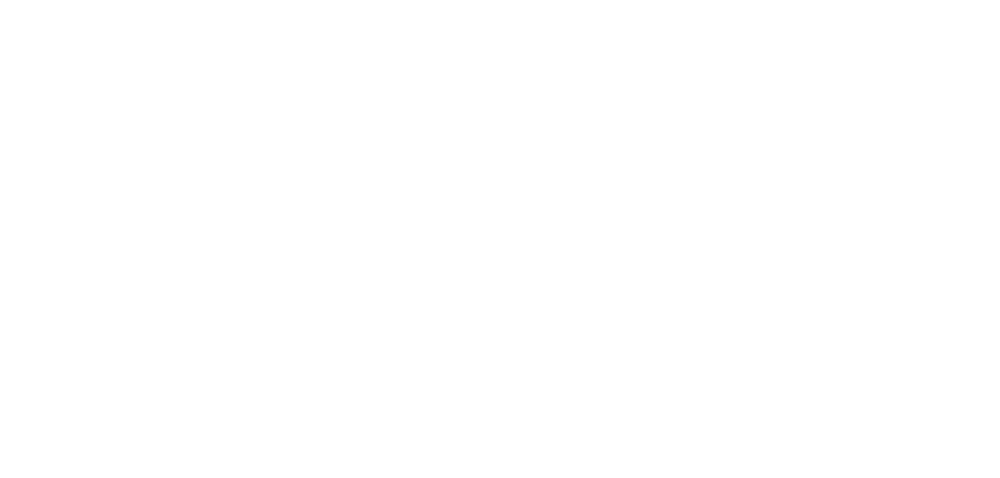

roi202_dff.png


<IPython.core.display.Javascript object>


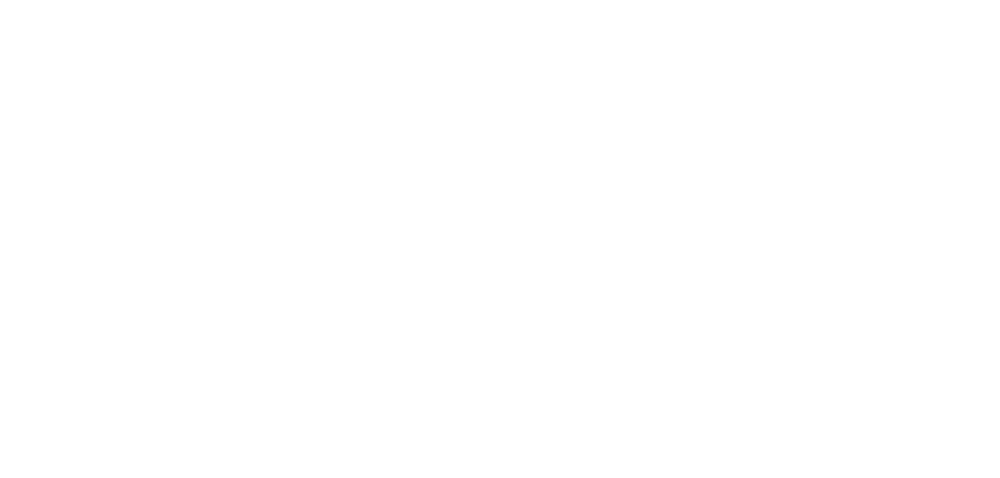

roi203_dff.png


<IPython.core.display.Javascript object>


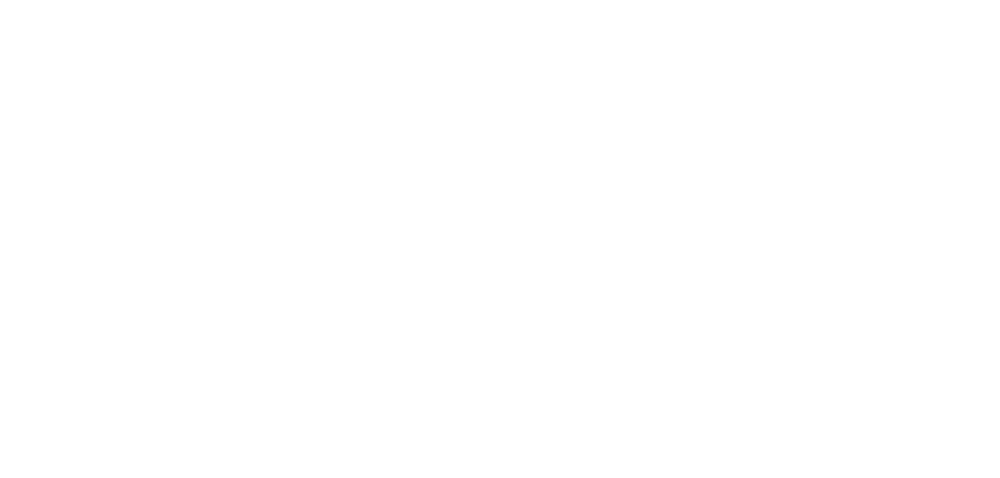

roi204_dff.png


<IPython.core.display.Javascript object>


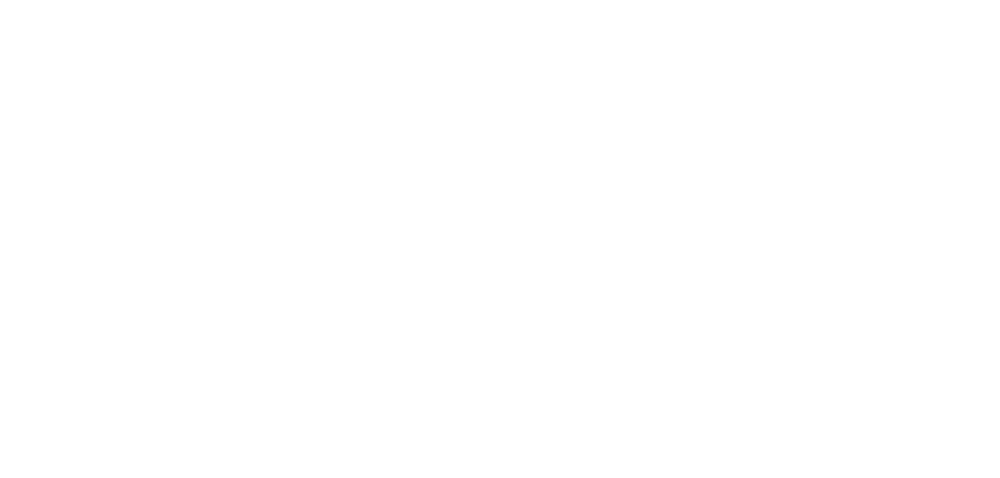

roi205_dff.png


<IPython.core.display.Javascript object>


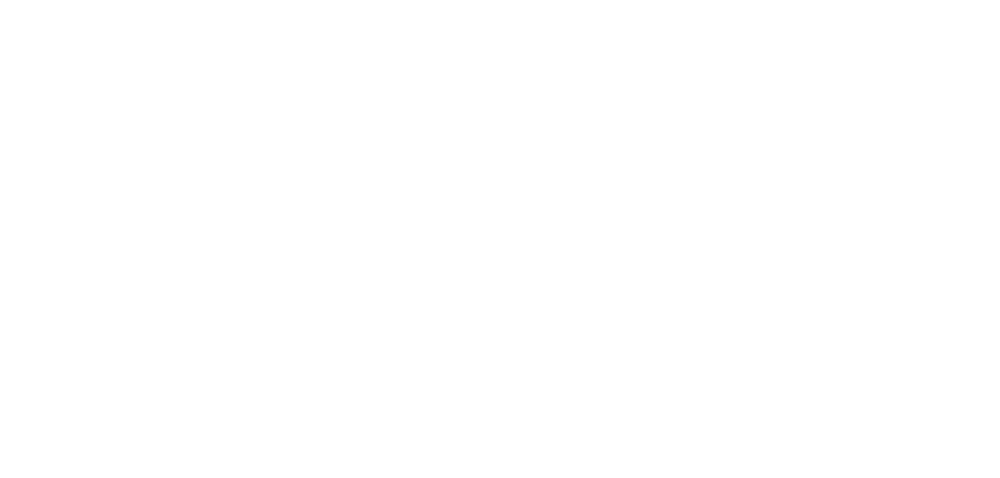

roi206_dff.png


<IPython.core.display.Javascript object>


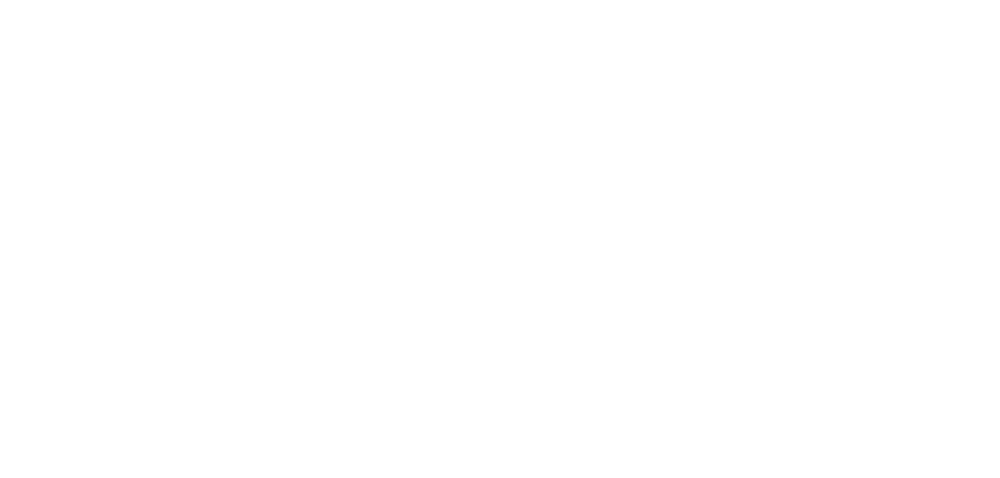

roi207_dff.png


<IPython.core.display.Javascript object>


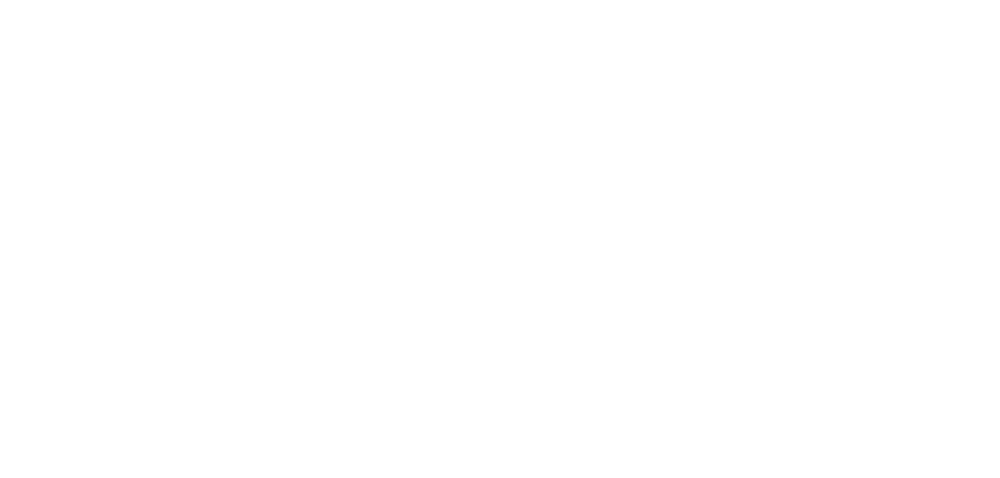

roi208_dff.png


<IPython.core.display.Javascript object>


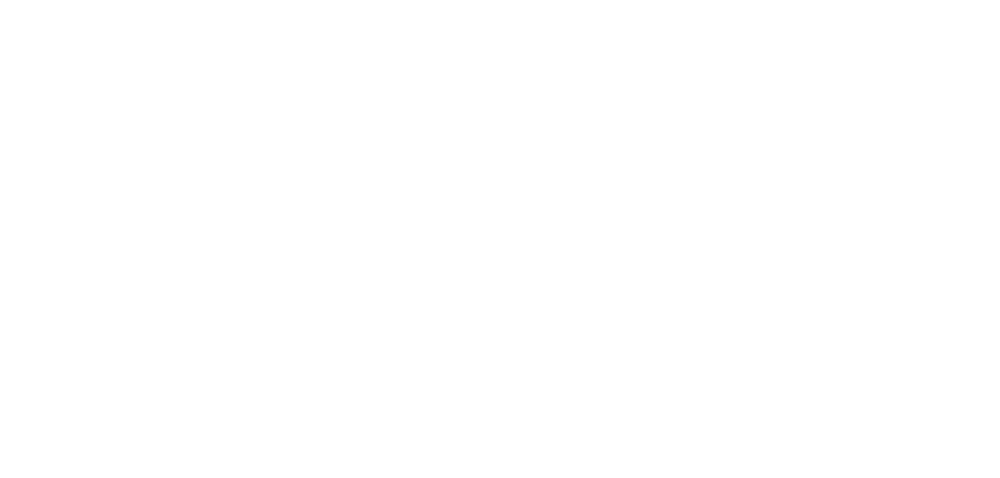

roi209_dff.png


<IPython.core.display.Javascript object>


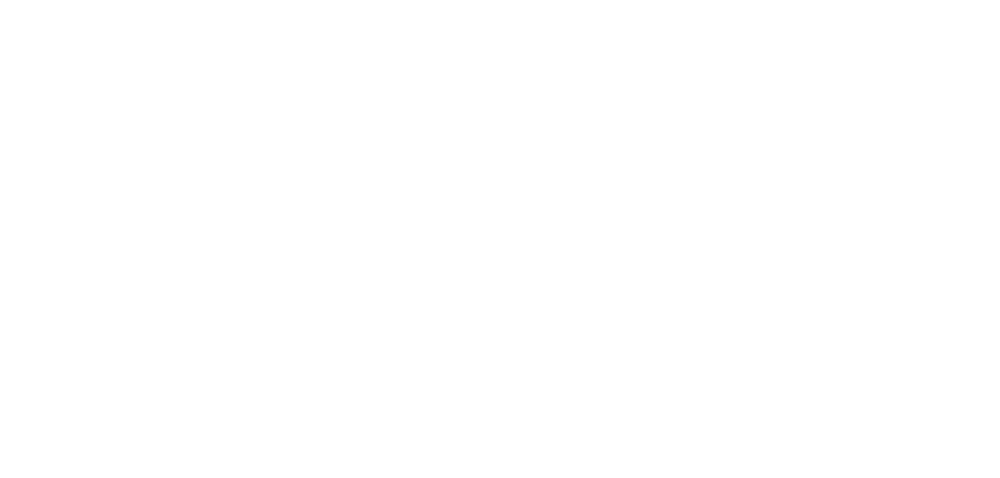

roi210_dff.png


<IPython.core.display.Javascript object>


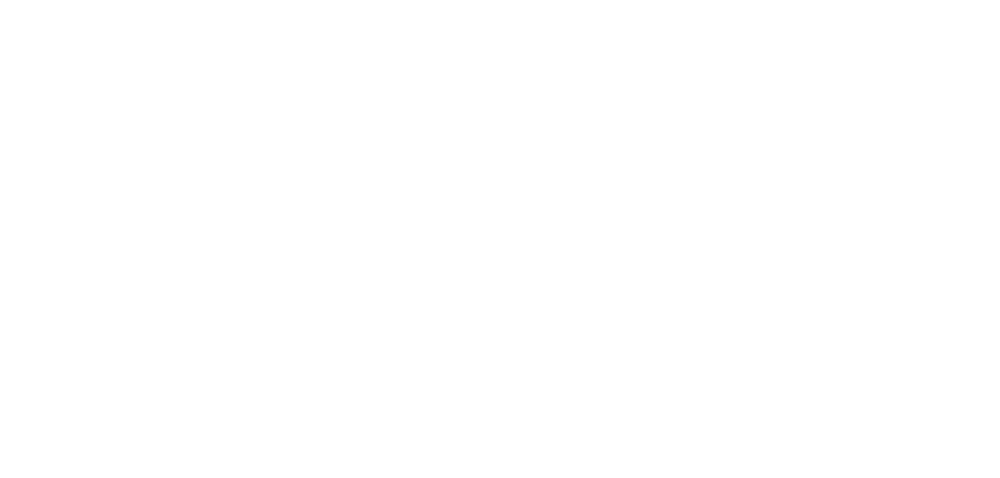

roi211_dff.png


<IPython.core.display.Javascript object>


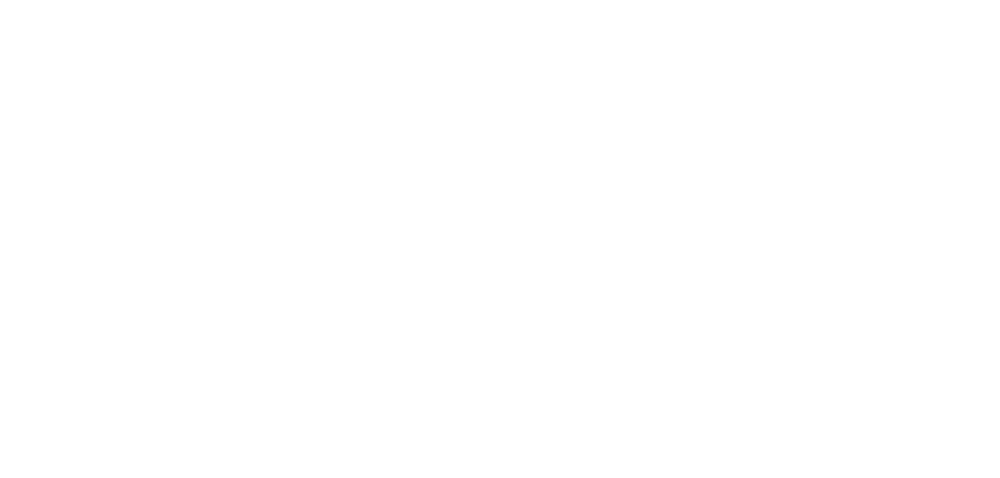

roi212_dff.png


<IPython.core.display.Javascript object>


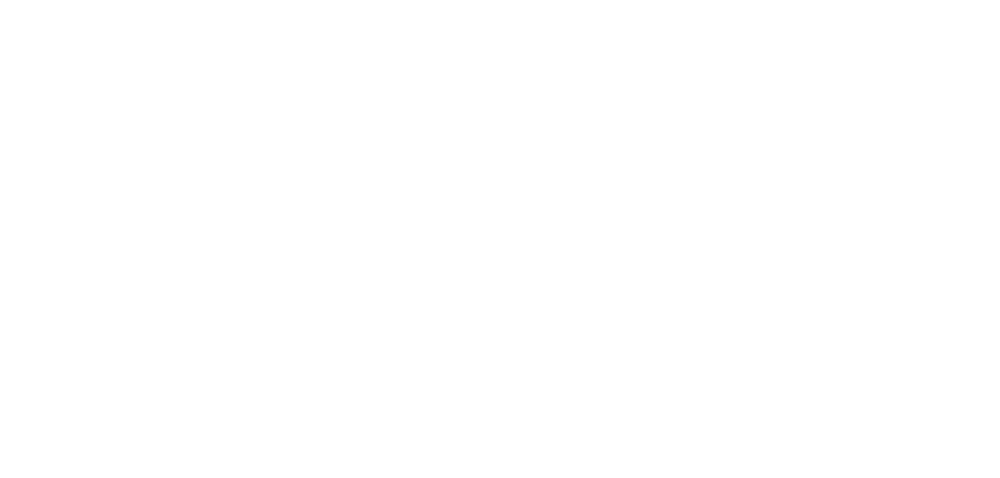

roi213_dff.png


<IPython.core.display.Javascript object>


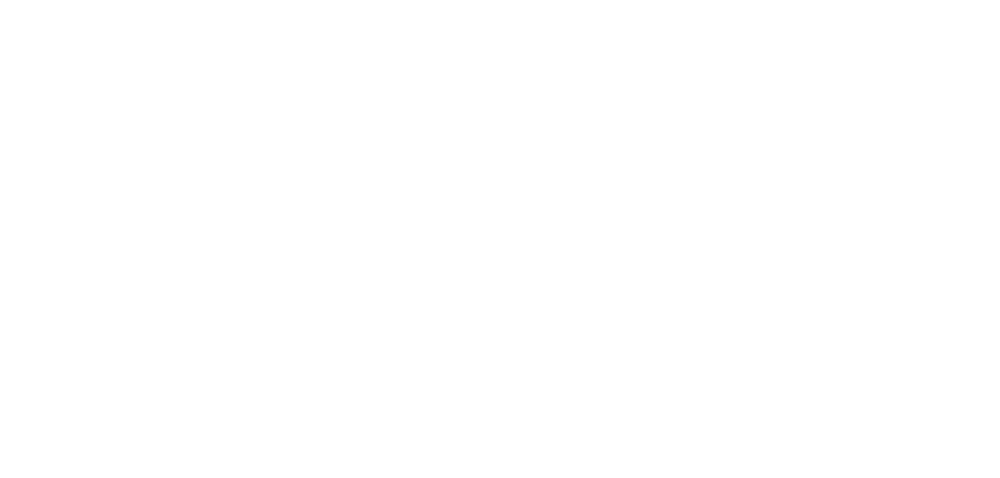

roi214_dff.png


<IPython.core.display.Javascript object>


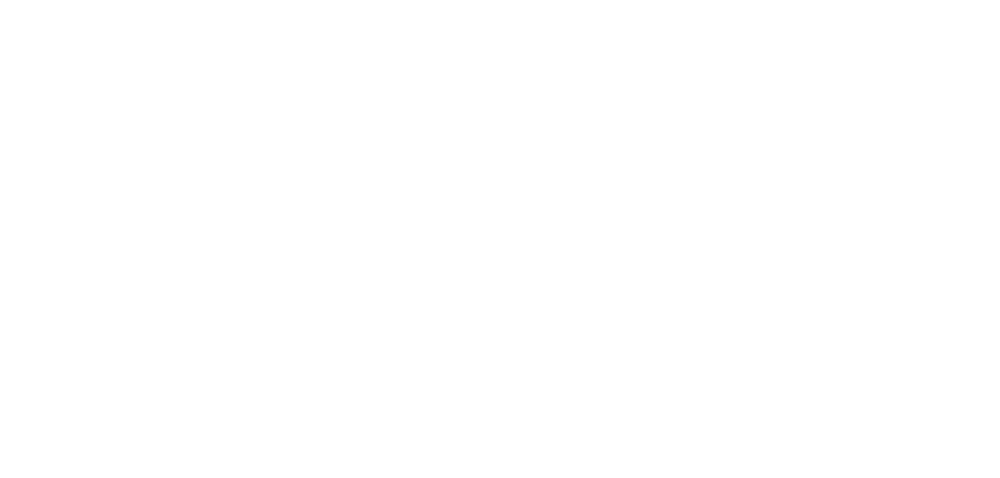

roi215_dff.png


<IPython.core.display.Javascript object>


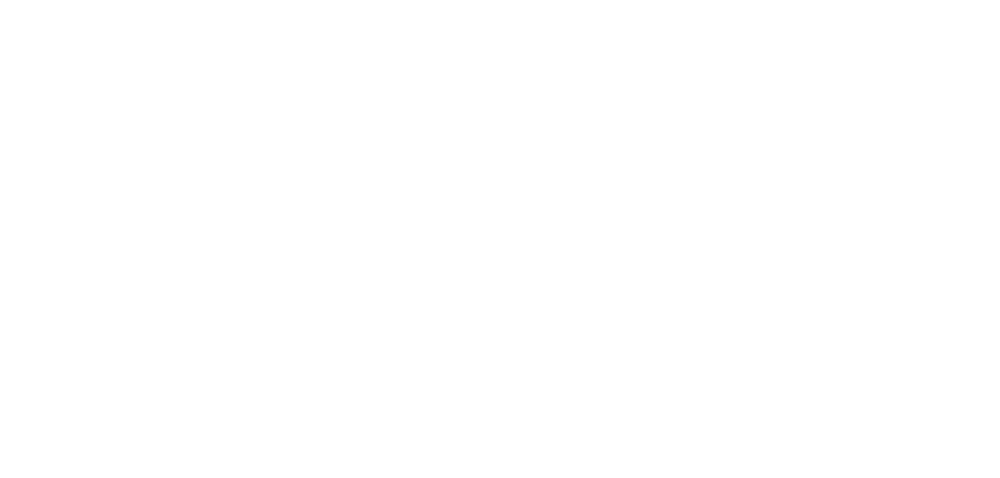

roi216_dff.png


<IPython.core.display.Javascript object>


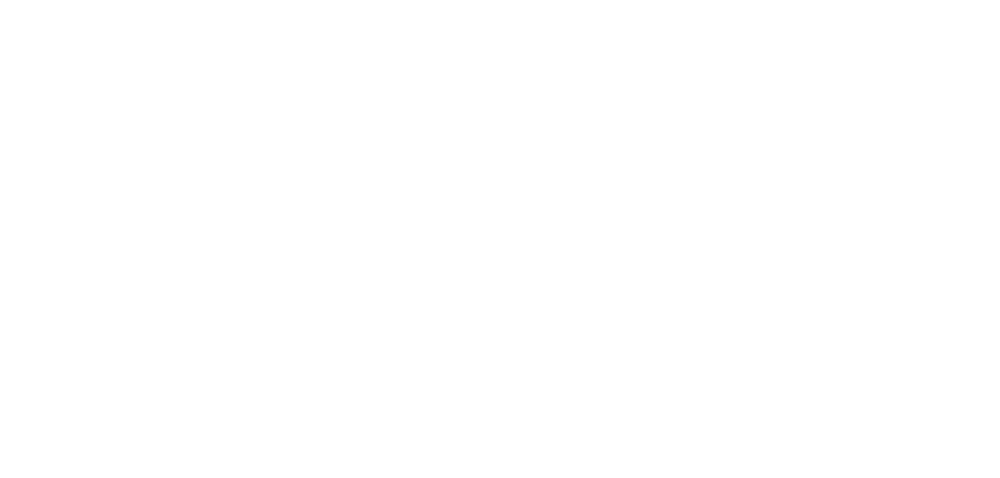

roi217_dff.png


<IPython.core.display.Javascript object>


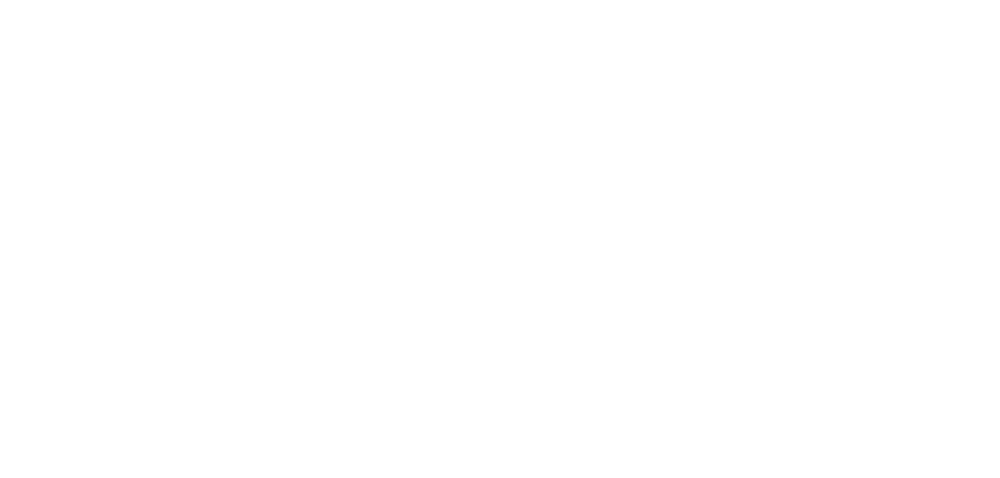

roi218_dff.png


<IPython.core.display.Javascript object>


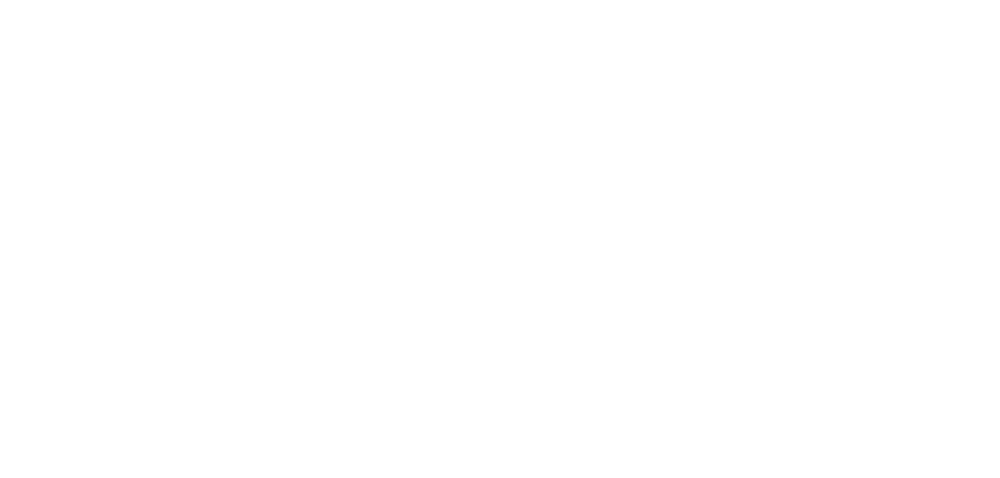

roi219_dff.png


<IPython.core.display.Javascript object>


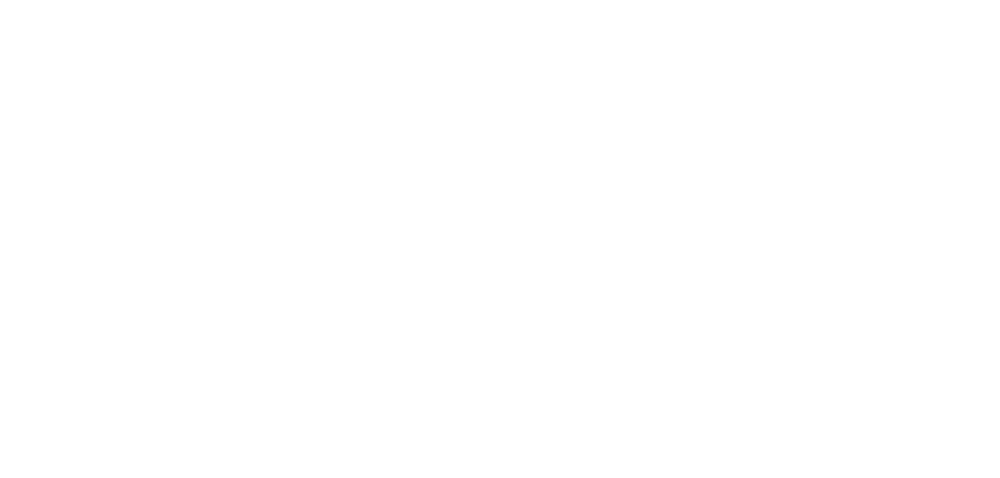

roi220_dff.png


<IPython.core.display.Javascript object>


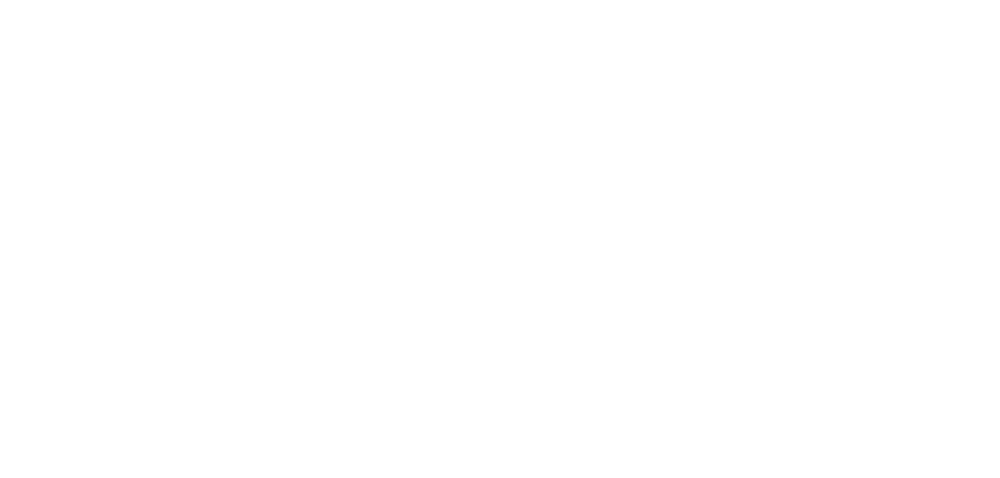

roi221_dff.png


<IPython.core.display.Javascript object>


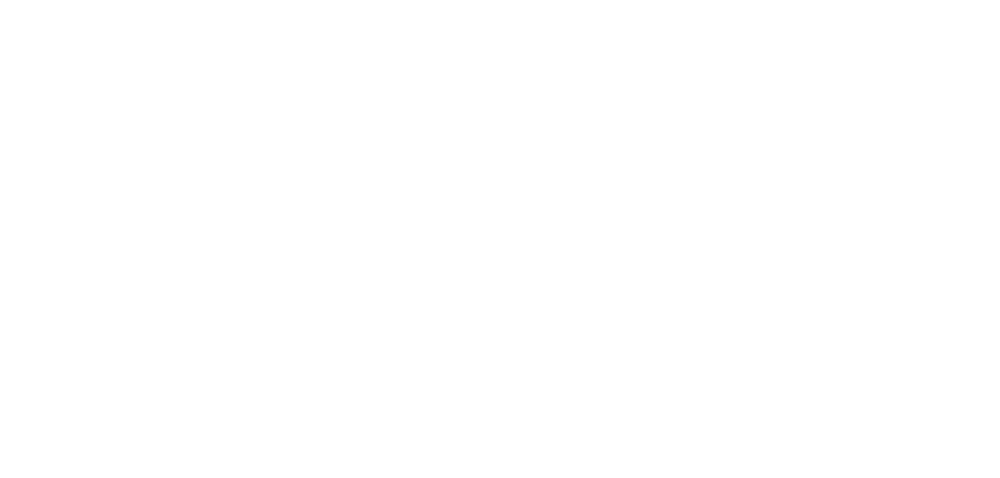

roi222_dff.png


<IPython.core.display.Javascript object>


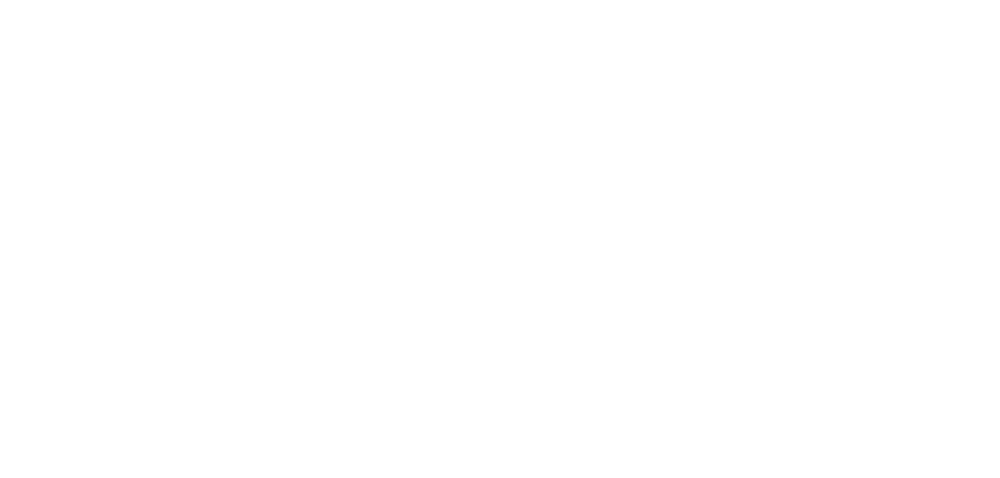

roi223_dff.png


<IPython.core.display.Javascript object>


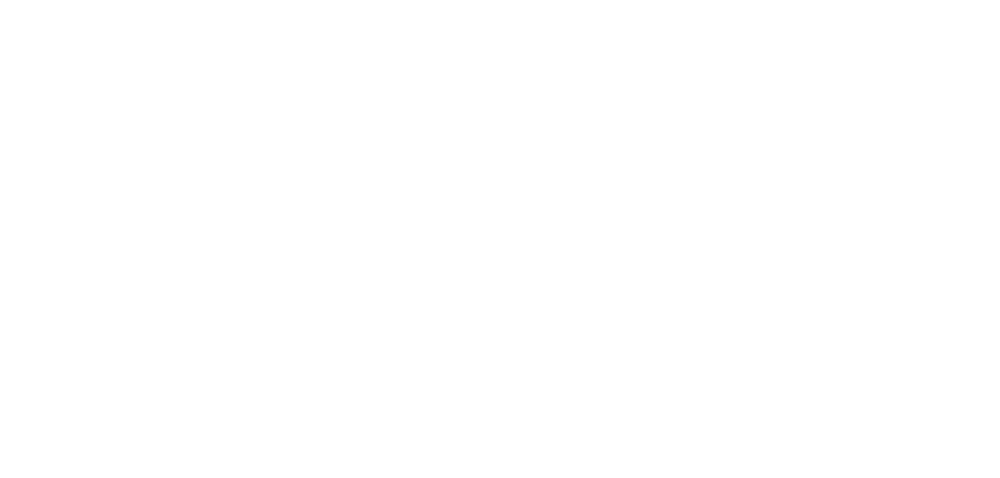

roi224_dff.png


<IPython.core.display.Javascript object>


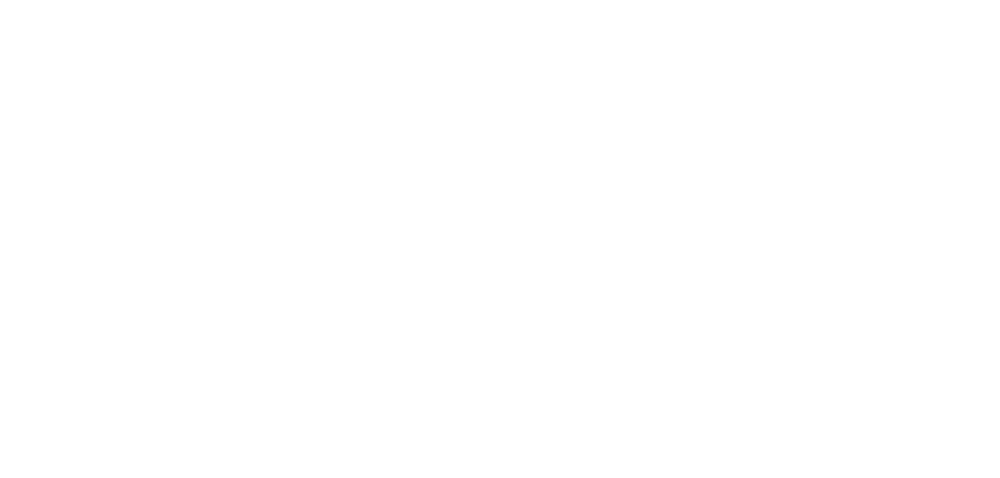

roi225_dff.png


<IPython.core.display.Javascript object>


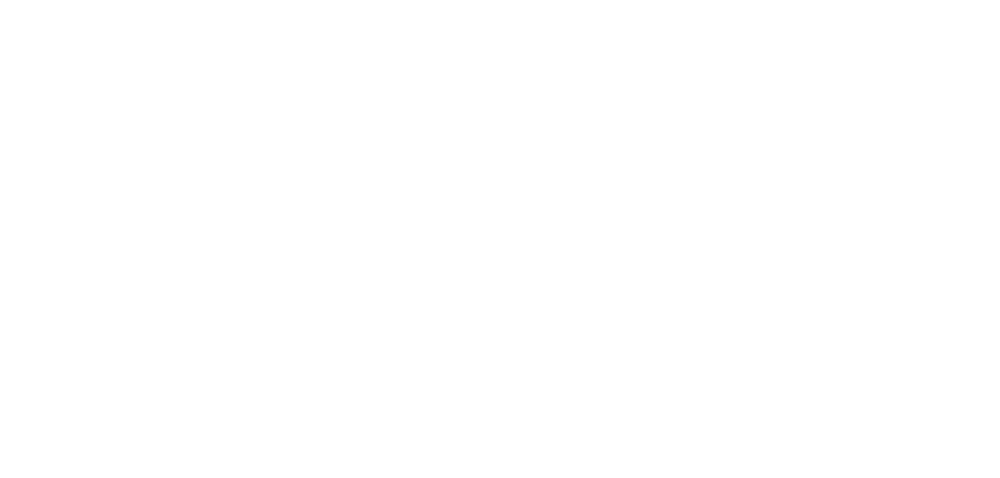

roi226_dff.png


<IPython.core.display.Javascript object>


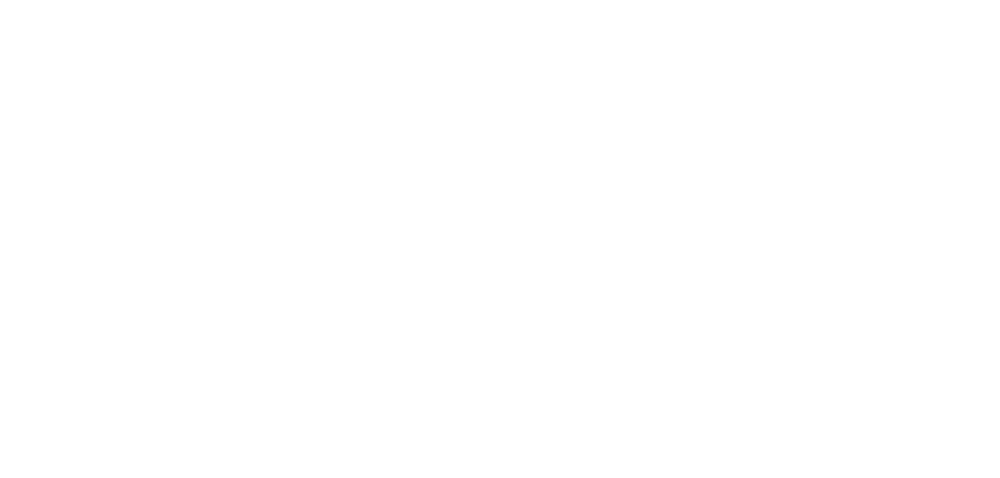

roi227_dff.png


<IPython.core.display.Javascript object>


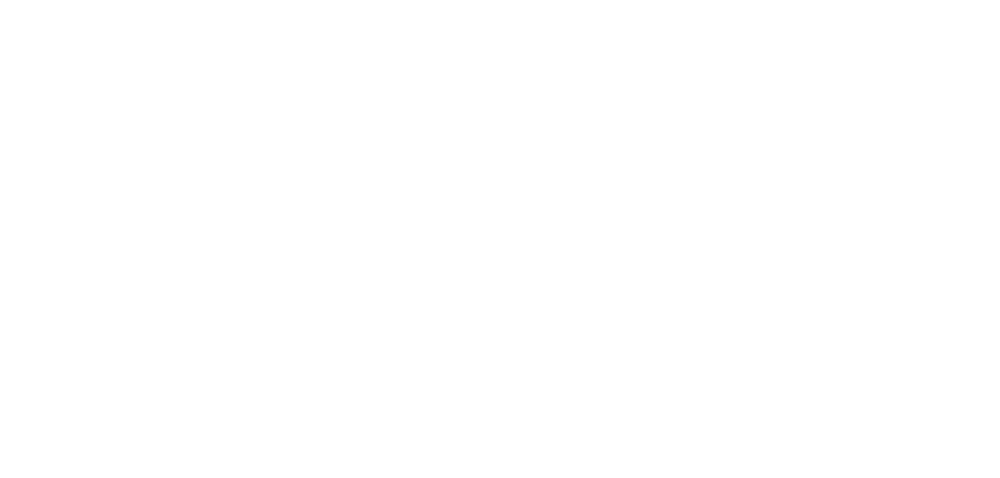

roi228_dff.png


<IPython.core.display.Javascript object>


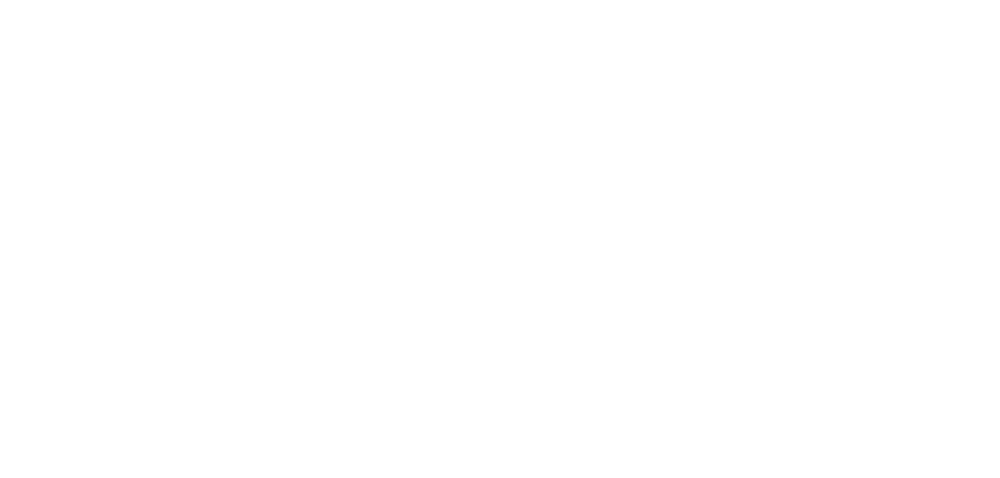

roi229_dff.png


<IPython.core.display.Javascript object>


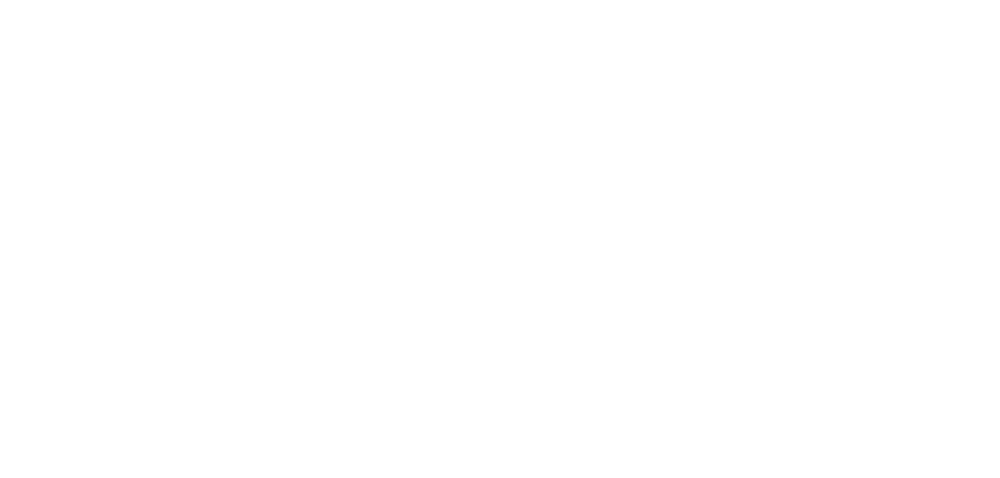

roi230_dff.png


<IPython.core.display.Javascript object>


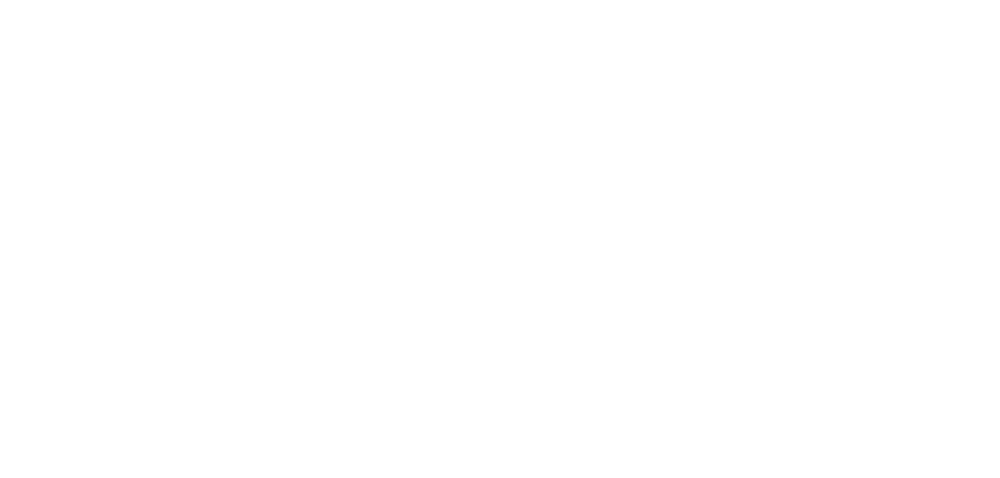

roi231_dff.png


<IPython.core.display.Javascript object>


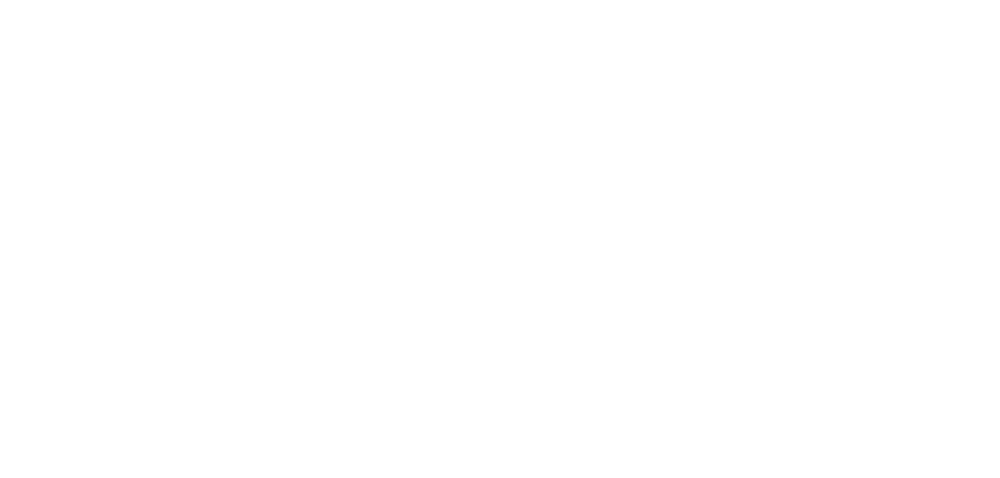

roi232_dff.png


<IPython.core.display.Javascript object>


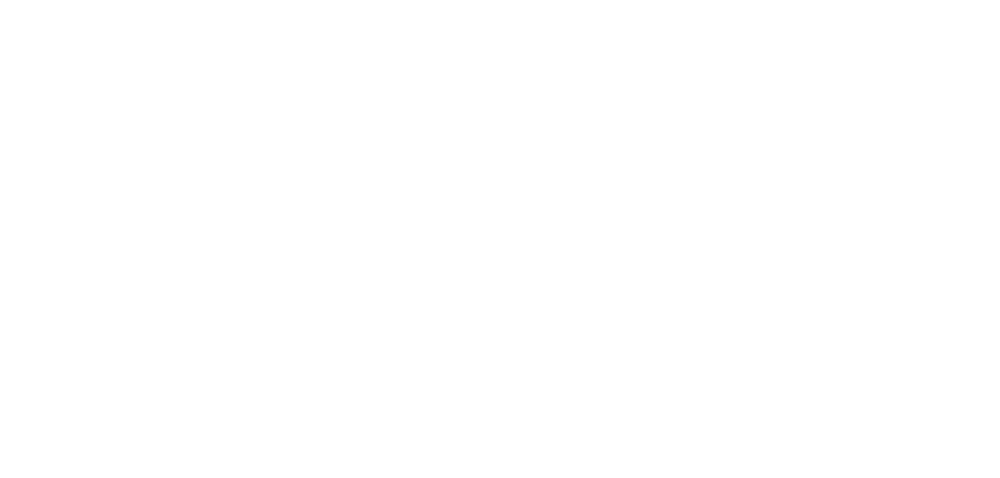

roi233_dff.png


<IPython.core.display.Javascript object>


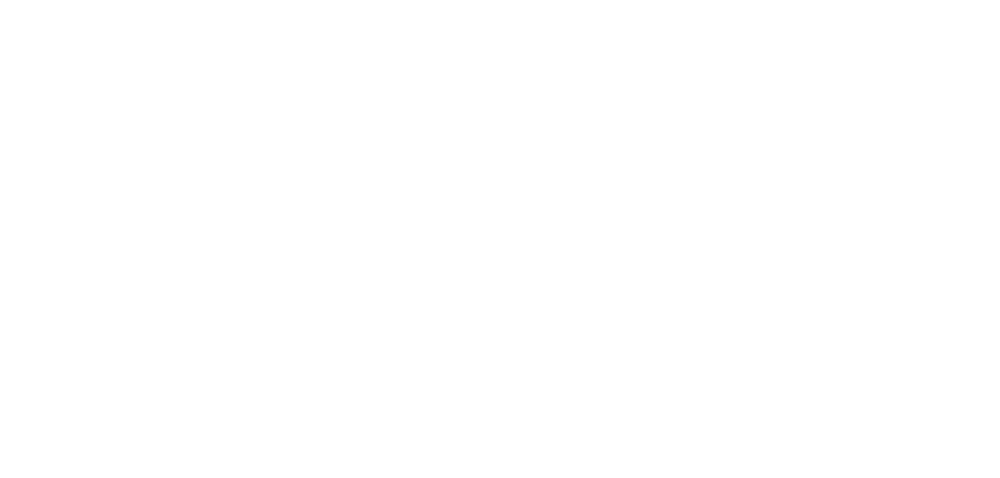

roi234_dff.png


<IPython.core.display.Javascript object>


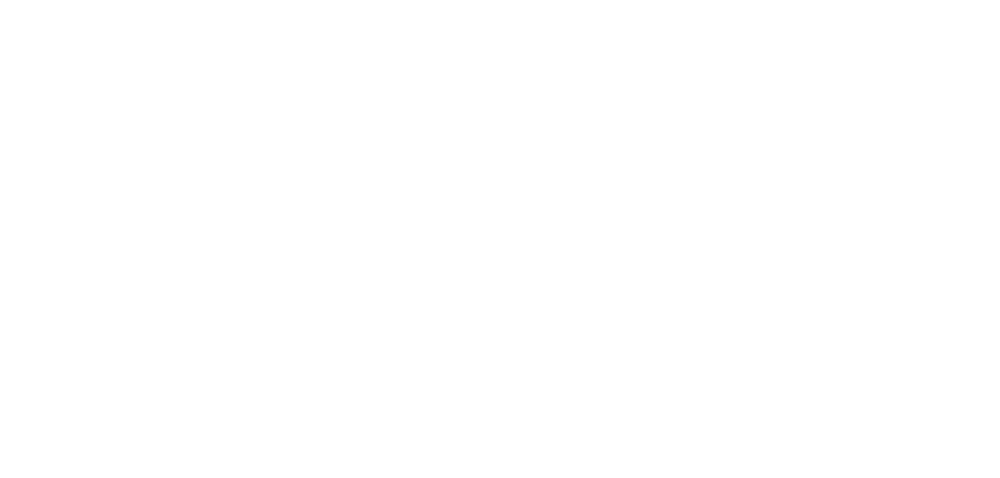

roi235_dff.png


<IPython.core.display.Javascript object>


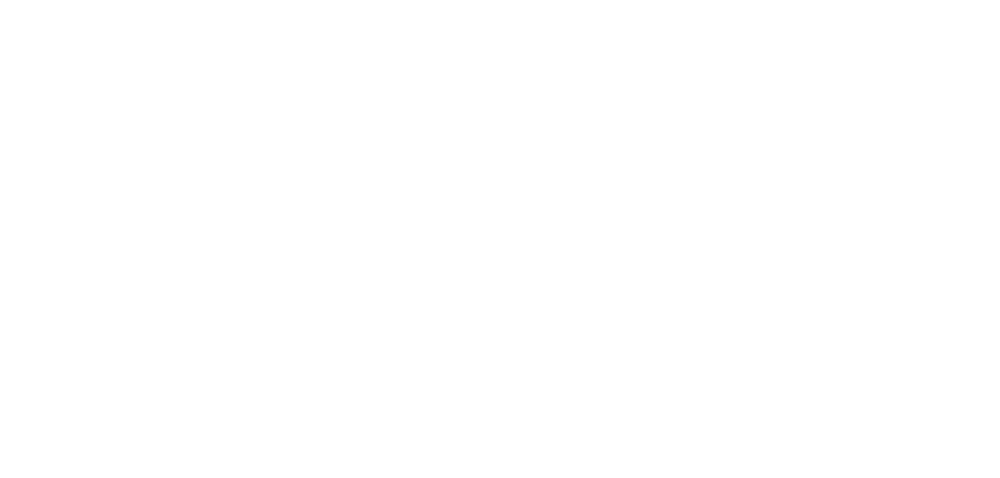

roi236_dff.png


<IPython.core.display.Javascript object>


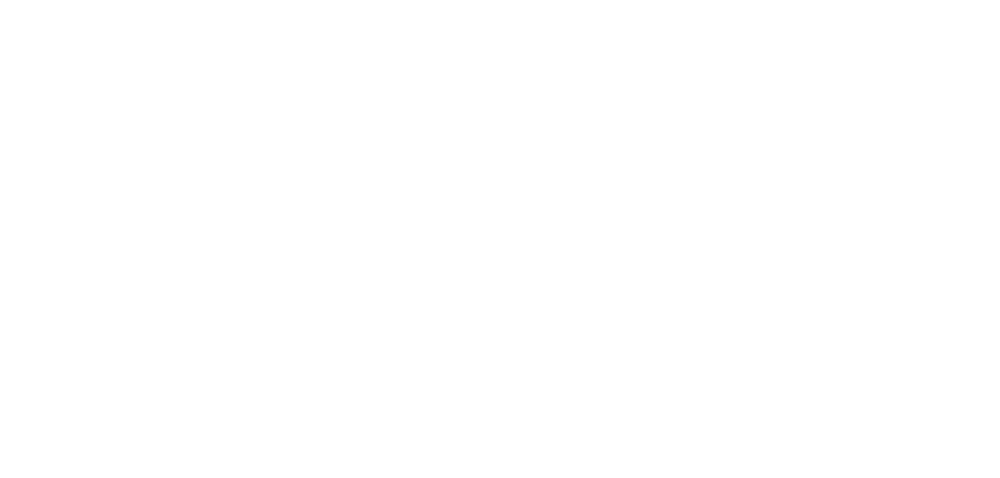

roi237_dff.png


<IPython.core.display.Javascript object>


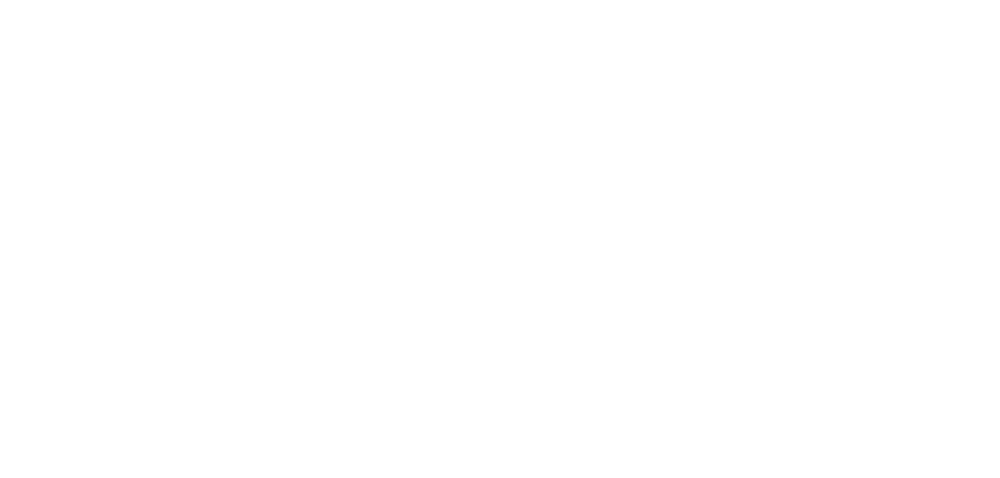

roi238_dff.png


<IPython.core.display.Javascript object>


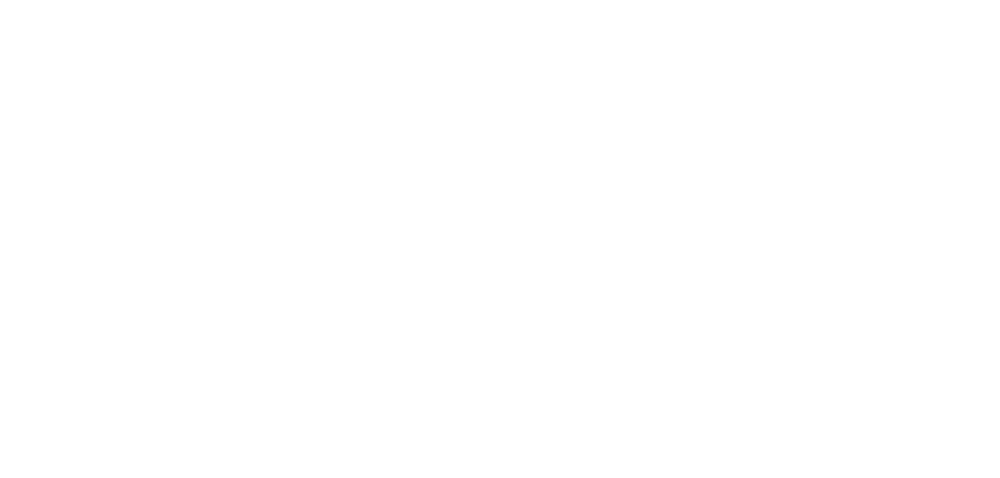

roi239_dff.png


<IPython.core.display.Javascript object>


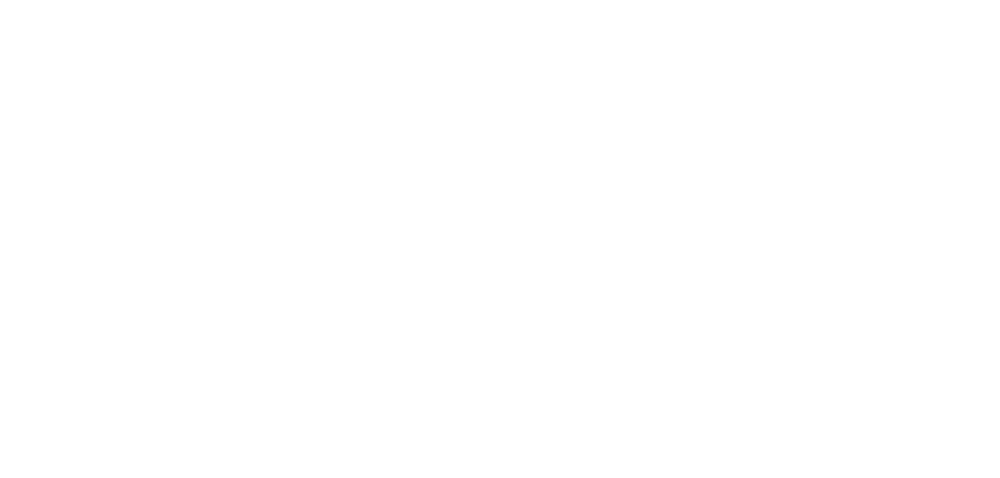

roi240_dff.png


<IPython.core.display.Javascript object>


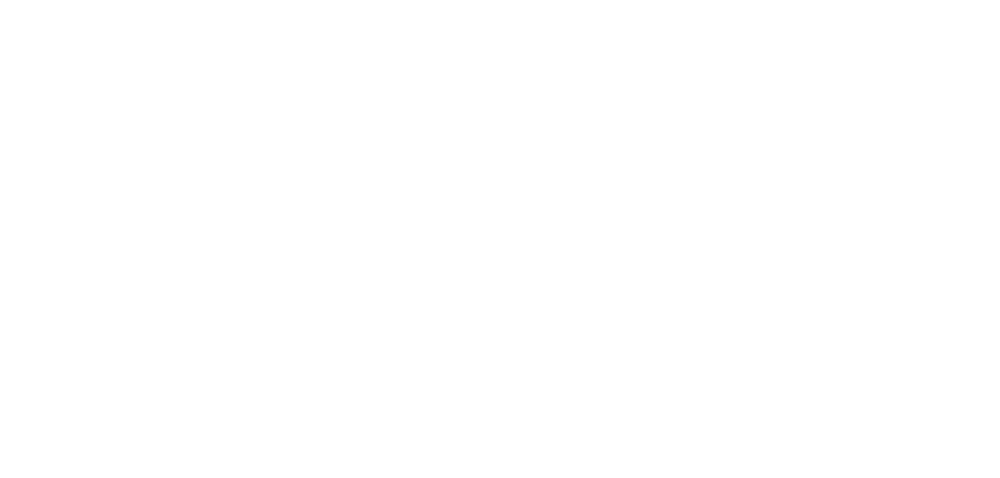

roi241_dff.png


<IPython.core.display.Javascript object>


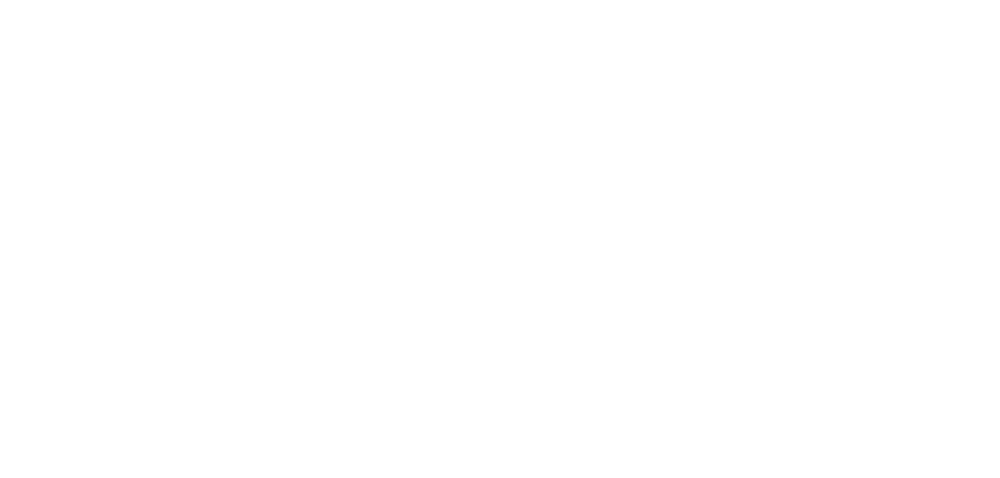

roi242_dff.png


<IPython.core.display.Javascript object>


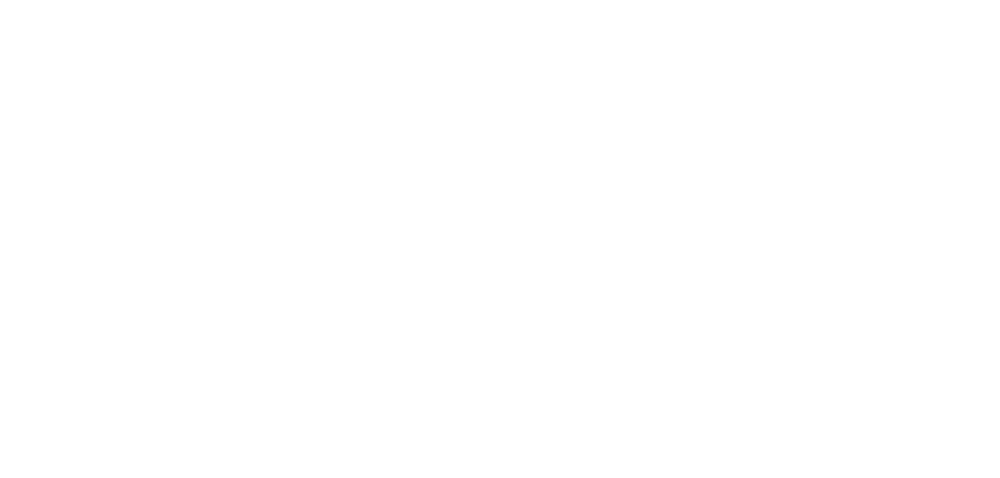

roi243_dff.png


<IPython.core.display.Javascript object>


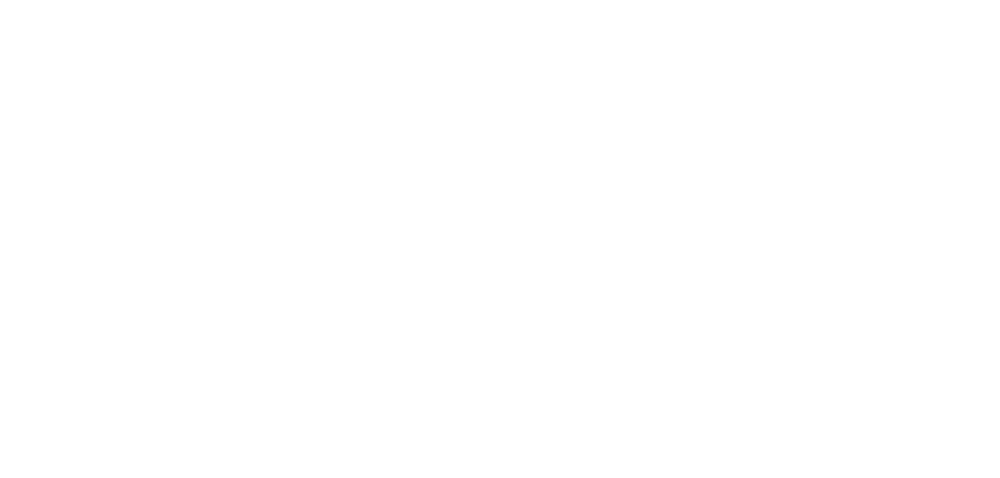

roi244_dff.png


<IPython.core.display.Javascript object>


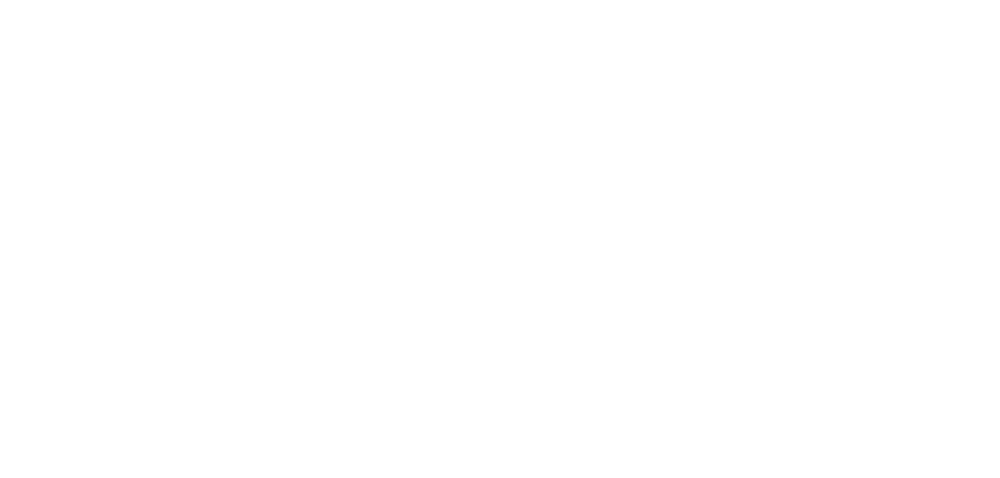

roi245_dff.png


<IPython.core.display.Javascript object>


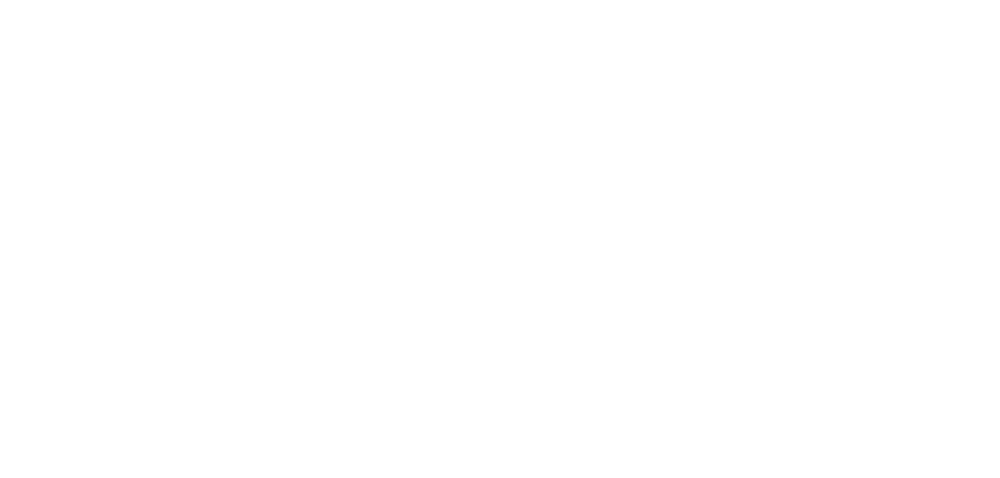

roi246_dff.png


<IPython.core.display.Javascript object>


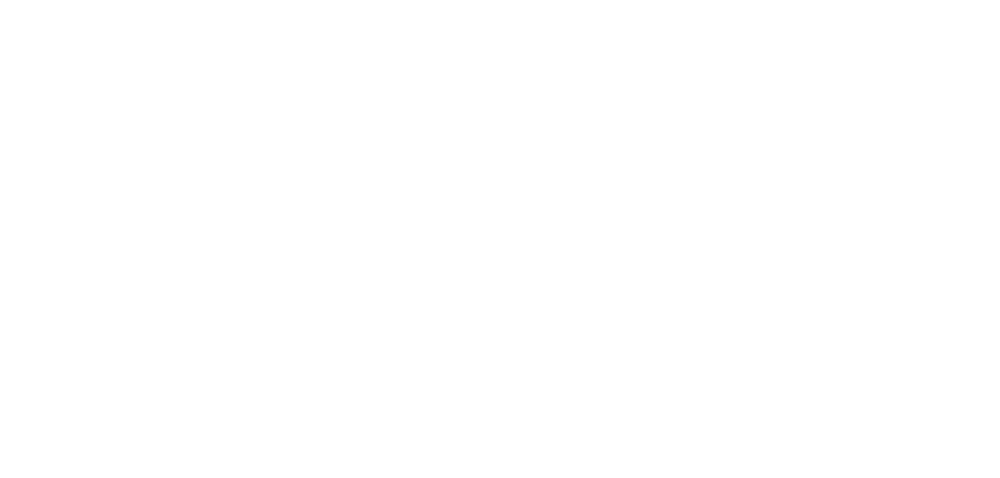

roi247_dff.png


<IPython.core.display.Javascript object>


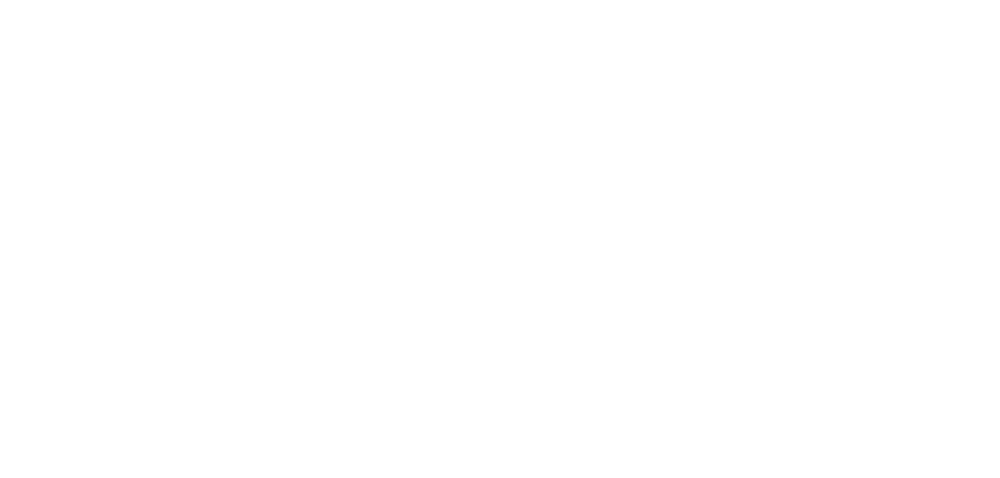

roi248_dff.png


<IPython.core.display.Javascript object>


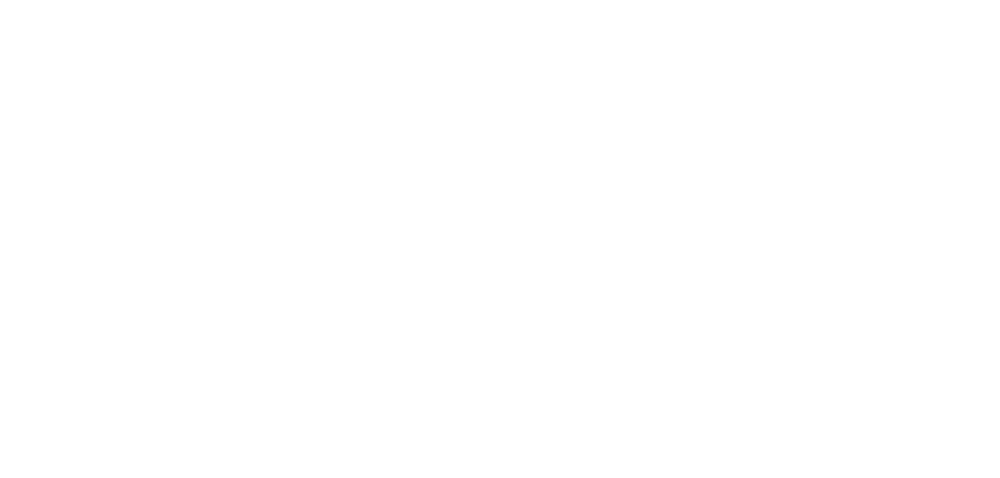

roi249_dff.png


<IPython.core.display.Javascript object>


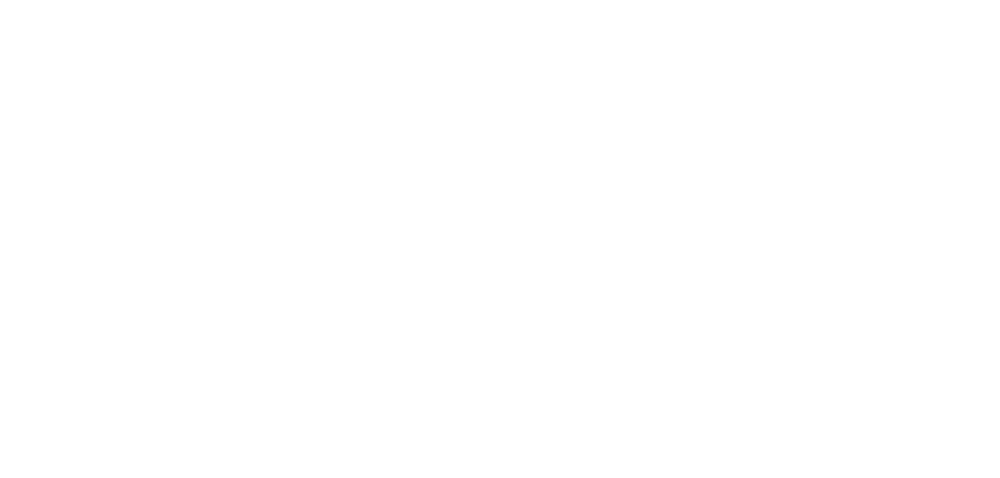

roi250_dff.png


<IPython.core.display.Javascript object>


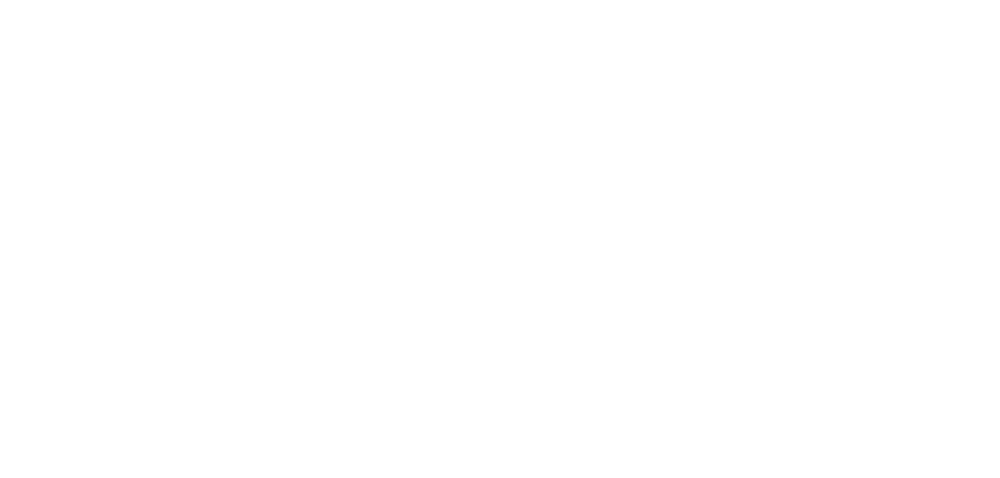

roi251_dff.png


<IPython.core.display.Javascript object>


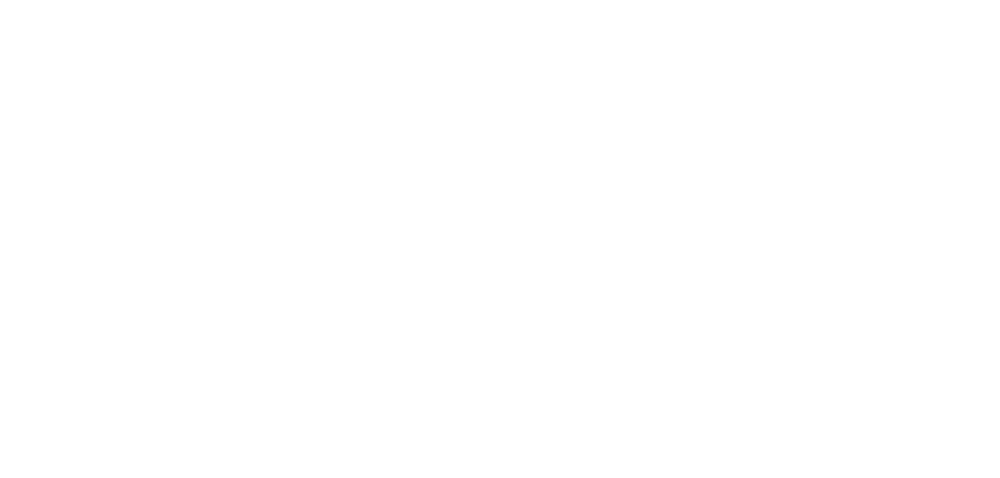

roi252_dff.png


<IPython.core.display.Javascript object>


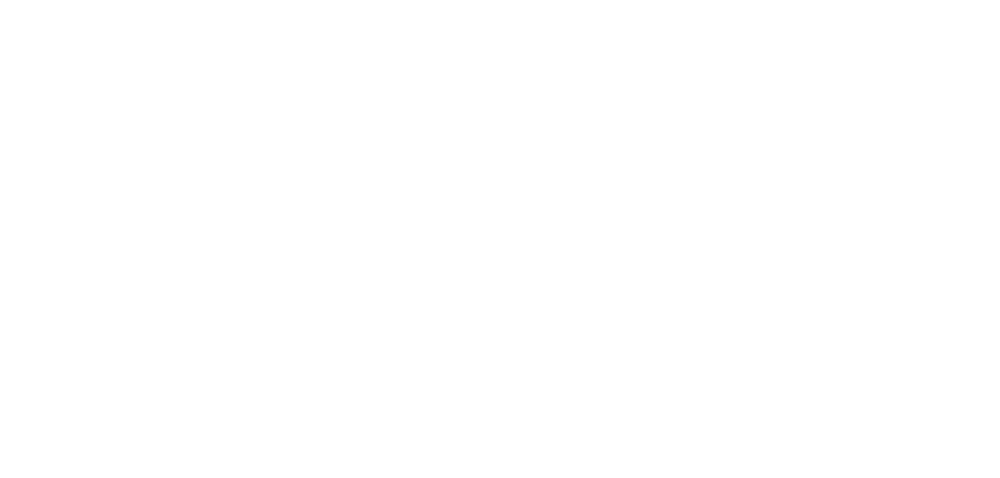

roi253_dff.png


<IPython.core.display.Javascript object>


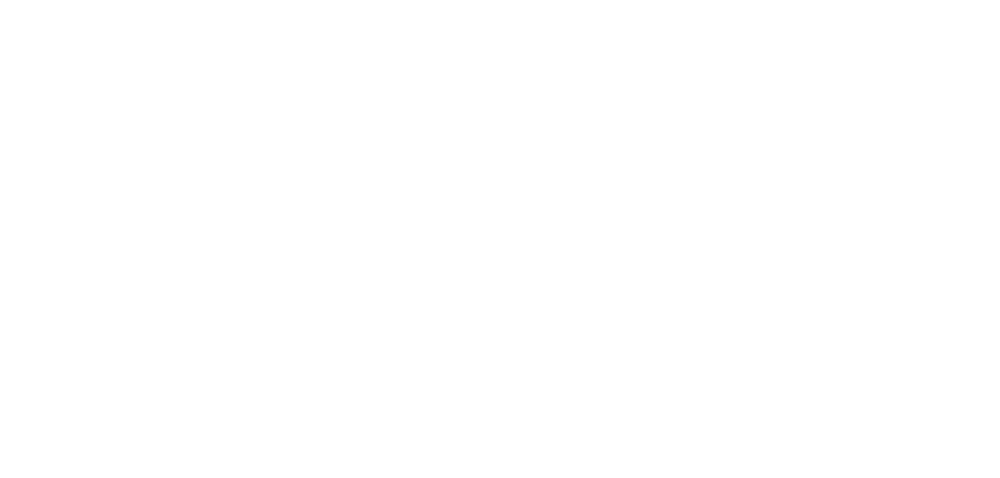

roi254_dff.png


<IPython.core.display.Javascript object>


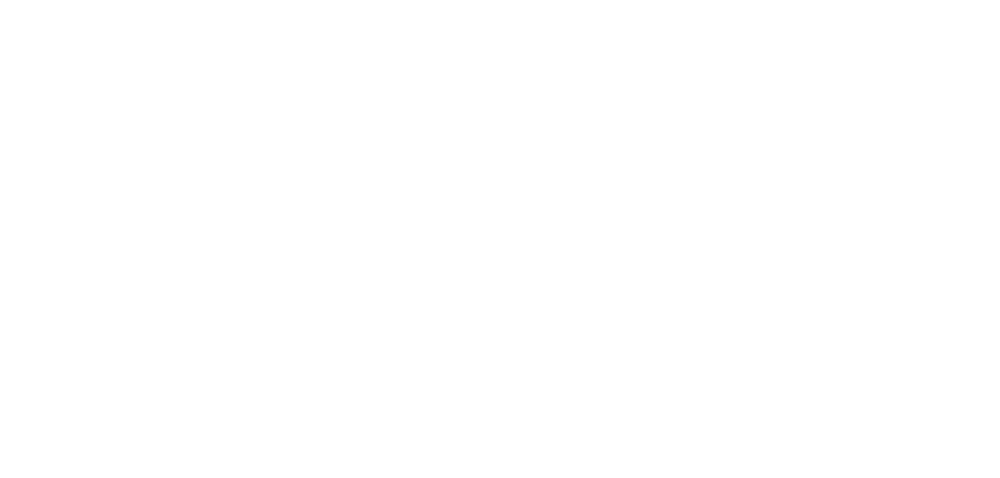

roi255_dff.png


<IPython.core.display.Javascript object>


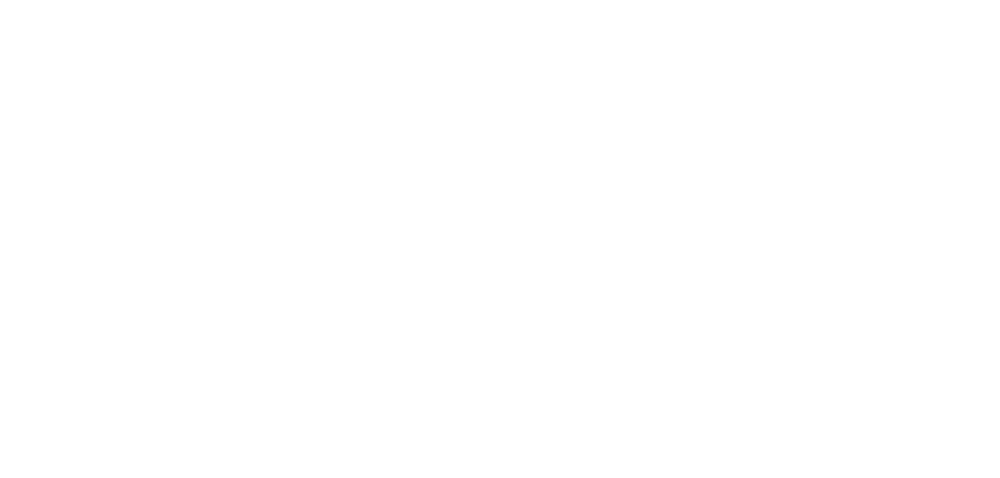

roi256_dff.png


<IPython.core.display.Javascript object>


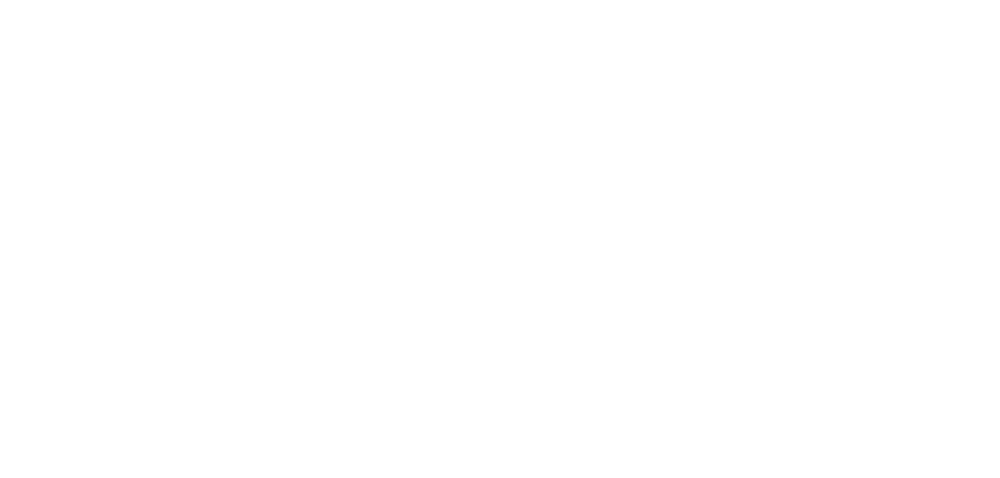

roi257_dff.png


<IPython.core.display.Javascript object>


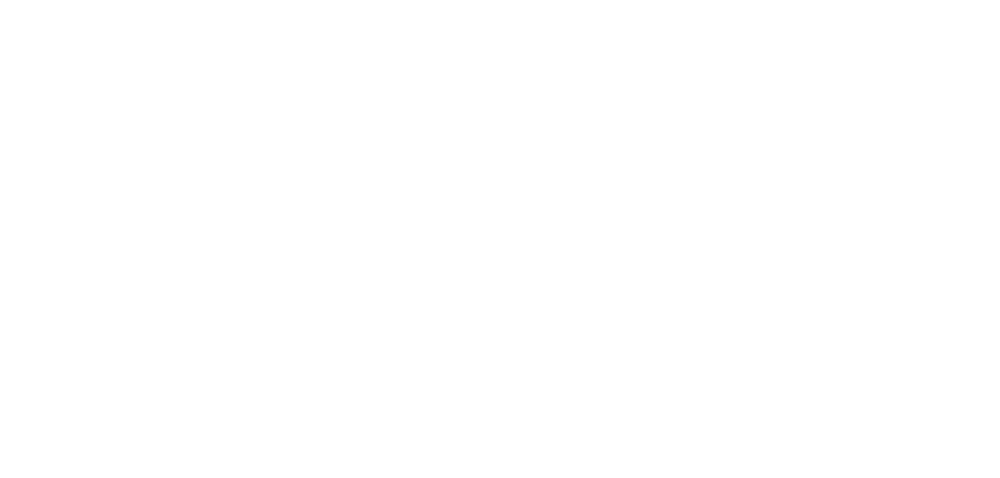

roi258_dff.png


<IPython.core.display.Javascript object>


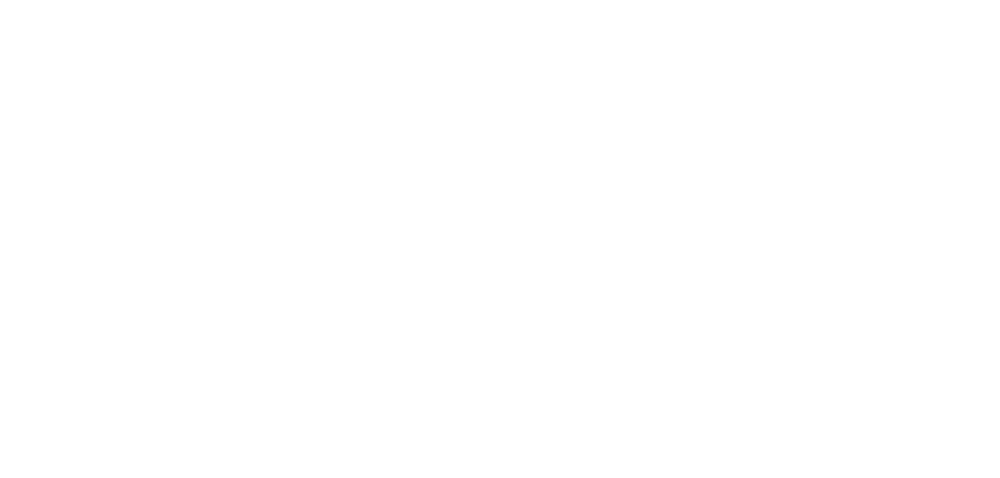

roi259_dff.png


<IPython.core.display.Javascript object>


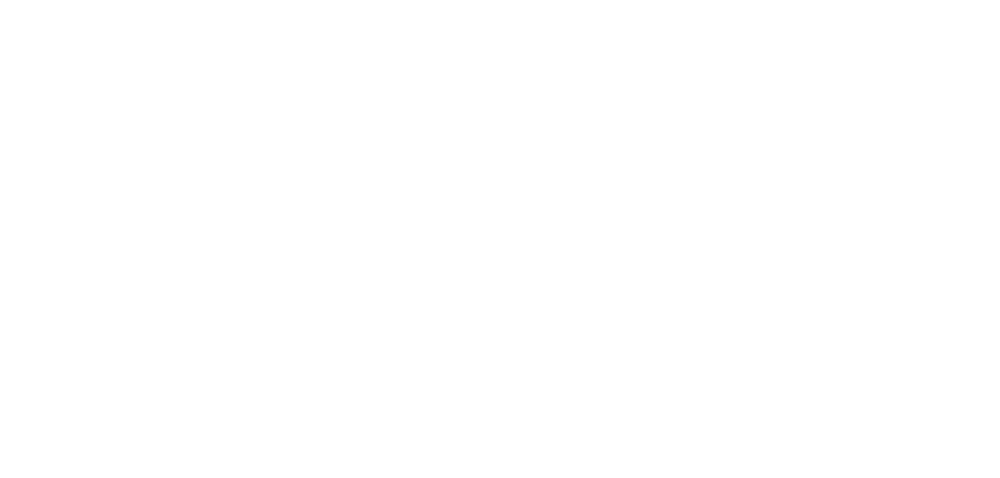

roi260_dff.png


In [164]:
for rid in range(nrois):
    trace_array = extracted_traces[rid, :].reshape(nfiles, nframes_per_file, order='C')
    all_frames = np.hstack(np.array([trace_array[fi, np.hstack(ixs.values.T)]\
                            for fi, ixs in sorted(tframes.items(), key=lambda x: x[0])]))
    rdata = labels_c.copy()
    rdata['trace'] = all_frames #manual[rid]

    meandfs = []
    for k, g in rdata.groupby(['config']):
        mean_trace = g.groupby(['trial'])[ylabel].apply(np.array).mean(axis=0)
        mean_tsec = g.groupby(['trial'])['tsec'].apply(np.array).mean(axis=0)
        sem_trace = stats.sem(np.vstack(g.groupby(['trial'])[ylabel].apply(np.array)), axis=0)
        mdf = pd.DataFrame({'%s' % ylabel: mean_trace,
                            'tsec': mean_tsec,
                            'sem': sem_trace,
                            'fill_minus': mean_trace - sem_trace,
                            'fill_plus': mean_trace + sem_trace,
                            'config': [k for _ in range(len(mean_trace))]})
        for p in plot_params.values():
            mdf[p] = [round(sdf[p][cfg], 1) if isinstance(sdf[p][cfg], (float)) else sdf[p][cfg] for cfg in mdf['config']]
        meandfs.append(mdf)

    meandfs = pd.concat(meandfs, axis=0)

    # plot
    p = sns.FacetGrid(meandfs, col=plot_params['cols'], row=plot_params['rows'], 
                      hue=plot_params['hue'], size=2, legend_out=True, palette=palette)

    p = p.map(pl.fill_between, "tsec", "fill_minus", "fill_plus", alpha=0.5) 
    p = (p.map(pl.plot, "tsec", ylabel, lw=1, alpha=1).add_legend())  
    p = p.set_titles(col_template="{col_name}", size=5)      
    pl.subplots_adjust(wspace=0.8, hspace=0.8, top=0.8, bottom=0.1, left=0.1, right=0.9)

    
    start_val = 0.0
    end_val = mdf['tsec'][stim_on + int(round(nframes_on))]
    for ri in range(p.axes.shape[0]):
        for ci in range(p.axes.shape[1]):
            ymin, ymax = p.axes[ri, ci].get_ylim()
            p.axes[ri, ci].add_patch(patches.Rectangle((start_val, ymin), end_val, ymax, linewidth=0, fill=True, color='k', alpha=0.2))

    p.fig.suptitle('roi %i' % int(rid+1))
    figname = 'roi%i_%s.png' % (int(rid+1), trace_type)
    pl.savefig(os.path.join(psth_dir, figname))
    print(figname)
    pl.close()


In [66]:
psth_dir

'/n/coxfs01/2p-data/JC084/20190525/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_e97cee_traces001_de9460_traces001_1f6b5f_traces001_70217b/figures/psth_caiman_dff_auto'

<IPython.core.display.Javascript object>


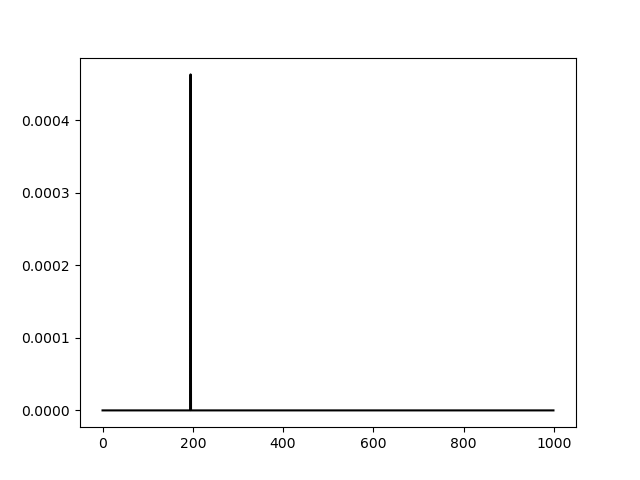

In [67]:
pl.figure()
pl.plot(cnm.estimates.S[11][0:1000], 'k')


#### Look at spatial components

In [16]:
glob.glob(os.path.join(results_dir, 'memmap', '*gratings-downsample-1_d*.mmap'))

['/n/coxfs01/2p-data/JC084/20190525/FOV1_zoom2p0x/caiman_results/gratings/memmap/JC084-20190525-FOV1_zoom2p0x-gratings-downsample-1_d1_512_d2_512_d3_1_order_C_frames_147520_.mmap']

In [17]:
# Load memmap file
#fname_tots = glob.glob(os.path.join(results_dir, 'memmap', '%s_*.mmap' % prefix))
fname_tots = glob.glob(os.path.join(results_dir, 'memmap', '*gratings-downsample-1_d*.mmap'))[0]
print(fname_tots)


/n/coxfs01/2p-data/JC084/20190525/FOV1_zoom2p0x/caiman_results/gratings/memmap/JC084-20190525-FOV1_zoom2p0x-gratings-downsample-1_d1_512_d2_512_d3_1_order_C_frames_147520_.mmap


In [23]:
# Load images
Yr, dims, T = cm.load_memmap(fname_tots)
images = np.reshape(Yr.T, [T] + list(dims), order='F') 

In [33]:
start_t = time.time()

avg = images.mean(axis=0)
end_t = time.time() - start_t
print("%.2f s" % end_t)



3094.01 s


In [34]:
avg.shape

(512, 512)

<IPython.core.display.Javascript object>


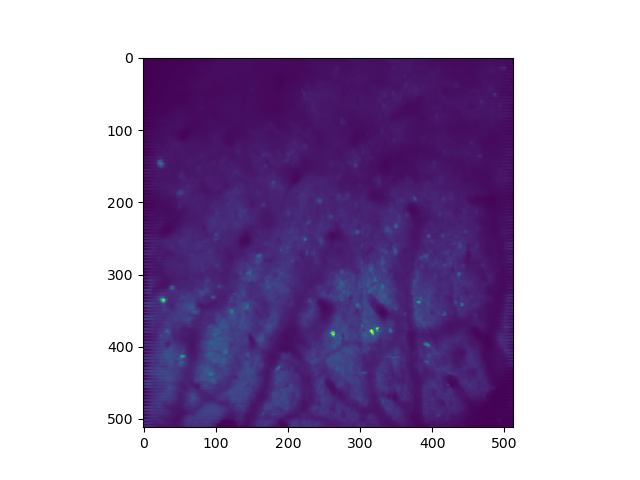

In [35]:
pl.figure()
pl.imshow(avg)

<IPython.core.display.Javascript object>


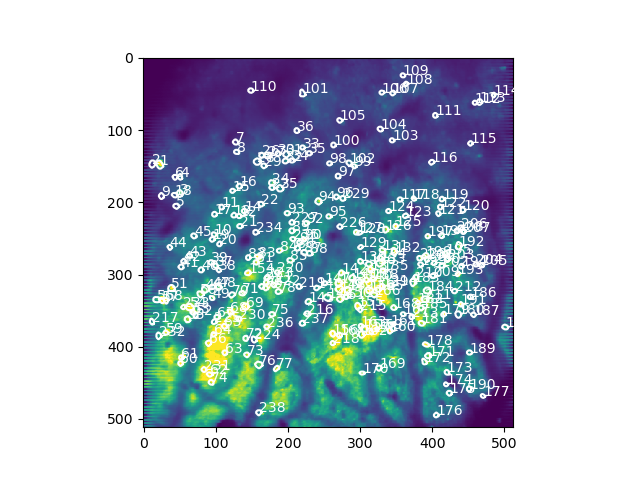

In [36]:
cnm.estimates.plot_contours(img=avg)

In [765]:
results_fpath

'/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/seed-cnm_seeded-gratings-downsample-1-mcorrected_results.hdf5'